<a href="https://colab.research.google.com/github/arpanbiswas52/pcVAEBO_pyrochlore/blob/main/data/BO_Ho2Ti2O7(2D).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Automated Refinement of the Structure parameters of Ho2Ti2O7

- The simulation of generating diffraction data is conducted from GSAS2 software




#Problem Description

Build a BO framework-

- Here we have an experimental set up of refinement of structure parameters of Spin Ice model, to match the experimental results of X-ray diffraction.

- The goal is to do an automated experiment set up through BO model- where we sequnetially learn and adaptively sample towards region of best structure parameters (theory-experiment matching).

- In this notebook, we set up the BO with 2 control parameters $OccTi$, $OccHo$ -- based on the earlier 4D explorations presented in other notebook. https://github.com/arpanbiswas52/pcVAEBO_pyrochlore/blob/main/data/BO_Ho2Ti2O7.ipynb

- The other 6 parameters are fixed in this case.


In [ ]:
# NECESSARY MODULES

!pip install botorch==0.6.0
!pip install gpytorch==1.6
!pip install smt
!pip install scikit-image
!pip install numpy==1.26.4
!pip install scipy==1.14.0
!pip install matplotlib
!pip install pillow==10.3.0
!pip install torchvision

  Using cached gpytorch-1.6.0.tar.gz (310 kB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for gpytorch: filename=gpytorch-1.6.0-py2.py3-none-any.whl size=509898 sha256=6490de8047a927c305fc6222791d4ccb2bf7d9dc4736384c06b8994ae24a5c3a
  Stored in directory: c:\users\user\appdata\local\pip\cache\wheels\13\61\38\8a63f5411c61bb4b365c4262fad8622a8dbc98bb24a14a620b
Successfully built gpytorch
  Attempting uninstall: gpytorch
    Found existing installation: gpytorch 1.14
    Uninstalling gpytorch-1.14:
      Successfully uninstalled gpytorch-1.14


In [ ]:
! pip show botorch

Name: botorch
Version: 0.6.0
Summary: Bayesian Optimization in PyTorch
Home-page: https://botorch.org
Author: Facebook, Inc.
Author-email: 
License: MIT
Location: C:\Users\USER\anaconda3\envs\prefect\Lib\site-packages
Requires: gpytorch, scipy, torch
Required-by: 


In [ ]:
import gpytorch
print(gpytorch.__version__)

1.6.0


In [ ]:
import botorch
print(botorch.__version__)

0.6.0


In [ ]:
#@title Imports
import torch
from torchvision import datasets, transforms
import matplotlib as mpl
import numpy as np
import matplotlib.pyplot as plt
import pickle
import random
from skimage.transform import resize
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Import GP and BoTorch functions
import gpytorch as gpt
from botorch.models import SingleTaskGP, ModelListGP
#from botorch.models import gpytorch
from botorch.fit import fit_gpytorch_model
from botorch.models.gpytorch import GPyTorchModel
from botorch.utils import standardize
from gpytorch.distributions import MultivariateNormal
from gpytorch.kernels import ScaleKernel, RBFKernel, MaternKernel, PiecewisePolynomialKernel, PeriodicKernel
from gpytorch.likelihoods import GaussianLikelihood
from gpytorch.means import ConstantMean, LinearMean
from gpytorch.mlls import ExactMarginalLogLikelihood
from botorch.acquisition import UpperConfidenceBound
from botorch.optim import optimize_acqf
from botorch.acquisition import qExpectedImprovement
from botorch.acquisition import ExpectedImprovement
from botorch.sampling import IIDNormalSampler
from botorch.sampling import SobolQMCNormalSampler
from gpytorch.likelihoods.likelihood import Likelihood
from gpytorch.constraints import GreaterThan
from botorch.generation import get_best_candidates, gen_candidates_torch
from botorch.optim import gen_batch_initial_conditions
from gpytorch.models import ExactGP

from smt.sampling_methods import LHS
from torch.optim import SGD
from torch.optim import Adam
from scipy.stats import norm
import torch.nn as nn
from torch.utils.data import TensorDataset, DataLoader

# Import GSAS modules
import os
import sys
sys.path.insert(0, os.path.expanduser(r"C:\Users\USER\gsas2full\GSAS-II\GSASII"))
import GSASIIscriptable as G2sc
from gsas import gsas
import torch.nn as nn

#For experimental analysis

#import WSe2_Target_Extractor as target - Talk to sumner can we import this?

GSAS-II binary directory: C:\Users\USER\gsas2full\GSAS-II\GSASII-bin\win_64_p3.11_n1.26


In [ ]:
# Define the Variational Autoencoder (VAE) architecture
class VAE(nn.Module):
    def __init__(self, input_dim, latent_dim):
        super(VAE, self).__init__()
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, 1000),
            nn.ReLU(),
            nn.Linear(1000, 512),
            nn.ReLU(),
            nn.Linear(512, 256),
            nn.ReLU(),
        )
        self.fc_mu = nn.Linear(256, latent_dim)
        self.fc_logvar = nn.Linear(256, latent_dim)
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, 256),
            nn.ReLU(),
            nn.Linear(256, 512),
            nn.ReLU(),
            nn.Linear(512, 1000),
            nn.ReLU(),
            nn.Linear(1000, input_dim),
        )

    def encode(self, x):
        h = self.encoder(x)
        mu = self.fc_mu(h)
        logvar = self.fc_logvar(h)
        logvar = torch.clamp(logvar, min=-10, max=10)  # Clamp to prevent large values
        return mu, logvar

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        decoded = self.decoder(z)
        return torch.abs(decoded)  # Apply absolute value to ensure non-negative outputs

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterize(mu, logvar)
        reconstructed = self.decode(z)
        return reconstructed, mu, logvar

# Define loss function
def loss_function(reconstructed, original, mu, logvar):
    reconstruction_loss = nn.functional.mse_loss(reconstructed, original, reduction='sum')
    kl_divergence = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    return reconstruction_loss + kl_divergence

# Initialize weights with Xavier initialization
def init_weights(m):
    if isinstance(m, nn.Linear):
        torch.nn.init.xavier_uniform_(m.weight)

# Function to train the VAE with loss tracking for convergence plot
def train_vae(vae, dataloader, epochs=2000, lr=0.0001):
    optimizer = optim.Adam(vae.parameters(), lr=lr)
    vae.train()
    loss_history = []  # To store loss for each epoch

    for epoch in range(epochs):
        train_loss = 0
        for batch in dataloader:
            batch_data = batch[0]
            optimizer.zero_grad()
            reconstructed, mu, logvar = vae(batch_data)

            # Calculate the loss
            loss = loss_function(reconstructed, batch_data, mu, logvar)

            # Check for NaN or Inf loss
            if torch.isnan(loss) or torch.isinf(loss):
                print("NaN or Inf loss encountered, stopping training.")
                return

            loss.backward()
            torch.nn.utils.clip_grad_norm_(vae.parameters(), max_norm=1.0)  # Clip gradients
            optimizer.step()
            train_loss += loss.item()

        avg_loss = train_loss / len(dataloader.dataset)
        loss_history.append(avg_loss)  # Append average loss of this epoch
        print(f'Epoch {epoch + 1}, Loss: {avg_loss:.4f}')

    # Plot convergence curve
    plt.figure(figsize=(10, 6))
    plt.plot(range(1, epochs + 1), loss_history, label="Training Loss")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Convergence Curve (Epoch vs. Loss)")
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
# Empty arrays to store F_obs and F_calc reflection lists
# Make sure to run this code block again when re-running code to reset arrays and iteration
# Iteration is just for .gpx filenames, you can ignore it if need be or set it const in gsas script
Fobs = []
Fcalc = []
iteration = 0

# Loading the VAE model, pretrained with X-ray data

- The notebook for the VAE model training and analysis can be found at <Arpan- Joseph, add the link for the VAE final notebook>

In [ ]:
vae = torch.load("vae_full_model.pth", weights_only=False)

# Design objective function integrating with pretrained VAE

In [ ]:
def func_obj(X, fixed_param, iteration, pre_trained_model):
    # Run GSAS once to get Fobs_i and Fcalc_i
    #chisq, Fobs_i, Fcalc_i, iteration = gsas(X, fixed_param, iteration)
    _, Fobs_i, Fcalc_i, iteration = gsas(X, fixed_param, iteration)

    # Scaling
    F_obs_arr = np.asarray(Fobs_i, dtype=float)
    obs_arr = (F_obs_arr * 1000) / F_obs_arr[452]

    F_calc_arr = np.asarray(Fcalc_i, dtype=float)
    calc_arr = (F_calc_arr * 1000) / F_calc_arr[452]

    # Latent representation
    vae.eval()
    with torch.no_grad():
        obs_tensor = torch.tensor(obs_arr, dtype=torch.float32).unsqueeze(0)
        mu_o, logvar_o = pre_trained_model.encode(obs_tensor)
        latent_obs = vae.reparameterize(mu_o, logvar_o).squeeze(0)

        calc_tensor = torch.tensor(calc_arr, dtype=torch.float32).unsqueeze(0)
        mu_c, logvar_c = pre_trained_model.encode(calc_tensor)

        num_samples = 10000 # we are sampling 10,000 times from the latent space
        latent_dim = 7 # same as the latent dimension of the pre-trained model
        latent_samples = torch.zeros((num_samples, latent_dim), dtype=torch.float32)

        for k in range(num_samples):
            z_c = vae.reparameterize(mu_c, logvar_c).squeeze(0)
            latent_samples[k] = z_c

        sum_latents_calc = torch.sum(latent_samples, dim=0)
        mean_latent_calc = sum_latents_calc / num_samples

    # chi-square calculation
    diff = latent_obs - mean_latent_calc
    chisq_l = torch.sqrt(torch.sum(diff**2) / (latent_dim - 1))
    print('latent_obs:', latent_obs)
    print('mean_latent_calc:', mean_latent_calc)

    ####################################################################################################################
    diff  = F_obs_arr - F_calc_arr
    chisq = np.sqrt(np.sum(diff**2) / (len(obs_arr) - 1))
    chisq = chisq/1000
    print('chisq_scaled:', chisq)

    plt.figure()
    plt.scatter(F_obs_arr, F_calc_arr, alpha=0.7, s=10, label='Data Points')
    min_val = min(min(F_obs_arr), min(F_calc_arr))
    max_val = max(max(F_obs_arr), max(F_calc_arr))
    plt.plot([min_val, max_val], [min_val, max_val], 'r--', label='y = x')

    plt.xlabel('Fobs_i')
    plt.ylabel('Fcalc_i')
    plt.title('Fobs_i vs Fcalc_i')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    ####################################################################################################################
    """
    #scaled  Fobs_i vs Fcalc_i plot in the original space
    plt.figure()
    plt.scatter(obs_arr, calc_arr, alpha=0.7, s=10, label='Data Points')
    min_val = min(min(obs_arr), min(calc_arr))
    max_val = max(max(obs_arr), max(obs_arr))
    plt.plot([min_val, max_val], [min_val, max_val], 'r--', label='y = x')

    plt.xlabel('scaled Fobs_i')
    plt.ylabel('scaled Fcalc_i')
    plt.title('scaled Fobs_i vs scaled Fcalc_i')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    """
    plt.figure()
    for k in range(num_samples):
        plt.plot(range(latent_dim), latent_samples[k], alpha=0.1, linewidth=0.2)
    plt.xlabel('Latent Dimension Index')
    plt.ylabel('Latent Values')
    plt.title('10,000 Latent Realizations')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # 10 of the the latent realizations
    print("First 10 latent vectors from the VAE:")
    for i in range(10):
        print(f"Sample {i+1}: {latent_samples[i].tolist()}")

    print("chisq_l:", chisq_l)
    return chisq_l, chisq

In [ ]:
# Calling GSAS script
# def func_obj(X, fixed_param, iteration):
    # chisq, Fobs_i, Fcalc_i, iteration = gsas(X, fixed_param, iteration)

    # Fobs.append(Fobs_i)
    # Fcalc.append(Fcalc_i)

    # return chisq

Below section defines the list of functions (user calls these functions during analysis):
1. Gaussian Process
2. Optimimize Hyperparameter of Gaussian Process (using Adam optimizer)
3. Posterior means and variance computation
4. Acquistion functions for BO- Expected Improvmement

In [ ]:
class SimpleCustomGP(ExactGP, GPyTorchModel):
    _num_outputs = 1  # to inform GPyTorchModel API

    def __init__(self, train_X, train_Y):
        # squeeze output dim before passing train_Y to ExactGP
        super().__init__(train_X, train_Y.squeeze(-1), GaussianLikelihood())
        self.mean_module = ConstantMean()
        #self.mean_module = LinearMean(train_X.shape[-1])
        self.covar_module = ScaleKernel(
            #base_kernel=MaternKernel(nu=0.5, ard_num_dims=train_X.shape[-1]),
            #base_kernel=RBFKernel(ard_num_dims=train_X.shape[-1]),
            # base_kernel=PeriodicKernel(ard_num_dims=train_X.shape[-1])
            base_kernel = PiecewisePolynomialKernel(power = 2, ard_num_dims=train_X.shape[-1]),
        )
        self.to(train_X)  # make sure we're on the right device/dtype

    def forward(self, x):
        mean_x = self.mean_module(x)
        covar_x = self.covar_module(x)
        return MultivariateNormal(mean_x, covar_x)


#Optimize Hyperparameters of GP#
def optimize_hyperparam_trainGP(train_X, train_Y):
    # Gp model fit

    gp_surro = SimpleCustomGP(train_X, train_Y)
    gp_surro = gp_surro.double()
    gp_surro.likelihood.noise_covar.register_constraint("raw_noise", GreaterThan(1e-1))
    mll1 = ExactMarginalLogLikelihood(gp_surro.likelihood, gp_surro)
    # fit_gpytorch_model(mll)
    mll1 = mll1.to(train_X)
    gp_surro.train()
    gp_surro.likelihood.train()
    ## Here we use Adam optimizer with learning rate =0.1, user can change here with different algorithm and/or learning rate for each GP
    optimizer1 = Adam([{'params': gp_surro.parameters()}], lr=0.1, weight_decay = 0.01)
    #optimizer1 = SGD([{'params': gp_surro.parameters()}], lr=0.0001)

    NUM_EPOCHS = 300

    for epoch in range(NUM_EPOCHS):
        # clear gradients
        optimizer1.zero_grad()
        # forward pass through the model to obtain the output MultivariateNormal
        output1 = gp_surro(train_X)
        # Compute negative marginal log likelihood
        loss1 = - mll1(output1, gp_surro.train_targets)
        # back prop gradients
        loss1.backward(retain_graph=True)
        # print last iterations
        if (epoch + 1) > NUM_EPOCHS: #Stopping the print for now
            print("GP Model trained:")
            print("Iteration:" + str(epoch + 1))
            print("Loss:" + str(loss1.item()))
            # print("Length Scale:" +str(gp_PZO.covar_module.base_kernel.lengthscale.item()))
            print("noise:" + str(gp_surro.likelihood.noise.item()))

        optimizer1.step()

    gp_surro.eval()
    gp_surro.likelihood.eval()
    return gp_surro



#GP posterior predictions#
def cal_posterior(gp_surro, test_X, X, norm=False):
    X1, X2 = X[0], X[1]
    X1, X2 = torch.meshgrid(X1, X2, indexing='ij')  # Use indexing='ij' for clarity

    if norm == "True":
        X1 = (X1 - torch.min(X1)) / (torch.max(X1) - torch.min(X1))
        X2 = (X2 - torch.min(X2)) / (torch.max(X2) - torch.min(X2))

    y_pred_means_mat = torch.empty(len(test_X), 1)
    y_pred_means_mesh = torch.empty(X1.shape)
    y_pred_vars_mat = torch.empty(len(test_X), 1)
    y_pred_vars_mesh = torch.empty(X1.shape)
    t_X = torch.empty(1, test_X.shape[1])

    with torch.no_grad(), gpt.settings.max_lanczos_quadrature_iterations(32), \
         gpt.settings.fast_computations(covar_root_decomposition=False, log_prob=False, solves=True), \
         gpt.settings.max_cg_iterations(100), \
         gpt.settings.max_preconditioner_size(80), \
         gpt.settings.num_trace_samples(128):

        for t in range(len(test_X)):
            for i in range(test_X.shape[1]):
                t_X[:, i] = test_X[t, i]
            y_pred_surro = gp_surro.posterior(t_X)
            y_pred_means_mat[t, 0] = y_pred_surro.mean
            y_pred_vars_mat[t, 0] = y_pred_surro.variance

        for i in range(X1.shape[0]):
            for j in range(X1.shape[1]):
                t_X[:, 0] = X1[i, j]
                t_X[:, 1] = X2[i, j]
                y_pred_surro = gp_surro.posterior(t_X)
                y_pred_means_mesh[i, j] = y_pred_surro.mean
                y_pred_vars_mesh[i, j] = y_pred_surro.variance

    y_pred_means = [y_pred_means_mat, y_pred_means_mesh]
    y_pred_vars = [y_pred_vars_mat, y_pred_vars_mesh]
    return y_pred_means, y_pred_vars

#EI acquistion function#
def acqmanEI(y_means, y_vars, train_Y, ieval, ismin=False):


    y_means = y_means.detach().numpy()
    y_vars = y_vars.detach().numpy()
    y_std = np.sqrt(y_vars)
    if ismin == "True":
        train_Y = - train_Y
        y_means = - y_means
    fmax = train_Y.max()
    fmax = fmax.detach().numpy()
    best_value = fmax
    EI_val = np.zeros(len(y_vars))
    Z = np.zeros(len(y_vars))
    eta = 0.01

    for i in range(0, len(y_std)):
        if (y_std[i] <=0):
            EI_val[i] = 0
        else:
            Z[i] =  (y_means[i]-best_value-eta)/y_std[i]
            EI_val[i] = (y_means[i]-best_value-eta)*norm.cdf(Z[i]) + y_std[i]*norm.pdf(Z[i])

    # Eliminate evaluated samples from consideration to avoid repeatation in future sampling
    EI_val[ieval] = -1
    acq_val = np.max(EI_val)
    acq_cand = [k for k, j in enumerate(EI_val) if j == acq_val]
    #print(acq_val)
    print("EI:",EI_val)
    #print("ymeans:",y_means)
    #print("best value:", best_value)
    return acq_cand, acq_val, EI_val

#Other list of functions-

1. Evaluate initial data and normalize all data
2. Evaluate functions for new data and augment data

In [ ]:
def normalize_get_initialdata_SpinIce(X, fix_params, num, m):
    # Cartesian product from only X[0] and X[1]
    X_feas = torch.empty((X[0].shape[0] * X[1].shape[0], 2))
    k = 0
    for t1 in range(X[0].shape[0]):
        for t2 in range(X[1].shape[0]):
            X_feas[k, 0] = X[0][t1]
            X_feas[k, 1] = X[1][t2]
            k += 1

    # Normalize X
    X_feas_norm = torch.empty_like(X_feas)
    for i in range(X_feas.shape[1]):
        X_feas_norm[:, i] = (X_feas[:, i] - torch.min(X_feas[:, i])) / (torch.max(X_feas[:, i]) - torch.min(X_feas[:, i]))

    #print(X_feas)
    #print(X_feas_norm)

    # Select starting samples randomly as training data
    np.random.seed(0)
    idx = np.random.randint(0, len(X_feas), num) # insert latin hypercube
    train_X = X_feas[idx]
    train_X_norm = X_feas_norm[idx]

    #a = torch.tensor([0.9, 0.917277])
    #a_norm = torch.empty((1, X_feas.shape[1]))
    #for i in range(0, X_feas.shape[1]):
       #a_norm[0, i] = (a[i] - torch.min(X_feas[:, i])) / (torch.max(X_feas[:, i]) - torch.min(X_feas[:, i]))
    #train_X = torch.vstack((train_X, a))
    #train_X_norm = torch.vstack((train_X_norm, a_norm))

    train_Y = torch.empty((train_X.shape[0], 1))
    train_chisq = torch.empty((train_X.shape[0], 1))
    #print(train_X)
    #print(train_X_norm)

    #Evaluate initial training data
    x = torch.empty((1,train_X.shape[1]))

    for i in range(0, train_X.shape[0]):
        for j in range(0, train_X.shape[1]):
          x[0, j] = train_X[i, j]
        print("Function eval #" + str(m + 1))

        train_chisq[i, 0], train_Y[i, 0] = func_obj(x, fix_params, iteration, pre_trained_model = vae) # pass to the function where we will connect to experiments
        m = m + 1

    #print(train_Y)

    return X_feas, X_feas_norm, train_X, train_X_norm, train_Y, train_chisq, idx, m

In [ ]:
################################Augment data - Existing training data with new evaluated data################################
def augment_newdata_SpinIce(acq_X, acq_X_norm, train_X, train_X_norm, train_Y, train_chisq, fix_params, m):

    nextX = acq_X
    nextX_norm = acq_X_norm
    #train_X_norm = torch.cat((train_X_norm, nextX_norm), 0)
    #train_X_norm = train_X_norm.double()
    train_X_norm = torch.vstack((train_X_norm, nextX_norm))
    train_X = torch.vstack((train_X, nextX))

    x = torch.empty((1,train_X.shape[1]))
    for j in range(0, train_X.shape[1]):
        x[0, j] = train_X[-1, j]


    print("Function eval #" + str(m + 1))
    next_feval = torch.empty(1, 1)
    next_chisq = torch.empty(1, 1)
    next_chisq[0, 0], next_feval[0, 0] = func_obj(x, fix_params, iteration, pre_trained_model = vae) # pass to the function where we will connect to experiments
    train_Y = torch.vstack((train_Y, next_feval))
    train_chisq= torch.vstack((train_chisq, next_chisq))

    m = m + 1
    return train_X, train_X_norm, train_Y, train_chisq, m

In [ ]:
def plot_iteration_results(train_X, train_X_norm, train_Y, test_X, test_X_norm,
                           y_pred_means, y_pred_vars, fix_params, i):
    y_pred_means_mat, y_pred_means_mesh = y_pred_means
    y_pred_vars_mat, y_pred_vars_mesh = y_pred_vars

    # Rescale GP predictions to match the scale of train_Y
    y_pred_means_mat = y_pred_means_mat * (torch.max(train_Y) - torch.min(train_Y)) + torch.min(train_Y)
    y_pred_means_mesh = y_pred_means_mesh * (torch.max(train_Y) - torch.min(train_Y)) + torch.min(train_Y)

    # Find best evaluated and best predicted point
    best_Y = torch.min(train_Y)
    ind_eval = torch.argmin(train_Y)
    X_opt = train_X[ind_eval].unsqueeze(0)
    X_opt_norm = train_X_norm[ind_eval].unsqueeze(0)

    best_estY = torch.min(y_pred_means_mat)
    ind_gp = torch.argmin(y_pred_means_mat)
    X_opt_GP = test_X[ind_gp].unsqueeze(0)
    X_opt_GP_norm = test_X_norm[ind_gp].unsqueeze(0)

    print("#########################################################")
    print(f"Current best solutions at iteration: {i}")
    print("Best params among evaluated samples:", X_opt, torch.round(best_Y, decimals=2))
    print("Best params from GP map:", X_opt_GP, torch.round(best_estY, decimals=2))


    from mpl_toolkits.axes_grid1 import make_axes_locatable

    fig, ax = plt.subplots(2, 1, figsize=(10, 8))

    # Define these BEFORE using them
    ymeans_2d = torch.round(y_pred_means_mesh, decimals=2)
    yvars_2d = torch.round(y_pred_vars_mesh, decimals=2)

    # Plot GP mean
    im1 = ax[0].imshow(ymeans_2d.detach().numpy(), origin='lower', cmap='viridis',extent=(0.9, 1.1, 0.9, 1.1))
    ax[0].scatter(train_X[:, 1], train_X[:, 0], c=train_Y.squeeze(), cmap='Reds', edgecolor='black')
    ax[0].set_title("OccHo vs OccTi: GP Mean")
    ax[0].set_xlabel("OccHo")
    ax[0].set_ylabel("OccTi")

    from mpl_toolkits.axes_grid1 import make_axes_locatable
    divider0 = make_axes_locatable(ax[0])
    cax0 = divider0.append_axes("right", size="5%", pad=0.3)
    fig.colorbar(im1, cax=cax0, orientation='vertical')

    # Plot GP variance
    im2 = ax[1].imshow(yvars_2d.detach().numpy(), origin='lower', cmap='viridis', extent=(0.9, 1.1, 0.9, 1.1))
    ax[1].set_title("OccHo vs OccTi: GP Variance")
    ax[1].set_xlabel("OccHo")
    ax[1].set_ylabel("OccTi")

    divider1 = make_axes_locatable(ax[1])
    cax1 = divider1.append_axes("right", size="5%", pad=0.3)
    fig.colorbar(im2, cax=cax1, orientation='vertical')

    plt.tight_layout()
    plt.show()

    return X_opt, X_opt_GP

In [ ]:
def norm_fun(x):
    x = (x-torch.min(x))/(torch.max(x)-torch.min(x))
    #print(x)
    return x

In [ ]:
def rev_norm(x, train_Y):
    #print(torch.max(train_Y)
    x = x*(torch.max(train_Y)-torch.min(train_Y))+ torch.min(train_Y)
    #print(x)
    return x

In [ ]:
#@title BO framework- Integrating the above functions
def BO_SpinIce(X, fix_params, num_start, N):
    num = num_start
    m = 0
    # Initialization: evaluate few initial data normalize data
    test_X, test_X_norm, train_X, train_X_norm, train_Y, train_chisq, idx, m = \
        normalize_get_initialdata_SpinIce(X, fix_params, num, m)


    print("Initial evaluation complete. Start BO")
    ## Gp model fit
    # Calling function to fit and optimizize Hyperparameter of Gaussian Process (using Adam optimizer)
    # Input args- Torch arrays of normalized training data, parameter X and objective eval Y
    # Output args- Gaussian process model lists
    # gp_surro = optimize_hyperparam_trainGP(train_X, train_Y)
    # NORMALIZE train_Y
    train_y_norm = norm_fun(train_Y)
    gp_surro = optimize_hyperparam_trainGP(train_X_norm, train_y_norm) # normalized x NORMALIZE train_Y

    for i in range(1, N + 1):
        # Calculate posterior for analysis for intermidiate iterations
        #y_pred_means, y_pred_vars = cal_posterior(gp_surro, test_X, X, norm = "False")
        y_pred_means, y_pred_vars = cal_posterior(gp_surro, test_X_norm, X, norm = "True")
        y_pred_means_mat, y_pred_means_mesh = y_pred_means[0], y_pred_means[1]
        y_pred_vars_mat, y_pred_vars_mesh = y_pred_vars[0], y_pred_vars[1]

        if ((i == 1) or ((i % 10) == 0)):
            #y_pred_means_real = rev_norm(y_pred_means, train_Y)
            #y_pred_vars_real = rev_norm(y_pred_vars, train_Y)
            # Plotting functions to check the current state exploration and Pareto fronts
            X_eval, X_GP = plot_iteration_results(train_X, train_X_norm, train_Y, test_X, test_X_norm, y_pred_means, y_pred_vars, fix_params, i)

        #print(idx)b
        acq_cand, acq_val, EI_val = acqmanEI(y_pred_means_mat, y_pred_vars_mat, train_y_norm, idx, ismin="True") # NORMALIE Y HERE
        val = acq_val
        ind = np.random.choice(acq_cand) # When multiple points have same acq values
        idx = np.hstack((idx, ind))


        ################################################################
        ## Find next point which maximizes the learning through exploration-exploitation
        if (i == 1):
            val_ini = val
        # Check for convergence
        if ((val) == 0):  # Stop for negligible expected improvement
            print("Model converged due to sufficient learning over search space ")
            break
        else:
            nextX = torch.empty((1, len(X)))
            nextX_norm = torch.empty(1, len(X))
            nextX[0,:] = test_X[ind, :]
            nextX_norm [0, :] = test_X_norm[ind, :]

            # Evaluate true function for new data, augment data
            train_X, train_X_norm, train_Y, train_chisq, m=\
             augment_newdata_SpinIce(nextX, nextX_norm, train_X, train_X_norm, train_Y, train_chisq, fix_params, m) # NORMALIZE train_Y

            # Gp model fit
            # Updating GP with augmented training data
            # gp_surro = optimize_hyperparam_trainGP(train_X, train_Y)
            train_y_norm = norm_fun(train_Y)
            gp_surro = optimize_hyperparam_trainGP(train_X_norm, train_y_norm) # PASS NORM Y

    ## Final posterior prediction after all the sampling done

    if (i == N):
        print("Max. sampling reached, model stopped")


    # --- PLOT FOR train_Y & train_chisq ---
    import pandas as pd
    import matplotlib.pyplot as plt

    # Ensure train_Y and train_chisq are 1D
    train_Y = train_Y.ravel()
    train_chisq = train_chisq.ravel()

    # build history table
    df_history = pd.DataFrame({
        'iteration': range(1, len(train_Y) + 1),
        'train_Y':     train_Y,
        'chi_square_l':  train_chisq
    })

    print(df_history)

    # plot train_Y convergence
    plt.figure()
    plt.plot(
        df_history['iteration'],
        df_history['train_Y'],
        marker='o'
    )
    plt.xlabel('Iteration')
    plt.ylabel('train_Y')
    plt.title('train_Y Convergence')
    plt.grid(True)
    plt.show()

    # plot chi-square convergence
    plt.figure()
    plt.plot(
        df_history['iteration'],
        df_history['chi_square_l'],
        marker='o'
    )
    plt.xlabel('Iteration')
    plt.ylabel('Chi-square_l')
    plt.title('Chi-square Convergence')
    plt.grid(True)
    plt.show()
    # ------------END OF PLOT-------------------------------------------


    #Optimal GP learning
    gp_opt = gp_surro
    # Posterior calculation with converged GP model
    # y_pred_means, y_pred_vars = cal_posterior(gp_opt, test_X, X, norm = "False")
    y_pred_means, y_pred_vars = cal_posterior(gp_opt, test_X_norm, X, norm = "True")
    #print("y_pred_means:",y_pred_means)
    #print("y_pred_vars:",y_pred_vars)
    # Plotting functions to check final iteration
    #y_pred_means_real = rev_norm(y_pred_means, train_Y)
    #y_pred_vars_real = rev_norm(y_pred_vars, train_Y)
    X_opt, X_opt_GP = plot_iteration_results(train_X, train_X_norm, train_Y, test_X, test_X_norm, y_pred_means, y_pred_vars, fix_params, i)

    return  X_opt, X_opt_GP, train_X, train_Y, train_chisq, y_pred_means, y_pred_vars

# Analysis

Function eval #1
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [0.9545454382896423, 0.9646464586257935]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7398
initial chi^2 1.972e+05 with 2596 obs.
New scale: 0.7398
Cycle 0: 0.57s, Chi**2: 1.2941e+05 for 2596 obs., Lambda: 0,  Delta: 0.344, SVD=0
New scale: 0.7398
Maximum shift/esd = -66.882 for all cycles
Read from file:C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.bak0.gpx
Save to file  

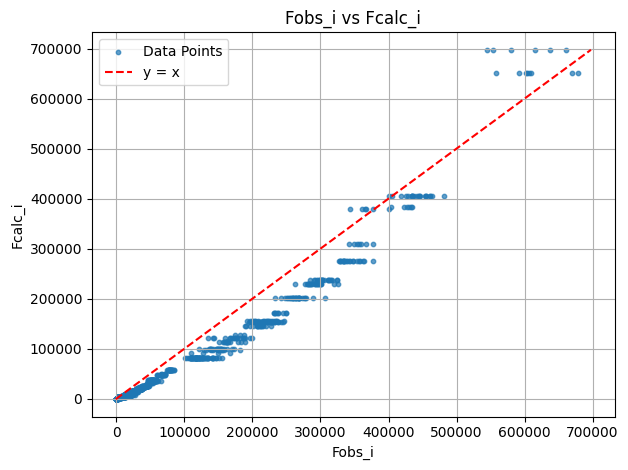

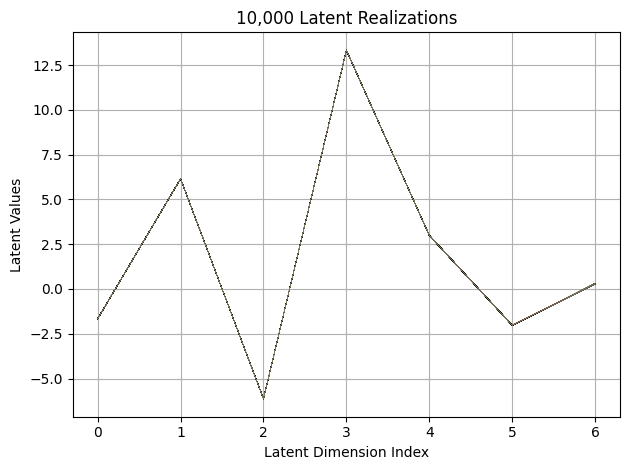

First 10 latent vectors from the VAE:
Sample 1: [-1.6669353246688843, 6.155946731567383, -6.1365065574646, 13.334460258483887, 2.9925880432128906, -2.0175914764404297, 0.2966705560684204]
Sample 2: [-1.6630691289901733, 6.148236274719238, -6.135586738586426, 13.329876899719238, 2.9802777767181396, -2.0231525897979736, 0.29000502824783325]
Sample 3: [-1.6616480350494385, 6.161046504974365, -6.1298441886901855, 13.322968482971191, 2.993485450744629, -2.023646116256714, 0.3078996241092682]
Sample 4: [-1.6732350587844849, 6.154963970184326, -6.1320624351501465, 13.334611892700195, 2.988370418548584, -2.013362169265747, 0.28795361518859863]
Sample 5: [-1.6769225597381592, 6.154282093048096, -6.13639497756958, 13.323389053344727, 2.9909791946411133, -2.0280063152313232, 0.2852954566478729]
Sample 6: [-1.6704424619674683, 6.156554698944092, -6.128718376159668, 13.326687812805176, 2.997927188873291, -2.0285096168518066, 0.30166810750961304]
Sample 7: [-1.6736009120941162, 6.157142162322998, -6

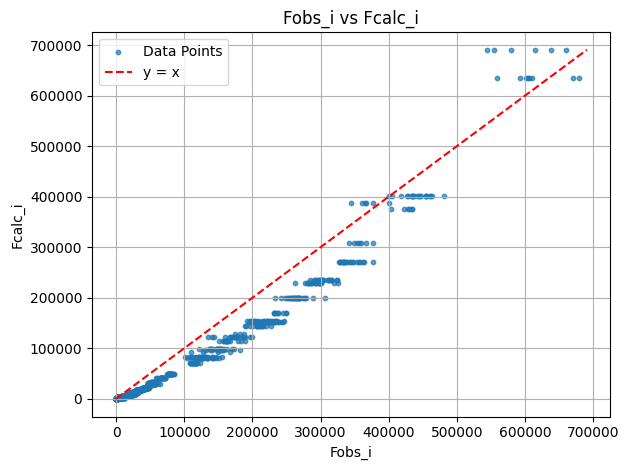

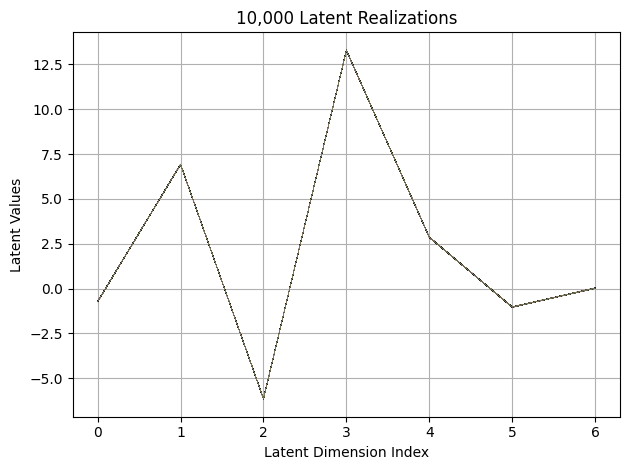

First 10 latent vectors from the VAE:
Sample 1: [-0.7277565598487854, 6.929405212402344, -6.138555526733398, 13.282578468322754, 2.857555389404297, -1.0395293235778809, 0.02579944208264351]
Sample 2: [-0.7322382926940918, 6.924242973327637, -6.128787994384766, 13.285900115966797, 2.8652758598327637, -1.030686855316162, 0.03406258672475815]
Sample 3: [-0.7253894805908203, 6.911840438842773, -6.134737014770508, 13.296030044555664, 2.866098642349243, -1.0138992071151733, 0.03138284012675285]
Sample 4: [-0.7226739525794983, 6.917489051818848, -6.131516456604004, 13.295674324035645, 2.852972984313965, -1.0275275707244873, 0.028330668807029724]
Sample 5: [-0.7241830229759216, 6.932641983032227, -6.147465705871582, 13.292864799499512, 2.8566839694976807, -1.0177991390228271, 0.026547666639089584]
Sample 6: [-0.7197707295417786, 6.922436237335205, -6.138487815856934, 13.291464805603027, 2.8554508686065674, -1.0342884063720703, 0.03375174105167389]
Sample 7: [-0.7177097797393799, 6.931910991668

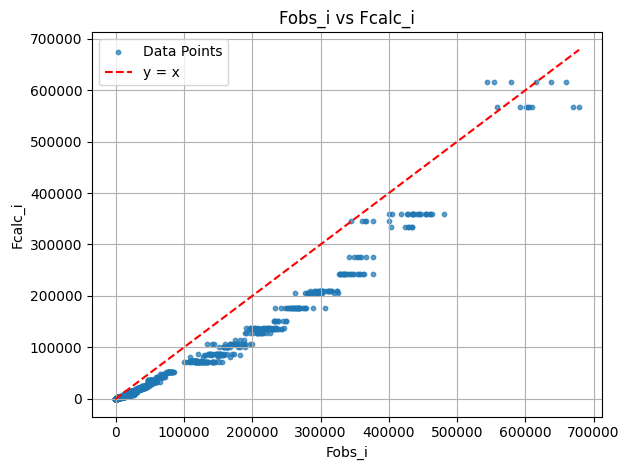

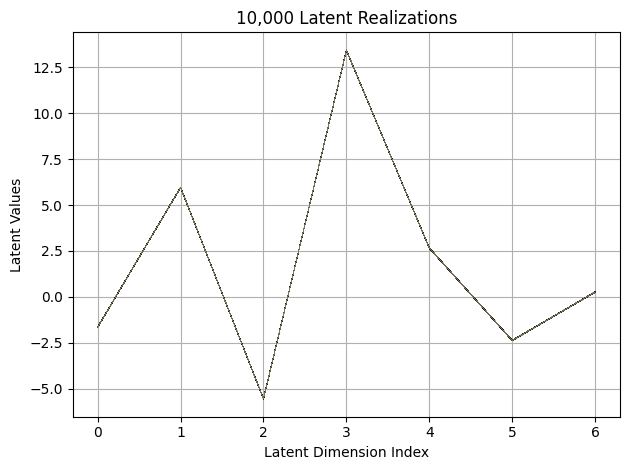

First 10 latent vectors from the VAE:
Sample 1: [-1.6387473344802856, 5.960520267486572, -5.555100440979004, 13.430624008178711, 2.659179449081421, -2.359877347946167, 0.2622692286968231]
Sample 2: [-1.6549094915390015, 5.957272052764893, -5.557445526123047, 13.456379890441895, 2.666973114013672, -2.3734140396118164, 0.25823280215263367]
Sample 3: [-1.6508817672729492, 5.959665775299072, -5.542555809020996, 13.439837455749512, 2.6585946083068848, -2.372715950012207, 0.26408079266548157]
Sample 4: [-1.6567970514297485, 5.963276386260986, -5.555654525756836, 13.430496215820312, 2.6657238006591797, -2.377657175064087, 0.2624310851097107]
Sample 5: [-1.657880425453186, 5.9615654945373535, -5.553961753845215, 13.430941581726074, 2.6619906425476074, -2.365983247756958, 0.25723275542259216]
Sample 6: [-1.6611740589141846, 5.959589958190918, -5.5536274909973145, 13.443914413452148, 2.644838333129883, -2.3693928718566895, 0.263960063457489]
Sample 7: [-1.6574344635009766, 5.952165126800537, -5.

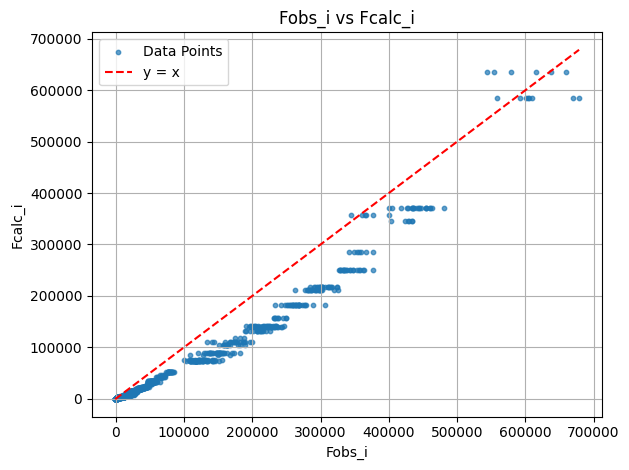

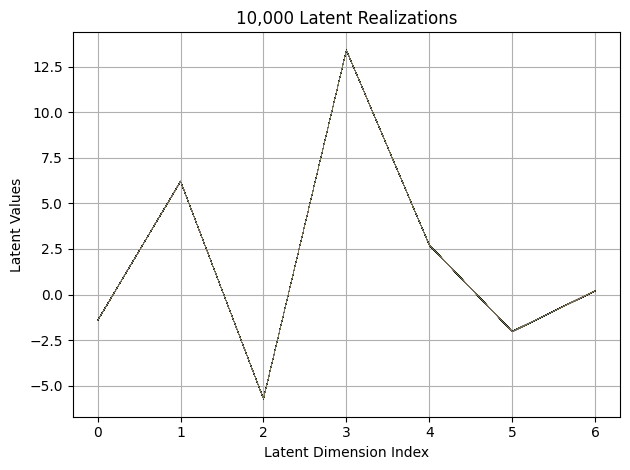

First 10 latent vectors from the VAE:
Sample 1: [-1.4109240770339966, 6.211941242218018, -5.719147205352783, 13.40565013885498, 2.723219871520996, -2.0283148288726807, 0.19448867440223694]
Sample 2: [-1.4151214361190796, 6.209805965423584, -5.707757949829102, 13.396486282348633, 2.714962959289551, -2.0300652980804443, 0.19948604702949524]
Sample 3: [-1.4231975078582764, 6.19550895690918, -5.713741302490234, 13.394786834716797, 2.720536231994629, -2.018315315246582, 0.2045191079378128]
Sample 4: [-1.4304248094558716, 6.213028430938721, -5.699670791625977, 13.392640113830566, 2.72041916847229, -2.0269124507904053, 0.18911021947860718]
Sample 5: [-1.4298639297485352, 6.18480110168457, -5.700568675994873, 13.379311561584473, 2.7310714721679688, -2.035830020904541, 0.19752898812294006]
Sample 6: [-1.4165600538253784, 6.20416784286499, -5.716379642486572, 13.393754005432129, 2.719542980194092, -2.0211143493652344, 0.20402395725250244]
Sample 7: [-1.4205576181411743, 6.20093297958374, -5.7063

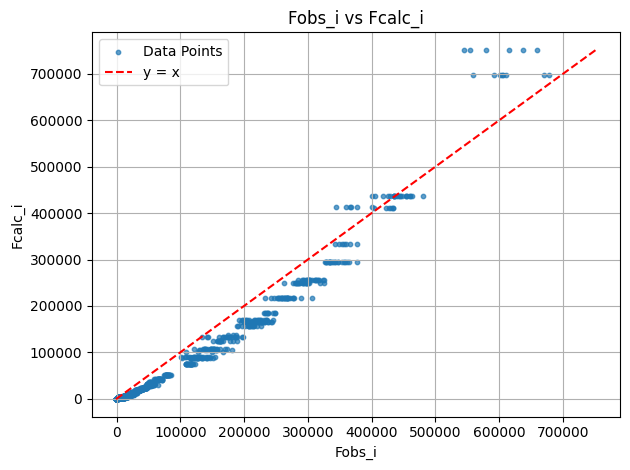

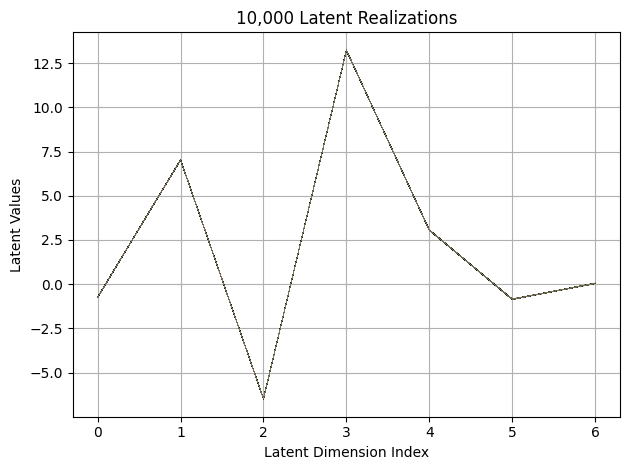

First 10 latent vectors from the VAE:
Sample 1: [-0.7342079281806946, 7.02475643157959, -6.481842517852783, 13.241560935974121, 3.0612523555755615, -0.8464397192001343, 0.04250035807490349]
Sample 2: [-0.7512174248695374, 7.03230094909668, -6.473484039306641, 13.242602348327637, 3.068532705307007, -0.8448156714439392, 0.04467485845088959]
Sample 3: [-0.7475368976593018, 7.024165153503418, -6.473763465881348, 13.223926544189453, 3.0613620281219482, -0.8574000597000122, 0.04463328421115875]
Sample 4: [-0.7288237810134888, 7.031228542327881, -6.481938362121582, 13.224157333374023, 3.060194492340088, -0.855308473110199, 0.0471777580678463]
Sample 5: [-0.7349785566329956, 7.036253929138184, -6.471010208129883, 13.238085746765137, 3.046410322189331, -0.8555071949958801, 0.044860921800136566]
Sample 6: [-0.7343905568122864, 7.0326762199401855, -6.478412628173828, 13.2320556640625, 3.068288803100586, -0.8463208675384521, 0.05676427483558655]
Sample 7: [-0.7369586229324341, 7.030233383178711, -

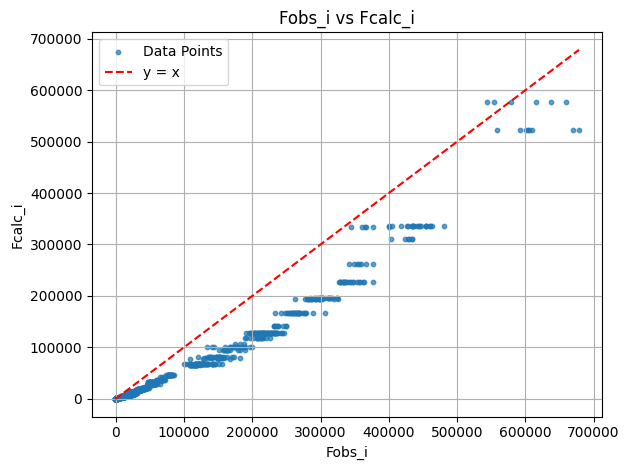

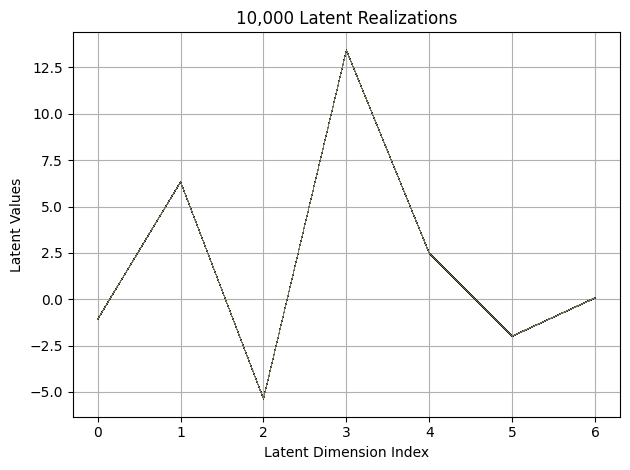

First 10 latent vectors from the VAE:
Sample 1: [-1.072919487953186, 6.325502872467041, -5.359803676605225, 13.436932563781738, 2.4857232570648193, -2.00484299659729, 0.06377094238996506]
Sample 2: [-1.0833367109298706, 6.334954738616943, -5.367010116577148, 13.426976203918457, 2.4764974117279053, -1.9905378818511963, 0.06514151394367218]
Sample 3: [-1.0817081928253174, 6.330099582672119, -5.361330986022949, 13.430234909057617, 2.4742963314056396, -1.992565631866455, 0.07579698413610458]
Sample 4: [-1.0711373090744019, 6.3350090980529785, -5.361844539642334, 13.429319381713867, 2.4787111282348633, -1.9851139783859253, 0.07413914799690247]
Sample 5: [-1.0892982482910156, 6.323394298553467, -5.374568939208984, 13.423380851745605, 2.4930057525634766, -1.9961209297180176, 0.0683131292462349]
Sample 6: [-1.0760101079940796, 6.338336944580078, -5.3642191886901855, 13.428559303283691, 2.470407009124756, -1.9824702739715576, 0.07865646481513977]
Sample 7: [-1.0765798091888428, 6.32533645629882

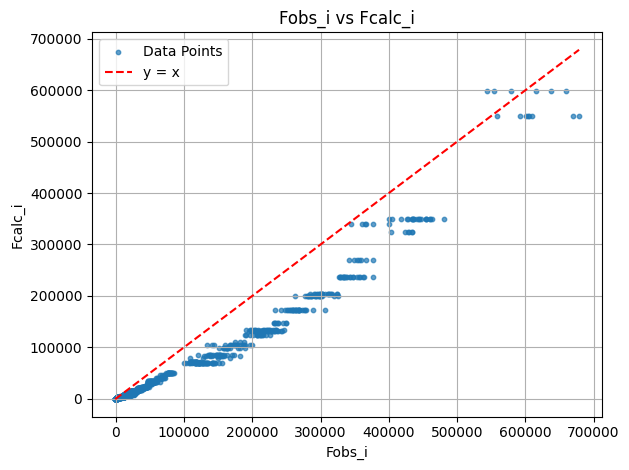

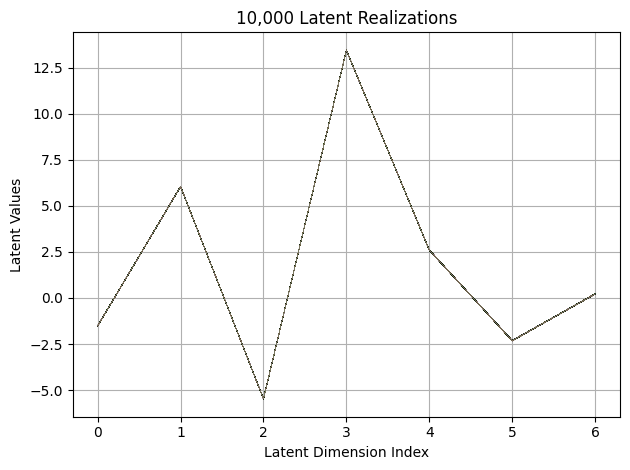

First 10 latent vectors from the VAE:
Sample 1: [-1.5118190050125122, 6.044617176055908, -5.4800920486450195, 13.426169395446777, 2.593015670776367, -2.3097565174102783, 0.23074835538864136]
Sample 2: [-1.5176315307617188, 6.035594940185547, -5.474732875823975, 13.44333553314209, 2.5885472297668457, -2.3160173892974854, 0.21505995094776154]
Sample 3: [-1.5260156393051147, 6.045138835906982, -5.4567341804504395, 13.416955947875977, 2.584561347961426, -2.3139235973358154, 0.22247515618801117]
Sample 4: [-1.5235294103622437, 6.041100025177002, -5.473706245422363, 13.432982444763184, 2.599961996078491, -2.3229620456695557, 0.2176767885684967]
Sample 5: [-1.5131973028182983, 6.041189193725586, -5.466048717498779, 13.439614295959473, 2.599144697189331, -2.3380179405212402, 0.20948511362075806]
Sample 6: [-1.5236538648605347, 6.052455425262451, -5.470852375030518, 13.44428539276123, 2.5911450386047363, -2.3091349601745605, 0.21576754748821259]
Sample 7: [-1.5243598222732544, 6.047891616821289

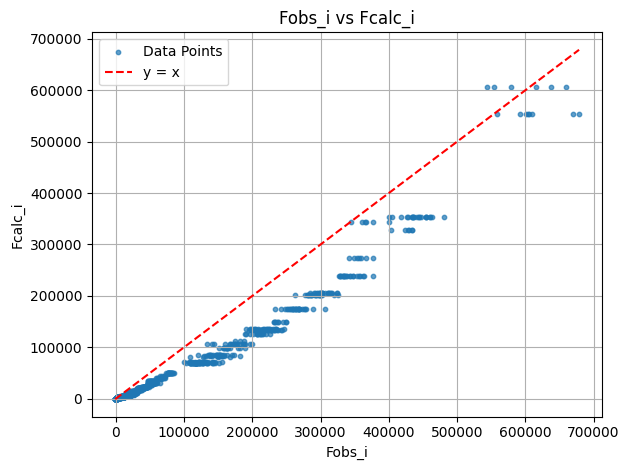

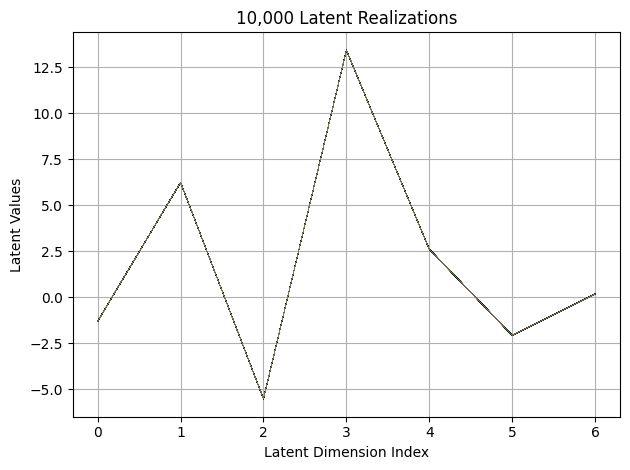

First 10 latent vectors from the VAE:
Sample 1: [-1.3169342279434204, 6.225040435791016, -5.524519920349121, 13.412323951721191, 2.594741106033325, -2.0632424354553223, 0.16083692014217377]
Sample 2: [-1.312563419342041, 6.218625545501709, -5.528196334838867, 13.415614128112793, 2.597161054611206, -2.0755555629730225, 0.15913879871368408]
Sample 3: [-1.3183598518371582, 6.219183444976807, -5.524231433868408, 13.41830825805664, 2.5934574604034424, -2.077697515487671, 0.16158261895179749]
Sample 4: [-1.313991904258728, 6.228682518005371, -5.530099391937256, 13.416413307189941, 2.592376470565796, -2.0787415504455566, 0.1648099273443222]
Sample 5: [-1.320396900177002, 6.22341251373291, -5.525641918182373, 13.41557502746582, 2.6038708686828613, -2.0826315879821777, 0.15370576083660126]
Sample 6: [-1.3125247955322266, 6.234441757202148, -5.533101558685303, 13.425130844116211, 2.6017487049102783, -2.087815046310425, 0.16138288378715515]
Sample 7: [-1.3182072639465332, 6.231269359588623, -5.53

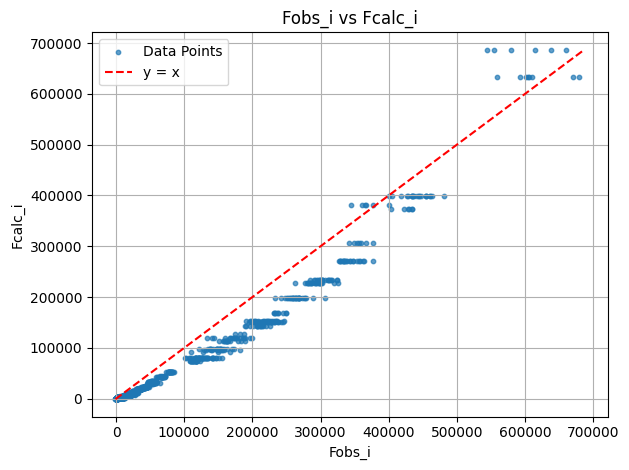

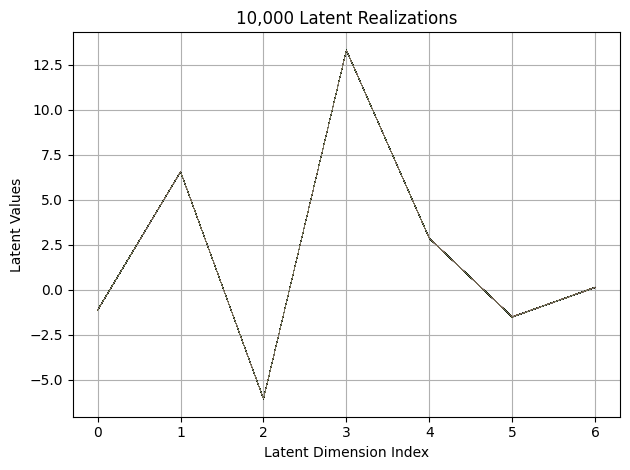

First 10 latent vectors from the VAE:
Sample 1: [-1.1275242567062378, 6.5685648918151855, -6.053646087646484, 13.319025993347168, 2.871135711669922, -1.4993410110473633, 0.1385335624217987]
Sample 2: [-1.12546968460083, 6.564439296722412, -6.04623556137085, 13.305912017822266, 2.8743667602539062, -1.5076040029525757, 0.13031721115112305]
Sample 3: [-1.1149953603744507, 6.566671371459961, -6.059459209442139, 13.314301490783691, 2.8702967166900635, -1.5022169351577759, 0.13980698585510254]
Sample 4: [-1.11758291721344, 6.57859468460083, -6.0534563064575195, 13.324286460876465, 2.856748580932617, -1.5029176473617554, 0.13539791107177734]
Sample 5: [-1.1328502893447876, 6.574615478515625, -6.061827182769775, 13.322242736816406, 2.8662269115448, -1.5003265142440796, 0.1265273541212082]
Sample 6: [-1.1216967105865479, 6.567906856536865, -6.0451273918151855, 13.320466041564941, 2.873145818710327, -1.4855331182479858, 0.13378924131393433]
Sample 7: [-1.1245105266571045, 6.562012672424316, -6.0

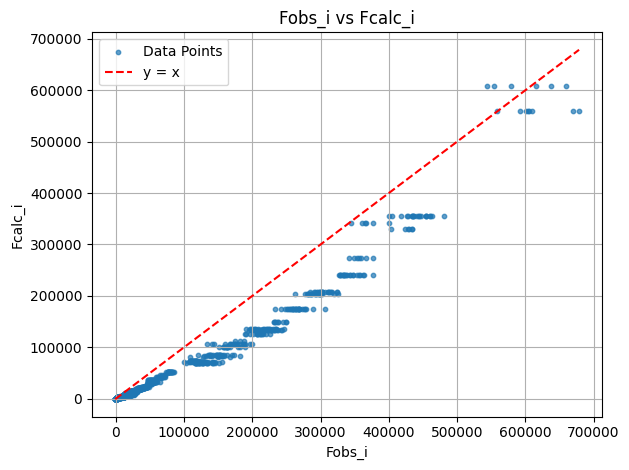

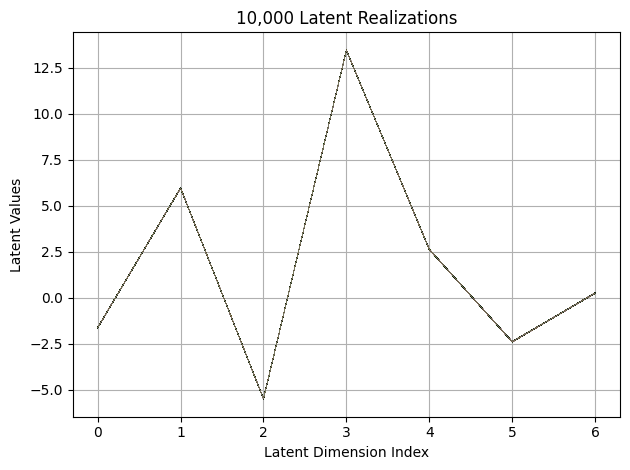

First 10 latent vectors from the VAE:
Sample 1: [-1.6397665739059448, 5.948409557342529, -5.490214824676514, 13.438665390014648, 2.6216461658477783, -2.4010443687438965, 0.23901627957820892]
Sample 2: [-1.6453863382339478, 5.949164867401123, -5.489686965942383, 13.445098876953125, 2.6345505714416504, -2.3885412216186523, 0.2564012110233307]
Sample 3: [-1.636824131011963, 5.949612617492676, -5.497572898864746, 13.442432403564453, 2.6234548091888428, -2.3911075592041016, 0.24540887773036957]
Sample 4: [-1.6470929384231567, 5.952780723571777, -5.498895168304443, 13.442203521728516, 2.626271963119507, -2.4014437198638916, 0.2528797388076782]
Sample 5: [-1.6215524673461914, 5.959591388702393, -5.498854637145996, 13.444650650024414, 2.629878282546997, -2.394716262817383, 0.25281351804733276]
Sample 6: [-1.6321934461593628, 5.959655284881592, -5.48938512802124, 13.456527709960938, 2.6387298107147217, -2.3933308124542236, 0.2489006519317627]
Sample 7: [-1.6347078084945679, 5.965724468231201, -

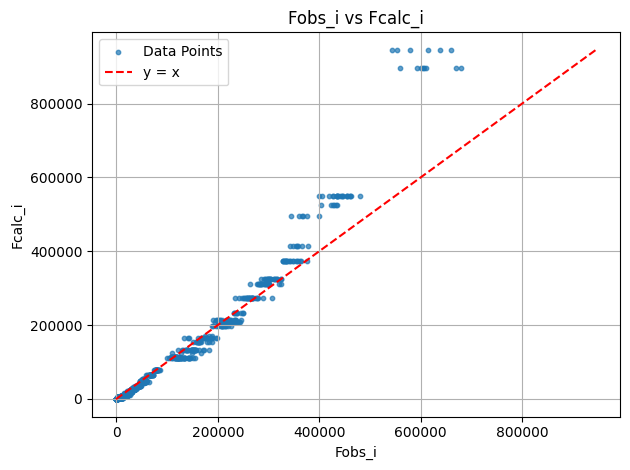

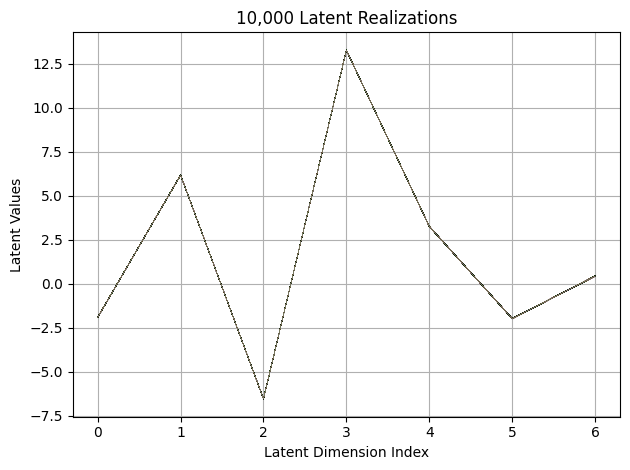

First 10 latent vectors from the VAE:
Sample 1: [-1.9083000421524048, 6.166987419128418, -6.529435157775879, 13.25353717803955, 3.2480034828186035, -1.9926680326461792, 0.43365880846977234]
Sample 2: [-1.9121134281158447, 6.170255661010742, -6.529054641723633, 13.245099067687988, 3.2501885890960693, -1.973471760749817, 0.44566118717193604]
Sample 3: [-1.908192753791809, 6.15920877456665, -6.533440589904785, 13.262801170349121, 3.2534050941467285, -1.9718765020370483, 0.4389243423938751]
Sample 4: [-1.9139783382415771, 6.166806221008301, -6.531527519226074, 13.254819869995117, 3.2465720176696777, -1.986165165901184, 0.4233904480934143]
Sample 5: [-1.9031047821044922, 6.175301551818848, -6.527953147888184, 13.266342163085938, 3.2543885707855225, -1.9786988496780396, 0.43101298809051514]
Sample 6: [-1.9182432889938354, 6.175660610198975, -6.535549640655518, 13.253722190856934, 3.2575926780700684, -1.9859403371810913, 0.4346542954444885]
Sample 7: [-1.9475898742675781, 6.181511402130127, -

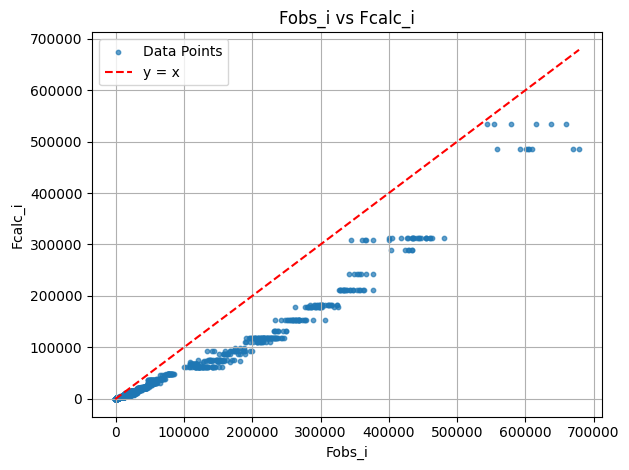

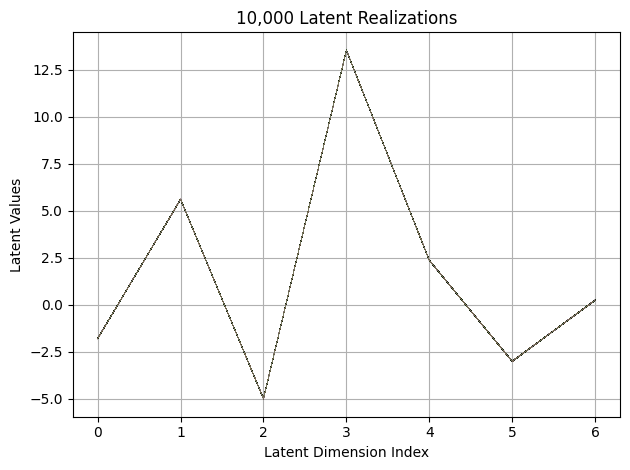

First 10 latent vectors from the VAE:
Sample 1: [-1.8052886724472046, 5.602972984313965, -4.994687080383301, 13.517489433288574, 2.368171453475952, -2.9985923767089844, 0.25078538060188293]
Sample 2: [-1.804376244544983, 5.604647636413574, -4.969454765319824, 13.523031234741211, 2.3660871982574463, -3.0046427249908447, 0.23836329579353333]
Sample 3: [-1.8027693033218384, 5.603962421417236, -4.985554218292236, 13.51298713684082, 2.357776641845703, -3.009251356124878, 0.24698792397975922]
Sample 4: [-1.7980401515960693, 5.615140914916992, -4.982411861419678, 13.532468795776367, 2.3623385429382324, -2.9973816871643066, 0.2505858242511749]
Sample 5: [-1.7956196069717407, 5.6203837394714355, -4.994876861572266, 13.524422645568848, 2.3526058197021484, -3.007713794708252, 0.24696552753448486]
Sample 6: [-1.7988760471343994, 5.607114791870117, -4.982626914978027, 13.518733024597168, 2.362291097640991, -3.0077621936798096, 0.23971593379974365]
Sample 7: [-1.7931042909622192, 5.6030778884887695,

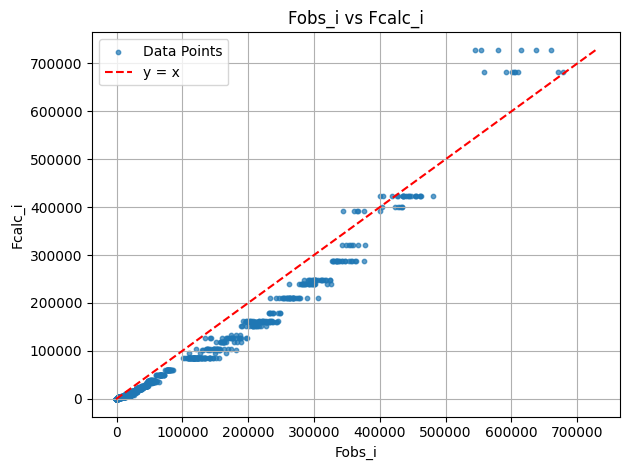

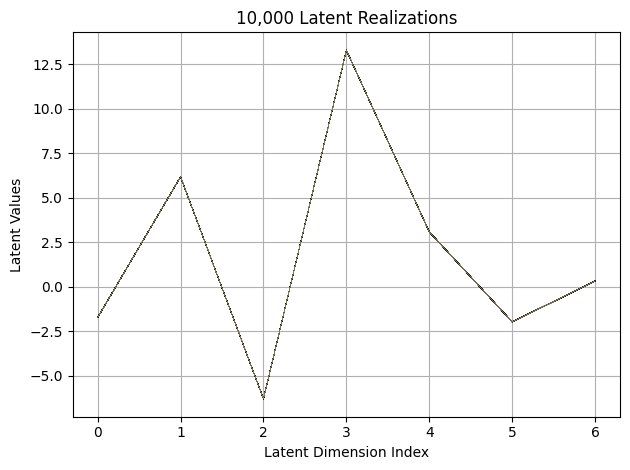

First 10 latent vectors from the VAE:
Sample 1: [-1.715302586555481, 6.193329811096191, -6.286262035369873, 13.288817405700684, 3.0874905586242676, -1.9730051755905151, 0.3290744423866272]
Sample 2: [-1.729155421257019, 6.172260284423828, -6.287682056427002, 13.314265251159668, 3.086027145385742, -1.9693559408187866, 0.3358461260795593]
Sample 3: [-1.7130496501922607, 6.184267520904541, -6.288809776306152, 13.299688339233398, 3.091580390930176, -1.9724479913711548, 0.3241806924343109]
Sample 4: [-1.720465898513794, 6.177959442138672, -6.297259330749512, 13.299299240112305, 3.092221260070801, -1.9744833707809448, 0.3273285925388336]
Sample 5: [-1.71283757686615, 6.184276580810547, -6.288431644439697, 13.308538436889648, 3.0953142642974854, -1.9663963317871094, 0.3416031002998352]
Sample 6: [-1.7173240184783936, 6.19015645980835, -6.283090114593506, 13.291194915771484, 3.084843873977661, -1.9654004573822021, 0.33016568422317505]
Sample 7: [-1.718392014503479, 6.1826324462890625, -6.28757

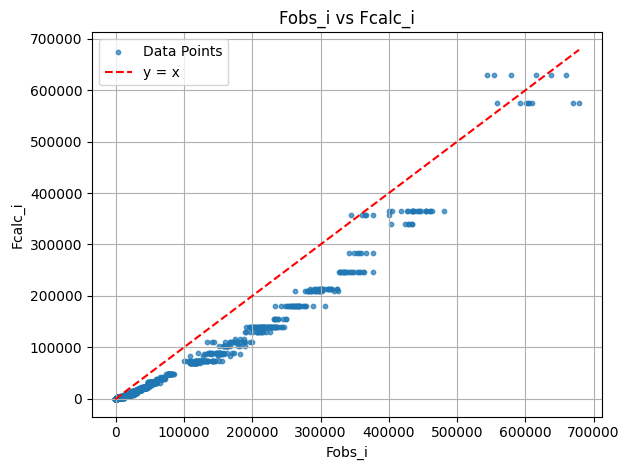

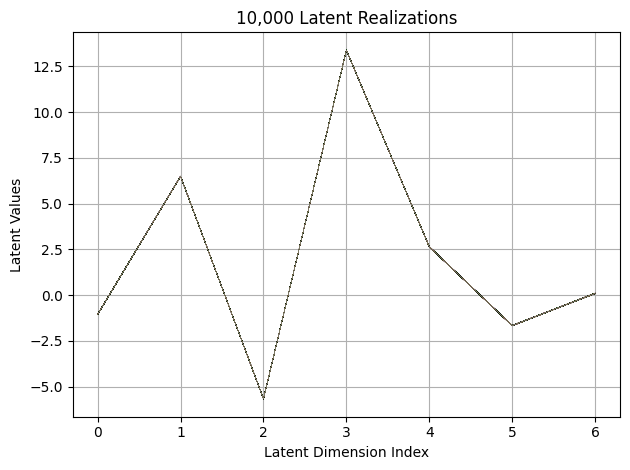

First 10 latent vectors from the VAE:
Sample 1: [-1.0612871646881104, 6.4932146072387695, -5.6729817390441895, 13.382165908813477, 2.6453583240509033, -1.6623644828796387, 0.09740454703569412]
Sample 2: [-1.0546103715896606, 6.494095325469971, -5.66282320022583, 13.392038345336914, 2.637664794921875, -1.6762675046920776, 0.0950300469994545]
Sample 3: [-1.0614114999771118, 6.492549896240234, -5.674163341522217, 13.382926940917969, 2.6501729488372803, -1.66170072555542, 0.08855889737606049]
Sample 4: [-1.0516833066940308, 6.4843621253967285, -5.665177345275879, 13.379996299743652, 2.641892910003662, -1.6724650859832764, 0.0944543108344078]
Sample 5: [-1.0518600940704346, 6.490813255310059, -5.653854846954346, 13.38167953491211, 2.644954204559326, -1.6597007513046265, 0.10053584724664688]
Sample 6: [-1.044162392616272, 6.496288299560547, -5.664883613586426, 13.390456199645996, 2.6421239376068115, -1.6576236486434937, 0.08380134403705597]
Sample 7: [-1.054479718208313, 6.482207298278809, -

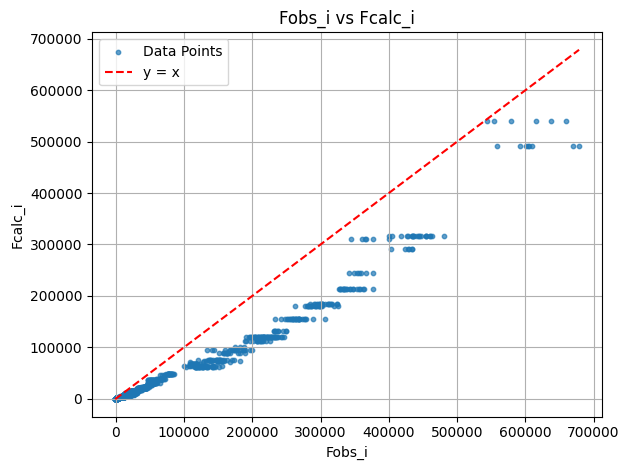

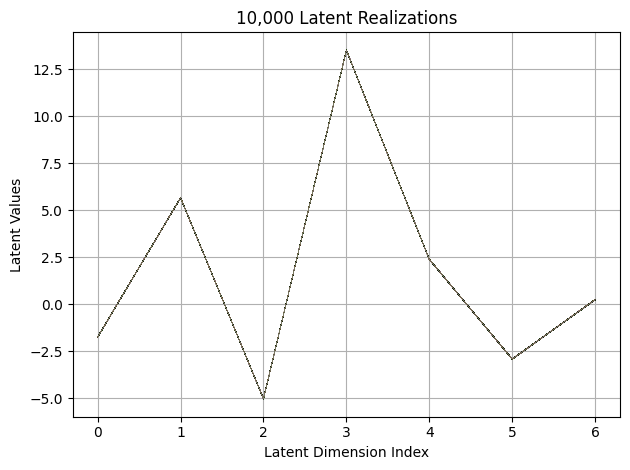

First 10 latent vectors from the VAE:
Sample 1: [-1.7534681558609009, 5.654562950134277, -5.037442207336426, 13.524812698364258, 2.375722646713257, -2.913055658340454, 0.23364979028701782]
Sample 2: [-1.740092158317566, 5.650467872619629, -5.035105228424072, 13.50892162322998, 2.396268844604492, -2.9186367988586426, 0.2549148201942444]
Sample 3: [-1.7570958137512207, 5.662535667419434, -5.030970096588135, 13.5257568359375, 2.3832201957702637, -2.9188437461853027, 0.24195565283298492]
Sample 4: [-1.7600972652435303, 5.664048194885254, -5.034791946411133, 13.517358779907227, 2.3772358894348145, -2.921895980834961, 0.24970057606697083]
Sample 5: [-1.750771164894104, 5.66621208190918, -5.033083915710449, 13.518899917602539, 2.381263017654419, -2.9065680503845215, 0.23657764494419098]
Sample 6: [-1.751083493232727, 5.658137798309326, -5.049318313598633, 13.519736289978027, 2.394218921661377, -2.9230172634124756, 0.23302872478961945]
Sample 7: [-1.7578861713409424, 5.66693115234375, -5.03301

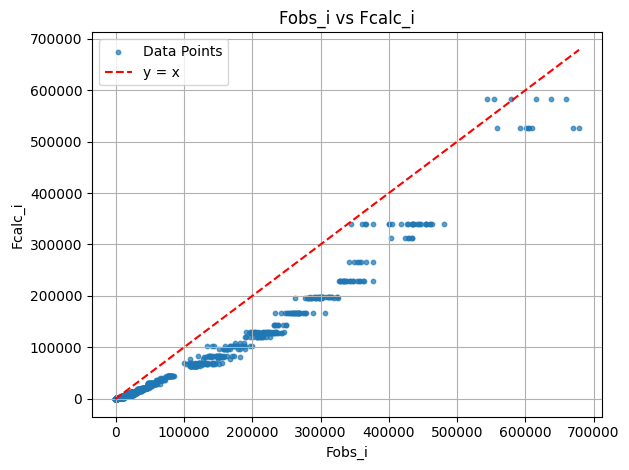

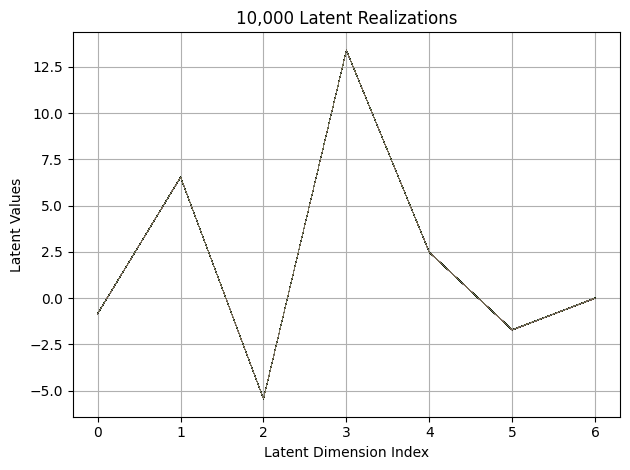

First 10 latent vectors from the VAE:
Sample 1: [-0.8554598093032837, 6.537559509277344, -5.4365153312683105, 13.397809982299805, 2.4823708534240723, -1.7191057205200195, 0.00669264467433095]
Sample 2: [-0.8294066190719604, 6.543120384216309, -5.440408229827881, 13.394416809082031, 2.4889159202575684, -1.7010095119476318, 0.010665763169527054]
Sample 3: [-0.8215383887290955, 6.53997802734375, -5.426994323730469, 13.396971702575684, 2.495265007019043, -1.7150812149047852, -0.0009628790430724621]
Sample 4: [-0.835541844367981, 6.54376745223999, -5.435344696044922, 13.394376754760742, 2.486438512802124, -1.7074774503707886, 0.010902155190706253]
Sample 5: [-0.8332130312919617, 6.542051792144775, -5.432852268218994, 13.39625358581543, 2.4946205615997314, -1.711950421333313, 0.001023316290229559]
Sample 6: [-0.8469794988632202, 6.53786039352417, -5.435363292694092, 13.402626037597656, 2.49773907661438, -1.7192654609680176, 0.0053342655301094055]
Sample 7: [-0.8401858806610107, 6.52989101409

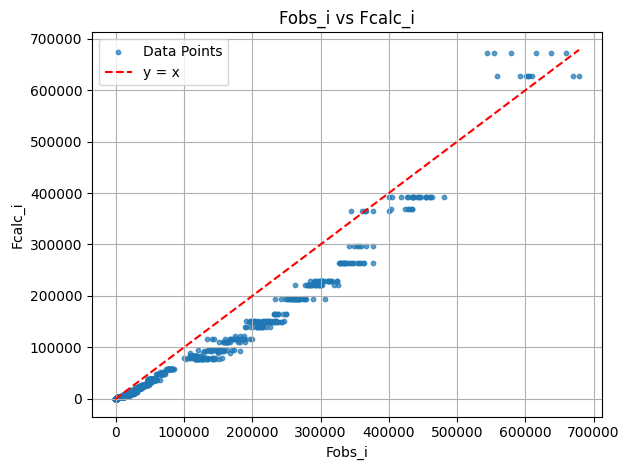

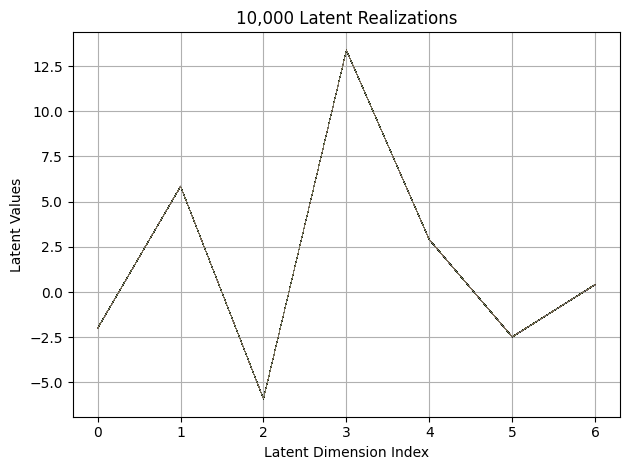

First 10 latent vectors from the VAE:
Sample 1: [-2.001801013946533, 5.8476457595825195, -5.9102067947387695, 13.379263877868652, 2.8926217555999756, -2.47139835357666, 0.3952588438987732]
Sample 2: [-2.0010955333709717, 5.853948593139648, -5.906867980957031, 13.379201889038086, 2.8982346057891846, -2.483185052871704, 0.4119977355003357]
Sample 3: [-2.010554790496826, 5.849396705627441, -5.896759033203125, 13.380375862121582, 2.9072272777557373, -2.4876692295074463, 0.40530797839164734]
Sample 4: [-2.0061731338500977, 5.855774879455566, -5.899896144866943, 13.375288963317871, 2.901284694671631, -2.4764113426208496, 0.4290578067302704]
Sample 5: [-2.0018692016601562, 5.850912570953369, -5.899484634399414, 13.381696701049805, 2.902745485305786, -2.4924166202545166, 0.3960880637168884]
Sample 6: [-2.006500720977783, 5.8483076095581055, -5.911652088165283, 13.381180763244629, 2.8964149951934814, -2.4842844009399414, 0.41527116298675537]
Sample 7: [-2.005636215209961, 5.8490753173828125, -5

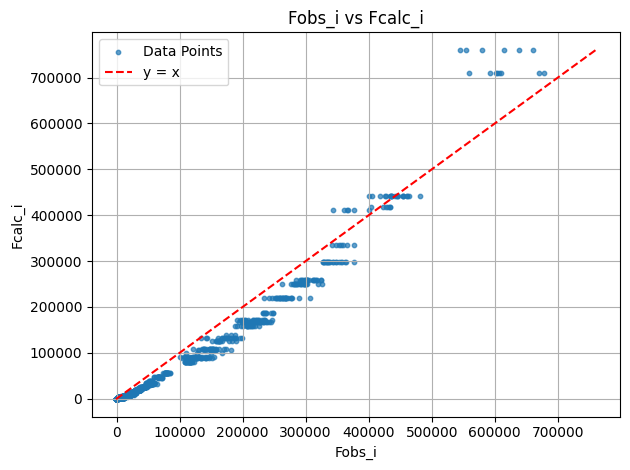

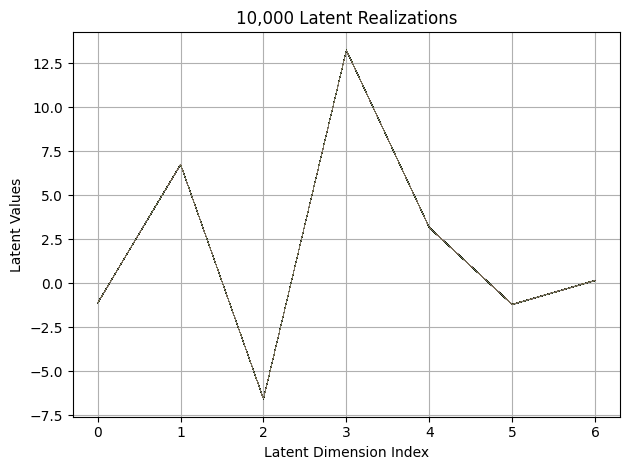

First 10 latent vectors from the VAE:
Sample 1: [-1.1151211261749268, 6.748359680175781, -6.569771766662598, 13.224287033081055, 3.1639585494995117, -1.2064111232757568, 0.1594536006450653]
Sample 2: [-1.1316673755645752, 6.755707740783691, -6.558138847351074, 13.223321914672852, 3.1561317443847656, -1.206404685974121, 0.16270650923252106]
Sample 3: [-1.1235016584396362, 6.739665985107422, -6.549128532409668, 13.231537818908691, 3.157364845275879, -1.2059986591339111, 0.15805131196975708]
Sample 4: [-1.104358196258545, 6.747222423553467, -6.565210819244385, 13.228249549865723, 3.1571855545043945, -1.2031322717666626, 0.15320467948913574]
Sample 5: [-1.113957405090332, 6.7431721687316895, -6.552829742431641, 13.23160171508789, 3.1490845680236816, -1.203345775604248, 0.14957261085510254]
Sample 6: [-1.1340593099594116, 6.746835231781006, -6.556769371032715, 13.232437133789062, 3.156325340270996, -1.2103320360183716, 0.1655687540769577]
Sample 7: [-1.1268601417541504, 6.7416253089904785, 

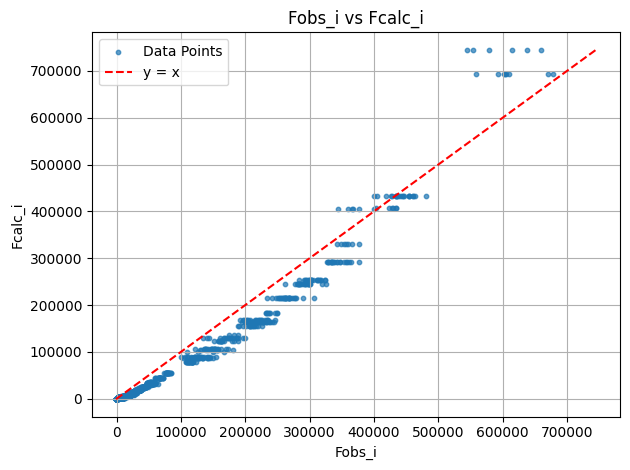

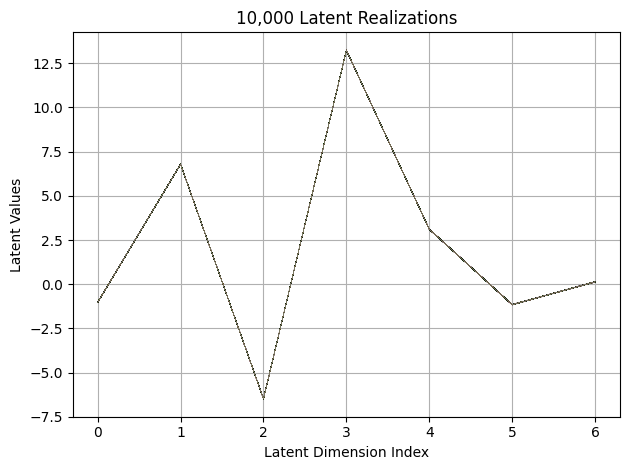

First 10 latent vectors from the VAE:
Sample 1: [-1.0404179096221924, 6.781091213226318, -6.486276149749756, 13.242696762084961, 3.1062052249908447, -1.1516590118408203, 0.13362960517406464]
Sample 2: [-1.0344297885894775, 6.788169860839844, -6.490097522735596, 13.250354766845703, 3.1008503437042236, -1.1647089719772339, 0.12719637155532837]
Sample 3: [-1.0455824136734009, 6.791286945343018, -6.491302967071533, 13.243428230285645, 3.1175026893615723, -1.1610257625579834, 0.12488512694835663]
Sample 4: [-1.036776065826416, 6.784399509429932, -6.4807329177856445, 13.235769271850586, 3.1146631240844727, -1.1608301401138306, 0.13917189836502075]
Sample 5: [-1.0349669456481934, 6.7827253341674805, -6.48097038269043, 13.246970176696777, 3.1137049198150635, -1.1522501707077026, 0.13298222422599792]
Sample 6: [-1.0400233268737793, 6.785747528076172, -6.489063739776611, 13.245928764343262, 3.109809160232544, -1.1550699472427368, 0.1216408759355545]
Sample 7: [-1.0266433954238892, 6.792112827301

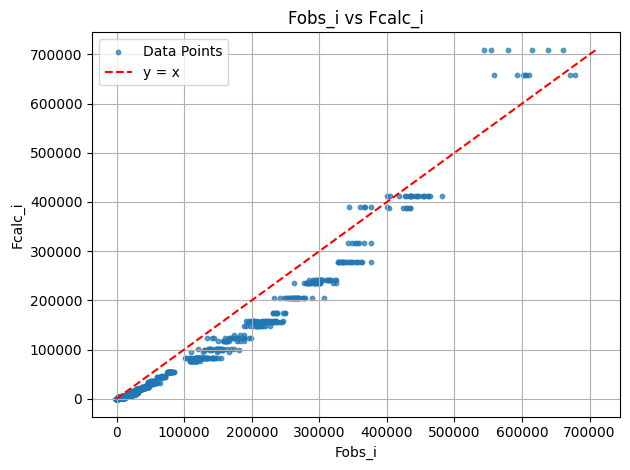

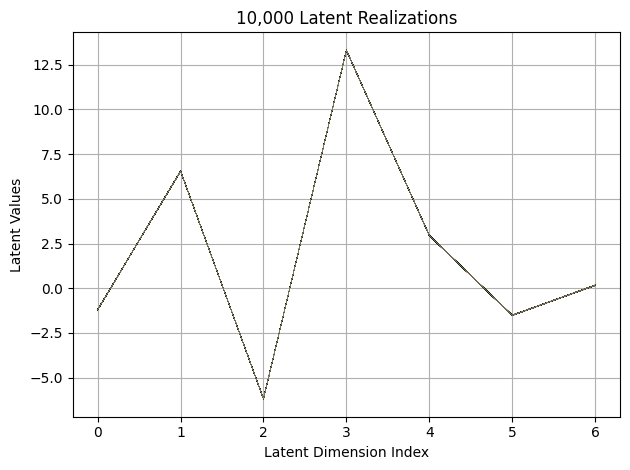

First 10 latent vectors from the VAE:
Sample 1: [-1.2025578022003174, 6.543182373046875, -6.1737961769104, 13.300638198852539, 2.9445977210998535, -1.5074414014816284, 0.15677465498447418]
Sample 2: [-1.197704792022705, 6.556013584136963, -6.176044464111328, 13.315296173095703, 2.9416658878326416, -1.5206067562103271, 0.16688430309295654]
Sample 3: [-1.2104812860488892, 6.541800498962402, -6.181227207183838, 13.30395793914795, 2.949949264526367, -1.5264997482299805, 0.16381952166557312]
Sample 4: [-1.1973680257797241, 6.546587944030762, -6.16398811340332, 13.30158805847168, 2.9516661167144775, -1.5034153461456299, 0.17258138954639435]
Sample 5: [-1.2002122402191162, 6.55291223526001, -6.172189712524414, 13.306407928466797, 2.940981864929199, -1.5078388452529907, 0.17103883624076843]
Sample 6: [-1.1933528184890747, 6.5558600425720215, -6.164833068847656, 13.291864395141602, 2.956272602081299, -1.5020076036453247, 0.1658802479505539]
Sample 7: [-1.2000880241394043, 6.5404558181762695, -6

C:\Users\USER\anaconda3\envs\gsas\Lib\site-packages\gpytorch\lazy\triangular_lazy_tensor.py:130: UserWarning: torch.triangular_solve is deprecated in favor of torch.linalg.solve_triangularand will be removed in a future PyTorch release.
torch.linalg.solve_triangular has its arguments reversed and does not return a copy of one of the inputs.
X = torch.triangular_solve(B, A).solution
should be replaced with
X = torch.linalg.solve_triangular(A, B). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\BatchLinearAlgebra.cpp:2259.)
  res = torch.triangular_solve(right_tensor, self.evaluate(), upper=self.upper).solution


#########################################################
Current best solutions at iteration: 1
Best params among evaluated samples: tensor([[1.0253, 0.9323]]) tensor(20.8800)
Best params from GP map: tensor([[1.0313, 0.9444]]) tensor(22.7900)


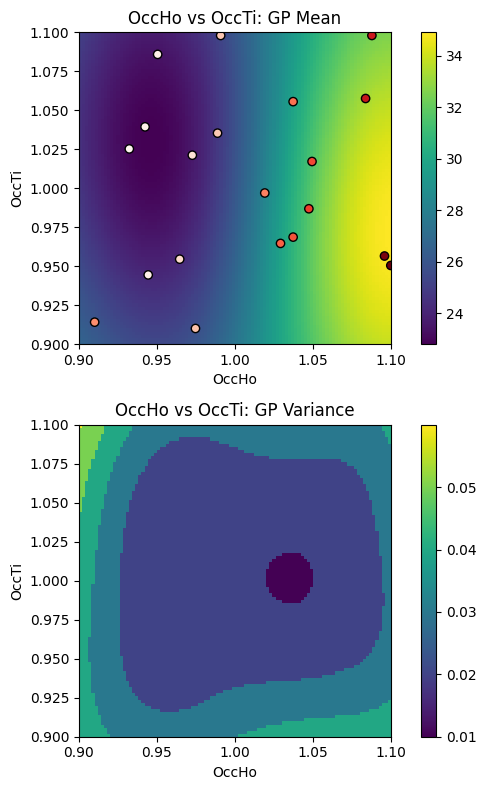

C:\Users\USER\AppData\Local\Temp\ipykernel_2064\2639534815.py:127: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Z[i] =  (y_means[i]-best_value-eta)/y_std[i]
C:\Users\USER\AppData\Local\Temp\ipykernel_2064\2639534815.py:128: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  EI_val[i] = (y_means[i]-best_value-eta)*norm.cdf(Z[i]) + y_std[i]*norm.pdf(Z[i])


EI: [4.51052375e-03 4.47639823e-03 4.44713794e-03 ... 8.78902210e-06
 1.01184269e-05 1.18077878e-05]
Function eval #21
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [1.0717171430587769, 0.9161615967750549]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7920
initial chi^2 1.7547e+05 with 2596 obs.
New scale: 0.7920
Cycle 0: 0.58s, Chi**2: 1.5109e+05 for 2596 obs., Lambda: 0,  Delta: 0.139, SVD=0
New scale: 0.7920
Maximum shift/esd = -41.765 for a

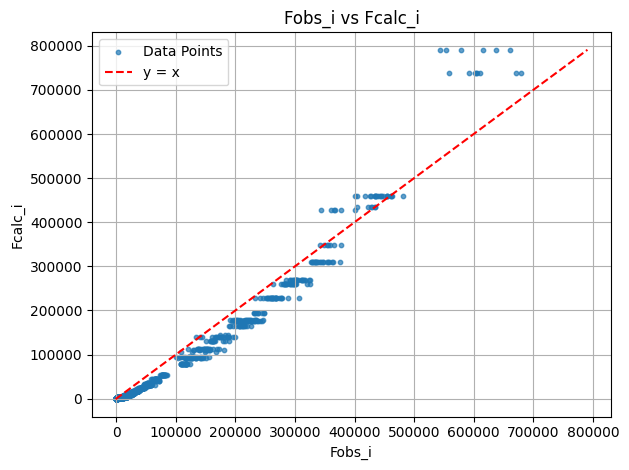

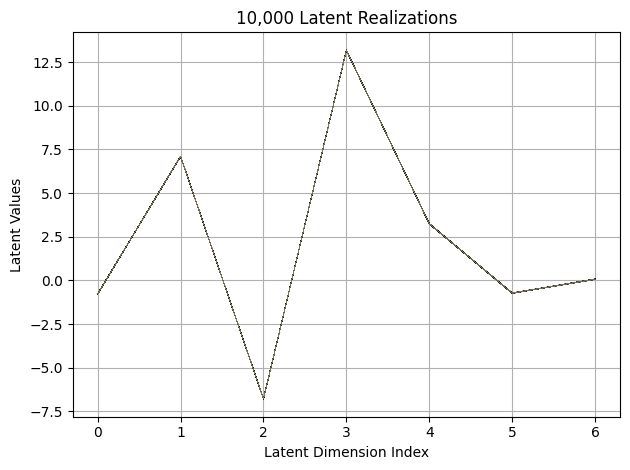

First 10 latent vectors from the VAE:
Sample 1: [-0.7698043584823608, 7.097716808319092, -6.783937454223633, 13.161567687988281, 3.240870952606201, -0.7336245179176331, 0.06706249713897705]
Sample 2: [-0.7700619697570801, 7.102357387542725, -6.775405406951904, 13.169035911560059, 3.239854335784912, -0.7237265110015869, 0.06509866565465927]
Sample 3: [-0.7814854383468628, 7.096653461456299, -6.771998882293701, 13.18147087097168, 3.238210916519165, -0.7299809455871582, 0.08394425362348557]
Sample 4: [-0.7792273163795471, 7.0973405838012695, -6.779773712158203, 13.177655220031738, 3.236609697341919, -0.7269725799560547, 0.07675230503082275]
Sample 5: [-0.7765056490898132, 7.111569404602051, -6.778458595275879, 13.166008949279785, 3.2420670986175537, -0.7356380820274353, 0.07257204502820969]
Sample 6: [-0.7651811838150024, 7.094884395599365, -6.778068542480469, 13.174633979797363, 3.235651969909668, -0.7412636280059814, 0.07074818760156631]
Sample 7: [-0.7790228128433228, 7.097432136535644

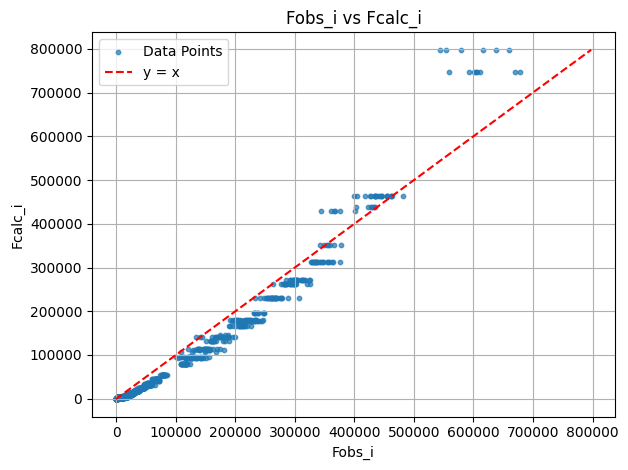

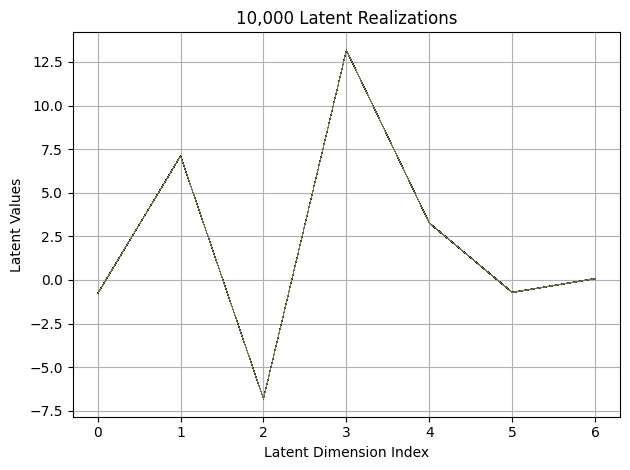

First 10 latent vectors from the VAE:
Sample 1: [-0.7733652591705322, 7.10712194442749, -6.798111438751221, 13.161710739135742, 3.261507749557495, -0.7149758338928223, 0.06971197575330734]
Sample 2: [-0.7934510111808777, 7.120861530303955, -6.815960884094238, 13.1665620803833, 3.270815372467041, -0.7134157419204712, 0.0722867101430893]
Sample 3: [-0.7701376676559448, 7.099759578704834, -6.821138381958008, 13.167886734008789, 3.2619292736053467, -0.7155951857566833, 0.05858997255563736]
Sample 4: [-0.7932500243186951, 7.1105122566223145, -6.806157112121582, 13.177206039428711, 3.273942708969116, -0.716903030872345, 0.07929052412509918]
Sample 5: [-0.785711407661438, 7.099920749664307, -6.802399635314941, 13.163650512695312, 3.2578659057617188, -0.7120429277420044, 0.06691634654998779]
Sample 6: [-0.7919967770576477, 7.114922523498535, -6.8075971603393555, 13.163578033447266, 3.2554802894592285, -0.7029116153717041, 0.07422506809234619]
Sample 7: [-0.7932997345924377, 7.100727558135986, 

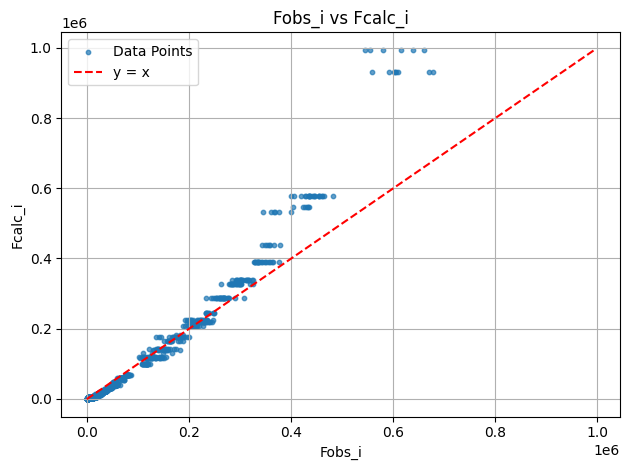

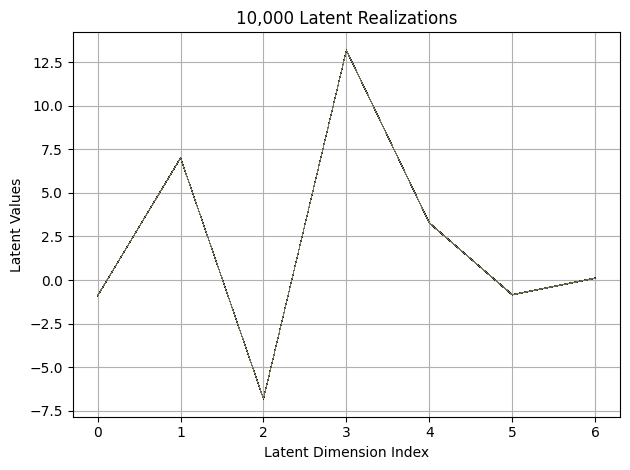

First 10 latent vectors from the VAE:
Sample 1: [-0.9056802988052368, 7.012968063354492, -6.814950466156006, 13.178359031677246, 3.2825980186462402, -0.8495649695396423, 0.10520390421152115]
Sample 2: [-0.9012284278869629, 7.004347801208496, -6.809833526611328, 13.175980567932129, 3.275097131729126, -0.8537078499794006, 0.11055126786231995]
Sample 3: [-0.8942258358001709, 7.008878707885742, -6.807922840118408, 13.174680709838867, 3.268432855606079, -0.8486700057983398, 0.11498703807592392]
Sample 4: [-0.9147979617118835, 6.995022296905518, -6.79966402053833, 13.175946235656738, 3.274235486984253, -0.8395673036575317, 0.1047634482383728]
Sample 5: [-0.9009935259819031, 7.007657051086426, -6.805586338043213, 13.169454574584961, 3.2739970684051514, -0.8412860631942749, 0.09782945364713669]
Sample 6: [-0.8828784227371216, 7.001036643981934, -6.795231342315674, 13.18230152130127, 3.2849862575531006, -0.8448988795280457, 0.10907300561666489]
Sample 7: [-0.8997597098350525, 6.989219665527344,

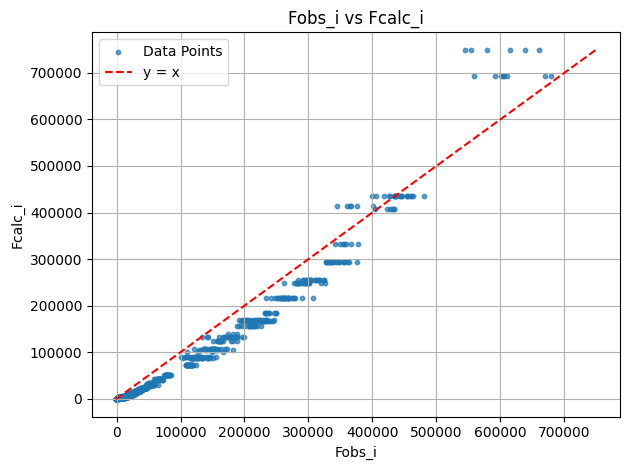

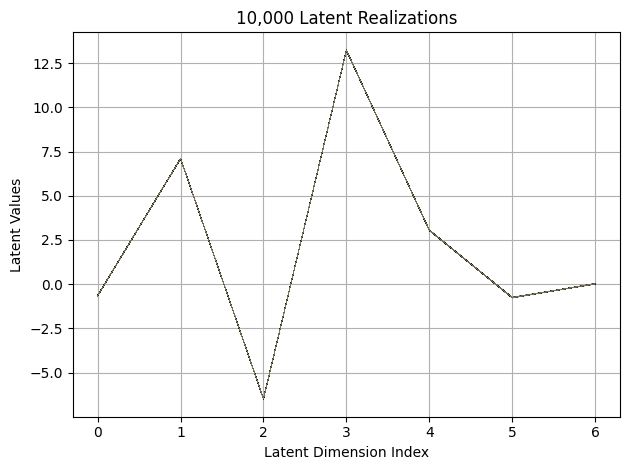

First 10 latent vectors from the VAE:
Sample 1: [-0.6557223796844482, 7.097294330596924, -6.475978374481201, 13.217679023742676, 3.0507891178131104, -0.7619267106056213, 0.008786731399595737]
Sample 2: [-0.6365474462509155, 7.096957206726074, -6.480241775512695, 13.228826522827148, 3.048762083053589, -0.7522835731506348, 0.025537589564919472]
Sample 3: [-0.6511808633804321, 7.100107192993164, -6.4692063331604, 13.230006217956543, 3.048135757446289, -0.7666406631469727, 0.021954519674181938]
Sample 4: [-0.6461257338523865, 7.097794055938721, -6.480027198791504, 13.22568416595459, 3.054232120513916, -0.7459777593612671, 0.02747194841504097]
Sample 5: [-0.6461572647094727, 7.095833778381348, -6.484804630279541, 13.213220596313477, 3.0521249771118164, -0.753296971321106, 0.008325871080160141]
Sample 6: [-0.6345597505569458, 7.09473991394043, -6.494058609008789, 13.219582557678223, 3.048572063446045, -0.7673790454864502, 0.028878161683678627]
Sample 7: [-0.6609753370285034, 7.08800506591796

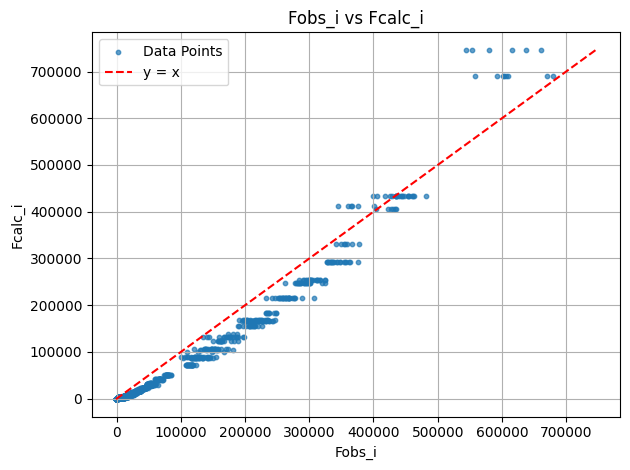

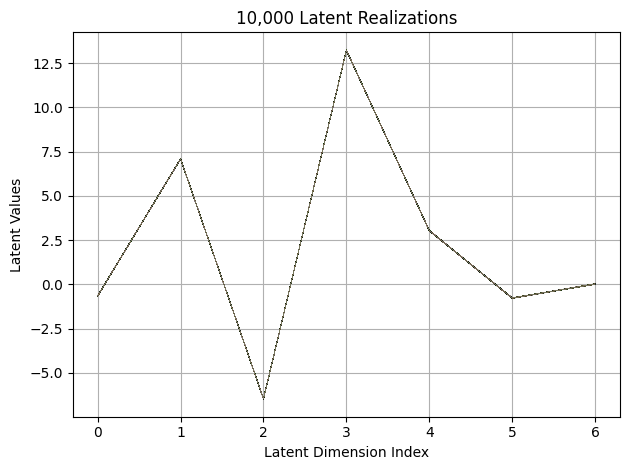

First 10 latent vectors from the VAE:
Sample 1: [-0.6614987254142761, 7.079955101013184, -6.47202730178833, 13.232901573181152, 3.0437519550323486, -0.7644096612930298, 0.01864916831254959]
Sample 2: [-0.652707576751709, 7.092494964599609, -6.468003749847412, 13.233373641967773, 3.035153865814209, -0.7798737287521362, 0.021196719259023666]
Sample 3: [-0.6561535596847534, 7.096521377563477, -6.459879398345947, 13.231101989746094, 3.0404016971588135, -0.7830219268798828, 0.028542429208755493]
Sample 4: [-0.6554131507873535, 7.102906227111816, -6.470771312713623, 13.213912010192871, 3.039173126220703, -0.7776861786842346, 0.017758004367351532]
Sample 5: [-0.6494137048721313, 7.089273452758789, -6.457668781280518, 13.23849868774414, 3.032451629638672, -0.77740079164505, 0.028795339167118073]
Sample 6: [-0.6393962502479553, 7.099742412567139, -6.4670329093933105, 13.227840423583984, 3.025799512863159, -0.7752083539962769, 0.014630286023020744]
Sample 7: [-0.6437504291534424, 7.0943517684936

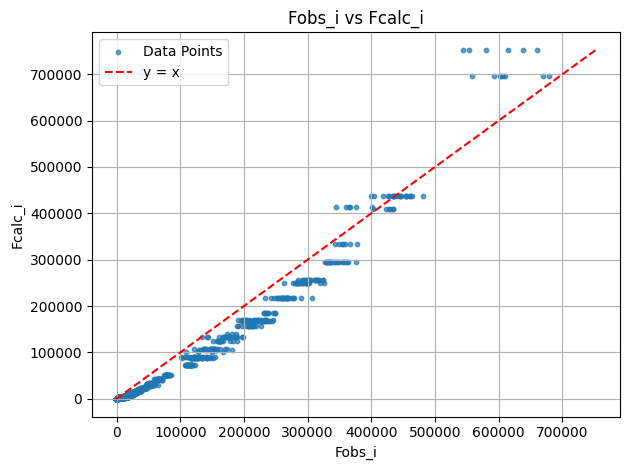

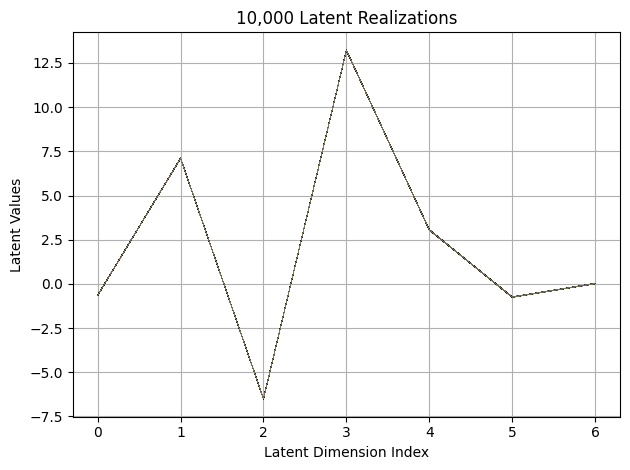

First 10 latent vectors from the VAE:
Sample 1: [-0.6418759226799011, 7.1049323081970215, -6.508278846740723, 13.216218948364258, 3.0615265369415283, -0.7448875904083252, 0.01717117801308632]
Sample 2: [-0.6415209174156189, 7.118497371673584, -6.503453254699707, 13.205219268798828, 3.0439231395721436, -0.7481370568275452, 0.029421348124742508]
Sample 3: [-0.6479853391647339, 7.107919216156006, -6.502286911010742, 13.208048820495605, 3.05798077583313, -0.7356318831443787, 0.022870473563671112]
Sample 4: [-0.6496383547782898, 7.100631237030029, -6.488612651824951, 13.227213859558105, 3.0625381469726562, -0.7369645833969116, 0.009287203662097454]
Sample 5: [-0.647257387638092, 7.112948894500732, -6.5002055168151855, 13.21510124206543, 3.0591585636138916, -0.752823531627655, 0.02664886973798275]
Sample 6: [-0.6416343450546265, 7.101377487182617, -6.50140380859375, 13.225541114807129, 3.0573270320892334, -0.7454705834388733, 0.02256360836327076]
Sample 7: [-0.652044951915741, 7.109880924224

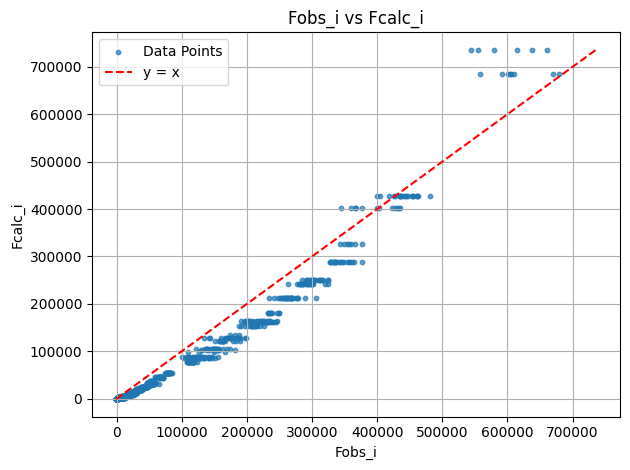

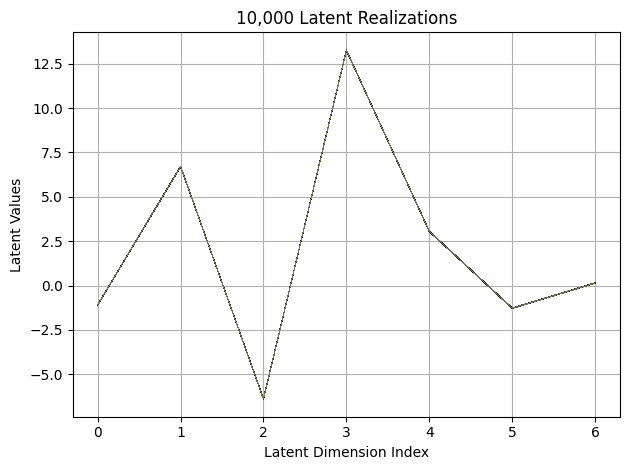

First 10 latent vectors from the VAE:
Sample 1: [-1.0877383947372437, 6.703514575958252, -6.387918949127197, 13.257136344909668, 3.0494396686553955, -1.2911080121994019, 0.13687559962272644]
Sample 2: [-1.0989989042282104, 6.707748889923096, -6.382568359375, 13.248401641845703, 3.052769184112549, -1.2684158086776733, 0.14608612656593323]
Sample 3: [-1.0929837226867676, 6.7159552574157715, -6.3859543800354, 13.247644424438477, 3.0570485591888428, -1.279059648513794, 0.13990750908851624]
Sample 4: [-1.0899323225021362, 6.69649600982666, -6.380283832550049, 13.255533218383789, 3.0501868724823, -1.276774525642395, 0.14748886227607727]
Sample 5: [-1.1084342002868652, 6.714113712310791, -6.378109455108643, 13.266721725463867, 3.059652090072632, -1.2760818004608154, 0.15012550354003906]
Sample 6: [-1.0825856924057007, 6.708347320556641, -6.373905181884766, 13.274832725524902, 3.053370237350464, -1.2729527950286865, 0.14872011542320251]
Sample 7: [-1.0842087268829346, 6.704298973083496, -6.370

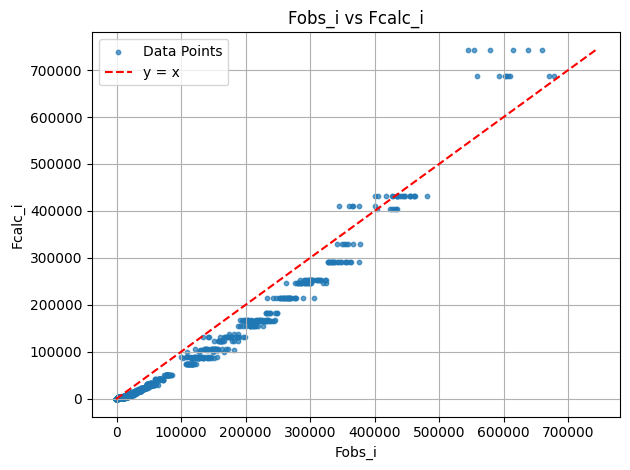

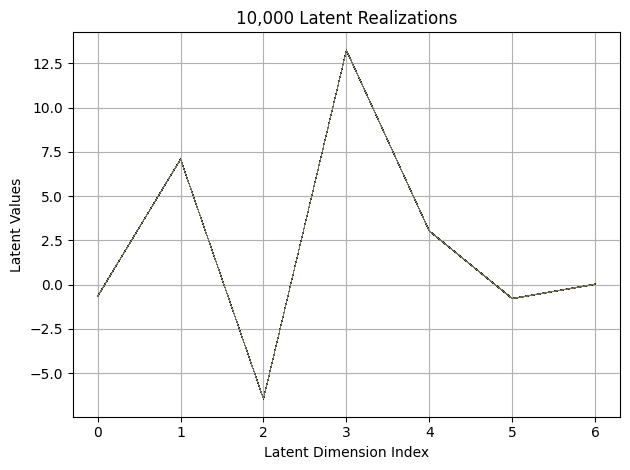

First 10 latent vectors from the VAE:
Sample 1: [-0.6458368897438049, 7.075019359588623, -6.453211307525635, 13.229132652282715, 3.0348310470581055, -0.783390462398529, 0.02730717696249485]
Sample 2: [-0.653016984462738, 7.091646194458008, -6.446548938751221, 13.226452827453613, 3.0229671001434326, -0.7864286303520203, 0.028910906985402107]
Sample 3: [-0.6622016429901123, 7.085869789123535, -6.431038856506348, 13.244119644165039, 3.026038885116577, -0.7825245261192322, 0.01359181571751833]
Sample 4: [-0.6613100171089172, 7.085302829742432, -6.444779872894287, 13.246635437011719, 3.034221887588501, -0.7816330790519714, 0.025228258222341537]
Sample 5: [-0.6556980013847351, 7.073911666870117, -6.442320823669434, 13.22375774383545, 3.028782367706299, -0.7782447934150696, 0.029267987236380577]
Sample 6: [-0.6531859040260315, 7.083503723144531, -6.4284491539001465, 13.229612350463867, 3.03611159324646, -0.7870755791664124, 0.021091153845191002]
Sample 7: [-0.6645953059196472, 7.0817928314208

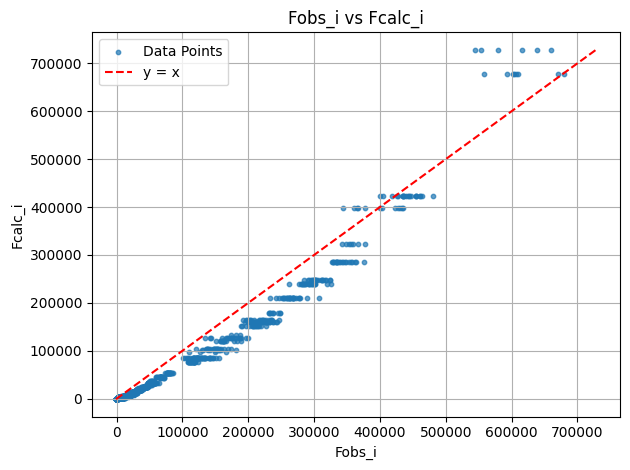

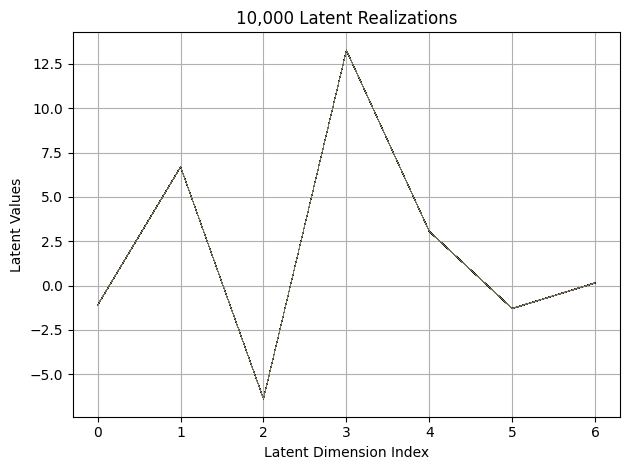

First 10 latent vectors from the VAE:
Sample 1: [-1.1099187135696411, 6.706254959106445, -6.363062858581543, 13.259181022644043, 3.049839735031128, -1.2819219827651978, 0.1418345719575882]
Sample 2: [-1.110005497932434, 6.694584369659424, -6.375800132751465, 13.260040283203125, 3.05367374420166, -1.2935154438018799, 0.13794060051441193]
Sample 3: [-1.108452320098877, 6.689544200897217, -6.371279716491699, 13.270257949829102, 3.0519185066223145, -1.2954522371292114, 0.13865366578102112]
Sample 4: [-1.104689598083496, 6.690436363220215, -6.389810562133789, 13.254172325134277, 3.047201633453369, -1.2992680072784424, 0.14382494986057281]
Sample 5: [-1.1047824621200562, 6.701905727386475, -6.370086669921875, 13.246220588684082, 3.0526015758514404, -1.2781591415405273, 0.16038337349891663]
Sample 6: [-1.105025053024292, 6.68255615234375, -6.386369705200195, 13.265766143798828, 3.0553371906280518, -1.2799897193908691, 0.15374833345413208]
Sample 7: [-1.1121454238891602, 6.6823577880859375, -6

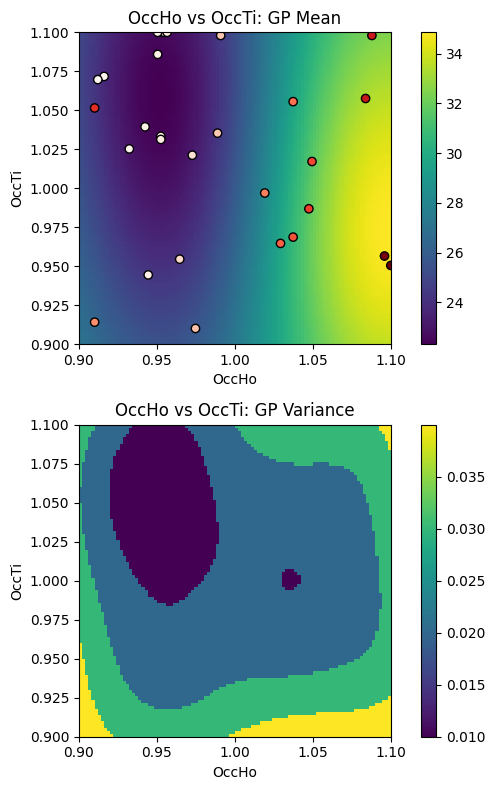

EI: [3.42843775e-03 3.41553055e-03 3.40952817e-03 ... 1.10363762e-05
 1.28446700e-05 1.51626882e-05]
Function eval #30
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [1.100000023841858, 0.9484848380088806]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7465
initial chi^2 2.0476e+05 with 2596 obs.
New scale: 0.7411
Cycle 0: 0.69s, Chi**2: 1.6399e+05 for 2596 obs., Lambda: 0,  Delta: 0.199, SVD=0
New scale: 0.7411
Maximum shift/esd = -55.695 for al

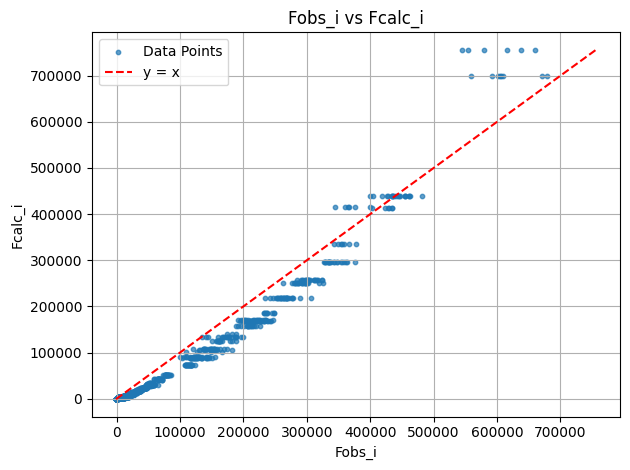

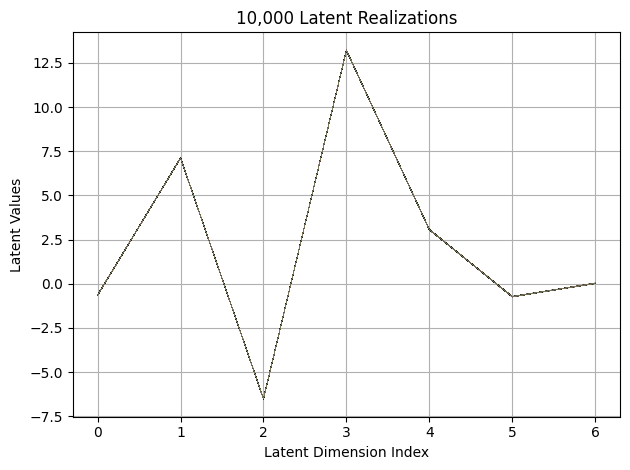

First 10 latent vectors from the VAE:
Sample 1: [-0.6391329169273376, 7.116518020629883, -6.517176151275635, 13.219009399414062, 3.0669662952423096, -0.7157943248748779, 0.012326149269938469]
Sample 2: [-0.6451011896133423, 7.129384517669678, -6.508633136749268, 13.207655906677246, 3.0658295154571533, -0.733387291431427, 0.022249393165111542]
Sample 3: [-0.6375712156295776, 7.117757320404053, -6.532931327819824, 13.226356506347656, 3.055574655532837, -0.7386696934700012, 0.02016431652009487]
Sample 4: [-0.6464438438415527, 7.109316825866699, -6.513911724090576, 13.214630126953125, 3.069187641143799, -0.7306985855102539, 0.010937538929283619]
Sample 5: [-0.6597560048103333, 7.113161563873291, -6.519795894622803, 13.224308967590332, 3.071131944656372, -0.7272153496742249, 0.019459957256913185]
Sample 6: [-0.6293196678161621, 7.115357398986816, -6.528805732727051, 13.224381446838379, 3.076185703277588, -0.7238408327102661, 0.013395488262176514]
Sample 7: [-0.6548202037811279, 7.1178798675

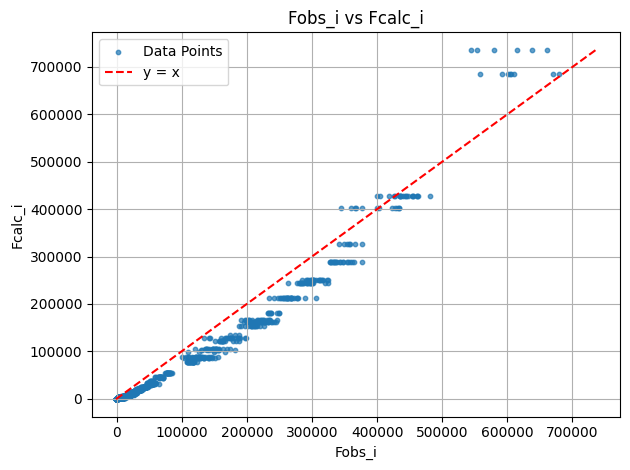

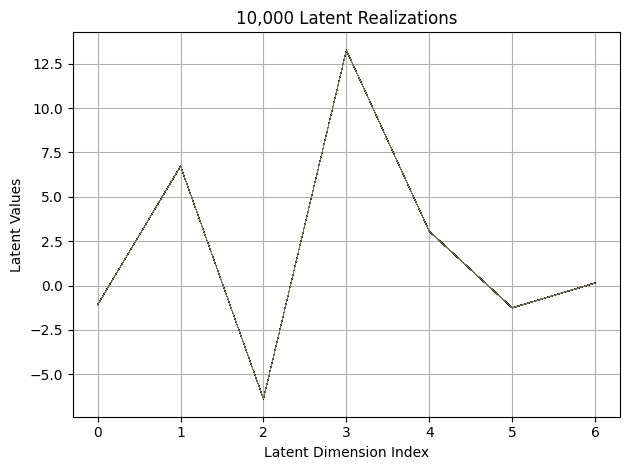

First 10 latent vectors from the VAE:
Sample 1: [-1.0801042318344116, 6.719482421875, -6.39070463180542, 13.26309585571289, 3.049297332763672, -1.261024832725525, 0.14254450798034668]
Sample 2: [-1.0725921392440796, 6.717862606048584, -6.373948574066162, 13.261626243591309, 3.0588836669921875, -1.2542486190795898, 0.14485818147659302]
Sample 3: [-1.0691120624542236, 6.718593597412109, -6.381539821624756, 13.267834663391113, 3.0458507537841797, -1.251785159111023, 0.14129900932312012]
Sample 4: [-1.0770070552825928, 6.715232849121094, -6.380866050720215, 13.26005744934082, 3.0535380840301514, -1.2523022890090942, 0.13554175198078156]
Sample 5: [-1.0834558010101318, 6.706387996673584, -6.382122993469238, 13.2648286819458, 3.069247007369995, -1.2631558179855347, 0.1508854776620865]
Sample 6: [-1.0908924341201782, 6.720459938049316, -6.375067710876465, 13.267104148864746, 3.066538095474243, -1.2527896165847778, 0.13308459520339966]
Sample 7: [-1.0765327215194702, 6.725671768188477, -6.3737

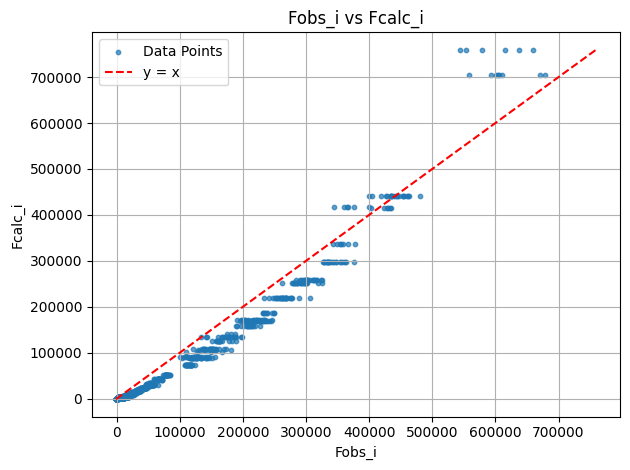

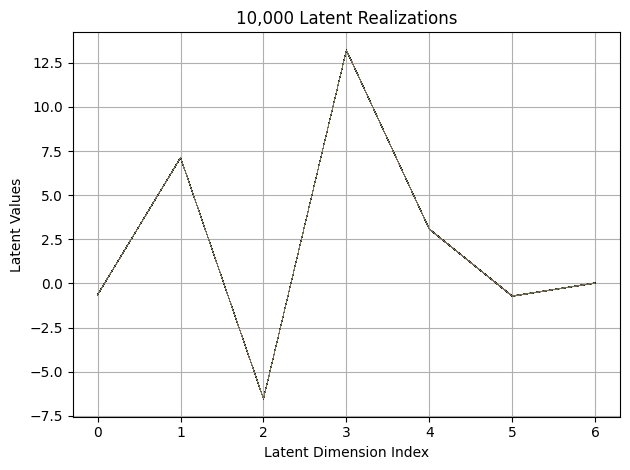

First 10 latent vectors from the VAE:
Sample 1: [-0.6405022740364075, 7.11644983291626, -6.5467915534973145, 13.21963119506836, 3.077605724334717, -0.724577784538269, 0.03674858808517456]
Sample 2: [-0.6351625919342041, 7.124313831329346, -6.536280632019043, 13.21816349029541, 3.0831894874572754, -0.7187509536743164, 0.017435820773243904]
Sample 3: [-0.6313676834106445, 7.133531093597412, -6.540111064910889, 13.205183982849121, 3.0792245864868164, -0.7205212116241455, 0.03027169033885002]
Sample 4: [-0.6316748261451721, 7.126287937164307, -6.53358268737793, 13.21328353881836, 3.0905799865722656, -0.7198895812034607, 0.02812116965651512]
Sample 5: [-0.6379380226135254, 7.127329349517822, -6.520247459411621, 13.210474967956543, 3.0801737308502197, -0.7214543223381042, 0.027163824066519737]
Sample 6: [-0.6375276446342468, 7.11502742767334, -6.528027534484863, 13.2094087600708, 3.0727643966674805, -0.7217612266540527, 0.012591377831995487]
Sample 7: [-0.6317221522331238, 7.130685806274414,

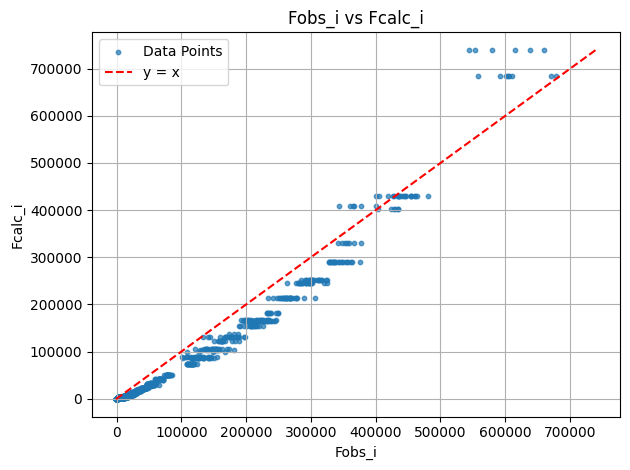

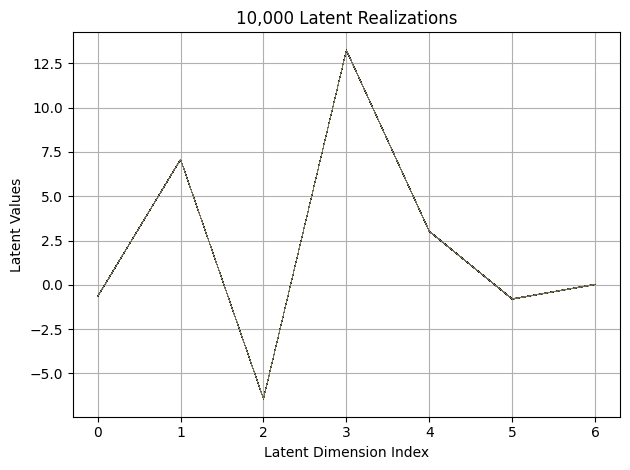

First 10 latent vectors from the VAE:
Sample 1: [-0.6573870778083801, 7.086436748504639, -6.418994426727295, 13.242554664611816, 3.0139265060424805, -0.7902721762657166, 0.03202739730477333]
Sample 2: [-0.6540696620941162, 7.079095840454102, -6.427535533905029, 13.226774215698242, 3.027406930923462, -0.7969263792037964, 0.02199195697903633]
Sample 3: [-0.6601322293281555, 7.065054893493652, -6.419200420379639, 13.23367977142334, 3.0233099460601807, -0.7993990778923035, 0.036289941519498825]
Sample 4: [-0.6559295058250427, 7.060009002685547, -6.42222785949707, 13.229028701782227, 3.023940086364746, -0.7991379499435425, 0.012236535549163818]
Sample 5: [-0.6616697311401367, 7.078364372253418, -6.421847343444824, 13.2205810546875, 3.0104269981384277, -0.7942290902137756, 0.029172169044613838]
Sample 6: [-0.661587119102478, 7.061943531036377, -6.422966480255127, 13.237936973571777, 3.0243775844573975, -0.7982982397079468, 0.01579238846898079]
Sample 7: [-0.6757030487060547, 7.07426452636718

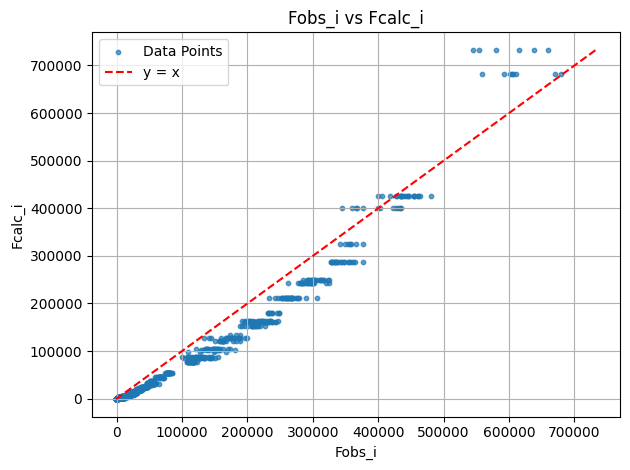

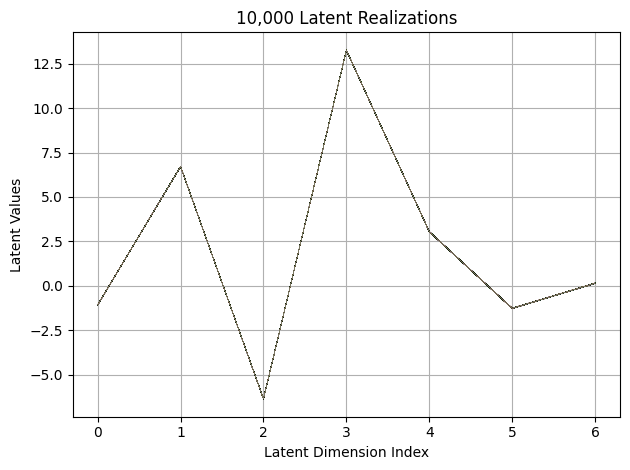

First 10 latent vectors from the VAE:
Sample 1: [-1.0760095119476318, 6.719443321228027, -6.362265586853027, 13.262320518493652, 3.0414679050445557, -1.27023446559906, 0.14764733612537384]
Sample 2: [-1.0774232149124146, 6.702568531036377, -6.36884880065918, 13.270276069641113, 3.037064790725708, -1.2786445617675781, 0.15411333739757538]
Sample 3: [-1.0789129734039307, 6.71591854095459, -6.3776397705078125, 13.25371265411377, 3.0443499088287354, -1.2675162553787231, 0.14078734815120697]
Sample 4: [-1.0860995054244995, 6.7034149169921875, -6.3705244064331055, 13.261765480041504, 3.0334298610687256, -1.273496389389038, 0.14715522527694702]
Sample 5: [-1.086229681968689, 6.705214977264404, -6.368009090423584, 13.243375778198242, 3.0413546562194824, -1.2681732177734375, 0.13207875192165375]
Sample 6: [-1.0862362384796143, 6.714482307434082, -6.371999263763428, 13.260642051696777, 3.035804033279419, -1.2915083169937134, 0.14452967047691345]
Sample 7: [-1.088071346282959, 6.714999198913574, 

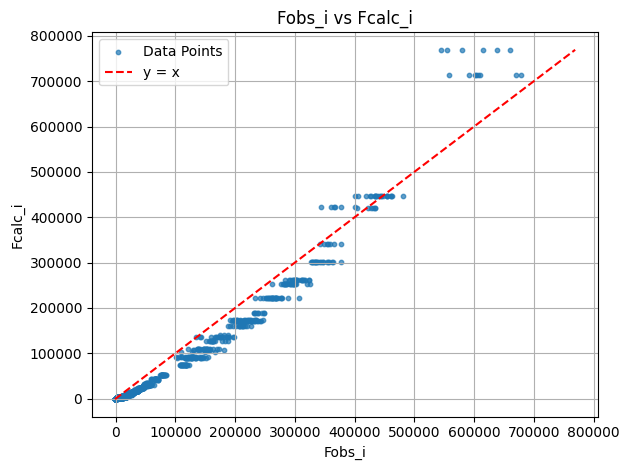

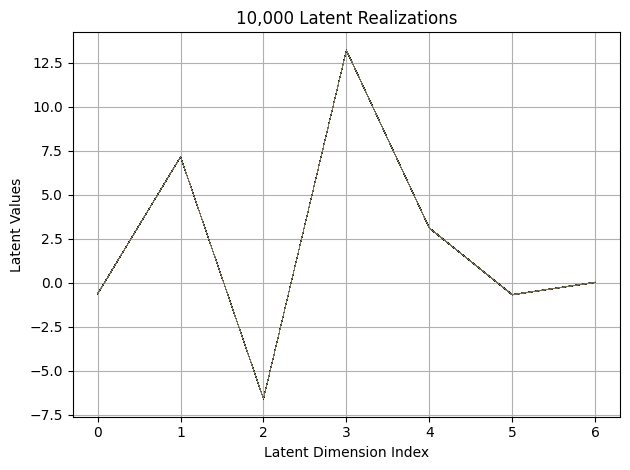

First 10 latent vectors from the VAE:
Sample 1: [-0.6296734809875488, 7.155608177185059, -6.5845794677734375, 13.207737922668457, 3.105334520339966, -0.6744895577430725, 0.01792885921895504]
Sample 2: [-0.6370088458061218, 7.154661178588867, -6.599054336547852, 13.197236061096191, 3.105590581893921, -0.6837552189826965, 0.017559386789798737]
Sample 3: [-0.6321755051612854, 7.15449857711792, -6.587158679962158, 13.188250541687012, 3.109830617904663, -0.6697016358375549, 0.010647671297192574]
Sample 4: [-0.6302544474601746, 7.148237228393555, -6.582073211669922, 13.201568603515625, 3.103013515472412, -0.6596768498420715, 0.007703886367380619]
Sample 5: [-0.6388981938362122, 7.156522274017334, -6.5944037437438965, 13.210624694824219, 3.1046512126922607, -0.6712222099304199, 0.02780623733997345]
Sample 6: [-0.6263392567634583, 7.156134128570557, -6.579728126525879, 13.195646286010742, 3.117044448852539, -0.6837247014045715, 0.012030391953885555]
Sample 7: [-0.6378838419914246, 7.1588559150

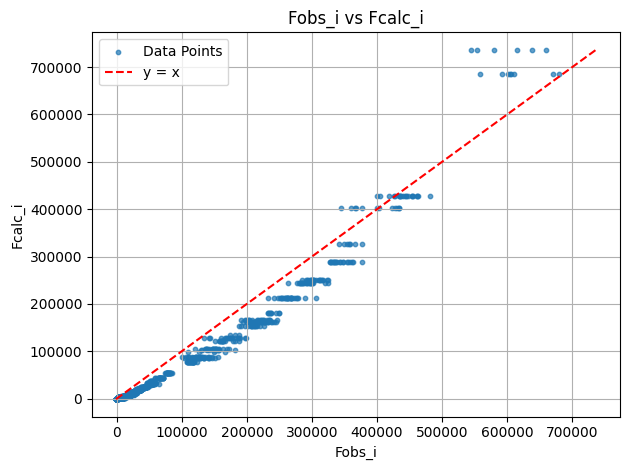

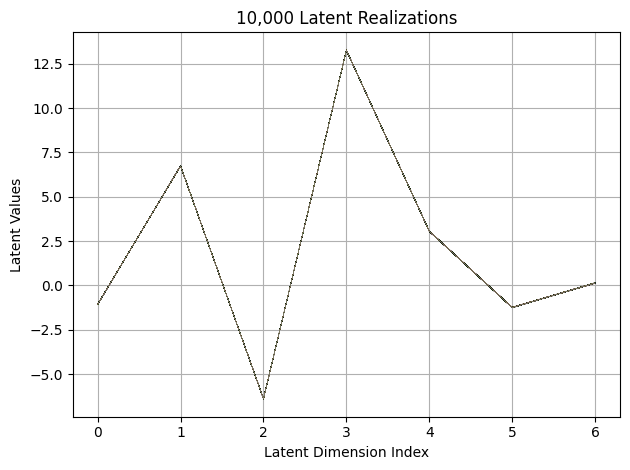

First 10 latent vectors from the VAE:
Sample 1: [-1.0649149417877197, 6.7332072257995605, -6.391635894775391, 13.245400428771973, 3.0472872257232666, -1.2399146556854248, 0.14909157156944275]
Sample 2: [-1.061435580253601, 6.73040771484375, -6.387379169464111, 13.24892807006836, 3.0488741397857666, -1.2487045526504517, 0.13827702403068542]
Sample 3: [-1.063781976699829, 6.742250442504883, -6.381104946136475, 13.24936294555664, 3.06192684173584, -1.239561915397644, 0.13911594450473785]
Sample 4: [-1.0576285123825073, 6.737692356109619, -6.385767459869385, 13.255584716796875, 3.051293134689331, -1.2281559705734253, 0.13119813799858093]
Sample 5: [-1.076743245124817, 6.724058151245117, -6.38911771774292, 13.25909423828125, 3.0566155910491943, -1.2437878847122192, 0.13991351425647736]
Sample 6: [-1.0648919343948364, 6.7272186279296875, -6.394068717956543, 13.26492977142334, 3.0624911785125732, -1.2380369901657104, 0.13485555350780487]
Sample 7: [-1.0661200284957886, 6.737679958343506, -6.3

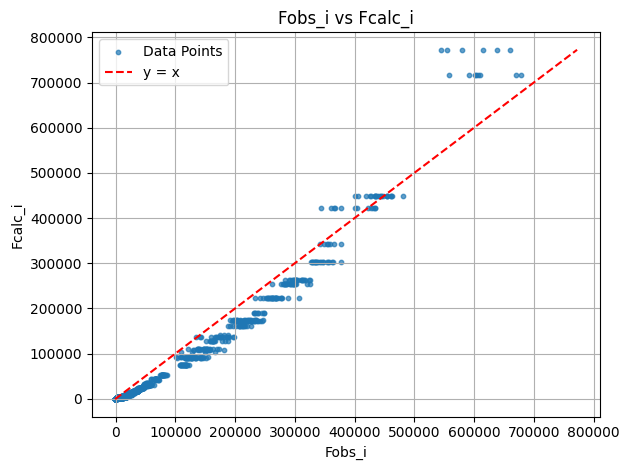

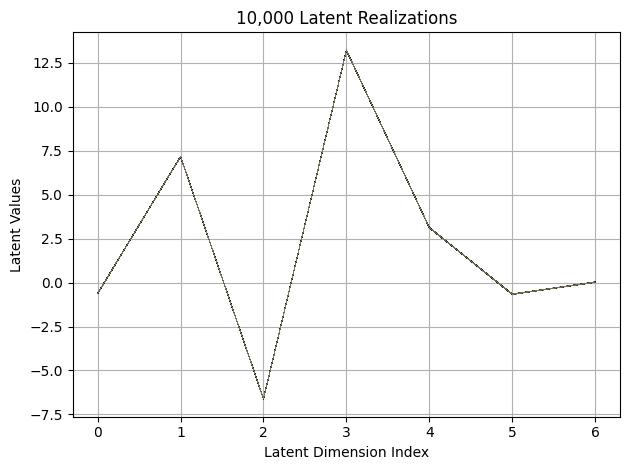

First 10 latent vectors from the VAE:
Sample 1: [-0.6350261569023132, 7.162015438079834, -6.603528022766113, 13.196163177490234, 3.105865001678467, -0.6658551692962646, 0.035940028727054596]
Sample 2: [-0.6281026005744934, 7.164949417114258, -6.608098030090332, 13.192089080810547, 3.119610548019409, -0.649985134601593, 0.0265679731965065]
Sample 3: [-0.614853024482727, 7.154294013977051, -6.6046905517578125, 13.188676834106445, 3.1134345531463623, -0.660261869430542, 0.020566437393426895]
Sample 4: [-0.618656575679779, 7.175232887268066, -6.612624645233154, 13.196764945983887, 3.1194424629211426, -0.6665998101234436, 0.019829299300909042]
Sample 5: [-0.6277937293052673, 7.158417701721191, -6.60116720199585, 13.196548461914062, 3.118802309036255, -0.6700153350830078, 0.011766110546886921]
Sample 6: [-0.6227815747261047, 7.1584696769714355, -6.608607292175293, 13.201883316040039, 3.1250405311584473, -0.6553332209587097, 0.022450894117355347]
Sample 7: [-0.6284257173538208, 7.162232875823

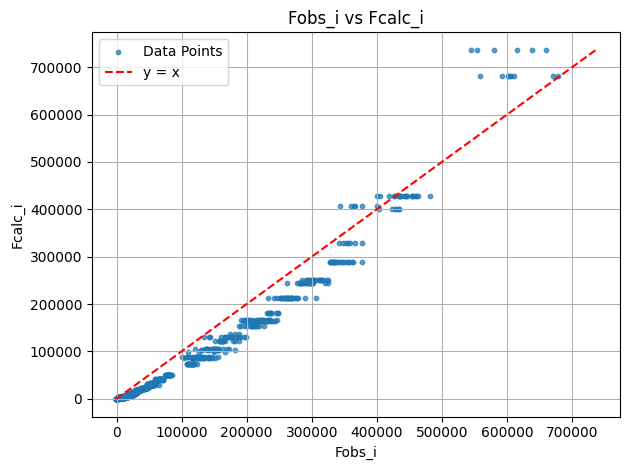

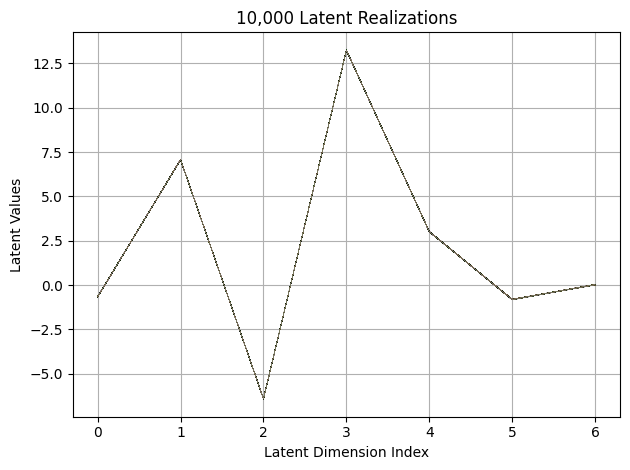

First 10 latent vectors from the VAE:
Sample 1: [-0.6662177443504333, 7.0802083015441895, -6.402960300445557, 13.239180564880371, 3.0102624893188477, -0.8166330456733704, 0.018352264538407326]
Sample 2: [-0.6605789661407471, 7.0663557052612305, -6.4058637619018555, 13.240970611572266, 3.0063507556915283, -0.8076506853103638, 0.02795909345149994]
Sample 3: [-0.6689529418945312, 7.05411958694458, -6.414218902587891, 13.228631019592285, 3.0101802349090576, -0.8156967759132385, 0.007372269406914711]
Sample 4: [-0.6666125655174255, 7.06624698638916, -6.3970561027526855, 13.232276916503906, 3.0024771690368652, -0.8198562860488892, 0.019246384501457214]
Sample 5: [-0.6665366291999817, 7.066054821014404, -6.411037445068359, 13.243573188781738, 3.0114827156066895, -0.8122544288635254, 0.014295322820544243]
Sample 6: [-0.6814085245132446, 7.064564228057861, -6.413212776184082, 13.235136032104492, 3.00662899017334, -0.8217710256576538, 0.027566641569137573]
Sample 7: [-0.6669624447822571, 7.06225

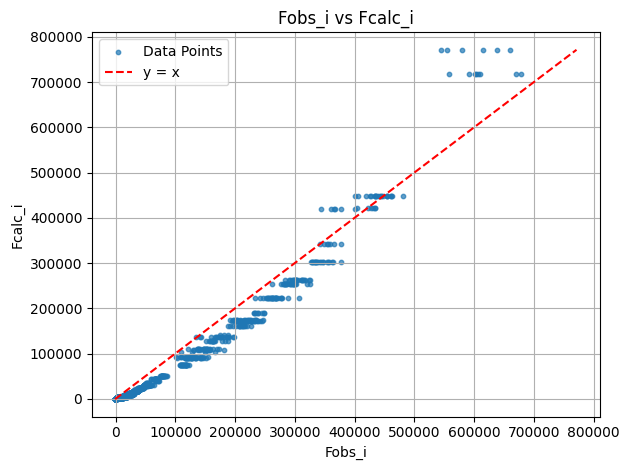

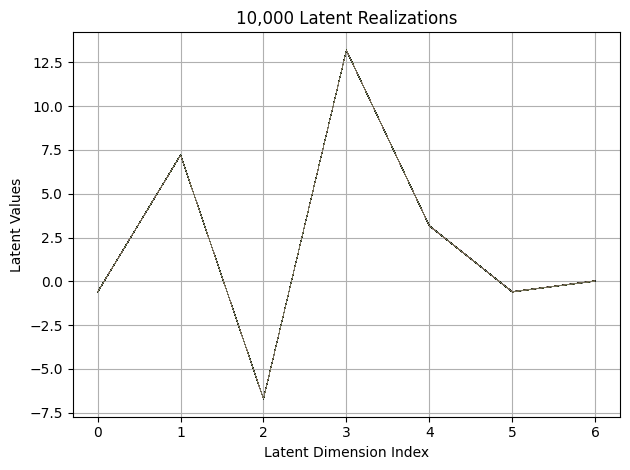

First 10 latent vectors from the VAE:
Sample 1: [-0.6073839068412781, 7.223254680633545, -6.690155982971191, 13.198657035827637, 3.1755692958831787, -0.590218186378479, 0.011571371927857399]
Sample 2: [-0.6088371276855469, 7.20332145690918, -6.708377361297607, 13.173312187194824, 3.174476385116577, -0.6035941243171692, 0.023122116923332214]
Sample 3: [-0.6060857772827148, 7.210744380950928, -6.688169002532959, 13.181076049804688, 3.173980712890625, -0.59030681848526, 0.016244063153862953]
Sample 4: [-0.5995411276817322, 7.20930814743042, -6.700778007507324, 13.197093963623047, 3.165276288986206, -0.605394721031189, 0.014214087277650833]
Sample 5: [-0.6129852533340454, 7.20916223526001, -6.697681427001953, 13.179944038391113, 3.1775054931640625, -0.5959851741790771, 0.010819797404110432]
Sample 6: [-0.5938371419906616, 7.203179836273193, -6.697543144226074, 13.188482284545898, 3.1757702827453613, -0.5906752943992615, 0.00883401371538639]
Sample 7: [-0.6002963781356812, 7.19564151763916,

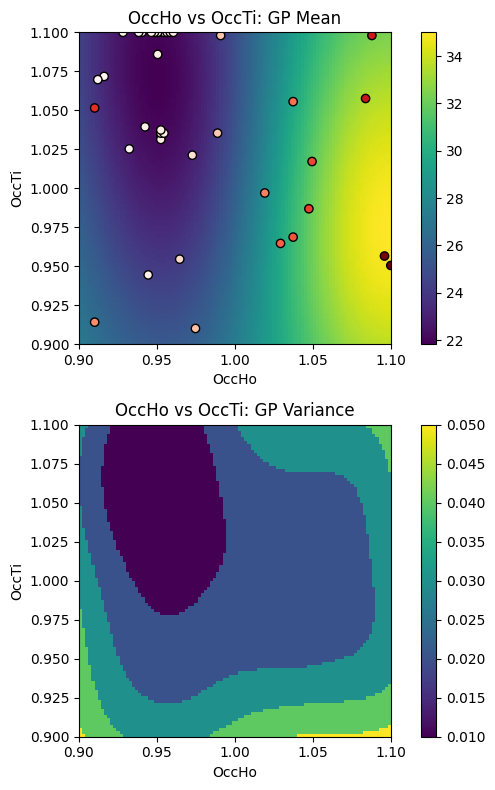

EI: [3.97744961e-03 3.95078771e-03 3.93267721e-03 ... 1.79874187e-05
 2.09165737e-05 2.46631971e-05]
Function eval #40
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [1.100000023841858, 0.9303030371665955]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7665
initial chi^2 2.0391e+05 with 2596 obs.
New scale: 0.7665
Cycle 0: 0.79s, Chi**2: 1.6703e+05 for 2596 obs., Lambda: 0,  Delta: 0.181, SVD=0
New scale: 0.7665
Maximum shift/esd = -47.507 for al

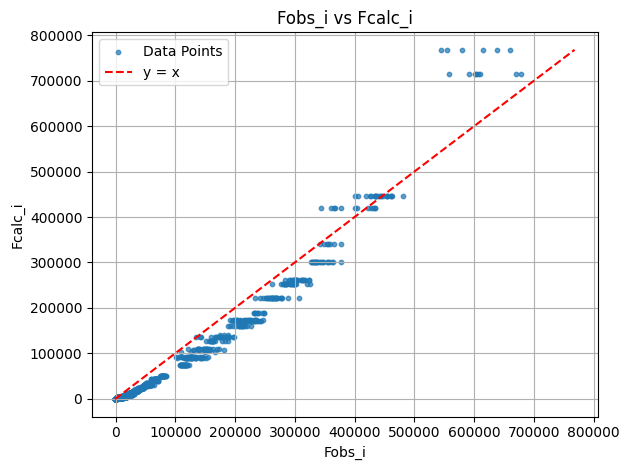

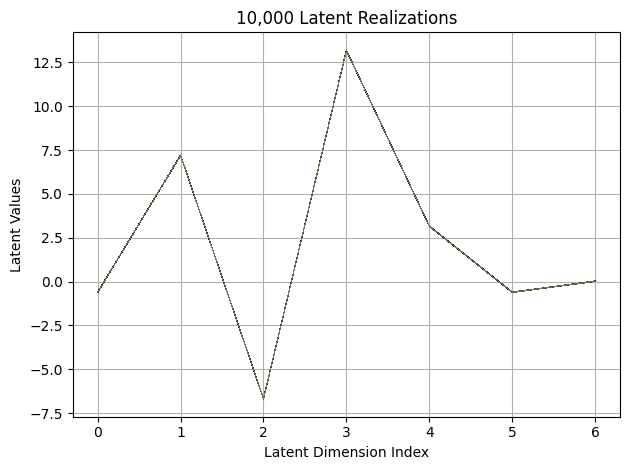

First 10 latent vectors from the VAE:
Sample 1: [-0.6116147637367249, 7.213447570800781, -6.675971031188965, 13.18651008605957, 3.1616034507751465, -0.6188104748725891, 0.01729992963373661]
Sample 2: [-0.6267127990722656, 7.198720932006836, -6.687295436859131, 13.19748306274414, 3.1495163440704346, -0.6184253096580505, 0.01697642169892788]
Sample 3: [-0.6100019812583923, 7.205262184143066, -6.670973300933838, 13.19196605682373, 3.1649580001831055, -0.6131972670555115, 0.013128438964486122]
Sample 4: [-0.604586124420166, 7.202663421630859, -6.695025444030762, 13.189985275268555, 3.158311367034912, -0.6091528534889221, 0.020659098401665688]
Sample 5: [-0.6101934909820557, 7.214116096496582, -6.68673038482666, 13.180071830749512, 3.1633529663085938, -0.6099842190742493, 0.026934323832392693]
Sample 6: [-0.6214993000030518, 7.2094316482543945, -6.68941068649292, 13.178421020507812, 3.1572265625, -0.6104201078414917, 0.026048067957162857]
Sample 7: [-0.617853045463562, 7.214553356170654, -6

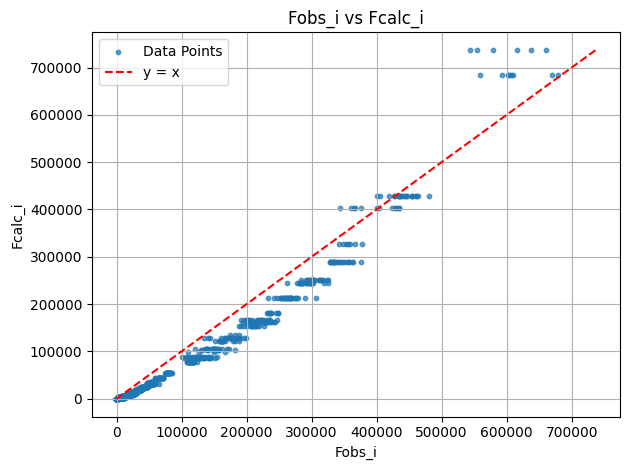

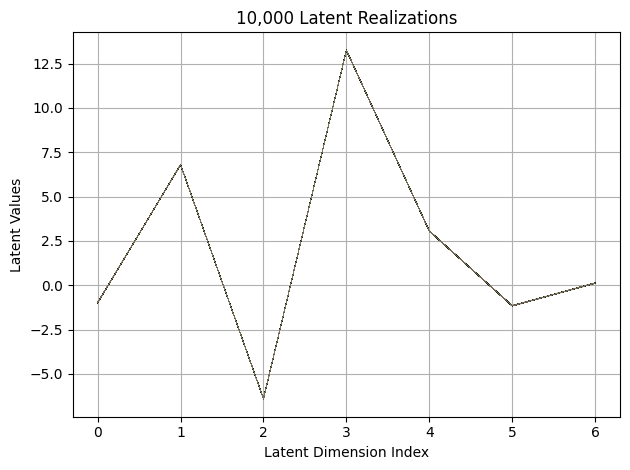

First 10 latent vectors from the VAE:
Sample 1: [-1.0059459209442139, 6.802800178527832, -6.400398254394531, 13.255816459655762, 3.0581159591674805, -1.1547799110412598, 0.1085011214017868]
Sample 2: [-1.0045359134674072, 6.798727989196777, -6.402677536010742, 13.246642112731934, 3.042440414428711, -1.163132667541504, 0.11814045161008835]
Sample 3: [-1.000555396080017, 6.781013488769531, -6.39771842956543, 13.26479721069336, 3.059086799621582, -1.1645041704177856, 0.11160106211900711]
Sample 4: [-1.0075113773345947, 6.802753925323486, -6.411929130554199, 13.24581527709961, 3.0620205402374268, -1.1645523309707642, 0.12046708911657333]
Sample 5: [-1.010971188545227, 6.785613059997559, -6.408597469329834, 13.249468803405762, 3.0445799827575684, -1.1678904294967651, 0.11655037105083466]
Sample 6: [-1.0027546882629395, 6.795099258422852, -6.401271343231201, 13.247048377990723, 3.046820878982544, -1.1623653173446655, 0.10747001320123672]
Sample 7: [-0.9946943521499634, 6.810684680938721, -6.

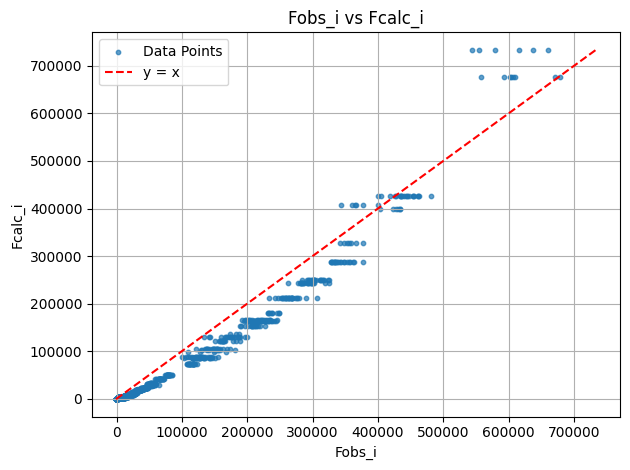

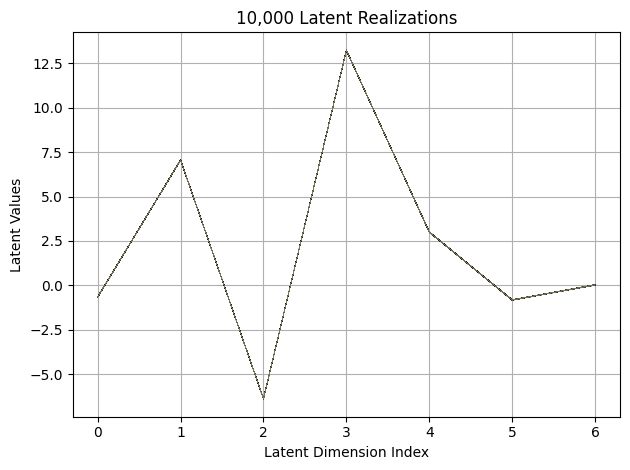

First 10 latent vectors from the VAE:
Sample 1: [-0.6559266448020935, 7.047921180725098, -6.387870788574219, 13.243349075317383, 2.9954302310943604, -0.8222202658653259, 0.019465850666165352]
Sample 2: [-0.6666733026504517, 7.051546096801758, -6.395267963409424, 13.238308906555176, 2.990480422973633, -0.8395692706108093, 0.019268520176410675]
Sample 3: [-0.6563003659248352, 7.049291133880615, -6.3757004737854, 13.236699104309082, 2.9982621669769287, -0.8343913555145264, 0.02151092328131199]
Sample 4: [-0.6694338917732239, 7.0612969398498535, -6.399098873138428, 13.238454818725586, 2.9969966411590576, -0.8156822919845581, 0.023282546550035477]
Sample 5: [-0.6610902547836304, 7.051304817199707, -6.3954081535339355, 13.254949569702148, 2.994957447052002, -0.83299720287323, 0.027574412524700165]
Sample 6: [-0.6741051077842712, 7.05237340927124, -6.393927574157715, 13.236605644226074, 2.983772039413452, -0.8316144943237305, 0.02355627715587616]
Sample 7: [-0.6598689556121826, 7.058352470397

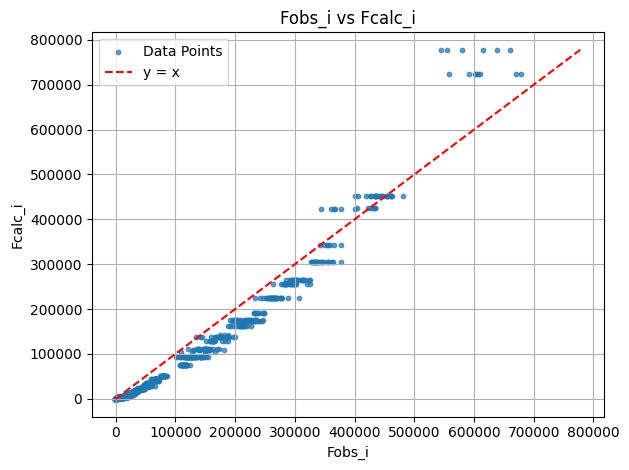

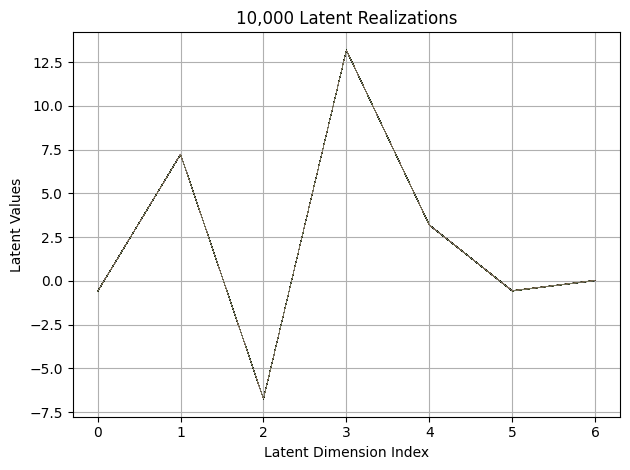

First 10 latent vectors from the VAE:
Sample 1: [-0.6165825724601746, 7.226700305938721, -6.738374710083008, 13.174093246459961, 3.1884381771087646, -0.5785436630249023, 0.017978597432374954]
Sample 2: [-0.6010314226150513, 7.224030494689941, -6.733762741088867, 13.164144515991211, 3.19848895072937, -0.5670158267021179, 0.017764052376151085]
Sample 3: [-0.6178798079490662, 7.2307257652282715, -6.752018928527832, 13.169635772705078, 3.1926732063293457, -0.5636141300201416, 0.011687036603689194]
Sample 4: [-0.6021784543991089, 7.2270355224609375, -6.738677024841309, 13.189048767089844, 3.1780898571014404, -0.5660898089408875, 0.014047795906662941]
Sample 5: [-0.5943675637245178, 7.230867385864258, -6.731338024139404, 13.18297004699707, 3.1879584789276123, -0.5749325752258301, 0.01571262627840042]
Sample 6: [-0.6122201085090637, 7.221855163574219, -6.736850261688232, 13.185029029846191, 3.1883718967437744, -0.5701425075531006, 0.019912755116820335]
Sample 7: [-0.6000102758407593, 7.231916

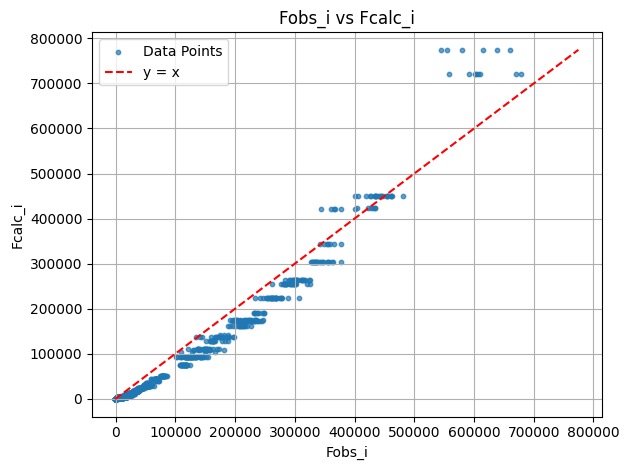

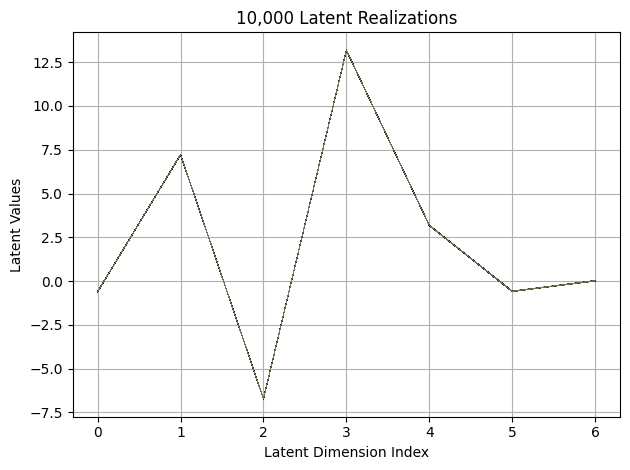

First 10 latent vectors from the VAE:
Sample 1: [-0.6170414090156555, 7.2183427810668945, -6.723272800445557, 13.181039810180664, 3.170823097229004, -0.5842913389205933, 0.03067025914788246]
Sample 2: [-0.6137372255325317, 7.208644390106201, -6.717253684997559, 13.178886413574219, 3.186152696609497, -0.5868868231773376, 0.01716003194451332]
Sample 3: [-0.6135175824165344, 7.216132640838623, -6.71943473815918, 13.179245948791504, 3.172140598297119, -0.5812726020812988, 0.01184862107038498]
Sample 4: [-0.5956428050994873, 7.208811283111572, -6.7267656326293945, 13.181680679321289, 3.1796915531158447, -0.5835972428321838, 0.01923155039548874]
Sample 5: [-0.6058654189109802, 7.219813346862793, -6.725790977478027, 13.178160667419434, 3.180779218673706, -0.5841736793518066, 0.02517431601881981]
Sample 6: [-0.6020971536636353, 7.216484546661377, -6.729050159454346, 13.180042266845703, 3.183614492416382, -0.5841177105903625, 0.025616439059376717]
Sample 7: [-0.6055309176445007, 7.2097496986389

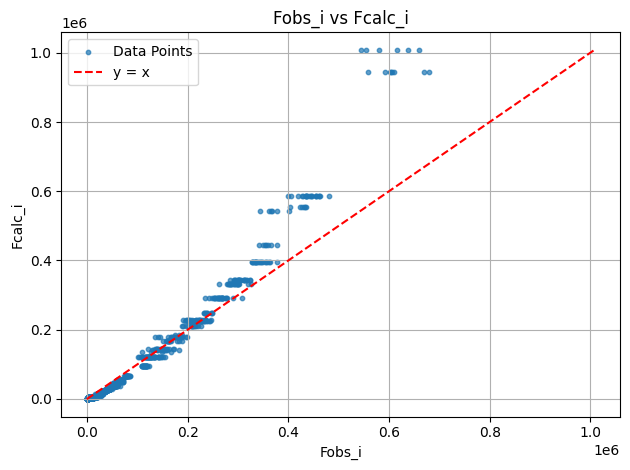

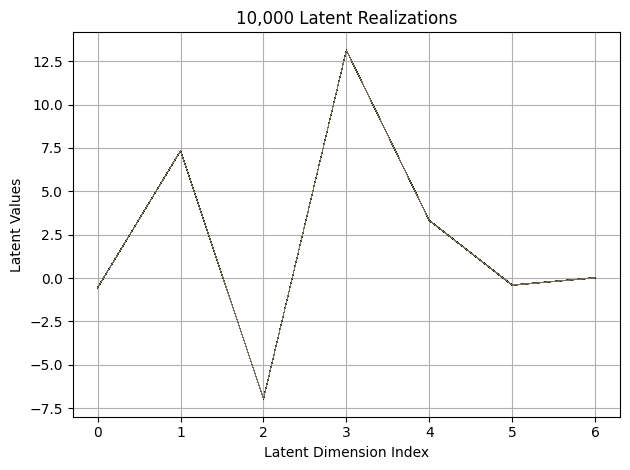

First 10 latent vectors from the VAE:
Sample 1: [-0.5712937116622925, 7.340594291687012, -6.961287975311279, 13.1290864944458, 3.311718225479126, -0.41033342480659485, 0.015114990994334221]
Sample 2: [-0.5662169456481934, 7.33345890045166, -6.965663909912109, 13.133818626403809, 3.3193769454956055, -0.39827314019203186, 0.003084048628807068]
Sample 3: [-0.5527023077011108, 7.338159084320068, -6.958993911743164, 13.13196849822998, 3.3130576610565186, -0.40529295802116394, 0.014106592163443565]
Sample 4: [-0.555787205696106, 7.339524269104004, -6.95684289932251, 13.130773544311523, 3.3321304321289062, -0.4047498106956482, 0.0035996511578559875]
Sample 5: [-0.5643810629844666, 7.343315124511719, -6.948367118835449, 13.132801055908203, 3.3115508556365967, -0.4023134708404541, 0.014212509617209435]
Sample 6: [-0.5638751983642578, 7.331273555755615, -6.961582183837891, 13.120170593261719, 3.3157572746276855, -0.40152668952941895, 0.012082196772098541]
Sample 7: [-0.5637550354003906, 7.335693

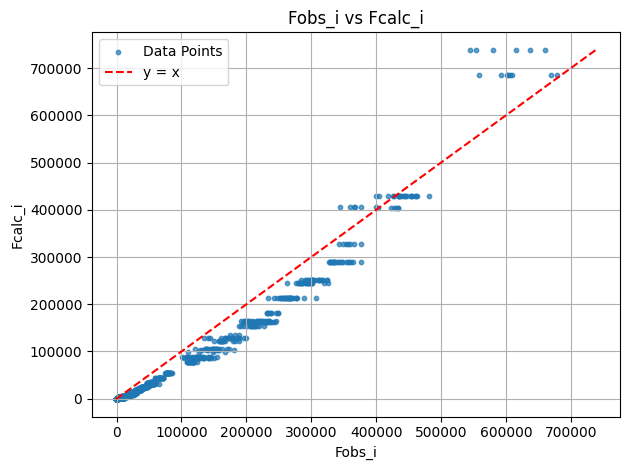

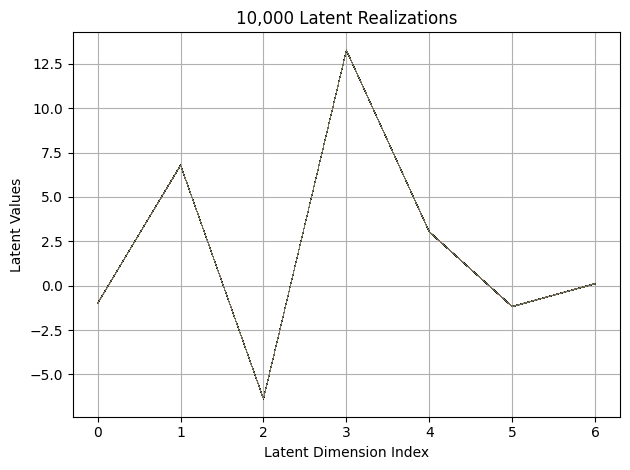

First 10 latent vectors from the VAE:
Sample 1: [-1.0029510259628296, 6.7936482429504395, -6.354893684387207, 13.259820938110352, 3.02797794342041, -1.1678483486175537, 0.11447512358427048]
Sample 2: [-0.9937315583229065, 6.780137538909912, -6.368553638458252, 13.265568733215332, 3.021880626678467, -1.1682603359222412, 0.114732526242733]
Sample 3: [-0.9842941164970398, 6.785411357879639, -6.375610828399658, 13.251232147216797, 3.028693199157715, -1.1732715368270874, 0.11057582497596741]
Sample 4: [-0.9943026900291443, 6.7885918617248535, -6.363827228546143, 13.259869575500488, 3.033726215362549, -1.1773754358291626, 0.10973206907510757]
Sample 5: [-0.9909828305244446, 6.80122184753418, -6.368393421173096, 13.25862979888916, 3.033632278442383, -1.168186902999878, 0.12744572758674622]
Sample 6: [-0.9837778806686401, 6.789370059967041, -6.367096900939941, 13.252115249633789, 3.023831605911255, -1.1726428270339966, 0.11740909516811371]
Sample 7: [-0.9794336557388306, 6.793660640716553, -6.

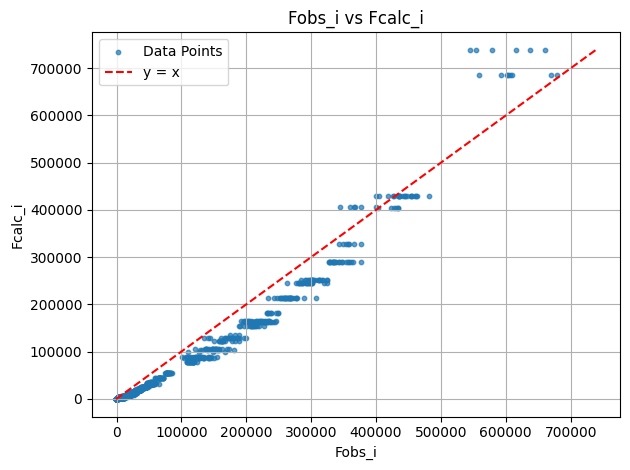

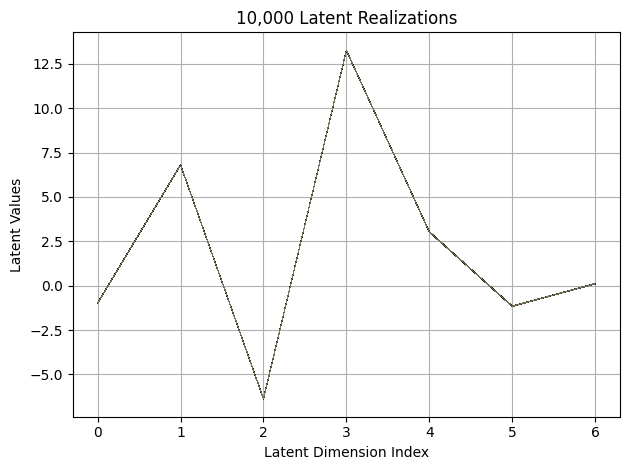

First 10 latent vectors from the VAE:
Sample 1: [-0.9720684885978699, 6.797911167144775, -6.3766961097717285, 13.257772445678711, 3.0283615589141846, -1.161102294921875, 0.11057163774967194]
Sample 2: [-0.9756127595901489, 6.796563625335693, -6.380817890167236, 13.251899719238281, 3.029050588607788, -1.1652401685714722, 0.11837047338485718]
Sample 3: [-0.9692190885543823, 6.808064937591553, -6.383825302124023, 13.265338897705078, 3.0273706912994385, -1.1587560176849365, 0.12127360701560974]
Sample 4: [-0.9792478680610657, 6.815263748168945, -6.367806911468506, 13.257063865661621, 3.024355173110962, -1.1521587371826172, 0.1052403599023819]
Sample 5: [-0.9792495369911194, 6.816309928894043, -6.36867094039917, 13.262681007385254, 3.0251481533050537, -1.1519795656204224, 0.11924830079078674]
Sample 6: [-0.9750152826309204, 6.804140567779541, -6.3655171394348145, 13.26424503326416, 3.0375328063964844, -1.1654163599014282, 0.11223425716161728]
Sample 7: [-0.9780217409133911, 6.79719877243042

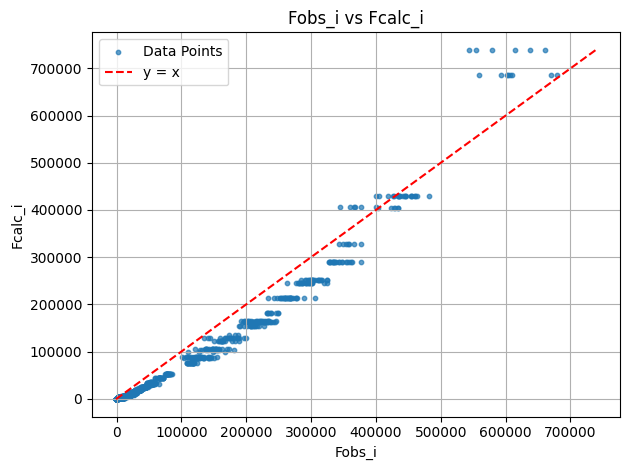

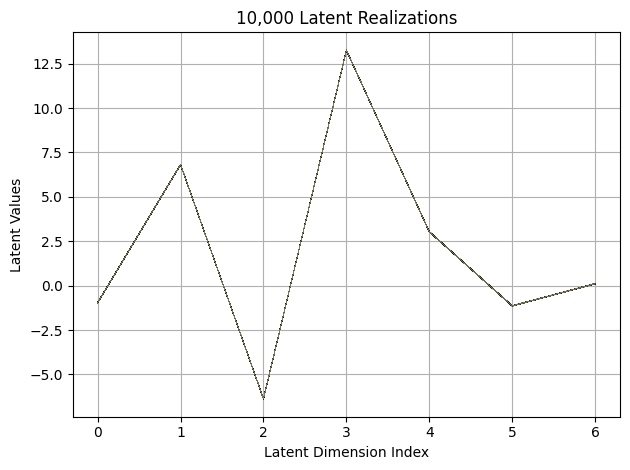

First 10 latent vectors from the VAE:
Sample 1: [-0.9479235410690308, 6.808076858520508, -6.3546013832092285, 13.26815414428711, 3.023393154144287, -1.137704849243164, 0.10559606552124023]
Sample 2: [-0.9596953392028809, 6.8030877113342285, -6.373996257781982, 13.254756927490234, 3.029047727584839, -1.139146327972412, 0.10042690485715866]
Sample 3: [-0.9579567909240723, 6.8111348152160645, -6.383737564086914, 13.258525848388672, 3.0273754596710205, -1.1463723182678223, 0.0933162271976471]
Sample 4: [-0.957400918006897, 6.812473773956299, -6.382691383361816, 13.251412391662598, 3.026365280151367, -1.1410295963287354, 0.1112433671951294]
Sample 5: [-0.9640906453132629, 6.8146138191223145, -6.366783618927002, 13.254934310913086, 3.037867546081543, -1.1487458944320679, 0.09742993861436844]
Sample 6: [-0.9666019082069397, 6.800241947174072, -6.367066860198975, 13.265426635742188, 3.0320091247558594, -1.1306235790252686, 0.0984809547662735]
Sample 7: [-0.9663281440734863, 6.81881046295166, -

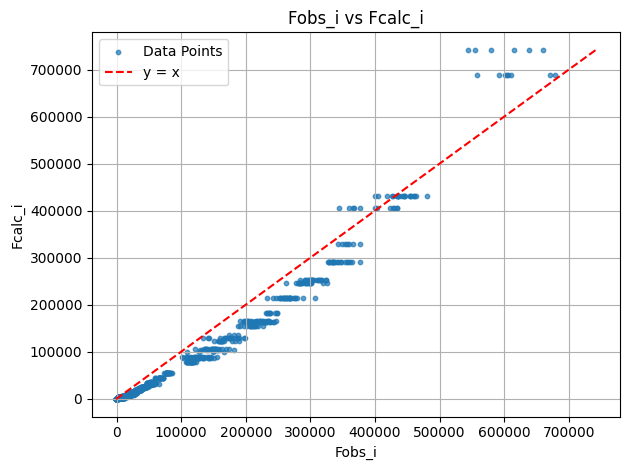

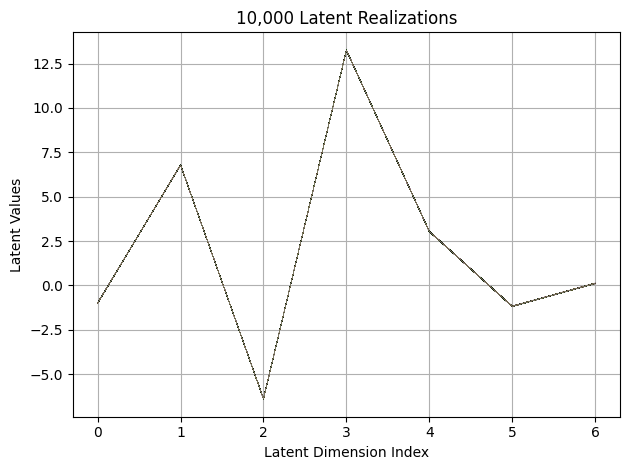

First 10 latent vectors from the VAE:
Sample 1: [-0.9893182516098022, 6.793190956115723, -6.386241436004639, 13.252470016479492, 3.0411298274993896, -1.173863410949707, 0.12677741050720215]
Sample 2: [-0.9913154244422913, 6.782055854797363, -6.384372234344482, 13.259278297424316, 3.047095537185669, -1.185921549797058, 0.1074325442314148]
Sample 3: [-1.0081144571304321, 6.7811784744262695, -6.385306358337402, 13.264962196350098, 3.042510509490967, -1.1790567636489868, 0.12444442510604858]
Sample 4: [-0.9829220771789551, 6.78633451461792, -6.387915134429932, 13.244882583618164, 3.0357298851013184, -1.1765148639678955, 0.10930638760328293]
Sample 5: [-1.0025132894515991, 6.776013374328613, -6.378579139709473, 13.255952835083008, 3.0344786643981934, -1.1708459854125977, 0.12683525681495667]
Sample 6: [-1.006790280342102, 6.7784953117370605, -6.384653568267822, 13.253682136535645, 3.0457582473754883, -1.1759892702102661, 0.12199259549379349]
Sample 7: [-0.9899166822433472, 6.778820037841797

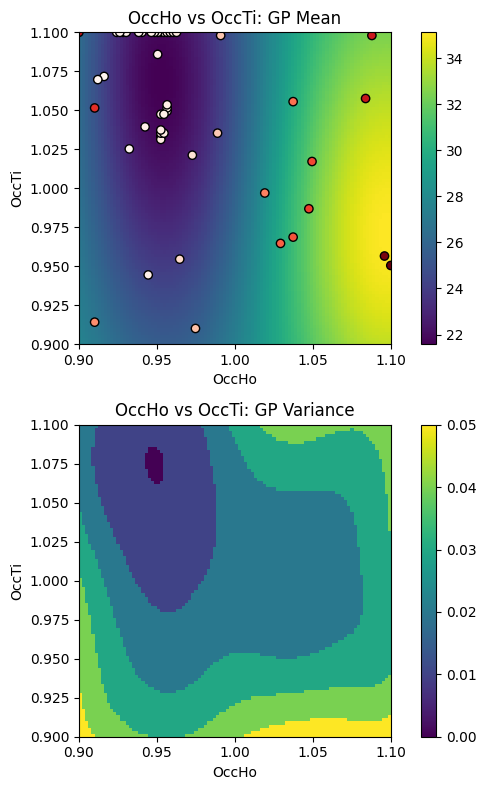

EI: [3.50243319e-03 3.49682011e-03 3.50312889e-03 ... 2.37377826e-05
 2.83714617e-05 3.44122236e-05]
Function eval #50
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [1.100000023841858, 0.9646464586257935]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7247
initial chi^2 2.28e+05 with 2596 obs.
New scale: 0.7195
Cycle 0: 0.60s, Chi**2: 1.6996e+05 for 2596 obs., Lambda: 0,  Delta: 0.255, SVD=0
New scale: 0.7195
Maximum shift/esd = -63.072 for all 

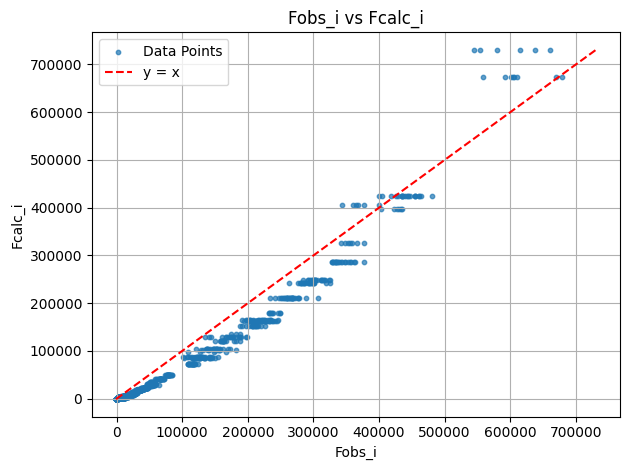

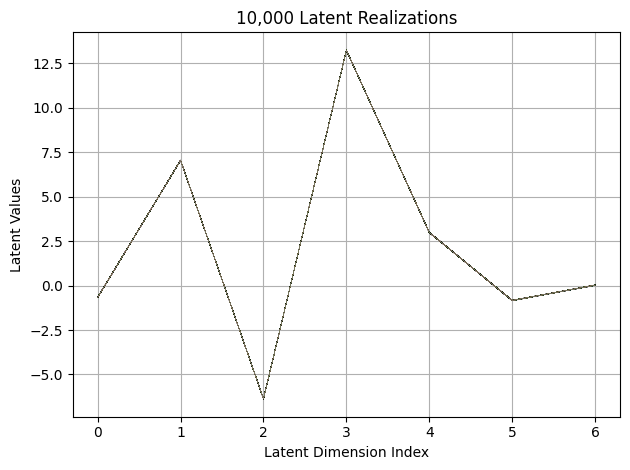

First 10 latent vectors from the VAE:
Sample 1: [-0.6652264595031738, 7.0468220710754395, -6.3671345710754395, 13.241799354553223, 2.9901692867279053, -0.8403086066246033, 0.0358138345181942]
Sample 2: [-0.6616373658180237, 7.0488996505737305, -6.366888046264648, 13.24851131439209, 2.982560873031616, -0.8333060145378113, 0.017781060189008713]
Sample 3: [-0.6600331664085388, 7.042977809906006, -6.384374618530273, 13.247281074523926, 2.980647563934326, -0.8379666805267334, 0.02294435165822506]
Sample 4: [-0.6637558341026306, 7.047341823577881, -6.381280422210693, 13.242234230041504, 2.988832950592041, -0.8369971513748169, 0.013492182828485966]
Sample 5: [-0.6758681535720825, 7.054590702056885, -6.374889850616455, 13.24442195892334, 2.9712283611297607, -0.8352276682853699, 0.022513290867209435]
Sample 6: [-0.6742150187492371, 7.048867225646973, -6.367618560791016, 13.238677978515625, 2.9808573722839355, -0.8394986987113953, 0.018561160191893578]
Sample 7: [-0.6674429178237915, 7.047240257

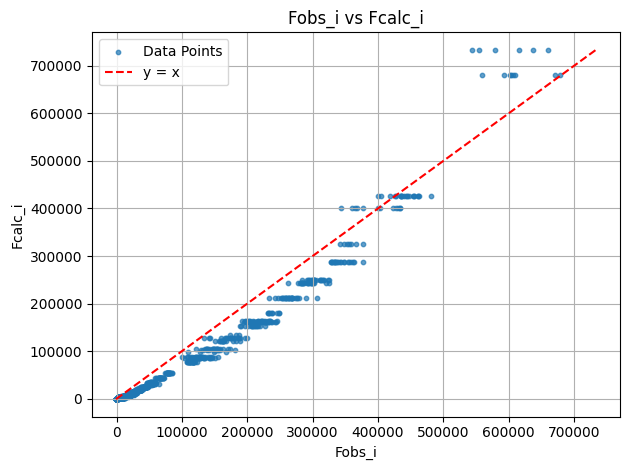

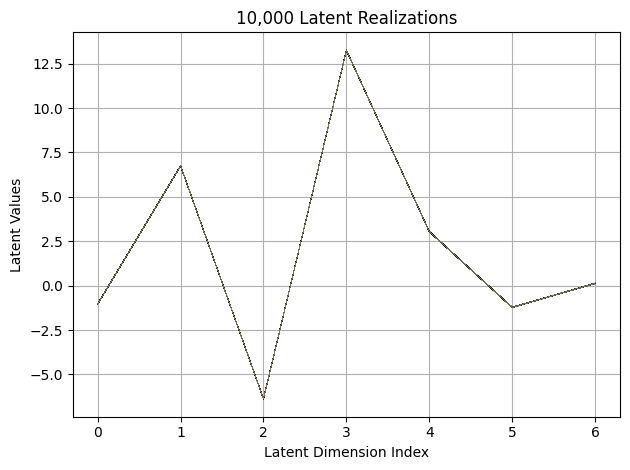

First 10 latent vectors from the VAE:
Sample 1: [-1.0382274389266968, 6.746380805969238, -6.370420455932617, 13.253988265991211, 3.0349223613739014, -1.226030707359314, 0.12411825358867645]
Sample 2: [-1.0441430807113647, 6.755331516265869, -6.36561393737793, 13.260038375854492, 3.040858268737793, -1.2148762941360474, 0.12421169877052307]
Sample 3: [-1.0407534837722778, 6.738226413726807, -6.369557857513428, 13.260211944580078, 3.0403177738189697, -1.2227513790130615, 0.13105426728725433]
Sample 4: [-1.0399503707885742, 6.748394966125488, -6.366953372955322, 13.260603904724121, 3.0366098880767822, -1.2345616817474365, 0.11445294320583344]
Sample 5: [-1.0431045293807983, 6.738426208496094, -6.382755279541016, 13.26460075378418, 3.048506259918213, -1.2287155389785767, 0.14007489383220673]
Sample 6: [-1.035277009010315, 6.743007183074951, -6.367767333984375, 13.257073402404785, 3.0563950538635254, -1.2166842222213745, 0.12426948547363281]
Sample 7: [-1.0459699630737305, 6.747457981109619,

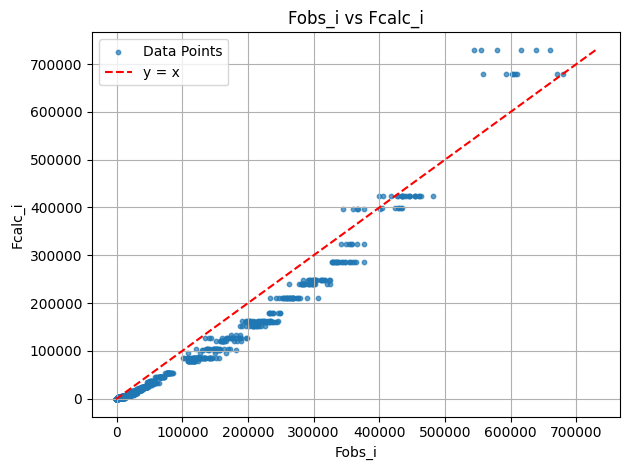

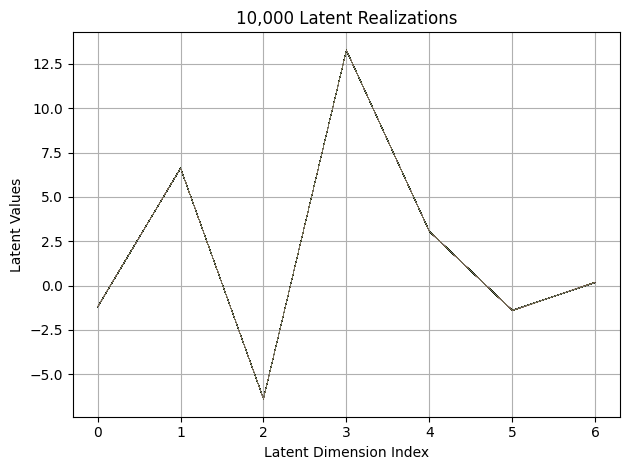

First 10 latent vectors from the VAE:
Sample 1: [-1.203113079071045, 6.616401672363281, -6.379047870635986, 13.269218444824219, 3.0690219402313232, -1.3896021842956543, 0.1657569259405136]
Sample 2: [-1.2013970613479614, 6.630115509033203, -6.367574691772461, 13.272316932678223, 3.058521032333374, -1.389028549194336, 0.16722024977207184]
Sample 3: [-1.2111270427703857, 6.606634140014648, -6.377182483673096, 13.264209747314453, 3.0688364505767822, -1.4024503231048584, 0.18302090466022491]
Sample 4: [-1.1996707916259766, 6.631797790527344, -6.367873668670654, 13.260011672973633, 3.065122604370117, -1.3959321975708008, 0.17574521899223328]
Sample 5: [-1.2078999280929565, 6.616998672485352, -6.373810768127441, 13.261787414550781, 3.06664776802063, -1.39643394947052, 0.1710938960313797]
Sample 6: [-1.206236481666565, 6.6087212562561035, -6.37319278717041, 13.27662467956543, 3.0763938426971436, -1.392935872077942, 0.16633228957653046]
Sample 7: [-1.2096514701843262, 6.622084140777588, -6.375

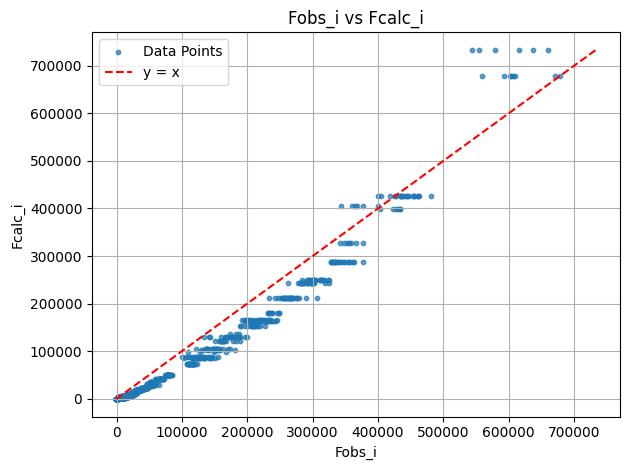

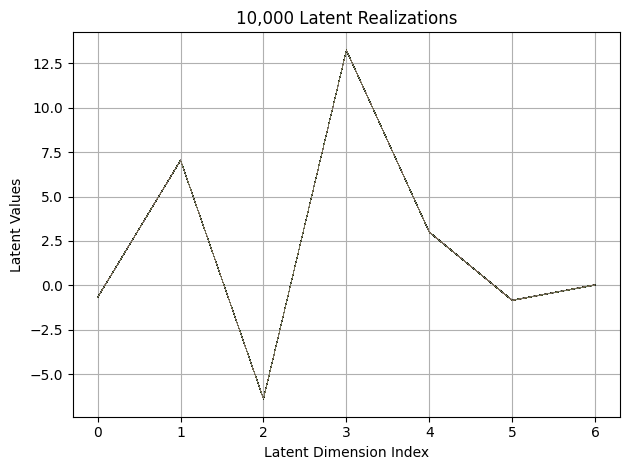

First 10 latent vectors from the VAE:
Sample 1: [-0.6786511540412903, 7.058315753936768, -6.385269641876221, 13.241411209106445, 2.992656707763672, -0.8427317142486572, 0.01974661275744438]
Sample 2: [-0.6766647696495056, 7.047778606414795, -6.397851467132568, 13.237483024597168, 3.0028953552246094, -0.8378396034240723, 0.03625962883234024]
Sample 3: [-0.6816625595092773, 7.054800510406494, -6.397703170776367, 13.242178916931152, 2.994741916656494, -0.8485704660415649, 0.026949672028422356]
Sample 4: [-0.6756247878074646, 7.052449703216553, -6.386152744293213, 13.245068550109863, 2.996892213821411, -0.832304835319519, 0.032441914081573486]
Sample 5: [-0.6873899698257446, 7.042642116546631, -6.386726379394531, 13.238448143005371, 2.9972779750823975, -0.8385707139968872, 0.024633649736642838]
Sample 6: [-0.6804319620132446, 7.04014253616333, -6.363895893096924, 13.239727973937988, 2.9960896968841553, -0.8407949805259705, 0.03392688184976578]
Sample 7: [-0.6773216724395752, 7.045865058898

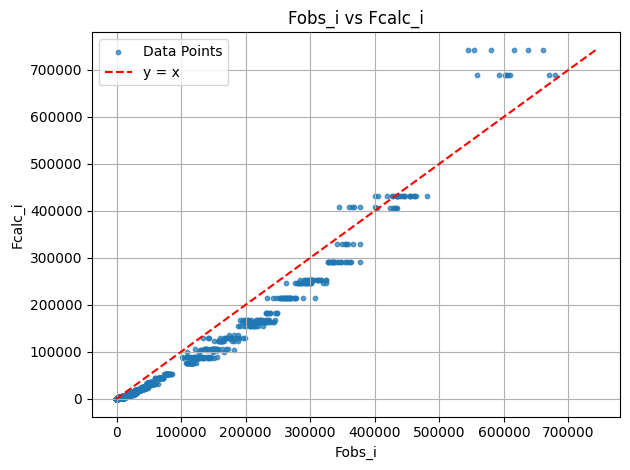

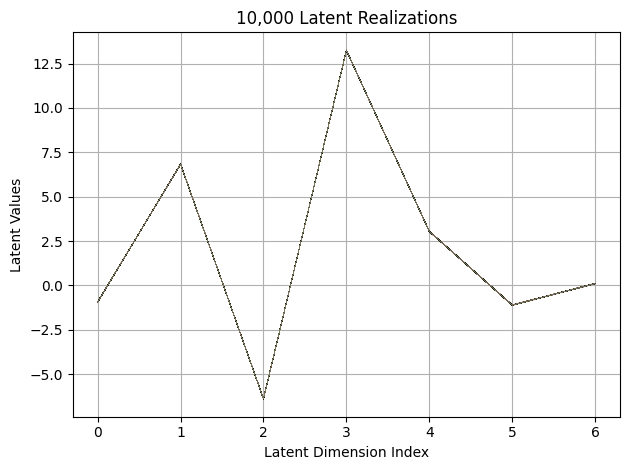

First 10 latent vectors from the VAE:
Sample 1: [-0.9393213987350464, 6.843688011169434, -6.404305934906006, 13.253351211547852, 3.0488178730010986, -1.127649188041687, 0.1010381206870079]
Sample 2: [-0.9461818933486938, 6.827791690826416, -6.410170078277588, 13.249547004699707, 3.0461714267730713, -1.093122959136963, 0.10705702006816864]
Sample 3: [-0.9487580060958862, 6.834710121154785, -6.397237300872803, 13.248880386352539, 3.042595863342285, -1.1103209257125854, 0.10312972217798233]
Sample 4: [-0.9544415473937988, 6.839457988739014, -6.392309665679932, 13.25619888305664, 3.048523426055908, -1.1068860292434692, 0.09606286138296127]
Sample 5: [-0.9453346133232117, 6.83674430847168, -6.403527736663818, 13.247659683227539, 3.040153980255127, -1.124583125114441, 0.09315328299999237]
Sample 6: [-0.9577593207359314, 6.832583904266357, -6.394460678100586, 13.253512382507324, 3.0344901084899902, -1.1010061502456665, 0.09484637528657913]
Sample 7: [-0.9420359134674072, 6.831552505493164, -6

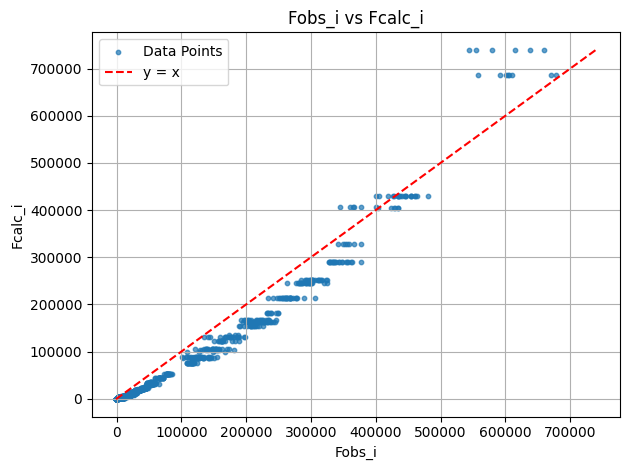

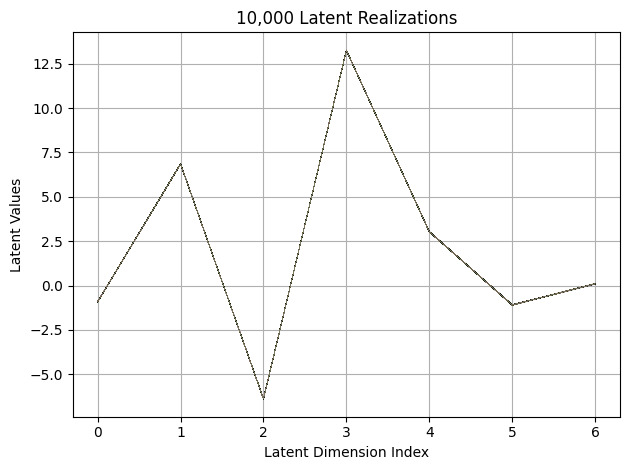

First 10 latent vectors from the VAE:
Sample 1: [-0.9096792340278625, 6.851268768310547, -6.386806964874268, 13.259392738342285, 3.0255820751190186, -1.0989141464233398, 0.08334727585315704]
Sample 2: [-0.9176559448242188, 6.85328483581543, -6.396337032318115, 13.271790504455566, 3.032670021057129, -1.0956553220748901, 0.09039171785116196]
Sample 3: [-0.9265469908714294, 6.853000640869141, -6.381191253662109, 13.248000144958496, 3.0391292572021484, -1.0881165266036987, 0.09547991305589676]
Sample 4: [-0.9069565534591675, 6.840722560882568, -6.390651702880859, 13.2501220703125, 3.0366783142089844, -1.0955595970153809, 0.09596984833478928]
Sample 5: [-0.9150307178497314, 6.847082614898682, -6.386490345001221, 13.249594688415527, 3.019914150238037, -1.1050678491592407, 0.10455148667097092]
Sample 6: [-0.9158738255500793, 6.852369785308838, -6.391661167144775, 13.249874114990234, 3.0347721576690674, -1.1070469617843628, 0.09269309043884277]
Sample 7: [-0.9251613020896912, 6.849025726318359

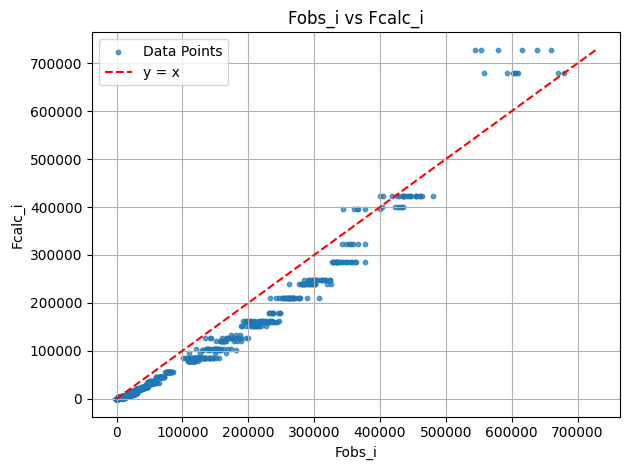

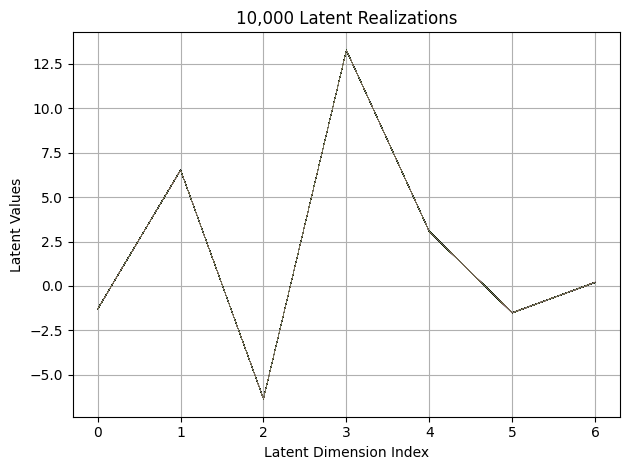

First 10 latent vectors from the VAE:
Sample 1: [-1.301071047782898, 6.537631034851074, -6.3534345626831055, 13.266312599182129, 3.0589852333068848, -1.5072137117385864, 0.19905811548233032]
Sample 2: [-1.3078439235687256, 6.529337406158447, -6.347223281860352, 13.271245956420898, 3.0750157833099365, -1.5071516036987305, 0.19621938467025757]
Sample 3: [-1.3092081546783447, 6.518908977508545, -6.350541591644287, 13.27192211151123, 3.0652661323547363, -1.5022794008255005, 0.21331268548965454]
Sample 4: [-1.301360845565796, 6.53983736038208, -6.352344512939453, 13.279784202575684, 3.0744376182556152, -1.5243661403656006, 0.21182069182395935]
Sample 5: [-1.3000096082687378, 6.542327404022217, -6.361403465270996, 13.273648262023926, 3.0551116466522217, -1.5156586170196533, 0.19822461903095245]
Sample 6: [-1.2921435832977295, 6.5341691970825195, -6.349677085876465, 13.267949104309082, 3.0588128566741943, -1.511959433555603, 0.1997021585702896]
Sample 7: [-1.299437165260315, 6.531970024108887

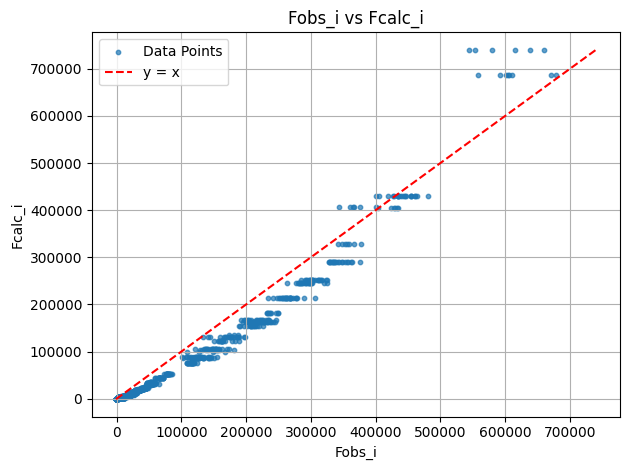

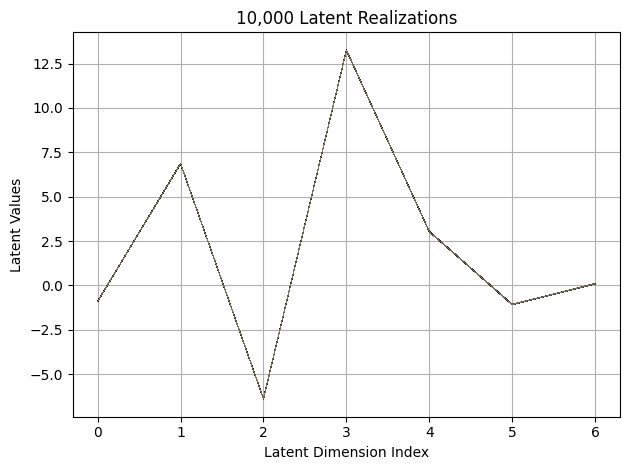

First 10 latent vectors from the VAE:
Sample 1: [-0.9102999567985535, 6.868768692016602, -6.387399196624756, 13.250590324401855, 3.033106565475464, -1.0737693309783936, 0.09569146484136581]
Sample 2: [-0.9176427721977234, 6.863694190979004, -6.387209415435791, 13.24029541015625, 3.0368683338165283, -1.0860650539398193, 0.09239862859249115]
Sample 3: [-0.9104744791984558, 6.858425617218018, -6.387956619262695, 13.260078430175781, 3.033421516418457, -1.0872353315353394, 0.09385856240987778]
Sample 4: [-0.9099634289741516, 6.85055685043335, -6.400667190551758, 13.258325576782227, 3.0321767330169678, -1.0657199621200562, 0.0840526670217514]
Sample 5: [-0.9114959836006165, 6.85243034362793, -6.388229846954346, 13.256637573242188, 3.0193662643432617, -1.0759340524673462, 0.08370578289031982]
Sample 6: [-0.911892294883728, 6.866261959075928, -6.387951850891113, 13.250447273254395, 3.040428400039673, -1.0873907804489136, 0.09295167773962021]
Sample 7: [-0.9113298058509827, 6.861057758331299, -

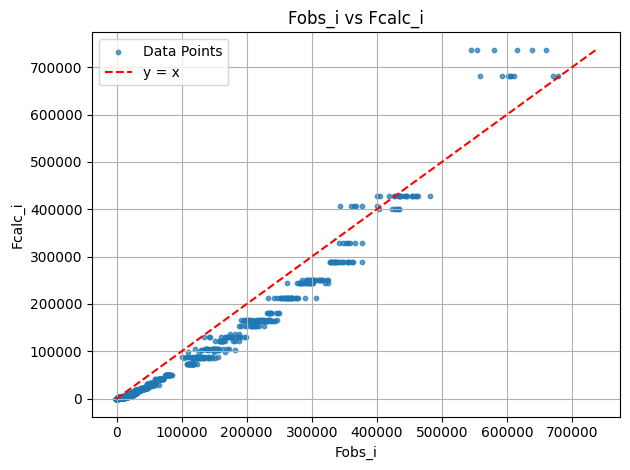

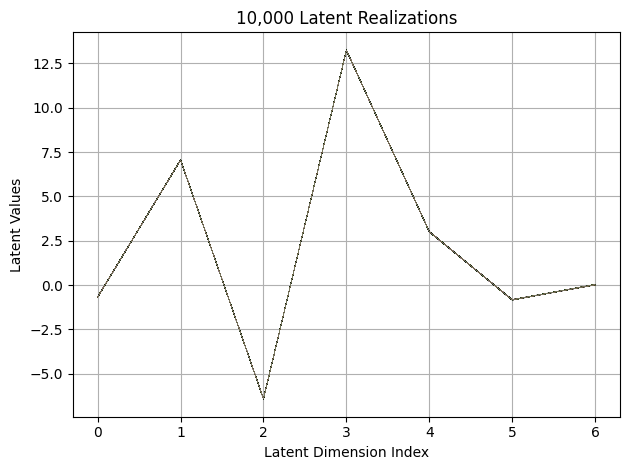

First 10 latent vectors from the VAE:
Sample 1: [-0.6748919486999512, 7.064687728881836, -6.410085201263428, 13.238421440124512, 3.0085039138793945, -0.8205653429031372, 0.02519678883254528]
Sample 2: [-0.6772480010986328, 7.06315803527832, -6.406202793121338, 13.235578536987305, 3.001044511795044, -0.8199582695960999, 0.027088358998298645]
Sample 3: [-0.674611508846283, 7.051647186279297, -6.393798828125, 13.23558521270752, 2.9986767768859863, -0.8291822075843811, 0.03029223531484604]
Sample 4: [-0.669137716293335, 7.059454441070557, -6.398318767547607, 13.248065948486328, 3.002185583114624, -0.8273836970329285, 0.02346445806324482]
Sample 5: [-0.6776252388954163, 7.053318023681641, -6.40955924987793, 13.235550880432129, 3.0103724002838135, -0.8273733854293823, 0.01876569725573063]
Sample 6: [-0.6800835728645325, 7.065464496612549, -6.396510124206543, 13.242889404296875, 3.0137505531311035, -0.826232373714447, 0.01887166127562523]
Sample 7: [-0.6731135845184326, 7.062252998352051, -6.

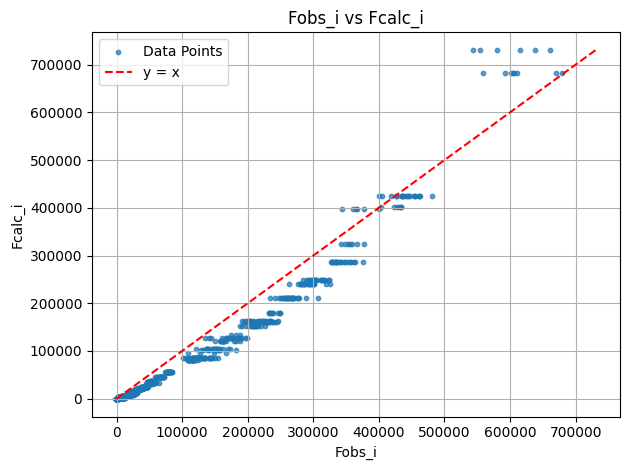

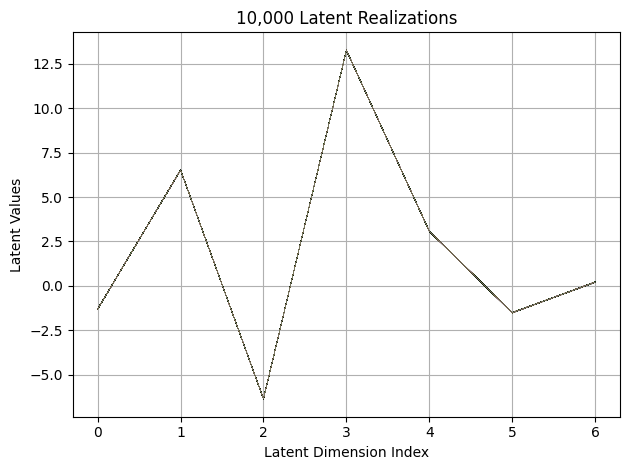

First 10 latent vectors from the VAE:
Sample 1: [-1.305142879486084, 6.540901184082031, -6.369446754455566, 13.275144577026367, 3.090074062347412, -1.5212790966033936, 0.2080020010471344]
Sample 2: [-1.3138058185577393, 6.518951416015625, -6.363998889923096, 13.284664154052734, 3.0902621746063232, -1.5106568336486816, 0.20935823023319244]
Sample 3: [-1.3215011358261108, 6.5352630615234375, -6.364608287811279, 13.257821083068848, 3.0768256187438965, -1.5082772970199585, 0.20692197978496552]
Sample 4: [-1.307363510131836, 6.52893590927124, -6.364355564117432, 13.281124114990234, 3.0846140384674072, -1.5049991607666016, 0.20401157438755035]
Sample 5: [-1.30924654006958, 6.517870903015137, -6.365510940551758, 13.277016639709473, 3.0741095542907715, -1.5037389993667603, 0.20471499860286713]
Sample 6: [-1.3208692073822021, 6.5266947746276855, -6.3578290939331055, 13.284320831298828, 3.082225799560547, -1.5176924467086792, 0.20450691878795624]
Sample 7: [-1.3060401678085327, 6.52498197555542,

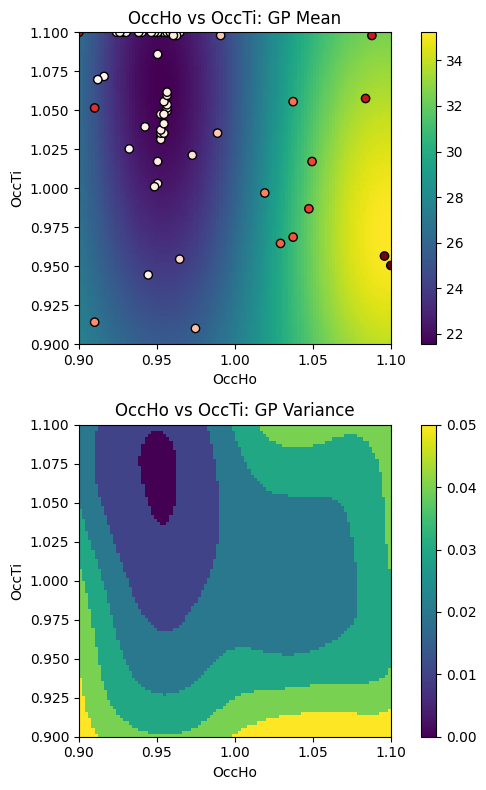

EI: [3.94361280e-03 3.93139943e-03 3.93240899e-03 ... 3.01417895e-05
 3.59782134e-05 4.35768161e-05]
Function eval #60
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [1.0575758218765259, 0.9545454382896423]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7444
initial chi^2 1.9378e+05 with 2596 obs.
New scale: 0.7392
Cycle 0: 0.59s, Chi**2: 1.4969e+05 for 2596 obs., Lambda: 0,  Delta: 0.228, SVD=0
New scale: 0.7392
Maximum shift/esd = -59.566 for a

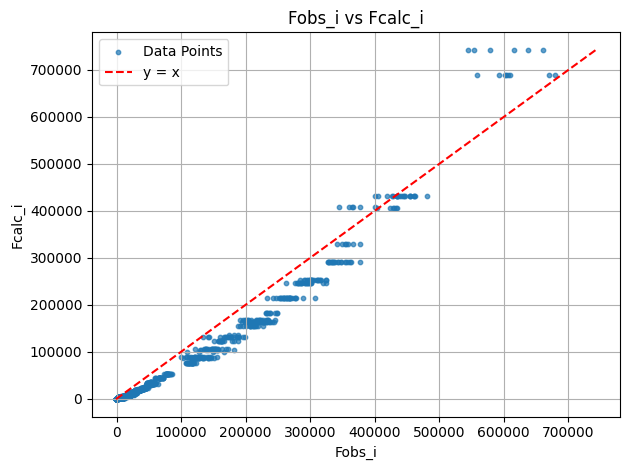

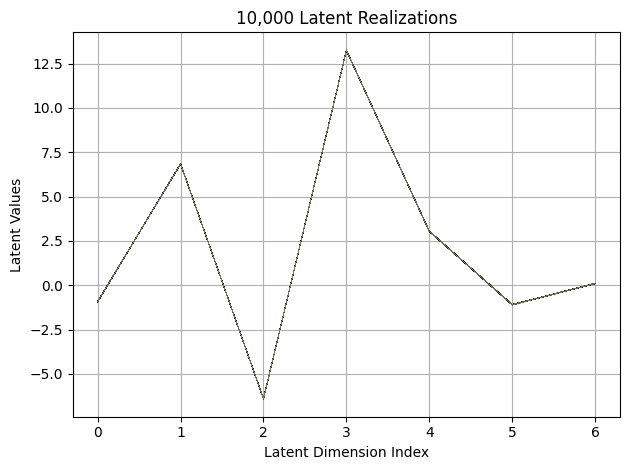

First 10 latent vectors from the VAE:
Sample 1: [-0.9215850830078125, 6.843259811401367, -6.403819561004639, 13.244181632995605, 3.04862380027771, -1.0888214111328125, 0.10112758725881577]
Sample 2: [-0.9382234215736389, 6.836764335632324, -6.402395248413086, 13.252068519592285, 3.046015977859497, -1.0806691646575928, 0.09972982853651047]
Sample 3: [-0.9343125820159912, 6.838565826416016, -6.390387058258057, 13.255670547485352, 3.043708324432373, -1.093396544456482, 0.08738920837640762]
Sample 4: [-0.9297576546669006, 6.849598407745361, -6.401655197143555, 13.258585929870605, 3.049417734146118, -1.1037425994873047, 0.0954790934920311]
Sample 5: [-0.9345682263374329, 6.837749481201172, -6.400599956512451, 13.246241569519043, 3.04282546043396, -1.0929577350616455, 0.1124810129404068]
Sample 6: [-0.9355890154838562, 6.838147163391113, -6.400122165679932, 13.250770568847656, 3.0334160327911377, -1.0935969352722168, 0.09268474578857422]
Sample 7: [-0.9240530729293823, 6.838415145874023, -6.

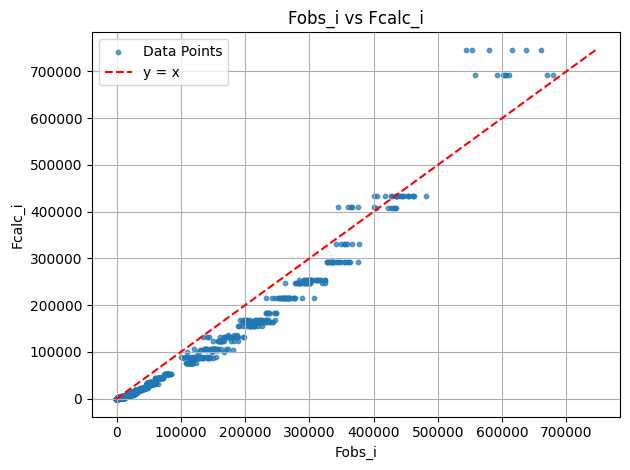

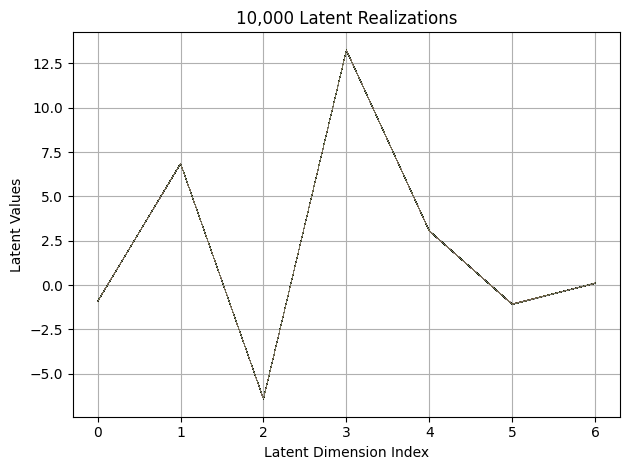

First 10 latent vectors from the VAE:
Sample 1: [-0.9237504601478577, 6.861231327056885, -6.414003849029541, 13.252923011779785, 3.0522243976593018, -1.0939602851867676, 0.09925016760826111]
Sample 2: [-0.9171872138977051, 6.855750560760498, -6.409811973571777, 13.249579429626465, 3.043583869934082, -1.098008155822754, 0.09257500618696213]
Sample 3: [-0.9244406223297119, 6.849123477935791, -6.414483070373535, 13.262563705444336, 3.052448034286499, -1.0801745653152466, 0.1009918674826622]
Sample 4: [-0.9267804026603699, 6.850158214569092, -6.4129719734191895, 13.247214317321777, 3.0503320693969727, -1.0896848440170288, 0.11236575990915298]
Sample 5: [-0.9275145530700684, 6.839385032653809, -6.419003009796143, 13.237984657287598, 3.0509119033813477, -1.0880298614501953, 0.08925701677799225]
Sample 6: [-0.9283308982849121, 6.863847255706787, -6.415018558502197, 13.252854347229004, 3.0505261421203613, -1.0898669958114624, 0.09419906884431839]
Sample 7: [-0.9435306787490845, 6.8619661331176

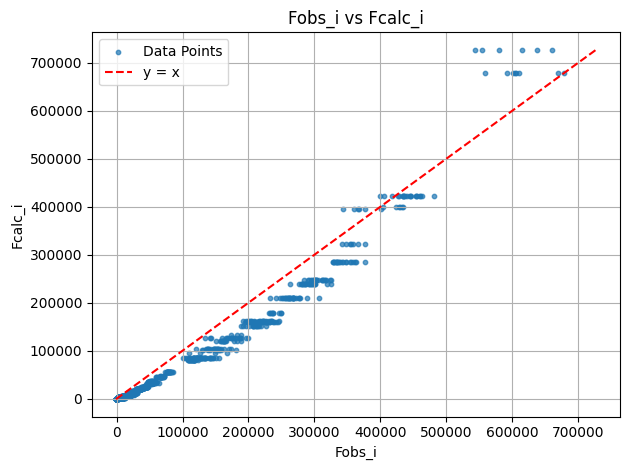

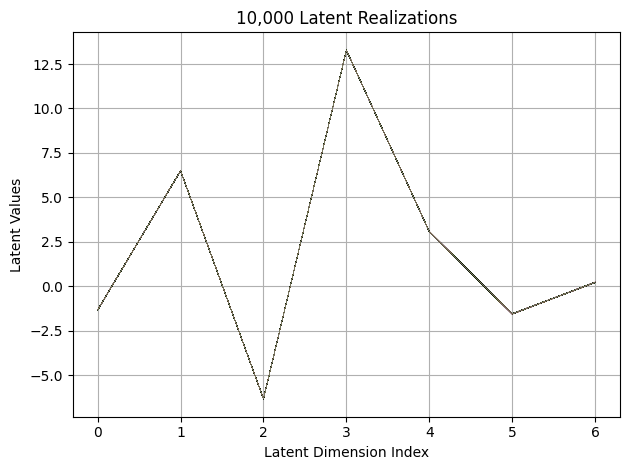

First 10 latent vectors from the VAE:
Sample 1: [-1.3474750518798828, 6.493200302124023, -6.338174819946289, 13.273585319519043, 3.06912899017334, -1.5643421411514282, 0.2203269600868225]
Sample 2: [-1.330579161643982, 6.498521327972412, -6.345742225646973, 13.272355079650879, 3.0629372596740723, -1.563988208770752, 0.21979527175426483]
Sample 3: [-1.3451311588287354, 6.487660884857178, -6.330224514007568, 13.287699699401855, 3.0723624229431152, -1.5652170181274414, 0.2099526971578598]
Sample 4: [-1.3360671997070312, 6.484912872314453, -6.348433494567871, 13.295047760009766, 3.068284273147583, -1.5699230432510376, 0.2188064157962799]
Sample 5: [-1.3422189950942993, 6.494821071624756, -6.334794044494629, 13.276630401611328, 3.062516450881958, -1.5686768293380737, 0.20924736559391022]
Sample 6: [-1.3473503589630127, 6.487079620361328, -6.3430495262146, 13.268397331237793, 3.066023349761963, -1.5625669956207275, 0.2078048139810562]
Sample 7: [-1.3294912576675415, 6.49179220199585, -6.3431

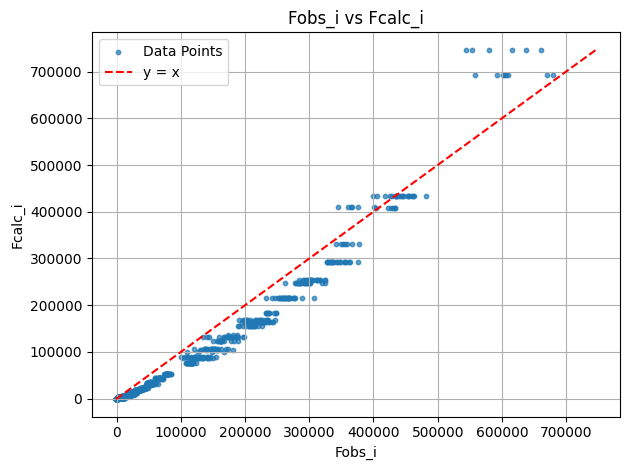

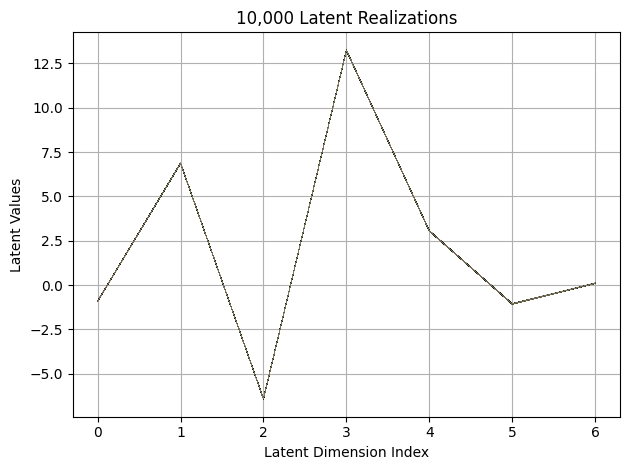

First 10 latent vectors from the VAE:
Sample 1: [-0.9015858769416809, 6.873995780944824, -6.417198657989502, 13.248446464538574, 3.0518510341644287, -1.066627860069275, 0.09884773939847946]
Sample 2: [-0.9190575480461121, 6.860667705535889, -6.42854642868042, 13.240218162536621, 3.058492660522461, -1.0658868551254272, 0.10348210483789444]
Sample 3: [-0.9162017703056335, 6.874848365783691, -6.42726469039917, 13.241273880004883, 3.047016143798828, -1.0746936798095703, 0.10583963990211487]
Sample 4: [-0.9118426442146301, 6.8589863777160645, -6.420823574066162, 13.254201889038086, 3.053770065307617, -1.0770037174224854, 0.10181459784507751]
Sample 5: [-0.9131174087524414, 6.873870849609375, -6.4180097579956055, 13.241297721862793, 3.046462297439575, -1.0690621137619019, 0.09815967082977295]
Sample 6: [-0.9106094241142273, 6.856814861297607, -6.416316032409668, 13.253572463989258, 3.0550267696380615, -1.0679848194122314, 0.08453182131052017]
Sample 7: [-0.9170000553131104, 6.873569488525391

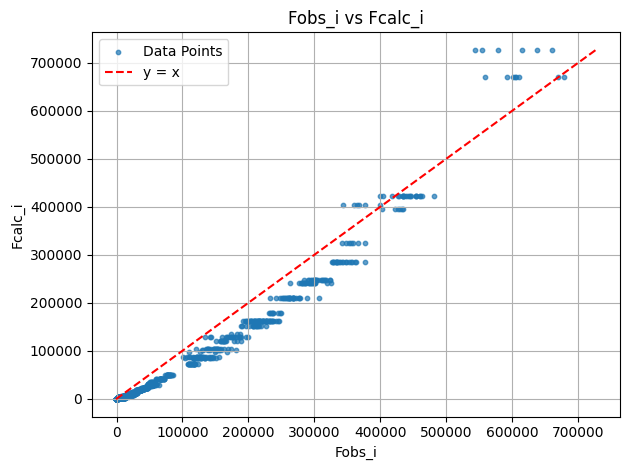

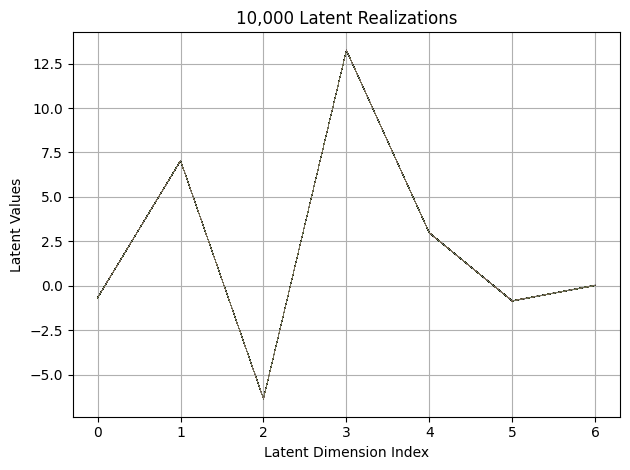

First 10 latent vectors from the VAE:
Sample 1: [-0.6596051454544067, 7.028012752532959, -6.353941917419434, 13.247746467590332, 2.975795269012451, -0.8663594722747803, 0.022479314357042313]
Sample 2: [-0.6695109605789185, 7.045730113983154, -6.347322463989258, 13.25314712524414, 2.98392391204834, -0.8485455513000488, 0.024827422574162483]
Sample 3: [-0.6777904033660889, 7.045476913452148, -6.360660076141357, 13.250475883483887, 2.9789557456970215, -0.8417893648147583, 0.02271757833659649]
Sample 4: [-0.6592842936515808, 7.033258438110352, -6.362951278686523, 13.246683120727539, 2.9823265075683594, -0.8490429520606995, 0.024482961744070053]
Sample 5: [-0.6767246723175049, 7.0364670753479, -6.360874176025391, 13.248353958129883, 2.985783100128174, -0.8537823557853699, 0.02495979145169258]
Sample 6: [-0.6729809641838074, 7.047886371612549, -6.350598335266113, 13.240193367004395, 2.965980052947998, -0.8413746356964111, 0.025561576709151268]
Sample 7: [-0.6659350395202637, 7.03108119964599

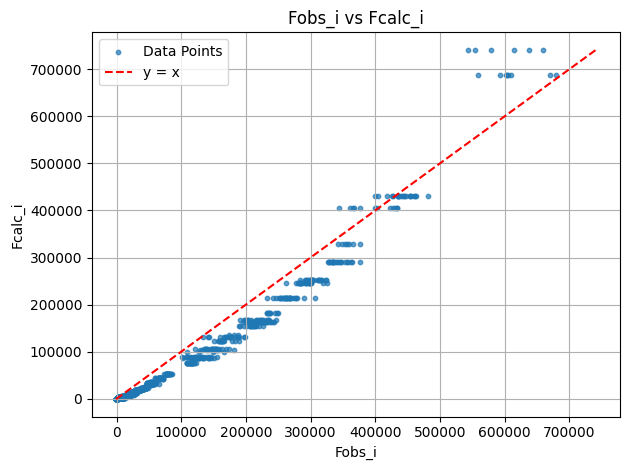

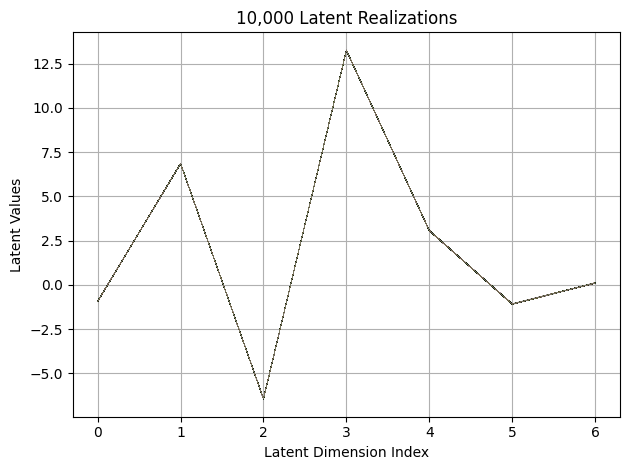

First 10 latent vectors from the VAE:
Sample 1: [-0.9324406981468201, 6.848042011260986, -6.428411960601807, 13.234633445739746, 3.0702898502349854, -1.08992600440979, 0.09991009533405304]
Sample 2: [-0.9360142350196838, 6.861275672912598, -6.440413475036621, 13.24410343170166, 3.0696263313293457, -1.0908668041229248, 0.09810269623994827]
Sample 3: [-0.9486611485481262, 6.8357648849487305, -6.443568229675293, 13.2393159866333, 3.0712690353393555, -1.0941848754882812, 0.10616496205329895]
Sample 4: [-0.9360300898551941, 6.844233989715576, -6.43707275390625, 13.249646186828613, 3.070307731628418, -1.0780842304229736, 0.10316955298185349]
Sample 5: [-0.946025550365448, 6.845588207244873, -6.439457893371582, 13.25688362121582, 3.0735294818878174, -1.086308479309082, 0.10496486723423004]
Sample 6: [-0.9457940459251404, 6.85979700088501, -6.433786869049072, 13.23987102508545, 3.0672900676727295, -1.075304388999939, 0.10658784210681915]
Sample 7: [-0.9445094466209412, 6.841575622558594, -6.44

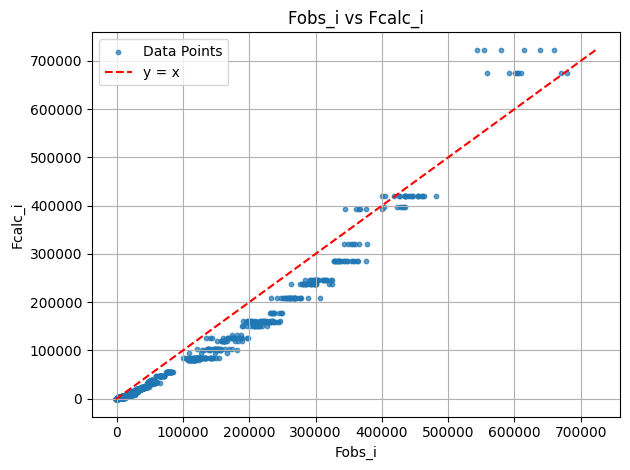

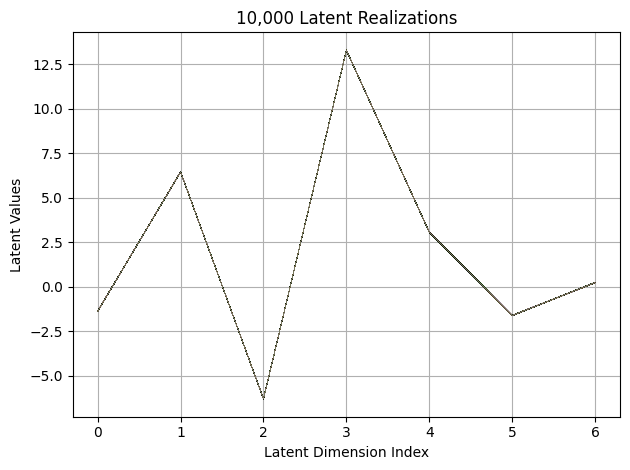

First 10 latent vectors from the VAE:
Sample 1: [-1.3878803253173828, 6.433644771575928, -6.319949626922607, 13.28219985961914, 3.0548152923583984, -1.6210561990737915, 0.22790521383285522]
Sample 2: [-1.38791024684906, 6.436635494232178, -6.303658485412598, 13.282832145690918, 3.059981107711792, -1.6253635883331299, 0.2416059374809265]
Sample 3: [-1.3956598043441772, 6.431954860687256, -6.29970121383667, 13.271754264831543, 3.0561790466308594, -1.6277070045471191, 0.22058990597724915]
Sample 4: [-1.388144612312317, 6.427216529846191, -6.314330577850342, 13.294933319091797, 3.0686585903167725, -1.6168081760406494, 0.22623740136623383]
Sample 5: [-1.3822609186172485, 6.440571308135986, -6.310696601867676, 13.283853530883789, 3.065821647644043, -1.6192309856414795, 0.22309309244155884]
Sample 6: [-1.3945356607437134, 6.451807498931885, -6.324676990509033, 13.29333782196045, 3.0684523582458496, -1.6215142011642456, 0.2306288778781891]
Sample 7: [-1.3966116905212402, 6.435611724853516, -6.

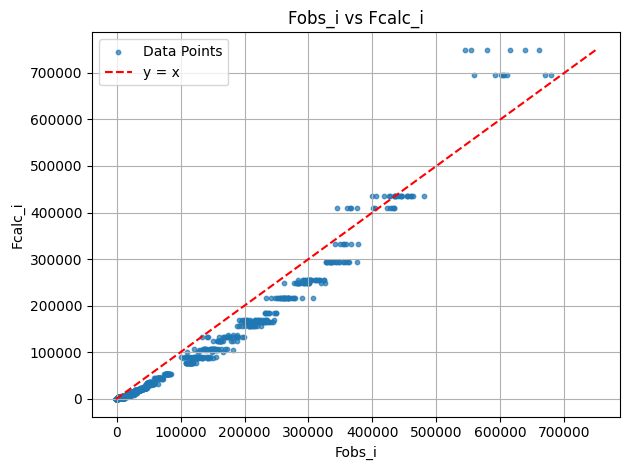

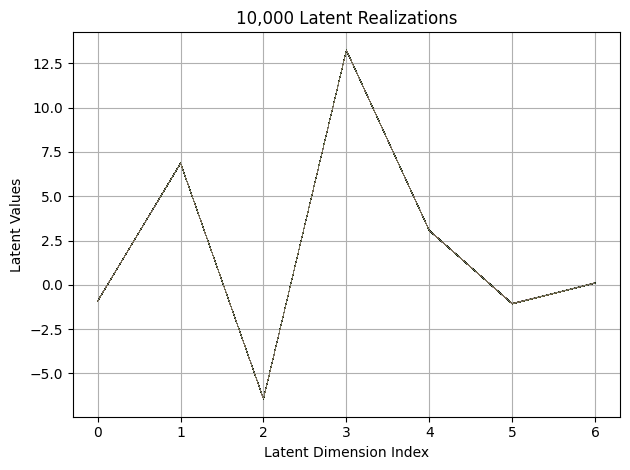

First 10 latent vectors from the VAE:
Sample 1: [-0.9183284640312195, 6.868014812469482, -6.429409027099609, 13.236927032470703, 3.057317018508911, -1.0728157758712769, 0.11040908098220825]
Sample 2: [-0.9365043640136719, 6.866647720336914, -6.437228202819824, 13.241206169128418, 3.061321973800659, -1.0740330219268799, 0.0889773964881897]
Sample 3: [-0.9275622367858887, 6.860851287841797, -6.44657564163208, 13.246820449829102, 3.0574381351470947, -1.0545282363891602, 0.09982779622077942]
Sample 4: [-0.9239005446434021, 6.866609573364258, -6.4404706954956055, 13.23902416229248, 3.0600454807281494, -1.0803850889205933, 0.10182394087314606]
Sample 5: [-0.9215394258499146, 6.872411727905273, -6.452478408813477, 13.244815826416016, 3.0645999908447266, -1.062916874885559, 0.09891822934150696]
Sample 6: [-0.9248350262641907, 6.867340564727783, -6.438371658325195, 13.244292259216309, 3.067523717880249, -1.0771903991699219, 0.0946316123008728]
Sample 7: [-0.9190507531166077, 6.849496364593506, 

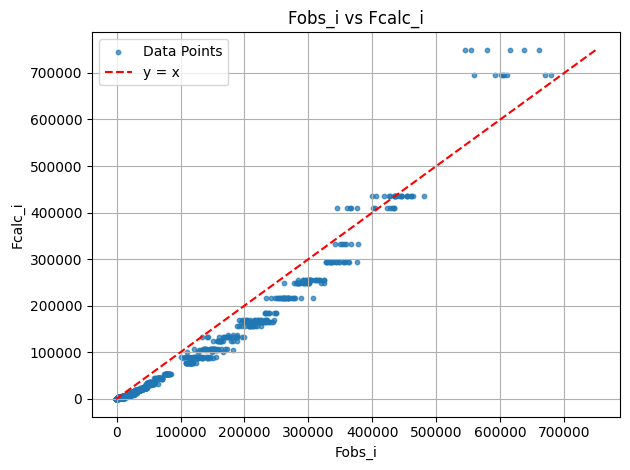

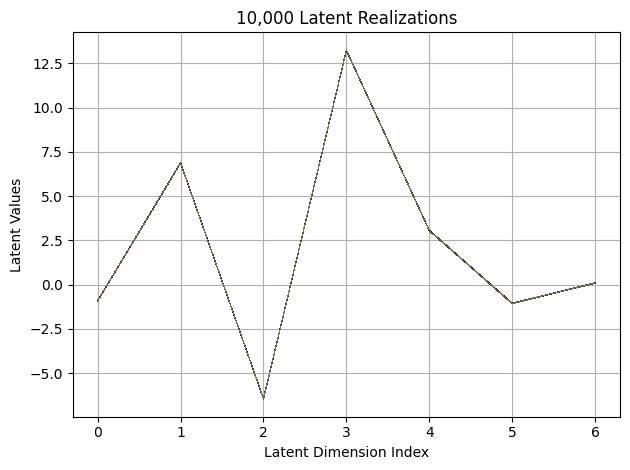

First 10 latent vectors from the VAE:
Sample 1: [-0.9126604795455933, 6.867501735687256, -6.4348649978637695, 13.244410514831543, 3.0570504665374756, -1.0602185726165771, 0.09772849828004837]
Sample 2: [-0.9168575406074524, 6.874350070953369, -6.44892692565918, 13.24316692352295, 3.060485363006592, -1.0519740581512451, 0.10274927318096161]
Sample 3: [-0.9155187010765076, 6.88292932510376, -6.432611465454102, 13.240326881408691, 3.059295415878296, -1.0462733507156372, 0.09984017163515091]
Sample 4: [-0.9024472236633301, 6.875485420227051, -6.436728477478027, 13.241985321044922, 3.063356399536133, -1.0442392826080322, 0.10837747156620026]
Sample 5: [-0.9174275994300842, 6.86882209777832, -6.453533172607422, 13.242481231689453, 3.051445960998535, -1.043658971786499, 0.09263497591018677]
Sample 6: [-0.914190411567688, 6.900763511657715, -6.424457550048828, 13.237178802490234, 3.053830862045288, -1.0488988161087036, 0.09479928761720657]
Sample 7: [-0.9105567932128906, 6.875861167907715, -6.

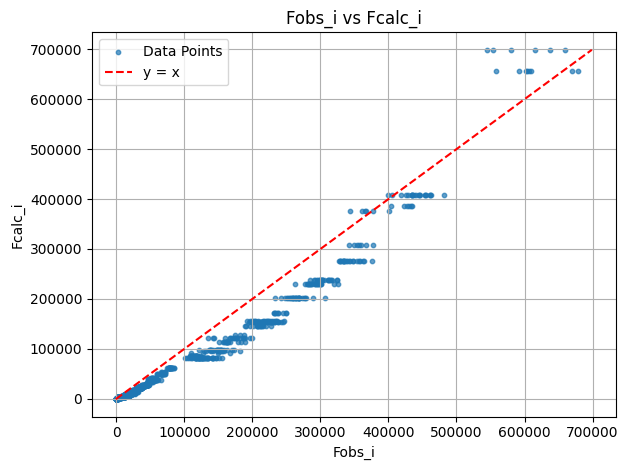

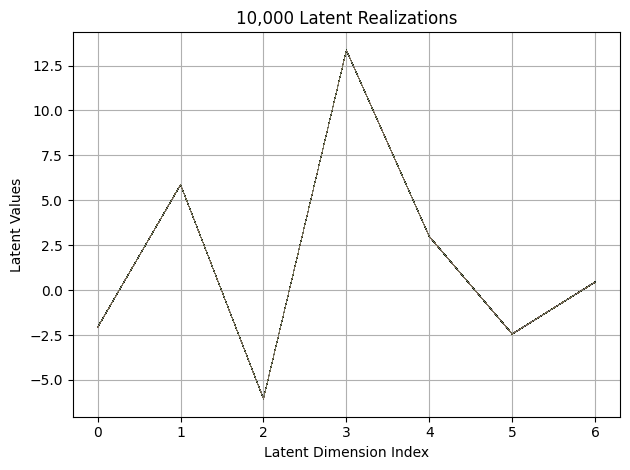

First 10 latent vectors from the VAE:
Sample 1: [-2.0667150020599365, 5.859267711639404, -6.050593376159668, 13.345915794372559, 2.9717133045196533, -2.436147689819336, 0.44198447465896606]
Sample 2: [-2.063565492630005, 5.87594747543335, -6.048552513122559, 13.349123001098633, 2.978379249572754, -2.4486608505249023, 0.44341564178466797]
Sample 3: [-2.074587106704712, 5.874113082885742, -6.055789947509766, 13.365520477294922, 2.98671817779541, -2.4447426795959473, 0.4512077271938324]
Sample 4: [-2.0696914196014404, 5.862957000732422, -6.0415167808532715, 13.343849182128906, 2.9870266914367676, -2.4440090656280518, 0.4492369294166565]
Sample 5: [-2.058298349380493, 5.856472492218018, -6.0491790771484375, 13.354244232177734, 2.9846832752227783, -2.440237045288086, 0.451236367225647]
Sample 6: [-2.0737860202789307, 5.868153095245361, -6.046463489532471, 13.35003662109375, 2.9671478271484375, -2.454212188720703, 0.4481629729270935]
Sample 7: [-2.074995279312134, 5.8691511154174805, -6.0360

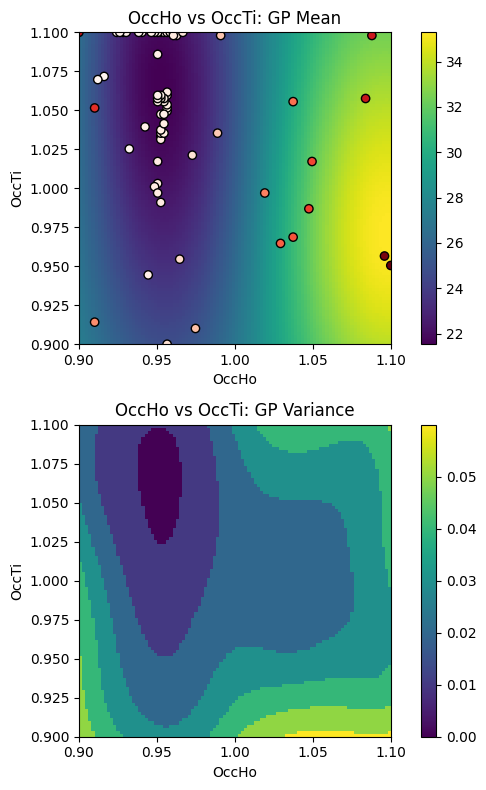

EI: [4.77985851e-03 4.76012379e-03 4.75232676e-03 ... 3.79814883e-05
 4.54356777e-05 5.51502453e-05]
Function eval #70
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [0.986868679523468, 0.9444444179534912]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7638
initial chi^2 1.7176e+05 with 2596 obs.
New scale: 0.7638
Cycle 0: 0.80s, Chi**2: 1.2851e+05 for 2596 obs., Lambda: 0,  Delta: 0.252, SVD=0
New scale: 0.7638
Maximum shift/esd = -56.487 for al

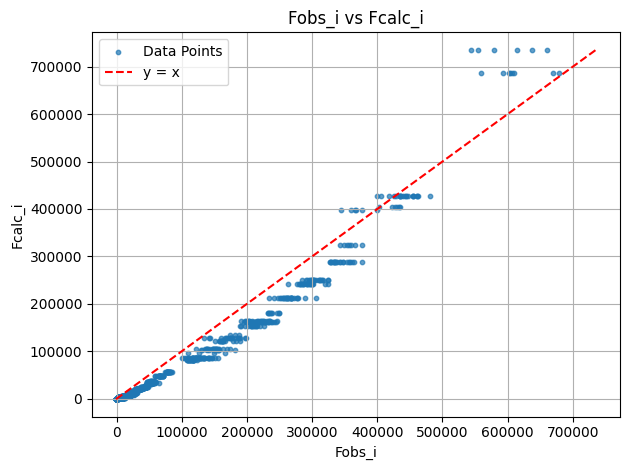

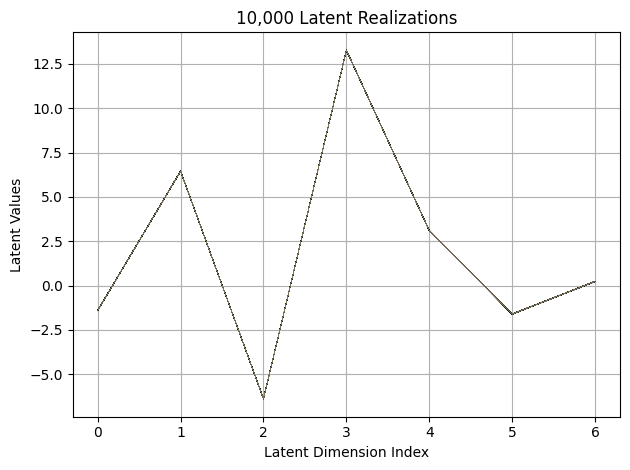

First 10 latent vectors from the VAE:
Sample 1: [-1.4165713787078857, 6.447805881500244, -6.3709397315979, 13.27474594116211, 3.1141154766082764, -1.601181149482727, 0.23977144062519073]
Sample 2: [-1.3997548818588257, 6.452587127685547, -6.371378421783447, 13.278644561767578, 3.113259792327881, -1.6081064939498901, 0.23139294981956482]
Sample 3: [-1.3961634635925293, 6.448040962219238, -6.381598949432373, 13.277141571044922, 3.100722551345825, -1.6179848909378052, 0.23448702692985535]
Sample 4: [-1.4175152778625488, 6.452076435089111, -6.372882843017578, 13.26848030090332, 3.1073741912841797, -1.6079784631729126, 0.24686312675476074]
Sample 5: [-1.406149983406067, 6.452516078948975, -6.385696887969971, 13.274686813354492, 3.089233160018921, -1.6158483028411865, 0.24338915944099426]
Sample 6: [-1.417853832244873, 6.455160617828369, -6.394894599914551, 13.264993667602539, 3.094975233078003, -1.6070016622543335, 0.24619053304195404]
Sample 7: [-1.4040179252624512, 6.45355749130249, -6.37

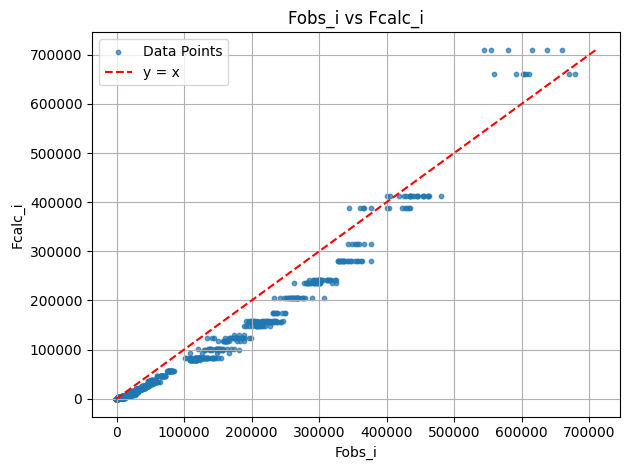

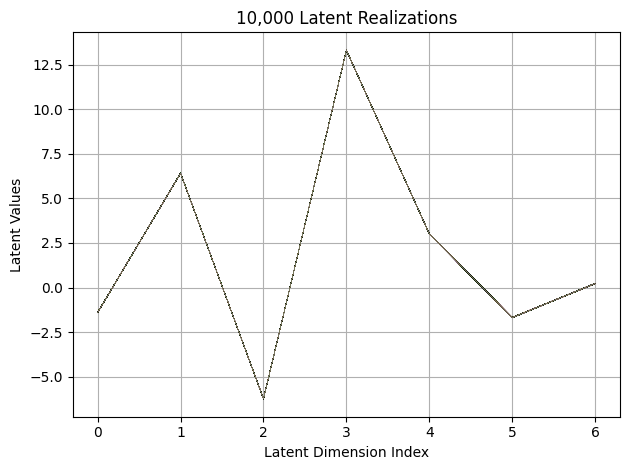

First 10 latent vectors from the VAE:
Sample 1: [-1.3957626819610596, 6.386058807373047, -6.2319536209106445, 13.286579132080078, 3.010512113571167, -1.6871131658554077, 0.22477927803993225]
Sample 2: [-1.3935327529907227, 6.397556304931641, -6.238862991333008, 13.302700996398926, 3.027446985244751, -1.6794513463974, 0.2223629355430603]
Sample 3: [-1.397627353668213, 6.409026622772217, -6.228005886077881, 13.30057430267334, 3.020352363586426, -1.6781479120254517, 0.2345849573612213]
Sample 4: [-1.4010944366455078, 6.4114789962768555, -6.239106178283691, 13.294953346252441, 3.0229973793029785, -1.6835708618164062, 0.21700820326805115]
Sample 5: [-1.4075416326522827, 6.4103007316589355, -6.226929187774658, 13.289015769958496, 3.015359878540039, -1.6855939626693726, 0.21594522893428802]
Sample 6: [-1.4019083976745605, 6.403344631195068, -6.2410969734191895, 13.300575256347656, 3.005603551864624, -1.6886494159698486, 0.22293837368488312]
Sample 7: [-1.3953958749771118, 6.403047561645508, -

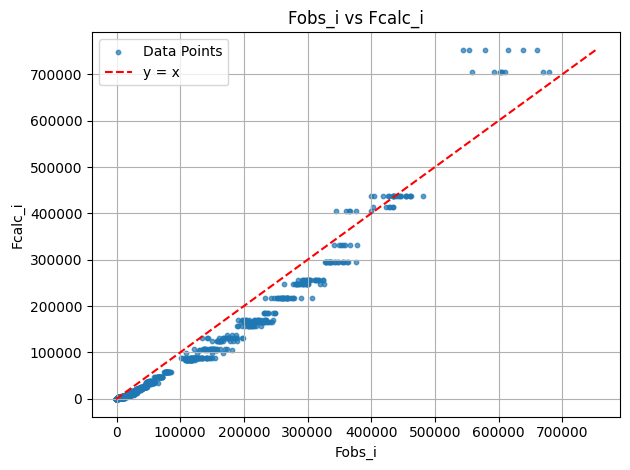

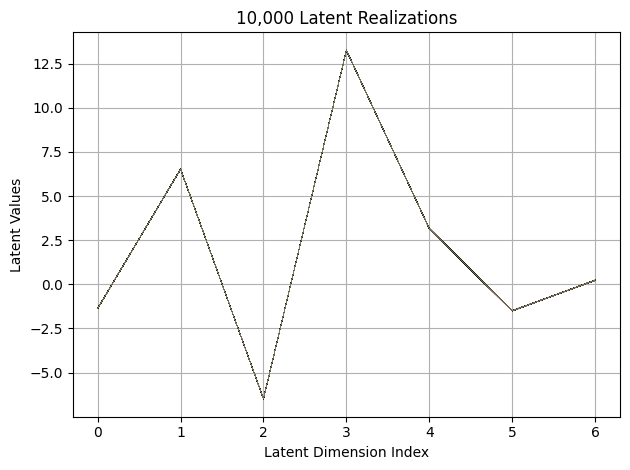

First 10 latent vectors from the VAE:
Sample 1: [-1.3498375415802002, 6.51244592666626, -6.485438346862793, 13.263648986816406, 3.152508497238159, -1.5056565999984741, 0.22673769295215607]
Sample 2: [-1.3508402109146118, 6.518989086151123, -6.478271007537842, 13.256523132324219, 3.1522297859191895, -1.505407452583313, 0.22541482746601105]
Sample 3: [-1.361322283744812, 6.5185136795043945, -6.485840797424316, 13.253283500671387, 3.153000593185425, -1.5118579864501953, 0.22519570589065552]
Sample 4: [-1.3613792657852173, 6.5192484855651855, -6.49275016784668, 13.254576683044434, 3.150728702545166, -1.4977669715881348, 0.22261455655097961]
Sample 5: [-1.3703738451004028, 6.520536422729492, -6.482651710510254, 13.256071090698242, 3.15731143951416, -1.5001378059387207, 0.2395583540201187]
Sample 6: [-1.3647395372390747, 6.5317158699035645, -6.484277248382568, 13.248680114746094, 3.149190902709961, -1.5081485509872437, 0.23250757157802582]
Sample 7: [-1.3744802474975586, 6.521798133850098, -

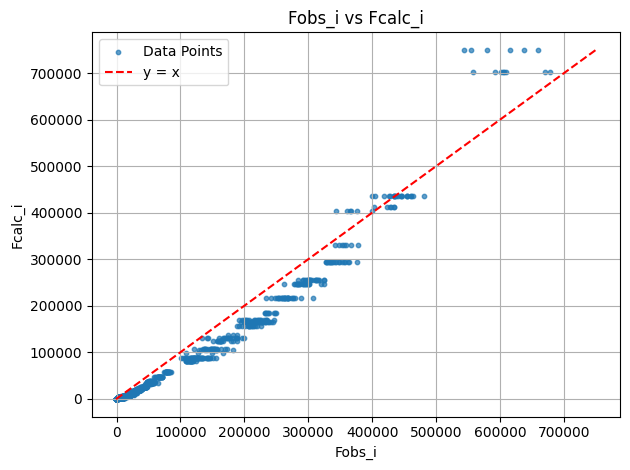

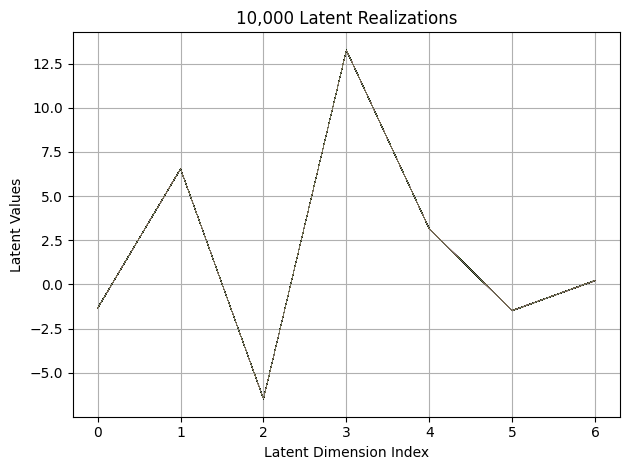

First 10 latent vectors from the VAE:
Sample 1: [-1.348162293434143, 6.544726371765137, -6.466266632080078, 13.25308609008789, 3.152541399002075, -1.4792118072509766, 0.22177378833293915]
Sample 2: [-1.3476200103759766, 6.538334369659424, -6.468965530395508, 13.232182502746582, 3.1365320682525635, -1.479756474494934, 0.2141495794057846]
Sample 3: [-1.3495309352874756, 6.524837017059326, -6.47163200378418, 13.24977970123291, 3.1301567554473877, -1.4769282341003418, 0.22996772825717926]
Sample 4: [-1.3369169235229492, 6.540071487426758, -6.465692520141602, 13.253885269165039, 3.133173942565918, -1.4895281791687012, 0.21928900480270386]
Sample 5: [-1.3359520435333252, 6.532824993133545, -6.483689308166504, 13.252492904663086, 3.1576716899871826, -1.4918714761734009, 0.2168598175048828]
Sample 6: [-1.336268424987793, 6.536448955535889, -6.475985527038574, 13.25534439086914, 3.1536927223205566, -1.4886653423309326, 0.2140817493200302]
Sample 7: [-1.3319083452224731, 6.5419769287109375, -6.4

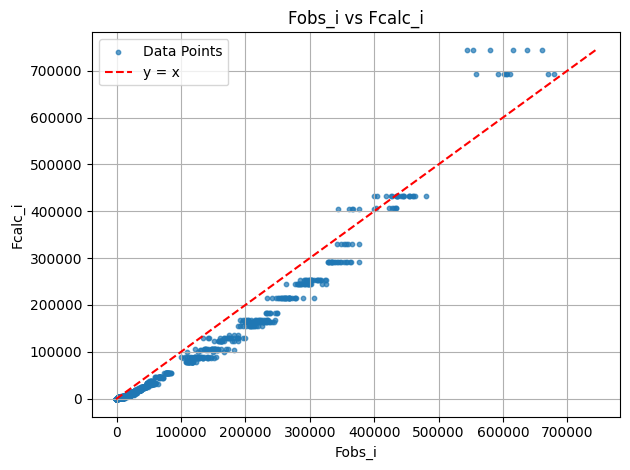

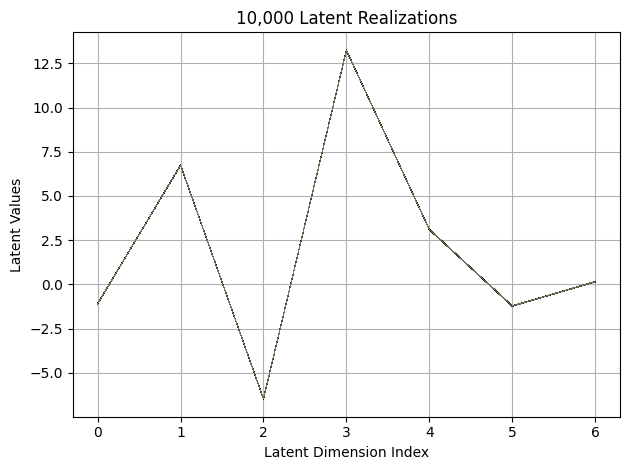

First 10 latent vectors from the VAE:
Sample 1: [-1.083554983139038, 6.738920211791992, -6.464839935302734, 13.24053955078125, 3.1024551391601562, -1.2247710227966309, 0.14279788732528687]
Sample 2: [-1.0991069078445435, 6.744046211242676, -6.476253986358643, 13.234888076782227, 3.1077048778533936, -1.219467043876648, 0.1470133662223816]
Sample 3: [-1.0933643579483032, 6.74146032333374, -6.467730522155762, 13.247414588928223, 3.1130337715148926, -1.2329936027526855, 0.15844576060771942]
Sample 4: [-1.1027843952178955, 6.740246295928955, -6.480474948883057, 13.25384521484375, 3.105647087097168, -1.225698471069336, 0.15163443982601166]
Sample 5: [-1.0971450805664062, 6.739446640014648, -6.466917037963867, 13.2627534866333, 3.107661247253418, -1.2179269790649414, 0.15565182268619537]
Sample 6: [-1.107467532157898, 6.736548900604248, -6.46176815032959, 13.242606163024902, 3.111506462097168, -1.2102731466293335, 0.13739870488643646]
Sample 7: [-1.0945907831192017, 6.746182918548584, -6.4823

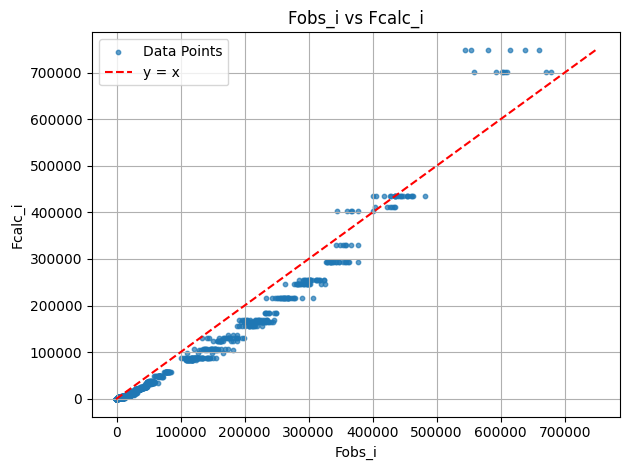

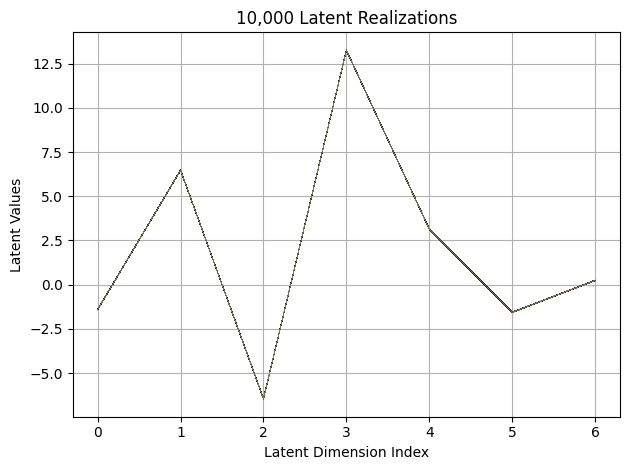

First 10 latent vectors from the VAE:
Sample 1: [-1.4254957437515259, 6.467132568359375, -6.455418109893799, 13.252420425415039, 3.1360530853271484, -1.577258825302124, 0.24072952568531036]
Sample 2: [-1.4228951930999756, 6.476858139038086, -6.443917751312256, 13.25766658782959, 3.1409194469451904, -1.572035789489746, 0.2295752763748169]
Sample 3: [-1.4080653190612793, 6.450479030609131, -6.463274002075195, 13.248363494873047, 3.1492104530334473, -1.5577788352966309, 0.23192688822746277]
Sample 4: [-1.4122294187545776, 6.471794128417969, -6.472420692443848, 13.247903823852539, 3.143332004547119, -1.5642632246017456, 0.25242161750793457]
Sample 5: [-1.403947353363037, 6.475561618804932, -6.460875988006592, 13.263701438903809, 3.1436688899993896, -1.573024034500122, 0.2435724437236786]
Sample 6: [-1.4222757816314697, 6.460943222045898, -6.441583633422852, 13.25888729095459, 3.146122694015503, -1.5540703535079956, 0.2293376326560974]
Sample 7: [-1.3980200290679932, 6.461759090423584, -6.4

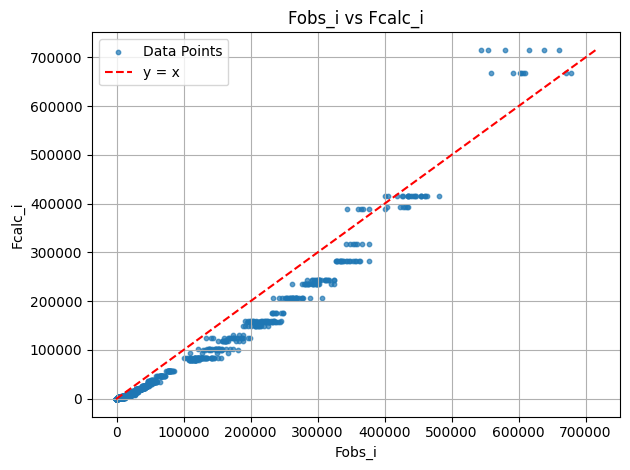

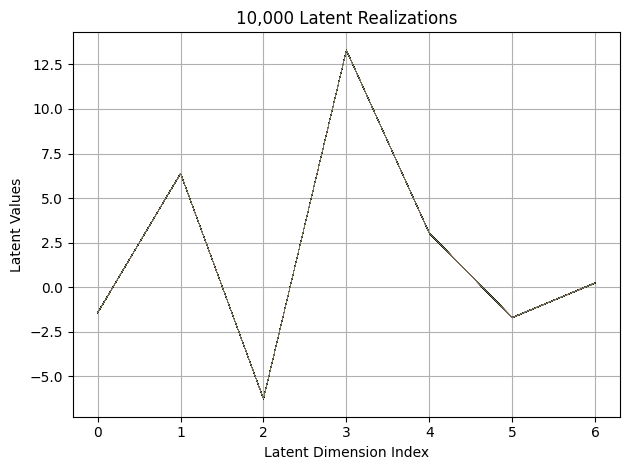

First 10 latent vectors from the VAE:
Sample 1: [-1.4438366889953613, 6.388199806213379, -6.250282287597656, 13.300996780395508, 3.015709638595581, -1.712256908416748, 0.247353196144104]
Sample 2: [-1.4275050163269043, 6.401529312133789, -6.261441230773926, 13.297040939331055, 3.0406715869903564, -1.7031716108322144, 0.24049149453639984]
Sample 3: [-1.4294006824493408, 6.385055065155029, -6.248436450958252, 13.28711223602295, 3.0346267223358154, -1.7042921781539917, 0.2320457100868225]
Sample 4: [-1.440033197402954, 6.3734331130981445, -6.265368461608887, 13.28707218170166, 3.031205654144287, -1.7126624584197998, 0.2287633717060089]
Sample 5: [-1.4456440210342407, 6.390231132507324, -6.275926113128662, 13.296727180480957, 3.047907590866089, -1.6992316246032715, 0.22457653284072876]
Sample 6: [-1.4396693706512451, 6.382776737213135, -6.265111923217773, 13.28884220123291, 3.0293455123901367, -1.7135967016220093, 0.24064728617668152]
Sample 7: [-1.431265115737915, 6.396423816680908, -6.25

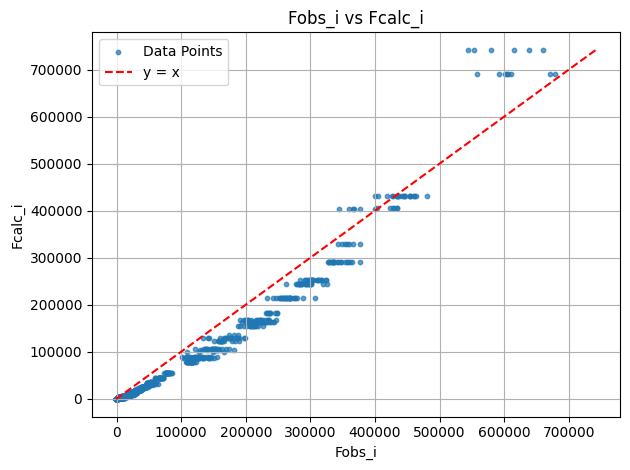

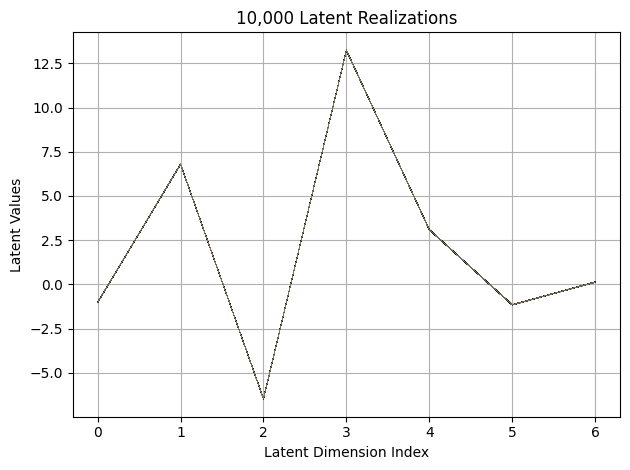

First 10 latent vectors from the VAE:
Sample 1: [-1.0114185810089111, 6.793899059295654, -6.462984085083008, 13.235257148742676, 3.0993125438690186, -1.1479864120483398, 0.1388254165649414]
Sample 2: [-1.0267682075500488, 6.793419361114502, -6.464601039886475, 13.239822387695312, 3.0969948768615723, -1.1613531112670898, 0.12555871903896332]
Sample 3: [-1.0335382223129272, 6.801377773284912, -6.472637176513672, 13.230131149291992, 3.094078540802002, -1.1586614847183228, 0.11688125133514404]
Sample 4: [-1.0332781076431274, 6.784111976623535, -6.471658229827881, 13.236651420593262, 3.0961906909942627, -1.1635258197784424, 0.1380872130393982]
Sample 5: [-1.0333589315414429, 6.800289630889893, -6.467587947845459, 13.246722221374512, 3.0838253498077393, -1.1576555967330933, 0.12759283185005188]
Sample 6: [-1.0314850807189941, 6.79000186920166, -6.4739460945129395, 13.242620468139648, 3.092729091644287, -1.1576640605926514, 0.13253632187843323]
Sample 7: [-1.0255895853042603, 6.79258966445922

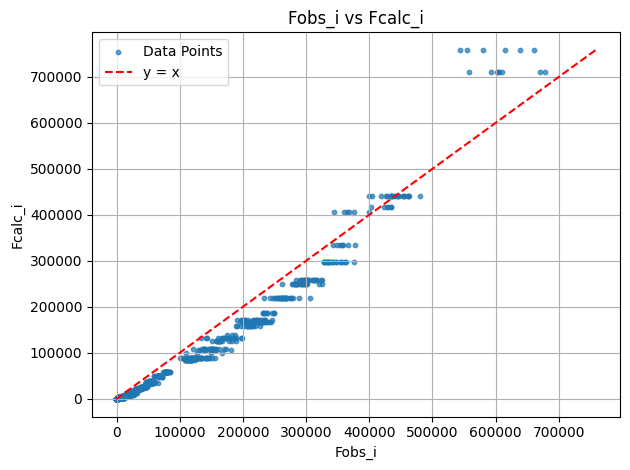

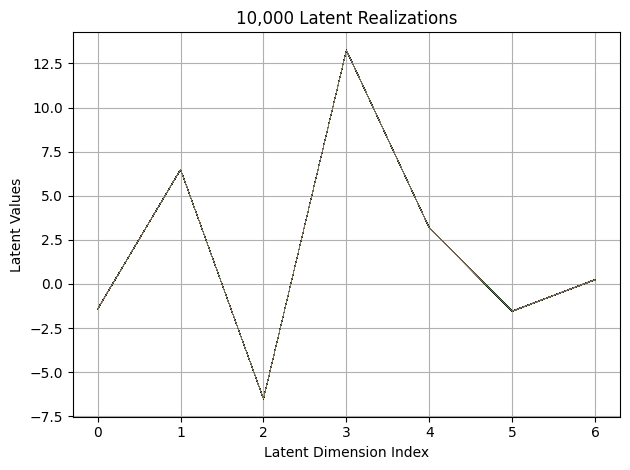

First 10 latent vectors from the VAE:
Sample 1: [-1.4129093885421753, 6.475218772888184, -6.50901460647583, 13.252856254577637, 3.185661554336548, -1.5406076908111572, 0.263523668050766]
Sample 2: [-1.424485683441162, 6.467604637145996, -6.5069193840026855, 13.238515853881836, 3.169529438018799, -1.5291131734848022, 0.24018582701683044]
Sample 3: [-1.4170727729797363, 6.4901652336120605, -6.511396408081055, 13.250879287719727, 3.176989793777466, -1.5522249937057495, 0.24355778098106384]
Sample 4: [-1.4229861497879028, 6.479213237762451, -6.512350082397461, 13.254530906677246, 3.175649642944336, -1.5436408519744873, 0.24792079627513885]
Sample 5: [-1.4176232814788818, 6.4955058097839355, -6.499605655670166, 13.258505821228027, 3.1808600425720215, -1.544198751449585, 0.2488616406917572]
Sample 6: [-1.4188947677612305, 6.489262580871582, -6.50285005569458, 13.23859977722168, 3.1768436431884766, -1.5426738262176514, 0.24089553952217102]
Sample 7: [-1.4143375158309937, 6.484984397888184, -6

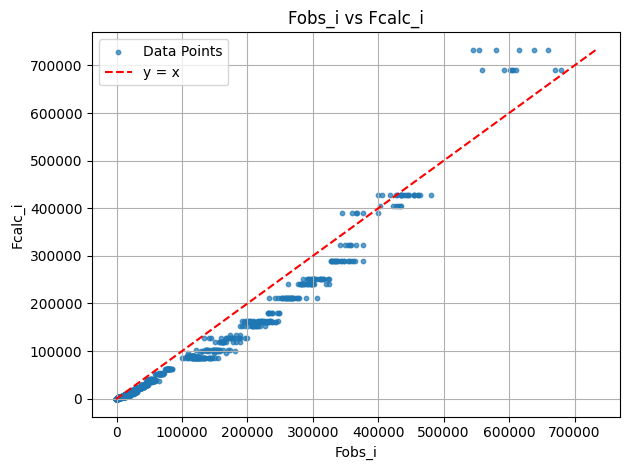

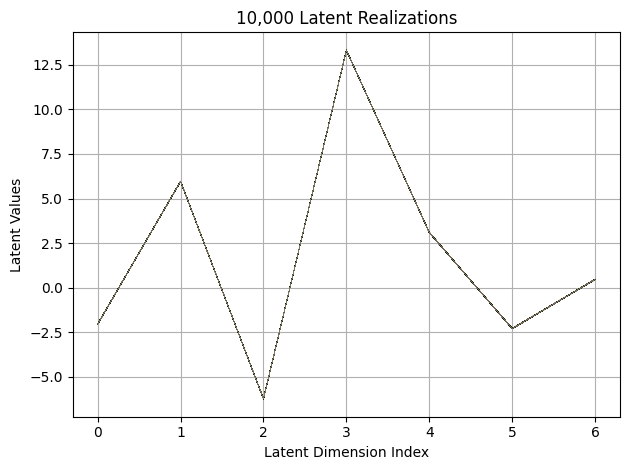

First 10 latent vectors from the VAE:
Sample 1: [-2.0627615451812744, 5.957351207733154, -6.237322807312012, 13.30846118927002, 3.097626209259033, -2.2891461849212646, 0.4717370867729187]
Sample 2: [-2.0574607849121094, 5.969333171844482, -6.243503570556641, 13.317764282226562, 3.111257314682007, -2.3067455291748047, 0.4722141623497009]
Sample 3: [-2.0477402210235596, 5.968612194061279, -6.232972621917725, 13.318038940429688, 3.097888708114624, -2.3021693229675293, 0.4623280167579651]
Sample 4: [-2.0548651218414307, 5.94692850112915, -6.2336835861206055, 13.319319725036621, 3.099888324737549, -2.3093924522399902, 0.4558980166912079]
Sample 5: [-2.0610058307647705, 5.964940071105957, -6.230956077575684, 13.315281867980957, 3.0879101753234863, -2.29366135597229, 0.4596196711063385]
Sample 6: [-2.0488479137420654, 5.968071937561035, -6.242229461669922, 13.31033706665039, 3.0980732440948486, -2.3144164085388184, 0.4571944773197174]
Sample 7: [-2.0518038272857666, 5.960125923156738, -6.2398

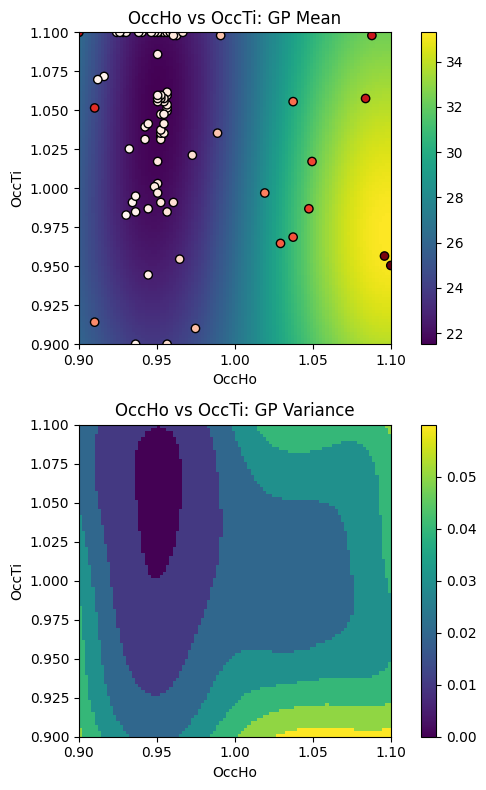

EI: [7.41273351e-03 7.35368207e-03 7.30319507e-03 ... 4.25546314e-05
 5.06418291e-05 6.11380674e-05]
Function eval #80
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [0.8999999761581421, 0.8999999761581421]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
initial chi^2 96970 with 2596 obs.
Cycle 0: 0.62s, Chi**2: 57944 for 2596 obs., Lambda: 0,  Delta: 0.402, SVD=0
Maximum shift/esd = -39.324 for all cycles
Read from file:C:\Users\USER\PhD\IAMM PROJECT\BO\Task_

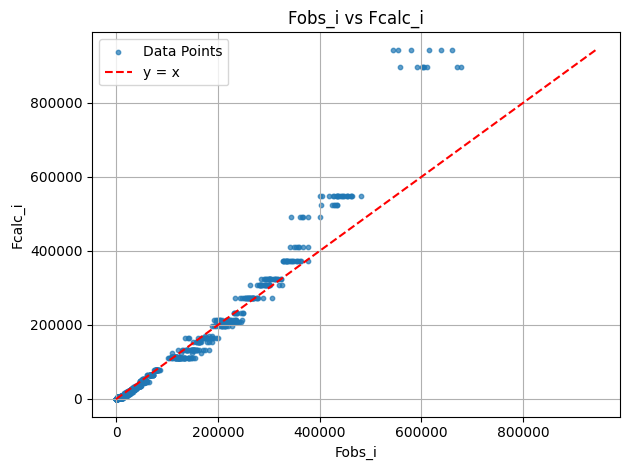

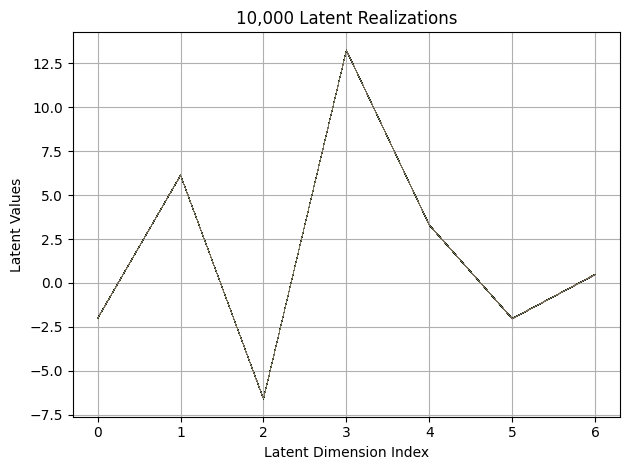

First 10 latent vectors from the VAE:
Sample 1: [-2.0188052654266357, 6.115561008453369, -6.598932266235352, 13.256987571716309, 3.3013856410980225, -2.035088539123535, 0.48615384101867676]
Sample 2: [-2.0147368907928467, 6.133927822113037, -6.59151029586792, 13.248892784118652, 3.295175313949585, -2.0382425785064697, 0.4826388657093048]
Sample 3: [-2.015409231185913, 6.119556903839111, -6.582573413848877, 13.25222110748291, 3.2945120334625244, -2.0222034454345703, 0.4791960120201111]
Sample 4: [-2.013528347015381, 6.130773544311523, -6.5950117111206055, 13.251688957214355, 3.2947144508361816, -2.030935525894165, 0.47491687536239624]
Sample 5: [-2.0164120197296143, 6.1359758377075195, -6.590047836303711, 13.24724006652832, 3.302950143814087, -2.017061233520508, 0.4702996015548706]
Sample 6: [-2.01840877532959, 6.133909702301025, -6.600979804992676, 13.239339828491211, 3.292722225189209, -2.030808448791504, 0.4802355170249939]
Sample 7: [-2.020031690597534, 6.134704113006592, -6.5928359

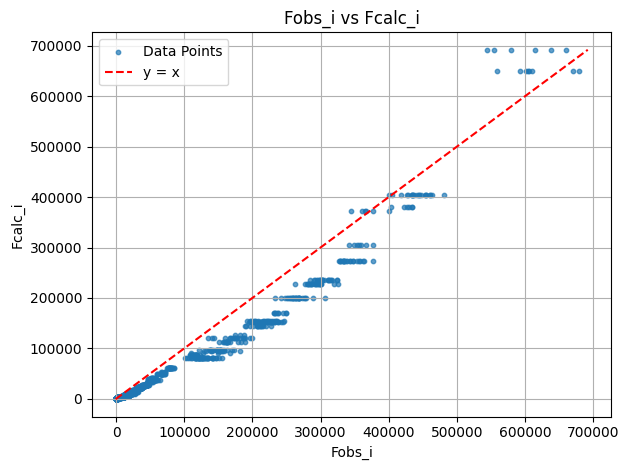

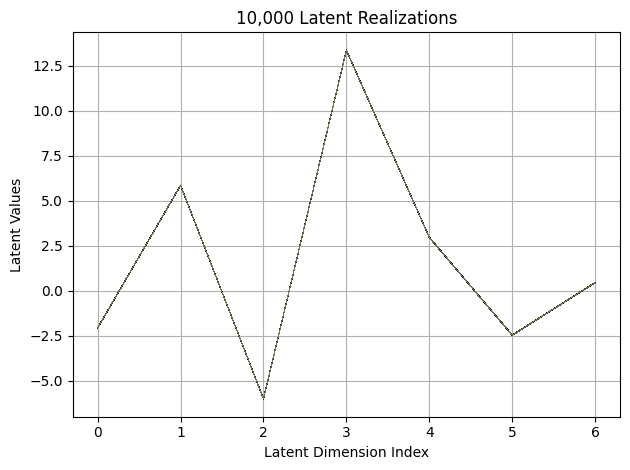

First 10 latent vectors from the VAE:
Sample 1: [-2.0686724185943604, 5.846062183380127, -6.007786750793457, 13.35551643371582, 2.961904764175415, -2.4725513458251953, 0.43802279233932495]
Sample 2: [-2.0761542320251465, 5.838193416595459, -6.000910758972168, 13.367071151733398, 2.9689674377441406, -2.477266788482666, 0.43943196535110474]
Sample 3: [-2.067377805709839, 5.860748767852783, -6.0043253898620605, 13.358549118041992, 2.96694016456604, -2.4879605770111084, 0.45449820160865784]
Sample 4: [-2.0667173862457275, 5.85192346572876, -6.018508434295654, 13.348891258239746, 2.960291862487793, -2.470086097717285, 0.4463784396648407]
Sample 5: [-2.0720698833465576, 5.852259635925293, -6.016546249389648, 13.360984802246094, 2.962449789047241, -2.486506938934326, 0.44634366035461426]
Sample 6: [-2.059821844100952, 5.851315021514893, -6.006050109863281, 13.35997200012207, 2.961209535598755, -2.464716672897339, 0.43971866369247437]
Sample 7: [-2.0598349571228027, 5.8554792404174805, -6.0091

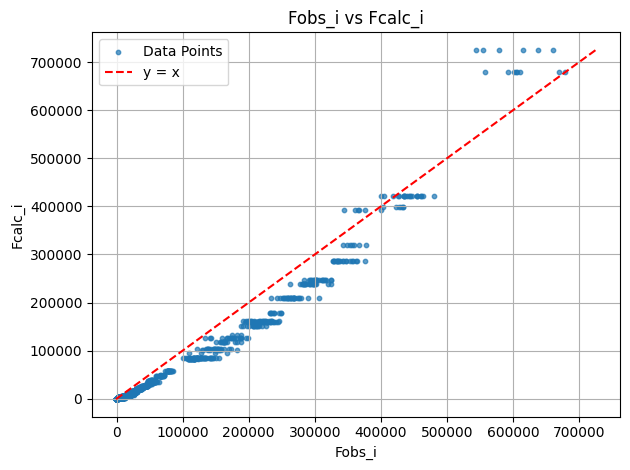

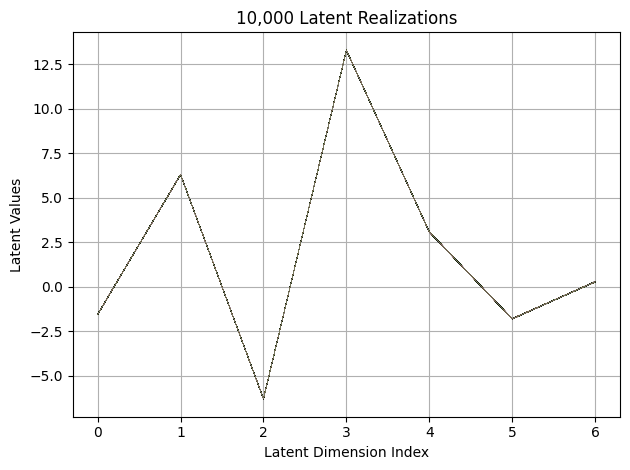

First 10 latent vectors from the VAE:
Sample 1: [-1.5613213777542114, 6.308018684387207, -6.310472011566162, 13.282529830932617, 3.0872859954833984, -1.7934490442276, 0.2822498679161072]
Sample 2: [-1.5565789937973022, 6.304815769195557, -6.300983428955078, 13.289708137512207, 3.073857069015503, -1.8079408407211304, 0.2837415039539337]
Sample 3: [-1.56410813331604, 6.299089431762695, -6.300268650054932, 13.291153907775879, 3.082324981689453, -1.817907691001892, 0.2668731212615967]
Sample 4: [-1.5578488111495972, 6.290881633758545, -6.298308372497559, 13.273253440856934, 3.072268009185791, -1.799617052078247, 0.2780076563358307]
Sample 5: [-1.5661946535110474, 6.311182498931885, -6.309223175048828, 13.281432151794434, 3.086219310760498, -1.805317997932434, 0.28105559945106506]
Sample 6: [-1.5640349388122559, 6.314425468444824, -6.307247638702393, 13.283442497253418, 3.07655930519104, -1.8090708255767822, 0.2762242555618286]
Sample 7: [-1.5545717477798462, 6.29979944229126, -6.3048868179

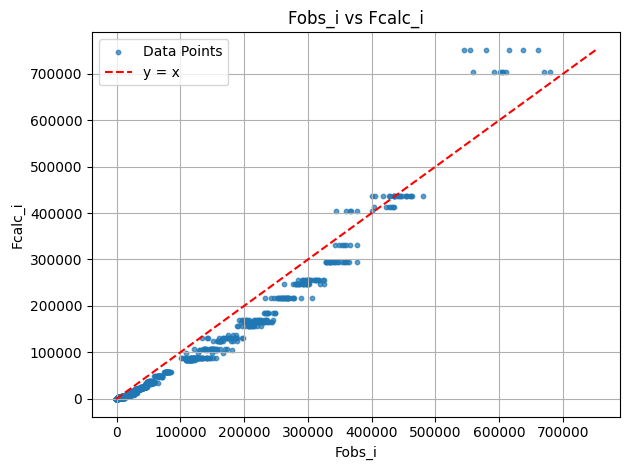

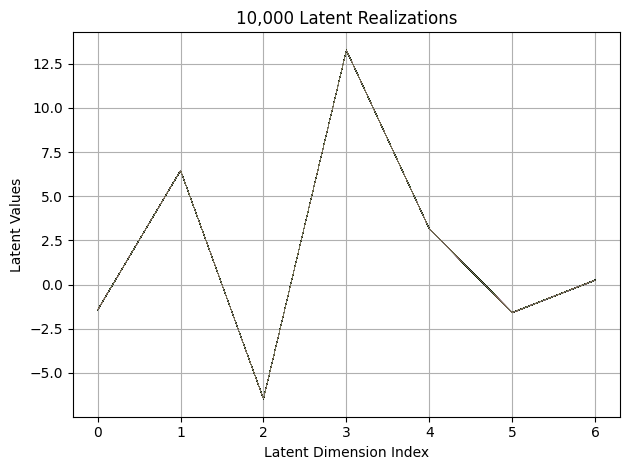

First 10 latent vectors from the VAE:
Sample 1: [-1.438551425933838, 6.463862419128418, -6.473623752593994, 13.261082649230957, 3.1529922485351562, -1.597833275794983, 0.23193708062171936]
Sample 2: [-1.4395153522491455, 6.45845365524292, -6.4735918045043945, 13.253350257873535, 3.152022361755371, -1.5807236433029175, 0.2505323588848114]
Sample 3: [-1.4332200288772583, 6.456714153289795, -6.457244873046875, 13.254928588867188, 3.1524369716644287, -1.580852746963501, 0.24708452820777893]
Sample 4: [-1.4346461296081543, 6.451581001281738, -6.469966411590576, 13.256006240844727, 3.153963327407837, -1.5831429958343506, 0.26227161288261414]
Sample 5: [-1.4308290481567383, 6.459321975708008, -6.472388744354248, 13.257966995239258, 3.165485143661499, -1.5863491296768188, 0.249380961060524]
Sample 6: [-1.4455114603042603, 6.452235221862793, -6.473587989807129, 13.255067825317383, 3.1536965370178223, -1.5913201570510864, 0.24384371936321259]
Sample 7: [-1.4341983795166016, 6.4498610496521, -6.4

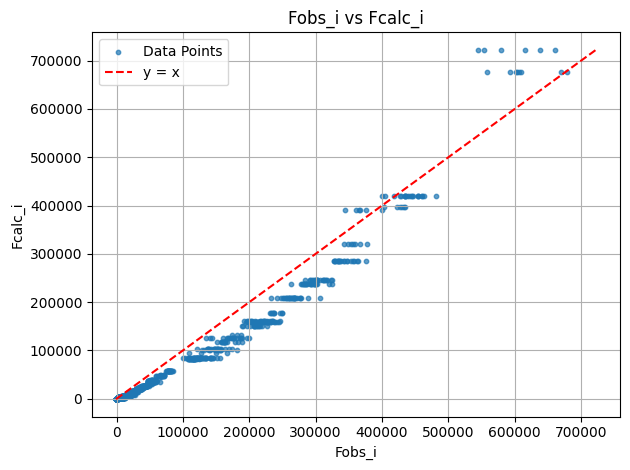

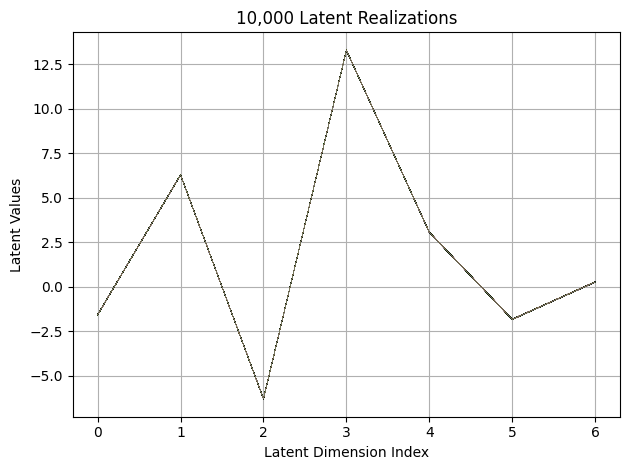

First 10 latent vectors from the VAE:
Sample 1: [-1.563268780708313, 6.292652606964111, -6.276865005493164, 13.29556941986084, 3.0604376792907715, -1.81038236618042, 0.2731562852859497]
Sample 2: [-1.5571078062057495, 6.2815632820129395, -6.29306697845459, 13.291749000549316, 3.058790683746338, -1.8240183591842651, 0.26940566301345825]
Sample 3: [-1.5521568059921265, 6.297627925872803, -6.288406848907471, 13.288576126098633, 3.0779144763946533, -1.8289618492126465, 0.27557748556137085]
Sample 4: [-1.5558404922485352, 6.296638488769531, -6.289259433746338, 13.294717788696289, 3.0637166500091553, -1.8202115297317505, 0.2723792791366577]
Sample 5: [-1.554315209388733, 6.288907051086426, -6.292644023895264, 13.303751945495605, 3.075194835662842, -1.8102777004241943, 0.2757738530635834]
Sample 6: [-1.5576916933059692, 6.29649543762207, -6.295666217803955, 13.295418739318848, 3.07450008392334, -1.827742576599121, 0.2756311297416687]
Sample 7: [-1.568240761756897, 6.295655727386475, -6.280554

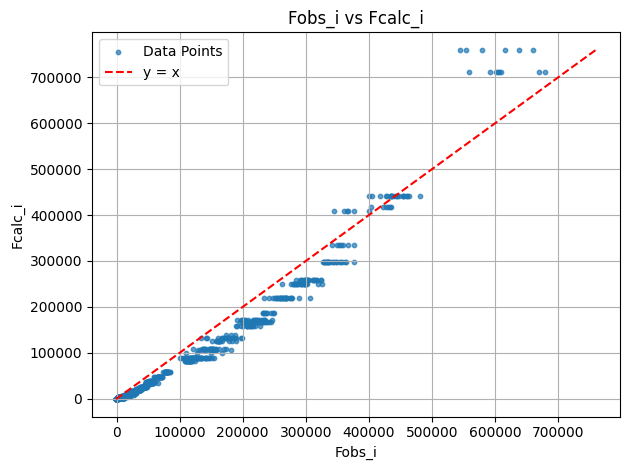

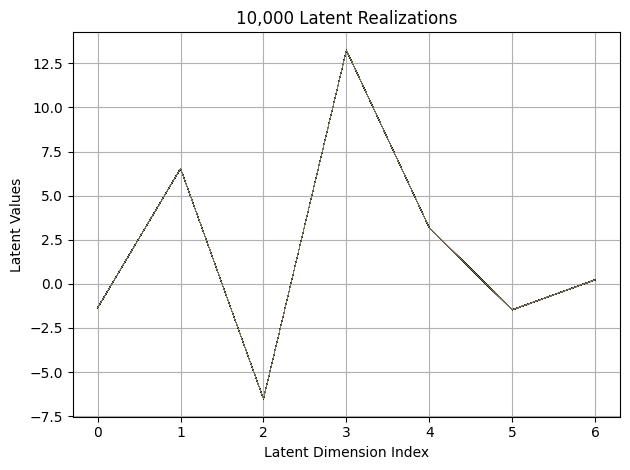

First 10 latent vectors from the VAE:
Sample 1: [-1.364179253578186, 6.542533874511719, -6.52748441696167, 13.241900444030762, 3.180325746536255, -1.4766873121261597, 0.2293640375137329]
Sample 2: [-1.363035798072815, 6.540241241455078, -6.537542343139648, 13.234711647033691, 3.171144723892212, -1.459385633468628, 0.22996585071086884]
Sample 3: [-1.3731787204742432, 6.545448303222656, -6.5102314949035645, 13.234464645385742, 3.1836063861846924, -1.4725297689437866, 0.22836937010288239]
Sample 4: [-1.360688328742981, 6.54473876953125, -6.5145158767700195, 13.249065399169922, 3.1667723655700684, -1.4731171131134033, 0.23066174983978271]
Sample 5: [-1.3585301637649536, 6.545085430145264, -6.530936241149902, 13.24285888671875, 3.186941146850586, -1.475399374961853, 0.22394798696041107]
Sample 6: [-1.3618775606155396, 6.539365291595459, -6.522058963775635, 13.250165939331055, 3.169137954711914, -1.4735177755355835, 0.22910845279693604]
Sample 7: [-1.3521250486373901, 6.5290913581848145, -6.

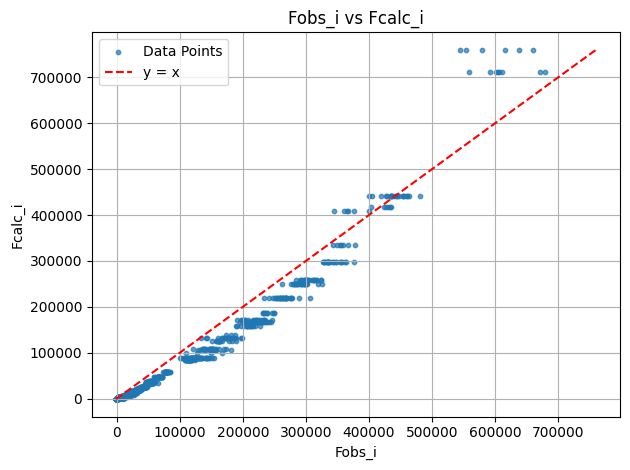

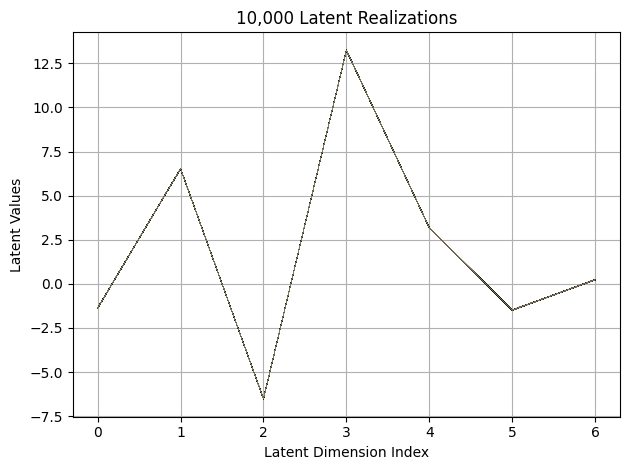

First 10 latent vectors from the VAE:
Sample 1: [-1.3825310468673706, 6.521905899047852, -6.504809379577637, 13.259952545166016, 3.170767068862915, -1.4947477579116821, 0.22404004633426666]
Sample 2: [-1.3790593147277832, 6.531930446624756, -6.502417087554932, 13.258255004882812, 3.180288076400757, -1.483190655708313, 0.23586022853851318]
Sample 3: [-1.377772331237793, 6.516589641571045, -6.519877910614014, 13.253436088562012, 3.1743087768554688, -1.4815599918365479, 0.22928228974342346]
Sample 4: [-1.3660675287246704, 6.5343427658081055, -6.518764495849609, 13.245671272277832, 3.1660284996032715, -1.4844359159469604, 0.23048456013202667]
Sample 5: [-1.3821802139282227, 6.5243682861328125, -6.500237464904785, 13.247636795043945, 3.179091215133667, -1.4875072240829468, 0.2226085066795349]
Sample 6: [-1.3797608613967896, 6.534864902496338, -6.513056755065918, 13.244064331054688, 3.1742613315582275, -1.4842588901519775, 0.22834673523902893]
Sample 7: [-1.3722654581069946, 6.5152587890625,

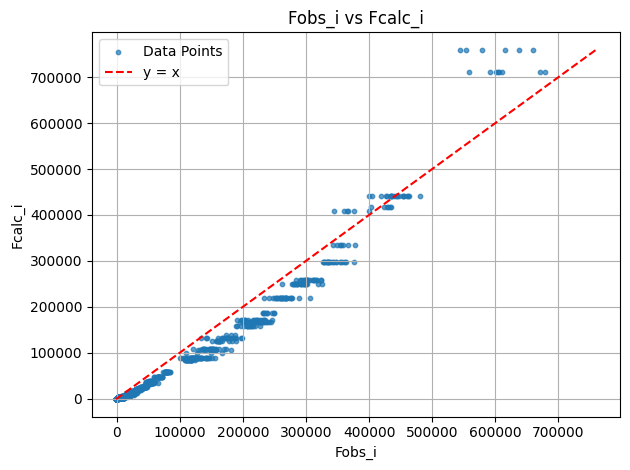

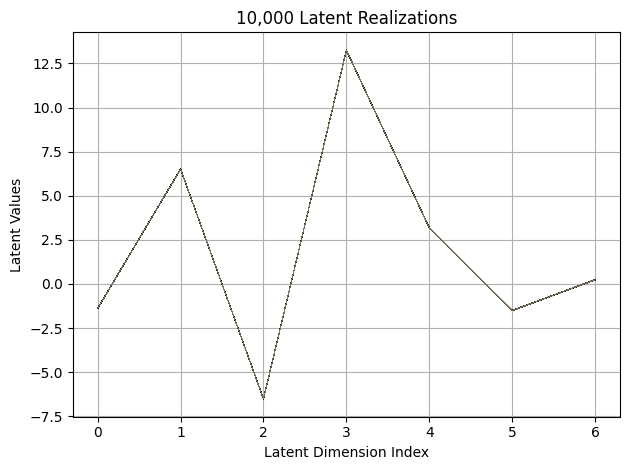

First 10 latent vectors from the VAE:
Sample 1: [-1.395562767982483, 6.512512683868408, -6.508352279663086, 13.242040634155273, 3.1742331981658936, -1.5032639503479004, 0.23882001638412476]
Sample 2: [-1.3923283815383911, 6.5204243659973145, -6.5205078125, 13.251940727233887, 3.168896436691284, -1.5160820484161377, 0.2451372742652893]
Sample 3: [-1.39934504032135, 6.503594398498535, -6.524335861206055, 13.250399589538574, 3.171541213989258, -1.5030186176300049, 0.23586145043373108]
Sample 4: [-1.3870528936386108, 6.515452861785889, -6.515574932098389, 13.264115333557129, 3.1742801666259766, -1.4979556798934937, 0.2338772714138031]
Sample 5: [-1.3954644203186035, 6.500048637390137, -6.507570743560791, 13.244617462158203, 3.1872730255126953, -1.5118741989135742, 0.23546743392944336]
Sample 6: [-1.4023468494415283, 6.50250244140625, -6.528166770935059, 13.249486923217773, 3.182744264602661, -1.5015367269515991, 0.22106605768203735]
Sample 7: [-1.39821457862854, 6.511211395263672, -6.51585

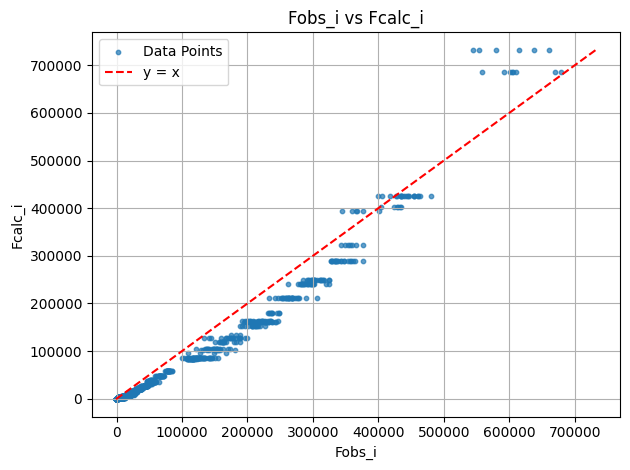

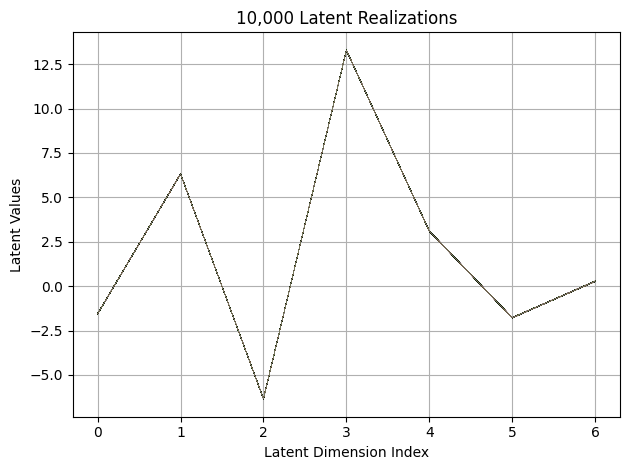

First 10 latent vectors from the VAE:
Sample 1: [-1.5562107563018799, 6.311000823974609, -6.346408367156982, 13.28953742980957, 3.100456953048706, -1.7680202722549438, 0.28217917680740356]
Sample 2: [-1.5619291067123413, 6.324100017547607, -6.3420491218566895, 13.282332420349121, 3.1197657585144043, -1.7795417308807373, 0.26739177107810974]
Sample 3: [-1.556274175643921, 6.307616233825684, -6.336833953857422, 13.289827346801758, 3.106492042541504, -1.7902253866195679, 0.270704060792923]
Sample 4: [-1.5489230155944824, 6.320553779602051, -6.346386909484863, 13.283513069152832, 3.1063191890716553, -1.7689017057418823, 0.266484797000885]
Sample 5: [-1.5603277683258057, 6.319745063781738, -6.3448357582092285, 13.272191047668457, 3.096970558166504, -1.7779372930526733, 0.2715362012386322]
Sample 6: [-1.5498886108398438, 6.313246726989746, -6.3277812004089355, 13.284480094909668, 3.088406562805176, -1.7901132106781006, 0.27781134843826294]
Sample 7: [-1.5560396909713745, 6.301943302154541, -

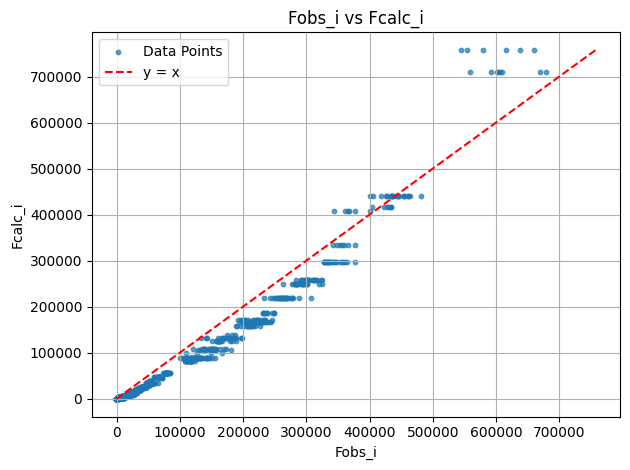

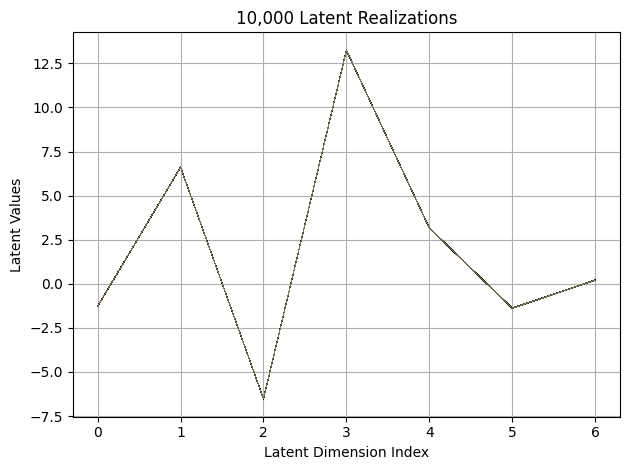

First 10 latent vectors from the VAE:
Sample 1: [-1.284366488456726, 6.6031389236450195, -6.5200371742248535, 13.242627143859863, 3.165379762649536, -1.394395351409912, 0.20009218156337738]
Sample 2: [-1.2748061418533325, 6.594849586486816, -6.528261184692383, 13.245136260986328, 3.1696295738220215, -1.3854390382766724, 0.20618554949760437]
Sample 3: [-1.2764782905578613, 6.595734596252441, -6.524759769439697, 13.247917175292969, 3.1730363368988037, -1.3743540048599243, 0.20906810462474823]
Sample 4: [-1.2815356254577637, 6.602818489074707, -6.515072345733643, 13.247389793395996, 3.173577070236206, -1.3844107389450073, 0.2084275186061859]
Sample 5: [-1.2680907249450684, 6.600357532501221, -6.526395320892334, 13.248997688293457, 3.1718645095825195, -1.3929811716079712, 0.21320901811122894]
Sample 6: [-1.2789559364318848, 6.5994086265563965, -6.5196943283081055, 13.234797477722168, 3.1700432300567627, -1.3795192241668701, 0.2084844708442688]
Sample 7: [-1.2675631046295166, 6.601845741271

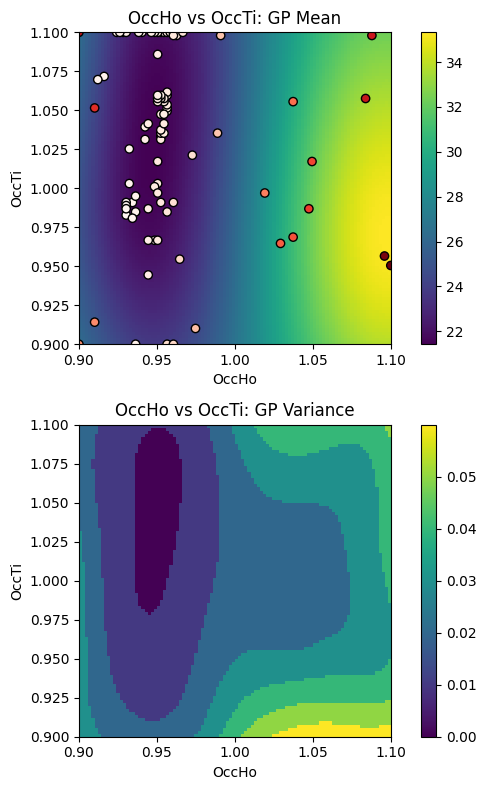

EI: [-1.00000000e+00  2.70673353e-03  2.72753183e-03 ...  4.77321446e-05
  5.66322706e-05  6.81692036e-05]
Function eval #90
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [1.0090909004211426, 0.9343433976173401]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7751
initial chi^2 1.6609e+05 with 2596 obs.
New scale: 0.7751
Cycle 0: 0.58s, Chi**2: 1.3183e+05 for 2596 obs., Lambda: 0,  Delta: 0.206, SVD=0
New scale: 0.7751
Maximum shift/esd = -51.199

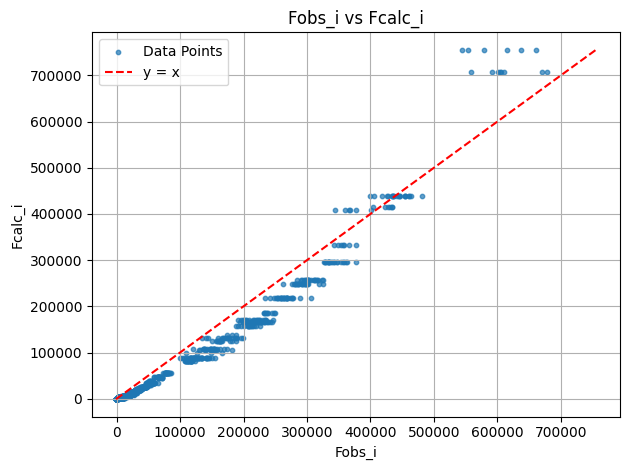

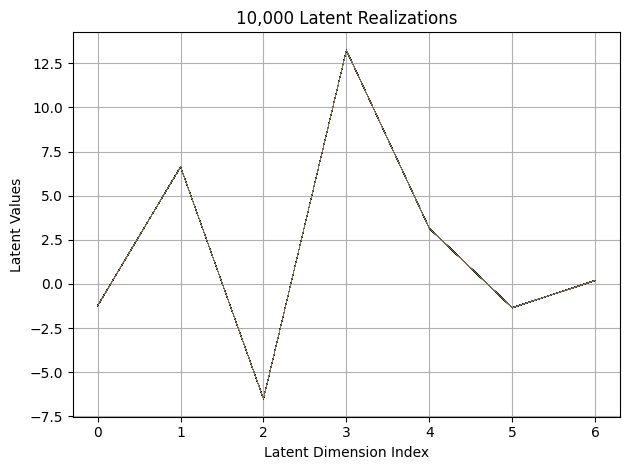

First 10 latent vectors from the VAE:
Sample 1: [-1.2385382652282715, 6.641933441162109, -6.50545072555542, 13.230742454528809, 3.1566929817199707, -1.3412927389144897, 0.17625275254249573]
Sample 2: [-1.239744782447815, 6.634275436401367, -6.5178680419921875, 13.241900444030762, 3.153935432434082, -1.3434303998947144, 0.19208401441574097]
Sample 3: [-1.2310775518417358, 6.637984752655029, -6.516458511352539, 13.244891166687012, 3.148836135864258, -1.361774206161499, 0.19702179729938507]
Sample 4: [-1.232108235359192, 6.6306233406066895, -6.516195774078369, 13.232056617736816, 3.1511404514312744, -1.3550130128860474, 0.20037037134170532]
Sample 5: [-1.2438966035842896, 6.638646602630615, -6.507815837860107, 13.228233337402344, 3.144181728363037, -1.3385417461395264, 0.19789615273475647]
Sample 6: [-1.2286059856414795, 6.642378807067871, -6.498080253601074, 13.240825653076172, 3.15185809135437, -1.356400966644287, 0.18433979153633118]
Sample 7: [-1.2454670667648315, 6.639538288116455, -

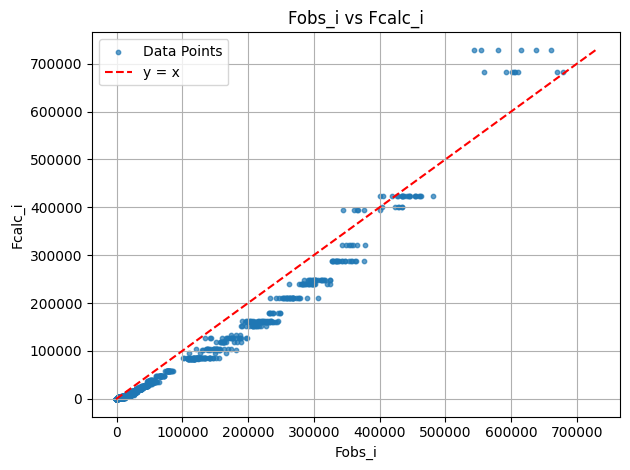

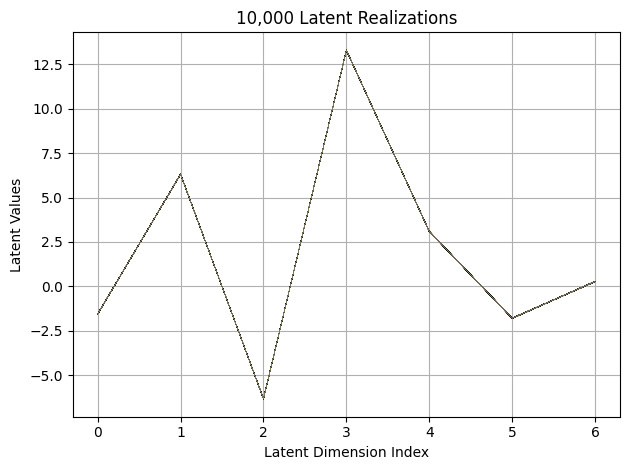

First 10 latent vectors from the VAE:
Sample 1: [-1.556552529335022, 6.306880950927734, -6.320038795471191, 13.291970252990723, 3.0958871841430664, -1.7948968410491943, 0.27278998494148254]
Sample 2: [-1.5649473667144775, 6.307860851287842, -6.314123153686523, 13.282763481140137, 3.0922470092773438, -1.793594241142273, 0.2863024175167084]
Sample 3: [-1.5667989253997803, 6.311664581298828, -6.322097301483154, 13.2947416305542, 3.085361957550049, -1.789665937423706, 0.2827524244785309]
Sample 4: [-1.5620055198669434, 6.312713146209717, -6.322482585906982, 13.289531707763672, 3.0836217403411865, -1.7934716939926147, 0.26352861523628235]
Sample 5: [-1.5521020889282227, 6.31525993347168, -6.317680835723877, 13.292987823486328, 3.099087953567505, -1.7922419309616089, 0.2625146508216858]
Sample 6: [-1.560099482536316, 6.309076309204102, -6.327073574066162, 13.28479290008545, 3.088111162185669, -1.7935384511947632, 0.2756536602973938]
Sample 7: [-1.5476069450378418, 6.302294731140137, -6.31741

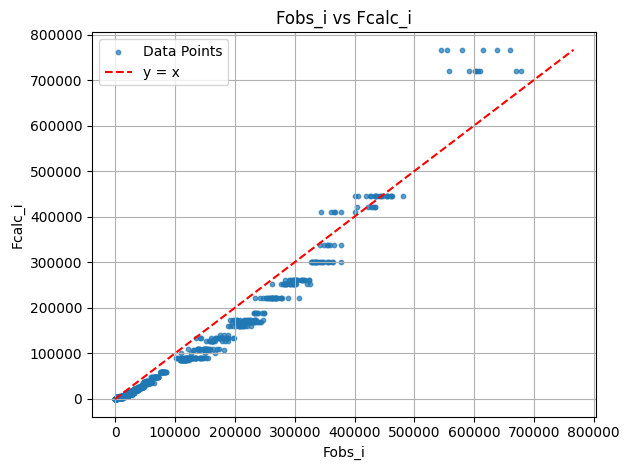

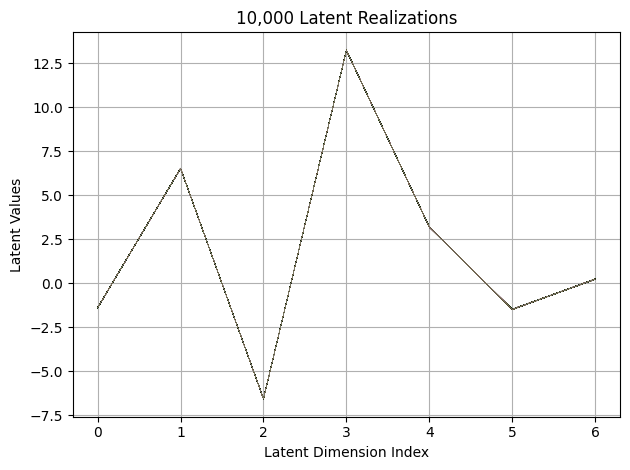

First 10 latent vectors from the VAE:
Sample 1: [-1.3835080862045288, 6.514930725097656, -6.556017875671387, 13.235189437866211, 3.1923718452453613, -1.4829862117767334, 0.23211461305618286]
Sample 2: [-1.390560507774353, 6.532044410705566, -6.554408073425293, 13.230623245239258, 3.1915664672851562, -1.488500714302063, 0.23745113611221313]
Sample 3: [-1.379157543182373, 6.5243682861328125, -6.5489678382873535, 13.229336738586426, 3.198852300643921, -1.4734883308410645, 0.2352222502231598]
Sample 4: [-1.3822433948516846, 6.531533718109131, -6.547439098358154, 13.237298011779785, 3.2037765979766846, -1.4769749641418457, 0.2326560616493225]
Sample 5: [-1.387260913848877, 6.530028343200684, -6.550126552581787, 13.23241138458252, 3.1922881603240967, -1.482557773590088, 0.23137986660003662]
Sample 6: [-1.3792188167572021, 6.5298380851745605, -6.551479339599609, 13.239957809448242, 3.198026418685913, -1.4745184183120728, 0.2306867092847824]
Sample 7: [-1.385701298713684, 6.537841796875, -6.56

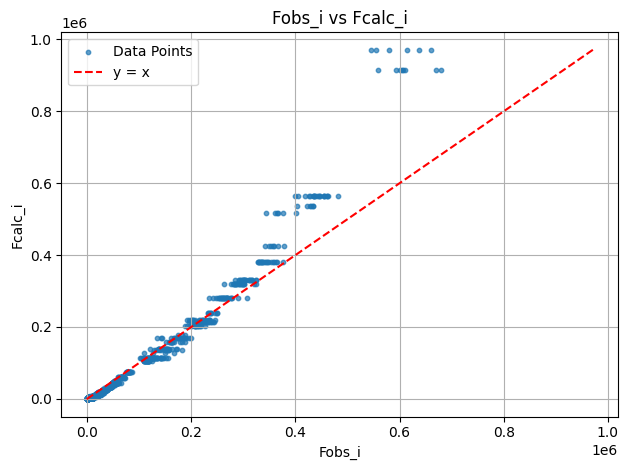

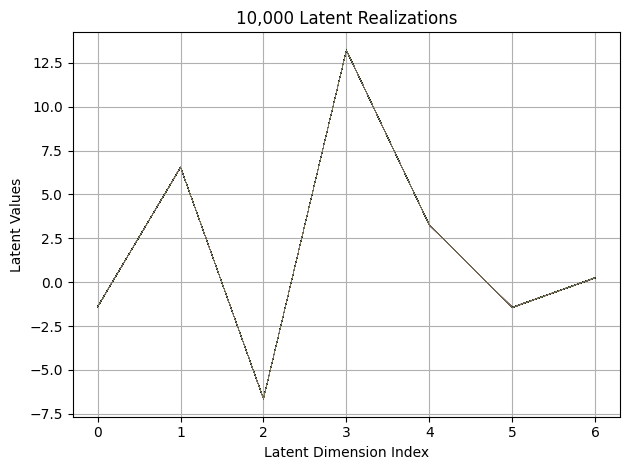

First 10 latent vectors from the VAE:
Sample 1: [-1.408228874206543, 6.536374568939209, -6.644852638244629, 13.224732398986816, 3.268984794616699, -1.4443421363830566, 0.256061315536499]
Sample 2: [-1.4037505388259888, 6.558662414550781, -6.647846221923828, 13.21967601776123, 3.2614259719848633, -1.4486849308013916, 0.24514399468898773]
Sample 3: [-1.4083008766174316, 6.558743476867676, -6.6495490074157715, 13.226763725280762, 3.2706198692321777, -1.4417991638183594, 0.24501071870326996]
Sample 4: [-1.398215651512146, 6.538980007171631, -6.645959377288818, 13.23390007019043, 3.2619335651397705, -1.4508256912231445, 0.2449357807636261]
Sample 5: [-1.4055286645889282, 6.5578742027282715, -6.659728527069092, 13.235875129699707, 3.2587764263153076, -1.442354440689087, 0.24674829840660095]
Sample 6: [-1.409708023071289, 6.552683353424072, -6.656332015991211, 13.227782249450684, 3.2569499015808105, -1.4422358274459839, 0.247826486825943]
Sample 7: [-1.408137321472168, 6.548563003540039, -6.6

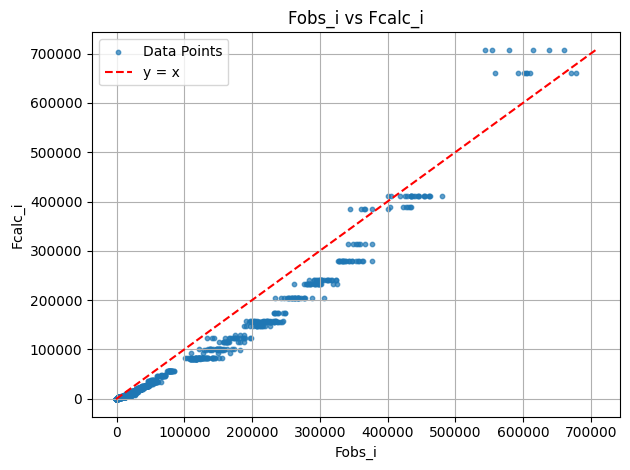

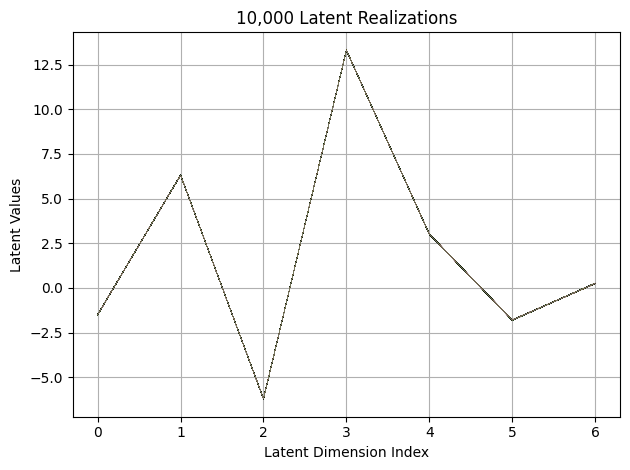

First 10 latent vectors from the VAE:
Sample 1: [-1.5043315887451172, 6.310375690460205, -6.2146897315979, 13.31456184387207, 3.0005242824554443, -1.801731824874878, 0.25413650274276733]
Sample 2: [-1.5035945177078247, 6.312845230102539, -6.208296775817871, 13.312108993530273, 3.017069101333618, -1.8036251068115234, 0.24682646989822388]
Sample 3: [-1.5040178298950195, 6.317967891693115, -6.215456962585449, 13.29216480255127, 3.0147650241851807, -1.8158549070358276, 0.2617584466934204]
Sample 4: [-1.4848504066467285, 6.325837135314941, -6.216269016265869, 13.308874130249023, 3.0071539878845215, -1.8003331422805786, 0.2421373724937439]
Sample 5: [-1.5014779567718506, 6.3153252601623535, -6.208693981170654, 13.301506042480469, 3.0133724212646484, -1.792880654335022, 0.25637975335121155]
Sample 6: [-1.4945662021636963, 6.321305751800537, -6.209432125091553, 13.297447204589844, 3.0215511322021484, -1.8163748979568481, 0.25433191657066345]
Sample 7: [-1.4955779314041138, 6.319844722747803, -

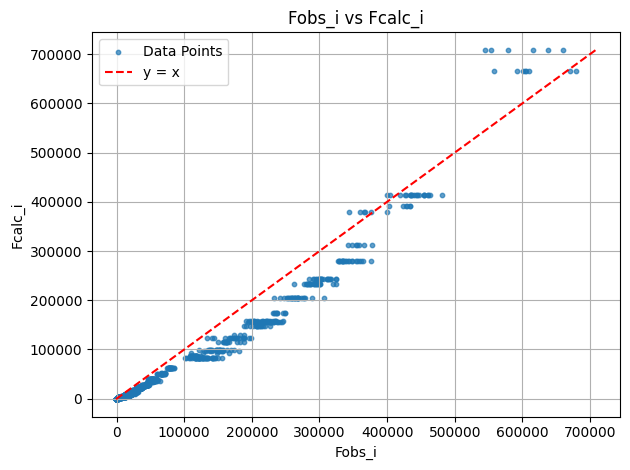

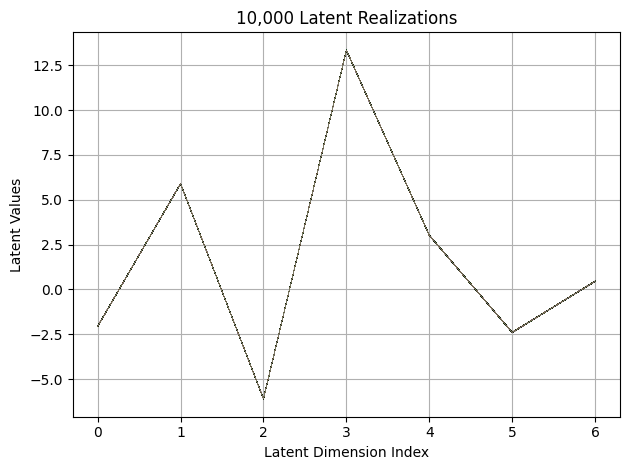

First 10 latent vectors from the VAE:
Sample 1: [-2.0666046142578125, 5.885862350463867, -6.109117031097412, 13.346353530883789, 3.0168938636779785, -2.3900039196014404, 0.4517047703266144]
Sample 2: [-2.0616610050201416, 5.905709266662598, -6.089615821838379, 13.342458724975586, 3.0099668502807617, -2.401782512664795, 0.44566792249679565]
Sample 3: [-2.066411256790161, 5.891782760620117, -6.104873180389404, 13.337362289428711, 3.0202789306640625, -2.4045448303222656, 0.4543754756450653]
Sample 4: [-2.063992977142334, 5.905084609985352, -6.102296352386475, 13.330697059631348, 3.025359630584717, -2.3975536823272705, 0.4658147692680359]
Sample 5: [-2.0767977237701416, 5.890303134918213, -6.1105780601501465, 13.334517478942871, 3.02213454246521, -2.3936476707458496, 0.45244547724723816]
Sample 6: [-2.0666141510009766, 5.884012222290039, -6.0961408615112305, 13.337749481201172, 3.0084071159362793, -2.392714262008667, 0.4586842656135559]
Sample 7: [-2.059558868408203, 5.895693302154541, -6.

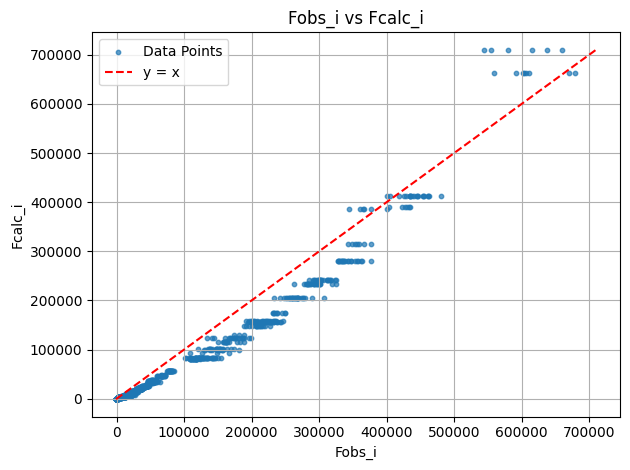

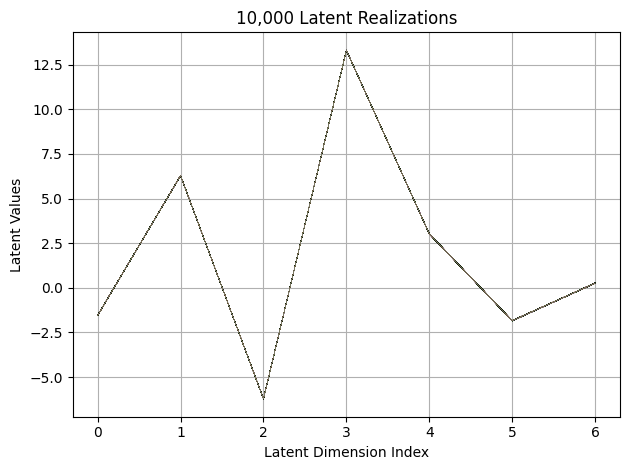

First 10 latent vectors from the VAE:
Sample 1: [-1.5401393175125122, 6.288140773773193, -6.2139573097229, 13.309035301208496, 3.028855085372925, -1.8308720588684082, 0.26352113485336304]
Sample 2: [-1.536608338356018, 6.281249046325684, -6.22822904586792, 13.309521675109863, 3.0259740352630615, -1.8440507650375366, 0.2641873061656952]
Sample 3: [-1.546142816543579, 6.28852653503418, -6.219107627868652, 13.302952766418457, 3.0214884281158447, -1.8438847064971924, 0.2657059133052826]
Sample 4: [-1.536535620689392, 6.290888786315918, -6.204272270202637, 13.312969207763672, 3.0211172103881836, -1.8375632762908936, 0.2673931121826172]
Sample 5: [-1.5380680561065674, 6.285953044891357, -6.221353530883789, 13.321246147155762, 2.998201608657837, -1.8410674333572388, 0.27130040526390076]
Sample 6: [-1.552109956741333, 6.290469169616699, -6.226469993591309, 13.305439949035645, 3.033862352371216, -1.8249261379241943, 0.25893324613571167]
Sample 7: [-1.5468289852142334, 6.280956745147705, -6.2177

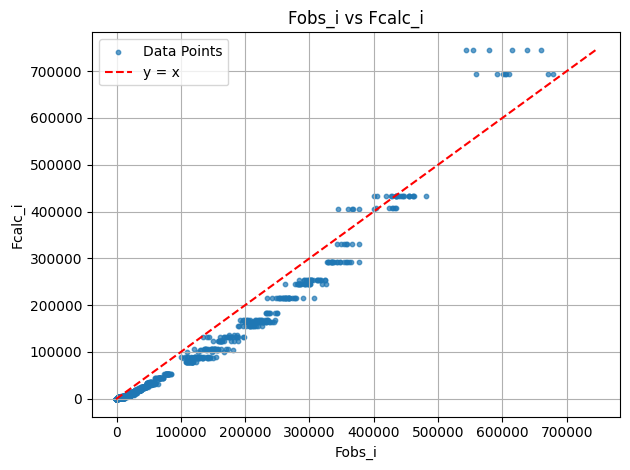

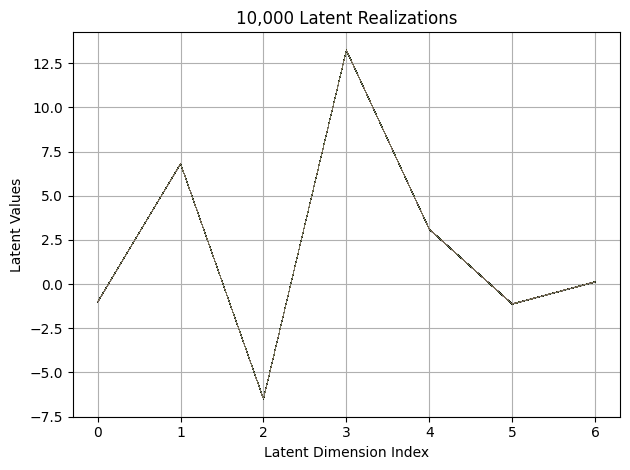

First 10 latent vectors from the VAE:
Sample 1: [-1.0004223585128784, 6.812863349914551, -6.497328758239746, 13.232863426208496, 3.1152946949005127, -1.132523536682129, 0.12821531295776367]
Sample 2: [-1.0248517990112305, 6.811078071594238, -6.506967544555664, 13.235648155212402, 3.101029396057129, -1.1173264980316162, 0.12228696793317795]
Sample 3: [-1.007080078125, 6.817168712615967, -6.494832992553711, 13.23742961883545, 3.1036250591278076, -1.1328372955322266, 0.12576605379581451]
Sample 4: [-1.0154227018356323, 6.811415195465088, -6.494894504547119, 13.233366012573242, 3.100867748260498, -1.1255850791931152, 0.12006422132253647]
Sample 5: [-1.014704942703247, 6.815319061279297, -6.489774227142334, 13.24777603149414, 3.1051688194274902, -1.1214152574539185, 0.12388848513364792]
Sample 6: [-1.0135436058044434, 6.8008222579956055, -6.487443923950195, 13.239346504211426, 3.1074414253234863, -1.1317838430404663, 0.13443420827388763]
Sample 7: [-1.0163432359695435, 6.813287734985352, -6

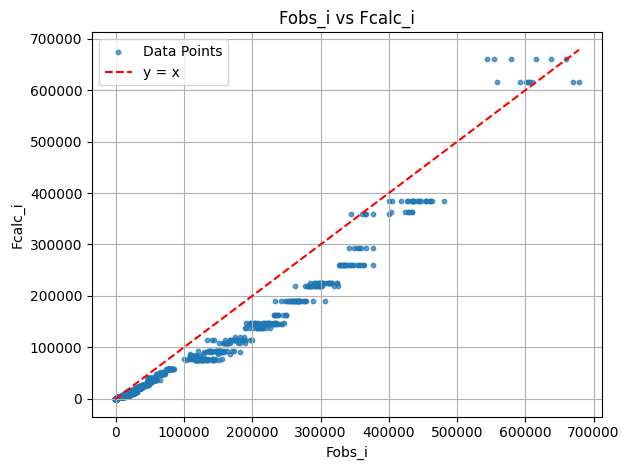

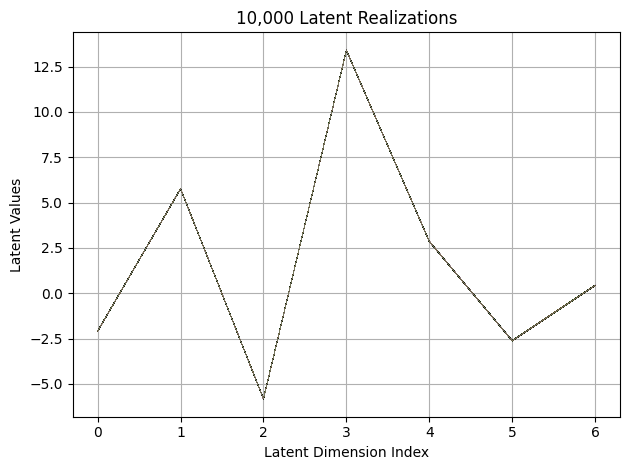

First 10 latent vectors from the VAE:
Sample 1: [-2.0805866718292236, 5.76069974899292, -5.823196887969971, 13.377973556518555, 2.867323875427246, -2.6194162368774414, 0.43306422233581543]
Sample 2: [-2.085297107696533, 5.770419120788574, -5.81358003616333, 13.393904685974121, 2.8512845039367676, -2.608553647994995, 0.4331267774105072]
Sample 3: [-2.0952343940734863, 5.759696960449219, -5.827576637268066, 13.39992618560791, 2.8623363971710205, -2.623533010482788, 0.4399142861366272]
Sample 4: [-2.0946767330169678, 5.755058288574219, -5.812925338745117, 13.40356731414795, 2.844029664993286, -2.6226229667663574, 0.44585204124450684]
Sample 5: [-2.08194637298584, 5.760928630828857, -5.816854953765869, 13.397014617919922, 2.854754686355591, -2.619163990020752, 0.4357373118400574]
Sample 6: [-2.087817668914795, 5.765315532684326, -5.8183088302612305, 13.399434089660645, 2.8602135181427, -2.6184256076812744, 0.4330211281776428]
Sample 7: [-2.079864740371704, 5.748443126678467, -5.81626605987

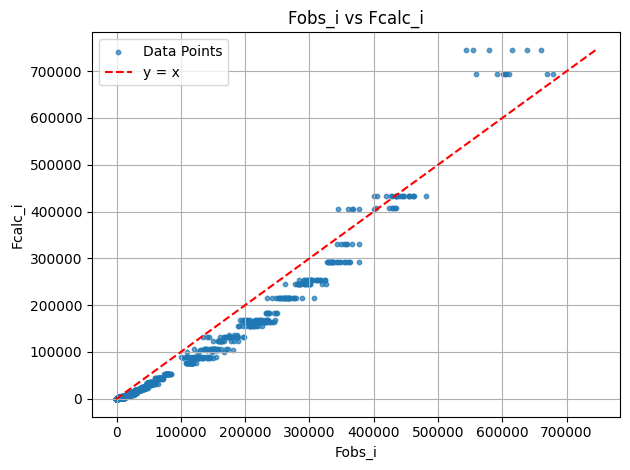

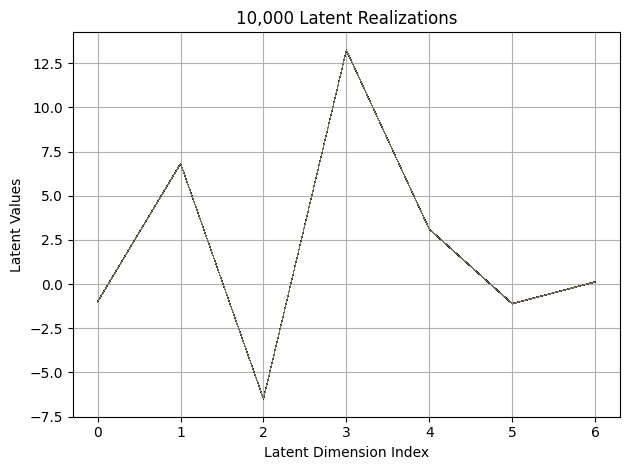

First 10 latent vectors from the VAE:
Sample 1: [-1.0026464462280273, 6.8277788162231445, -6.480321407318115, 13.228790283203125, 3.1072499752044678, -1.1188713312149048, 0.1321660280227661]
Sample 2: [-0.9936131238937378, 6.826026439666748, -6.490633487701416, 13.238179206848145, 3.112133741378784, -1.1103070974349976, 0.11490687727928162]
Sample 3: [-0.9969158172607422, 6.828486442565918, -6.498871803283691, 13.219099998474121, 3.10233211517334, -1.1049139499664307, 0.12786202132701874]
Sample 4: [-0.9882179498672485, 6.816957950592041, -6.493877410888672, 13.23536491394043, 3.1109907627105713, -1.116295337677002, 0.10742687433958054]
Sample 5: [-1.0108108520507812, 6.830441474914551, -6.488175868988037, 13.22152042388916, 3.1035983562469482, -1.1139330863952637, 0.12244046479463577]
Sample 6: [-0.9923562407493591, 6.810663223266602, -6.501546382904053, 13.238407135009766, 3.107449769973755, -1.1161741018295288, 0.12631551921367645]
Sample 7: [-0.9860723614692688, 6.826372146606445, 

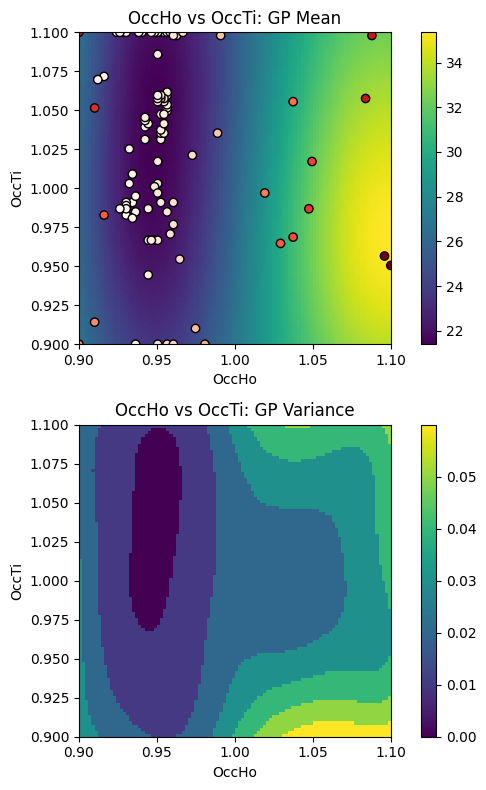

EI: [-1.00000000e+00  1.76773872e-03  1.79732684e-03 ...  4.75717825e-05
  5.70633565e-05  6.94871414e-05]
Function eval #100
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [1.0414141416549683, 0.9424242377281189]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7585
initial chi^2 1.898e+05 with 2596 obs.
New scale: 0.7585
Cycle 0: 0.60s, Chi**2: 1.4705e+05 for 2596 obs., Lambda: 0,  Delta: 0.225, SVD=0
New scale: 0.7585
Maximum shift/esd = -54.115

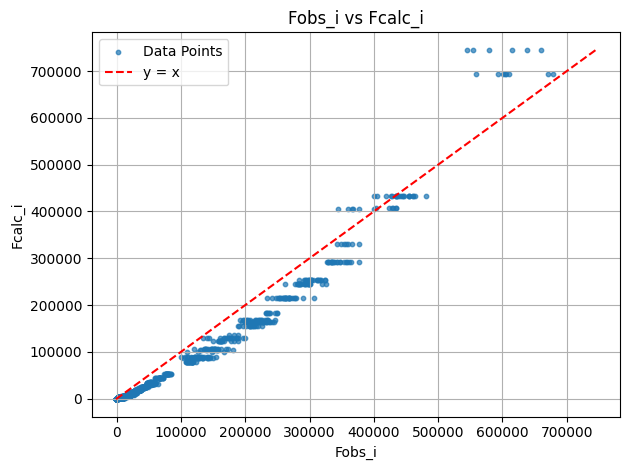

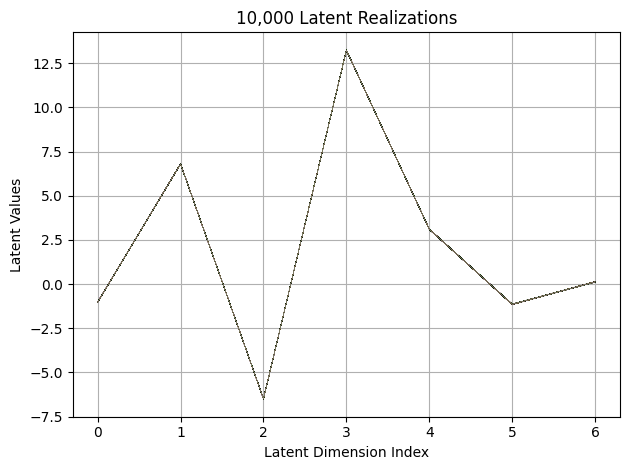

First 10 latent vectors from the VAE:
Sample 1: [-1.0322517156600952, 6.8017497062683105, -6.489251136779785, 13.233980178833008, 3.108710765838623, -1.1482540369033813, 0.13356156647205353]
Sample 2: [-1.0287872552871704, 6.8137383460998535, -6.4955925941467285, 13.232012748718262, 3.0927016735076904, -1.141819953918457, 0.12163394689559937]
Sample 3: [-1.0186758041381836, 6.805814266204834, -6.488949298858643, 13.226951599121094, 3.096952199935913, -1.1478756666183472, 0.1337859332561493]
Sample 4: [-1.01682448387146, 6.800948143005371, -6.487229347229004, 13.231989860534668, 3.1030311584472656, -1.139147162437439, 0.10931400209665298]
Sample 5: [-1.030035376548767, 6.816810607910156, -6.4766340255737305, 13.239349365234375, 3.120635509490967, -1.1476092338562012, 0.11509908735752106]
Sample 6: [-1.020485520362854, 6.798001289367676, -6.489400863647461, 13.235686302185059, 3.1092538833618164, -1.1362168788909912, 0.12954911589622498]
Sample 7: [-1.0218071937561035, 6.798657417297363,

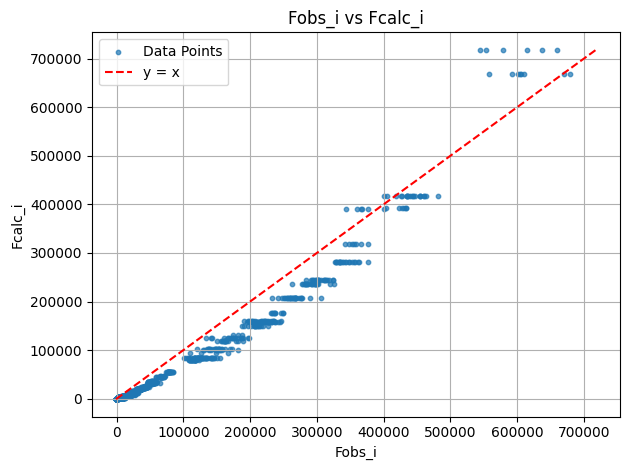

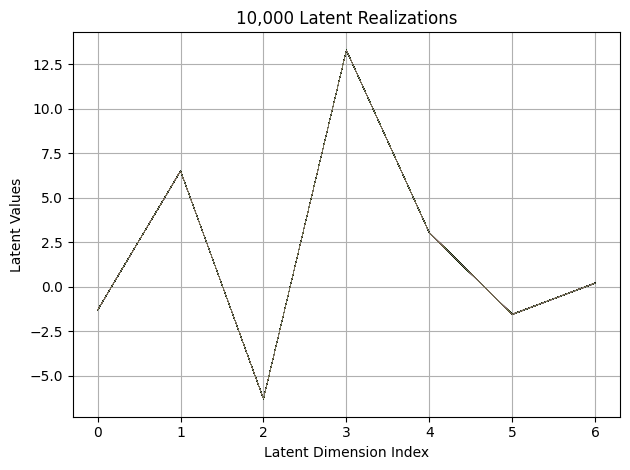

First 10 latent vectors from the VAE:
Sample 1: [-1.3127456903457642, 6.4958343505859375, -6.305675029754639, 13.2882719039917, 3.0232744216918945, -1.5502710342407227, 0.2183113694190979]
Sample 2: [-1.3105453252792358, 6.505108833312988, -6.294351100921631, 13.277514457702637, 3.032421588897705, -1.5411027669906616, 0.20609569549560547]
Sample 3: [-1.3121731281280518, 6.499462127685547, -6.2938761711120605, 13.272955894470215, 3.0354344844818115, -1.5655897855758667, 0.19735829532146454]
Sample 4: [-1.3059489727020264, 6.5005903244018555, -6.290064811706543, 13.288095474243164, 3.034536123275757, -1.5447241067886353, 0.20022711157798767]
Sample 5: [-1.3164536952972412, 6.502530097961426, -6.281504154205322, 13.287550926208496, 3.0250473022460938, -1.5403919219970703, 0.19510063529014587]
Sample 6: [-1.3065505027770996, 6.495917797088623, -6.299612522125244, 13.283409118652344, 3.0345053672790527, -1.550964593887329, 0.19728820025920868]
Sample 7: [-1.299350619316101, 6.49804401397705

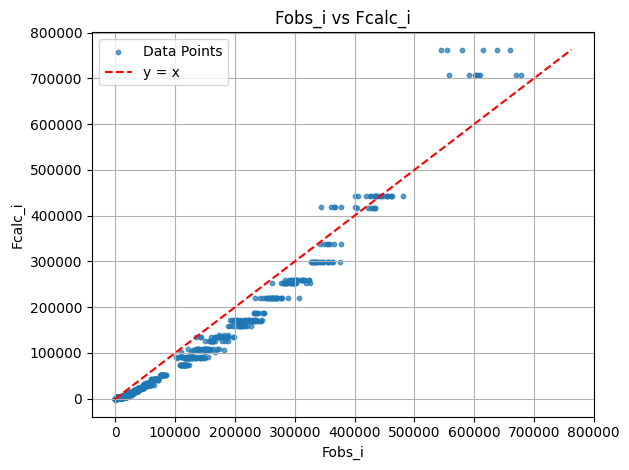

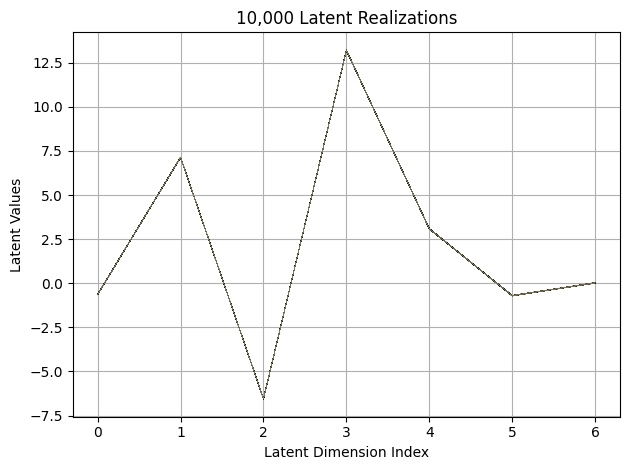

First 10 latent vectors from the VAE:
Sample 1: [-0.637199342250824, 7.147815227508545, -6.55365514755249, 13.202617645263672, 3.0844194889068604, -0.6966199278831482, 0.024558305740356445]
Sample 2: [-0.6408230662345886, 7.132342338562012, -6.559456825256348, 13.207568168640137, 3.0899999141693115, -0.7084686160087585, 0.01388370431959629]
Sample 3: [-0.6292764544487, 7.1345906257629395, -6.539294242858887, 13.208149909973145, 3.0778794288635254, -0.7113851308822632, 0.020787633955478668]
Sample 4: [-0.643806517124176, 7.135093688964844, -6.546218395233154, 13.214007377624512, 3.0790255069732666, -0.7056358456611633, 0.020753199234604836]
Sample 5: [-0.6483073830604553, 7.140347957611084, -6.552183151245117, 13.205374717712402, 3.08740496635437, -0.7143810987472534, 0.018495194613933563]
Sample 6: [-0.6333110332489014, 7.119266986846924, -6.552323341369629, 13.208144187927246, 3.0890111923217773, -0.7006483674049377, 0.022650744765996933]
Sample 7: [-0.6345396041870117, 7.140339374542

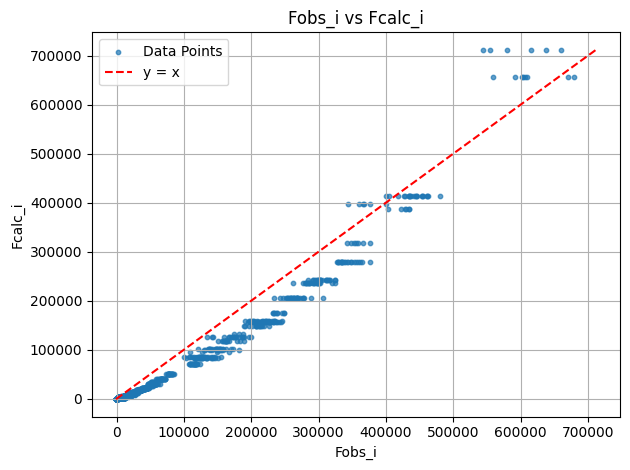

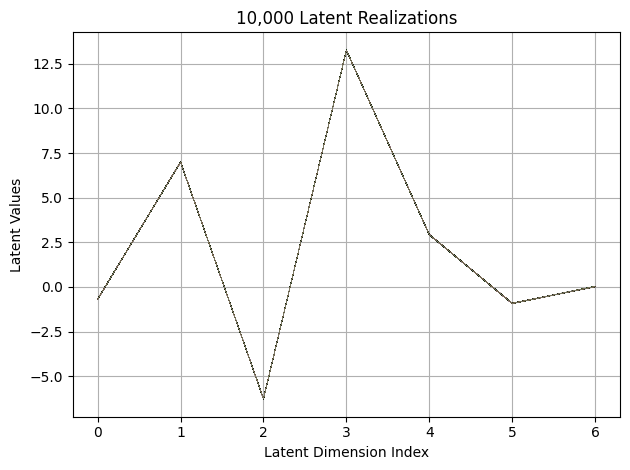

First 10 latent vectors from the VAE:
Sample 1: [-0.6913305521011353, 6.994180679321289, -6.261549472808838, 13.254182815551758, 2.9382307529449463, -0.9183390736579895, 0.009549343027174473]
Sample 2: [-0.6806981563568115, 6.985150337219238, -6.257092475891113, 13.263457298278809, 2.920884847640991, -0.9146816730499268, 0.027654407545924187]
Sample 3: [-0.6973593235015869, 6.997135639190674, -6.260030746459961, 13.272082328796387, 2.9166784286499023, -0.9244803190231323, 0.015107311308383942]
Sample 4: [-0.6937678456306458, 7.00104284286499, -6.259522438049316, 13.27363109588623, 2.924577236175537, -0.9210900068283081, 0.03406818211078644]
Sample 5: [-0.6871585249900818, 6.997009754180908, -6.26648473739624, 13.261670112609863, 2.9290988445281982, -0.9181421399116516, 0.027506651356816292]
Sample 6: [-0.6927676796913147, 6.992127895355225, -6.257627010345459, 13.264724731445312, 2.9228594303131104, -0.9258887767791748, 0.015641136094927788]
Sample 7: [-0.678149938583374, 6.99475383758

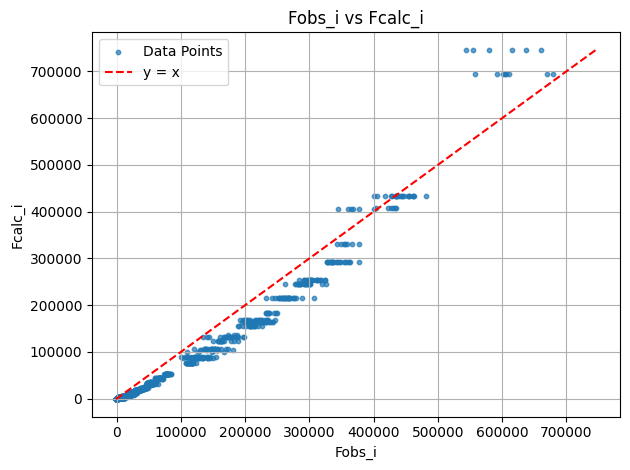

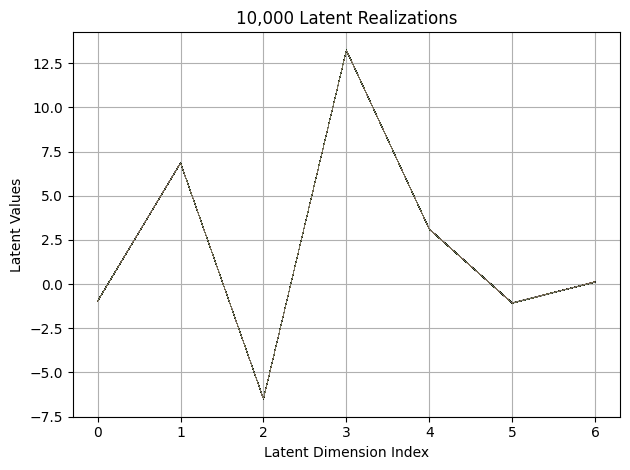

First 10 latent vectors from the VAE:
Sample 1: [-0.9622366428375244, 6.850000381469727, -6.5059380531311035, 13.229783058166504, 3.1086204051971436, -1.0760759115219116, 0.11928828805685043]
Sample 2: [-0.9776703119277954, 6.84838342666626, -6.5077009201049805, 13.23818588256836, 3.105693817138672, -1.0775431394577026, 0.12311135977506638]
Sample 3: [-0.9726966619491577, 6.85251522064209, -6.507842063903809, 13.23034381866455, 3.0921645164489746, -1.077104091644287, 0.12229596823453903]
Sample 4: [-0.9648798108100891, 6.86270809173584, -6.5000128746032715, 13.230663299560547, 3.1178128719329834, -1.093247890472412, 0.11368978023529053]
Sample 5: [-0.9624927639961243, 6.848502159118652, -6.507898330688477, 13.227593421936035, 3.105341672897339, -1.070165991783142, 0.1300879865884781]
Sample 6: [-0.9766490459442139, 6.8480916023254395, -6.510873794555664, 13.229586601257324, 3.1089842319488525, -1.0738582611083984, 0.11423986405134201]
Sample 7: [-0.9684745073318481, 6.857510566711426, 

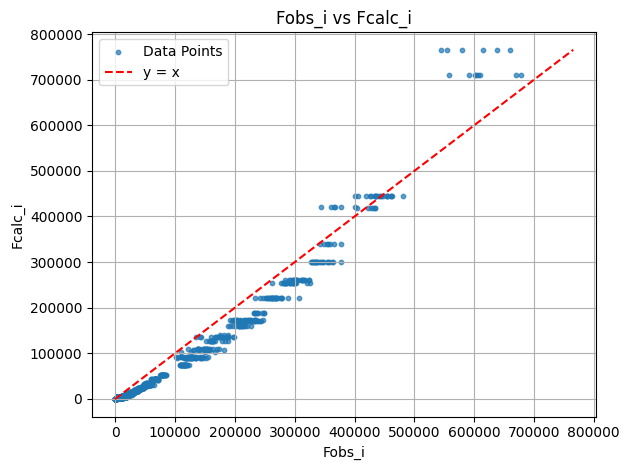

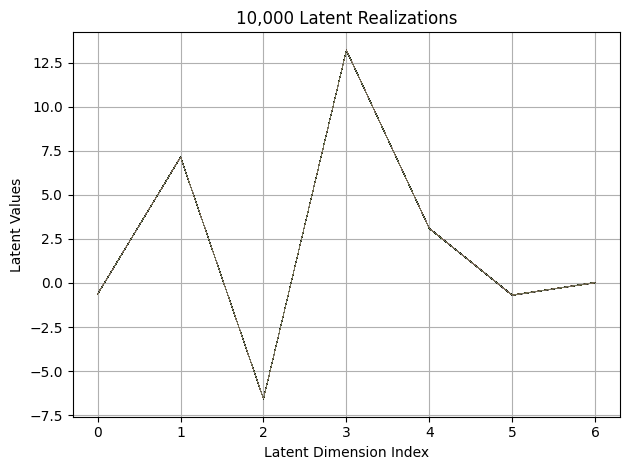

First 10 latent vectors from the VAE:
Sample 1: [-0.6309717297554016, 7.139074325561523, -6.565163612365723, 13.20267391204834, 3.0923545360565186, -0.6851627230644226, 0.004133053123950958]
Sample 2: [-0.6327170729637146, 7.147590160369873, -6.566009044647217, 13.203798294067383, 3.098330020904541, -0.699901282787323, 0.011649024672806263]
Sample 3: [-0.6348844766616821, 7.153921604156494, -6.564822196960449, 13.208793640136719, 3.1003060340881348, -0.6976099610328674, 0.024364445358514786]
Sample 4: [-0.6384041905403137, 7.141975402832031, -6.564281940460205, 13.201009750366211, 3.0949060916900635, -0.6892549395561218, 0.018027950078248978]
Sample 5: [-0.6309316158294678, 7.157064437866211, -6.581309795379639, 13.210004806518555, 3.098634958267212, -0.6871426701545715, 0.008222945034503937]
Sample 6: [-0.6373580098152161, 7.143317222595215, -6.585805892944336, 13.207653045654297, 3.0905685424804688, -0.680345892906189, 0.014287391677498817]
Sample 7: [-0.6216192245483398, 7.150083541

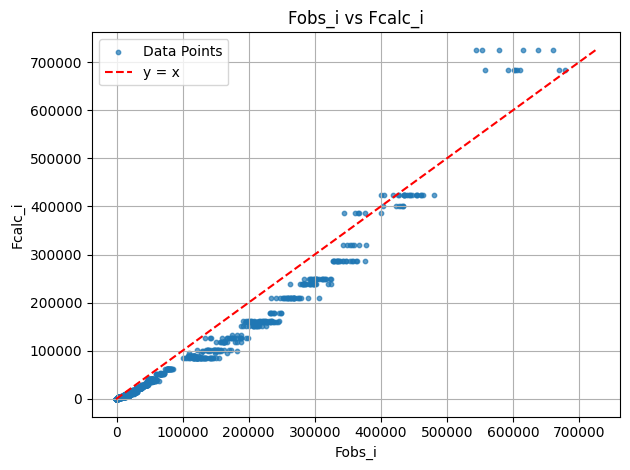

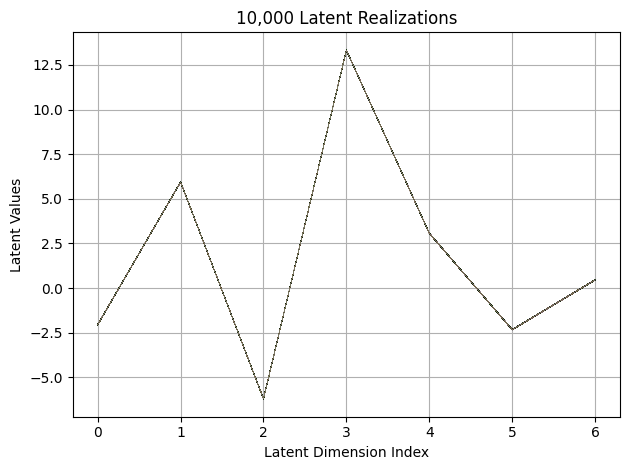

First 10 latent vectors from the VAE:
Sample 1: [-2.048250198364258, 5.9414448738098145, -6.206987380981445, 13.32284927368164, 3.0595571994781494, -2.33329176902771, 0.45383697748184204]
Sample 2: [-2.0656585693359375, 5.9364142417907715, -6.200475692749023, 13.318867683410645, 3.0715761184692383, -2.3245198726654053, 0.4510793387889862]
Sample 3: [-2.0547008514404297, 5.947608947753906, -6.194108009338379, 13.322881698608398, 3.0657544136047363, -2.332193374633789, 0.4467819035053253]
Sample 4: [-2.0528786182403564, 5.958253860473633, -6.185723781585693, 13.324542999267578, 3.074341297149658, -2.3299832344055176, 0.4502447545528412]
Sample 5: [-2.0535926818847656, 5.9450578689575195, -6.19658088684082, 13.310958862304688, 3.078179359436035, -2.330880641937256, 0.4469996690750122]
Sample 6: [-2.05757737159729, 5.9494757652282715, -6.204497814178467, 13.328577041625977, 3.066513776779175, -2.3337669372558594, 0.4542462229728699]
Sample 7: [-2.059246778488159, 5.9393792152404785, -6.201

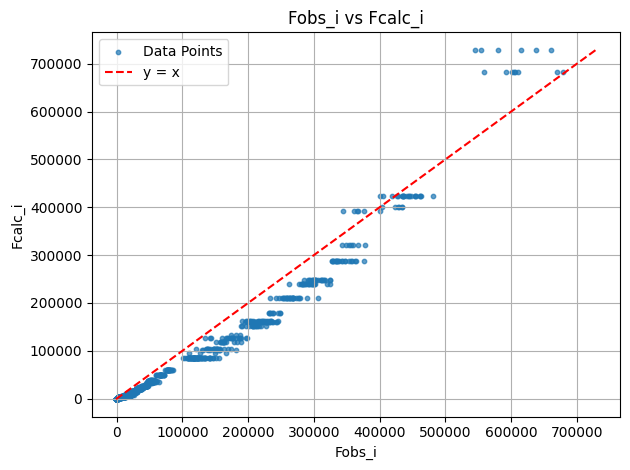

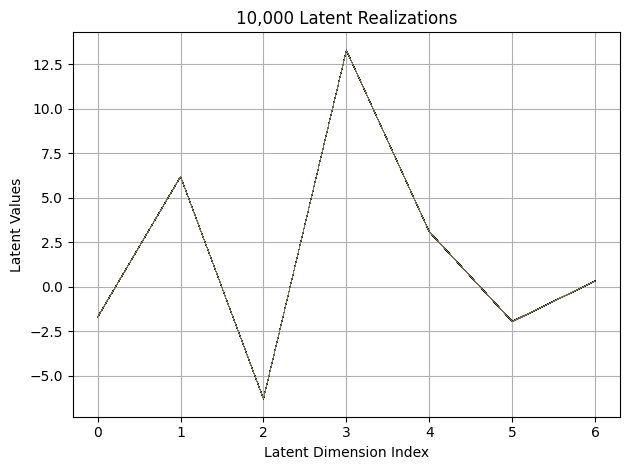

First 10 latent vectors from the VAE:
Sample 1: [-1.6982007026672363, 6.200534820556641, -6.3039703369140625, 13.292197227478027, 3.088416576385498, -1.9588525295257568, 0.32891640067100525]
Sample 2: [-1.7074964046478271, 6.194258689880371, -6.305100440979004, 13.304776191711426, 3.0969150066375732, -1.9489221572875977, 0.3346244692802429]
Sample 3: [-1.6958842277526855, 6.191643238067627, -6.293924331665039, 13.284825325012207, 3.102102518081665, -1.9520398378372192, 0.32103025913238525]
Sample 4: [-1.712041974067688, 6.201371669769287, -6.285346508026123, 13.292424201965332, 3.084167957305908, -1.9476326704025269, 0.3342021107673645]
Sample 5: [-1.69724440574646, 6.207191467285156, -6.293458938598633, 13.296340942382812, 3.092254400253296, -1.9533342123031616, 0.3305232524871826]
Sample 6: [-1.710572600364685, 6.204131126403809, -6.2996039390563965, 13.29356575012207, 3.0932605266571045, -1.9474443197250366, 0.31547418236732483]
Sample 7: [-1.6987520456314087, 6.188817024230957, -6.

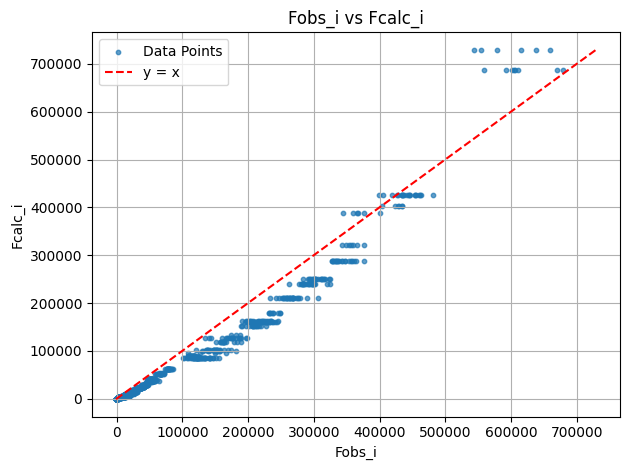

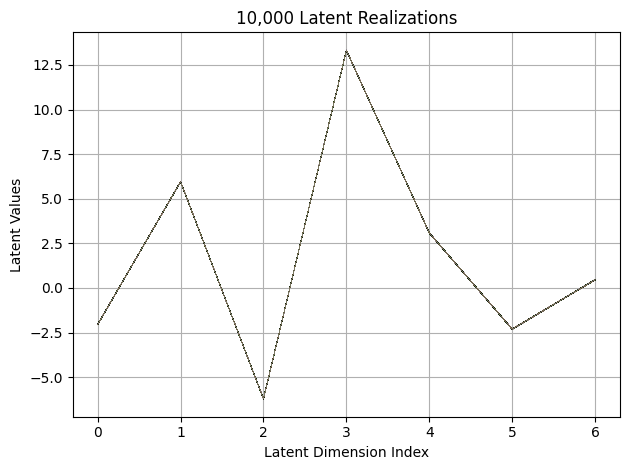

First 10 latent vectors from the VAE:
Sample 1: [-2.0455925464630127, 5.9565887451171875, -6.208126544952393, 13.308225631713867, 3.086915969848633, -2.2970523834228516, 0.45686399936676025]
Sample 2: [-2.0584516525268555, 5.944304466247559, -6.22348165512085, 13.328957557678223, 3.0847232341766357, -2.307034730911255, 0.4482458531856537]
Sample 3: [-2.047147274017334, 5.949390411376953, -6.207904815673828, 13.315607070922852, 3.0777409076690674, -2.310906410217285, 0.45896202325820923]
Sample 4: [-2.0674426555633545, 5.9519524574279785, -6.229286193847656, 13.327518463134766, 3.0701677799224854, -2.3169105052948, 0.45566147565841675]
Sample 5: [-2.055187702178955, 5.939512252807617, -6.209121227264404, 13.320180892944336, 3.0918450355529785, -2.3194587230682373, 0.4623965919017792]
Sample 6: [-2.054767608642578, 5.943261623382568, -6.219099521636963, 13.330485343933105, 3.071647882461548, -2.3052327632904053, 0.4718775749206543]
Sample 7: [-2.060255289077759, 5.955546855926514, -6.213

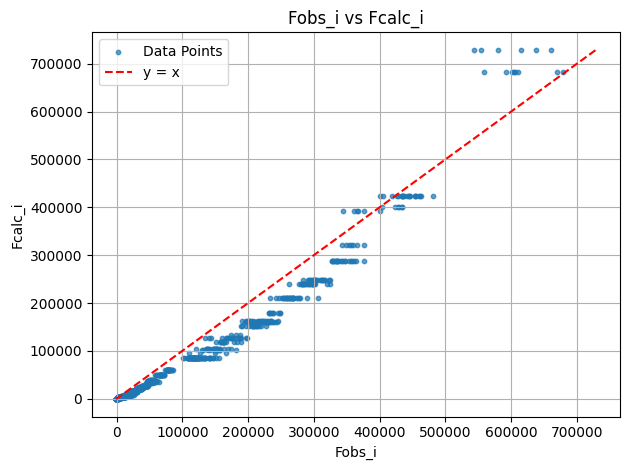

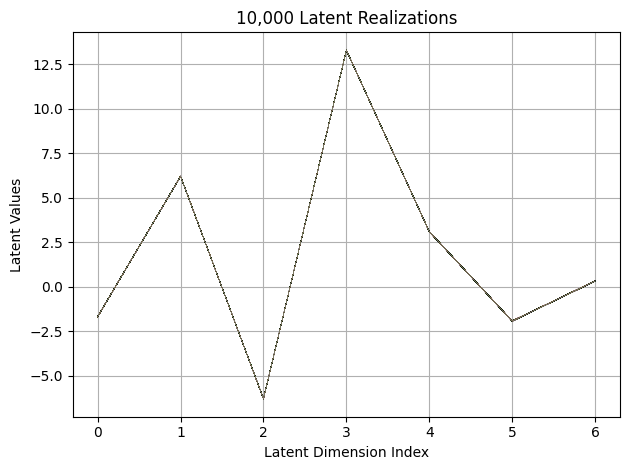

First 10 latent vectors from the VAE:
Sample 1: [-1.6870787143707275, 6.21572732925415, -6.308260440826416, 13.307286262512207, 3.092823028564453, -1.9225835800170898, 0.32073262333869934]
Sample 2: [-1.6884136199951172, 6.216909408569336, -6.298685550689697, 13.296566009521484, 3.095646858215332, -1.9373571872711182, 0.3249287009239197]
Sample 3: [-1.6838805675506592, 6.216548442840576, -6.312748432159424, 13.299843788146973, 3.091379404067993, -1.9349582195281982, 0.31837254762649536]
Sample 4: [-1.6915925741195679, 6.202582359313965, -6.294078826904297, 13.301314353942871, 3.09138822555542, -1.9264335632324219, 0.3171747028827667]
Sample 5: [-1.6867719888687134, 6.21487283706665, -6.286566257476807, 13.296804428100586, 3.0908830165863037, -1.939024567604065, 0.3231666386127472]
Sample 6: [-1.674129605293274, 6.209842205047607, -6.312252998352051, 13.304197311401367, 3.0971388816833496, -1.940850019454956, 0.3214505910873413]
Sample 7: [-1.6875360012054443, 6.201694965362549, -6.3011

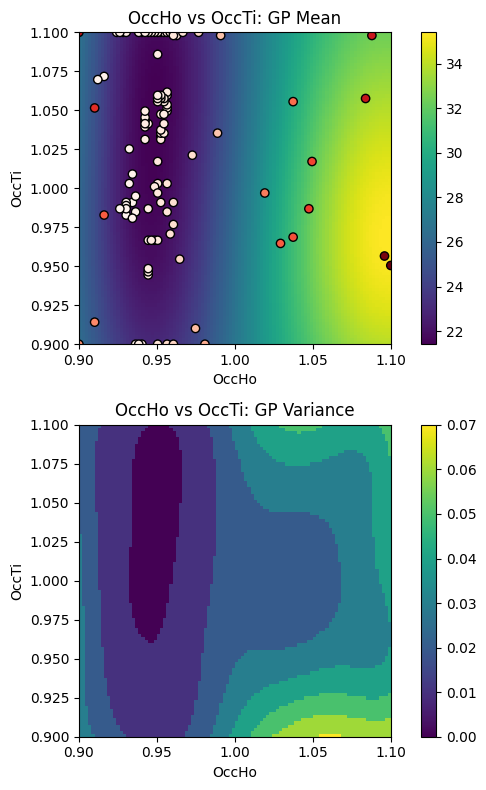

EI: [-1.00000000e+00  2.15216354e-03  2.18424387e-03 ...  5.63827343e-05
  6.78914948e-05  8.30244389e-05]
Function eval #110
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [0.8999999761581421, 0.9424242377281189]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7791
initial chi^2 1.4681e+05 with 2596 obs.
New scale: 0.7791
Cycle 0: 0.59s, Chi**2: 1.0233e+05 for 2596 obs., Lambda: 0,  Delta: 0.303, SVD=0
New scale: 0.7791
Maximum shift/esd = -58.03

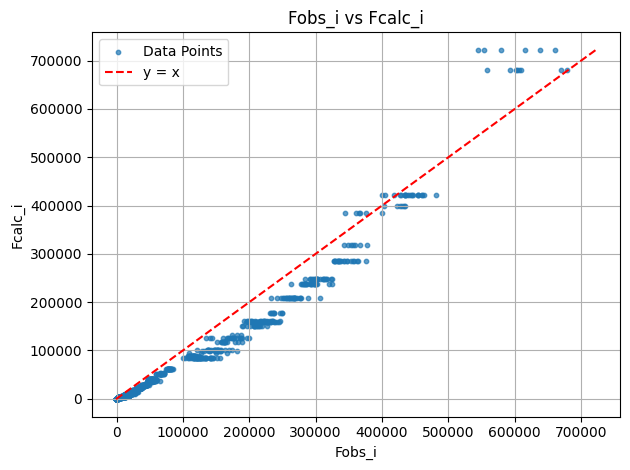

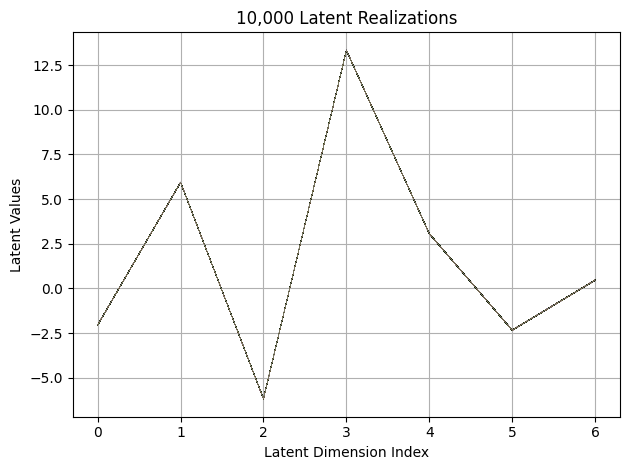

First 10 latent vectors from the VAE:
Sample 1: [-2.0584449768066406, 5.928043842315674, -6.185650825500488, 13.324834823608398, 3.041670083999634, -2.341848134994507, 0.45152008533477783]
Sample 2: [-2.0565226078033447, 5.941030025482178, -6.167147159576416, 13.324507713317871, 3.0511178970336914, -2.345057725906372, 0.46565330028533936]
Sample 3: [-2.056215286254883, 5.933559894561768, -6.170324325561523, 13.336228370666504, 3.0535225868225098, -2.352583169937134, 0.45175302028656006]
Sample 4: [-2.057770252227783, 5.928654670715332, -6.184885501861572, 13.337864875793457, 3.06685209274292, -2.3351123332977295, 0.44704869389533997]
Sample 5: [-2.057781934738159, 5.934173583984375, -6.179507255554199, 13.328673362731934, 3.0531234741210938, -2.3300812244415283, 0.45483502745628357]
Sample 6: [-2.058842897415161, 5.946608066558838, -6.176922798156738, 13.32146167755127, 3.0562727451324463, -2.3552756309509277, 0.4595308005809784]
Sample 7: [-2.060366153717041, 5.943597316741943, -6.174

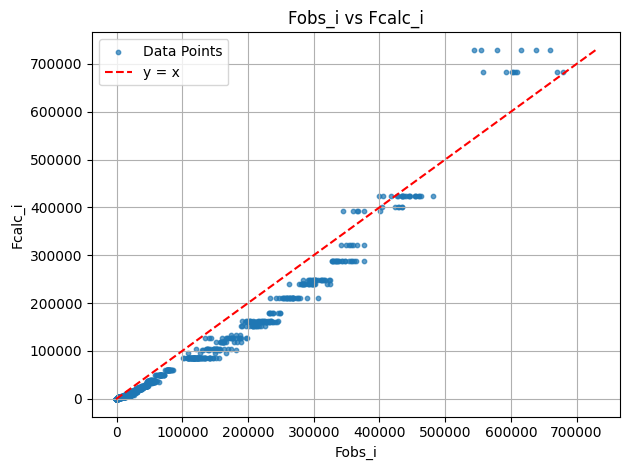

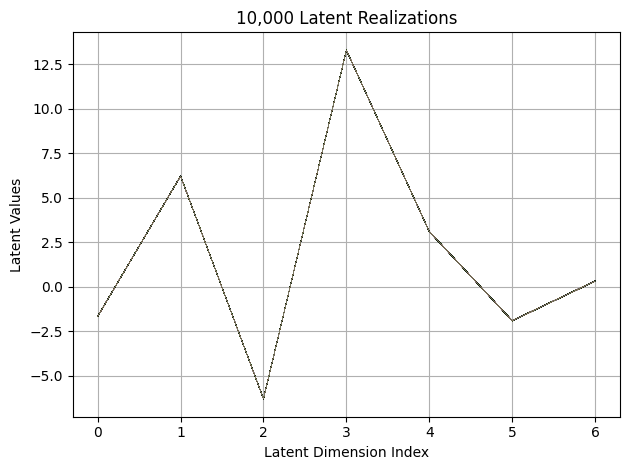

First 10 latent vectors from the VAE:
Sample 1: [-1.66668701171875, 6.2128214836120605, -6.311254024505615, 13.292401313781738, 3.1100502014160156, -1.9114656448364258, 0.3086140751838684]
Sample 2: [-1.680804967880249, 6.230900764465332, -6.306180000305176, 13.294126510620117, 3.0859081745147705, -1.9171686172485352, 0.32029083371162415]
Sample 3: [-1.6763683557510376, 6.217184543609619, -6.301029682159424, 13.293400764465332, 3.098201274871826, -1.9211245775222778, 0.3167976438999176]
Sample 4: [-1.677030086517334, 6.216729164123535, -6.306419849395752, 13.288395881652832, 3.0959649085998535, -1.9200952053070068, 0.3124611973762512]
Sample 5: [-1.6626977920532227, 6.217350006103516, -6.308921813964844, 13.29920768737793, 3.10367751121521, -1.9180169105529785, 0.3145395815372467]
Sample 6: [-1.6710927486419678, 6.222132205963135, -6.30299711227417, 13.290338516235352, 3.090587615966797, -1.9110749959945679, 0.3092884123325348]
Sample 7: [-1.67435622215271, 6.211053371429443, -6.333312

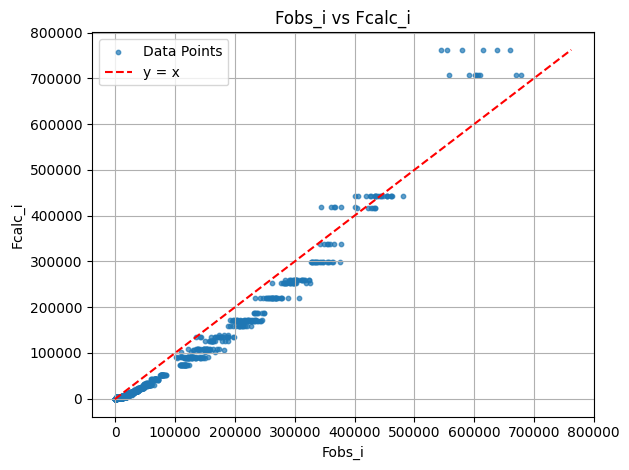

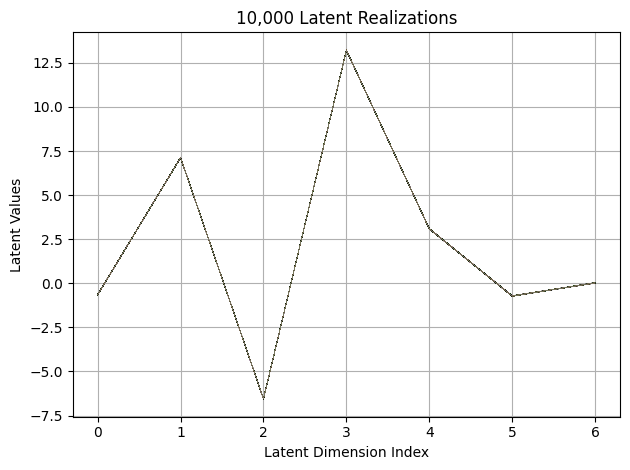

First 10 latent vectors from the VAE:
Sample 1: [-0.6365156769752502, 7.1332783699035645, -6.555540561676025, 13.211994171142578, 3.0880236625671387, -0.7211803793907166, 0.028132926672697067]
Sample 2: [-0.6485646367073059, 7.124063491821289, -6.549598693847656, 13.221447944641113, 3.083124876022339, -0.7106917500495911, 0.014717251062393188]
Sample 3: [-0.6482774615287781, 7.120381832122803, -6.553481101989746, 13.220978736877441, 3.088247299194336, -0.7207624912261963, 0.03686065226793289]
Sample 4: [-0.6428025364875793, 7.1223225593566895, -6.550228118896484, 13.220264434814453, 3.0820670127868652, -0.7187676429748535, 0.025006208568811417]
Sample 5: [-0.6608731746673584, 7.1240739822387695, -6.550622463226318, 13.220135688781738, 3.098050355911255, -0.7210675477981567, 0.031775254756212234]
Sample 6: [-0.6611596941947937, 7.125916004180908, -6.550583839416504, 13.21633243560791, 3.081357479095459, -0.7074086666107178, 0.01949228160083294]
Sample 7: [-0.6572446227073669, 7.13012838

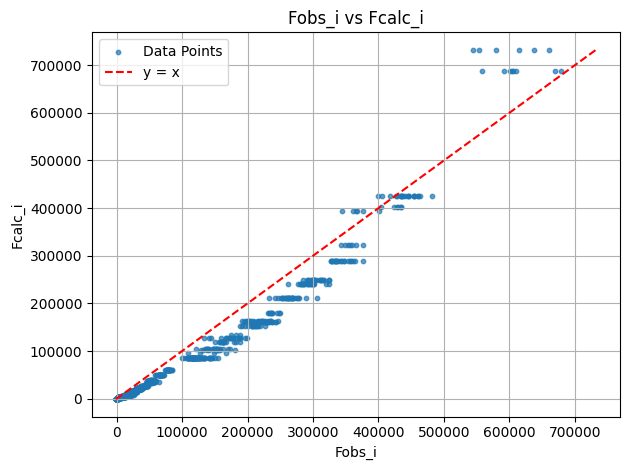

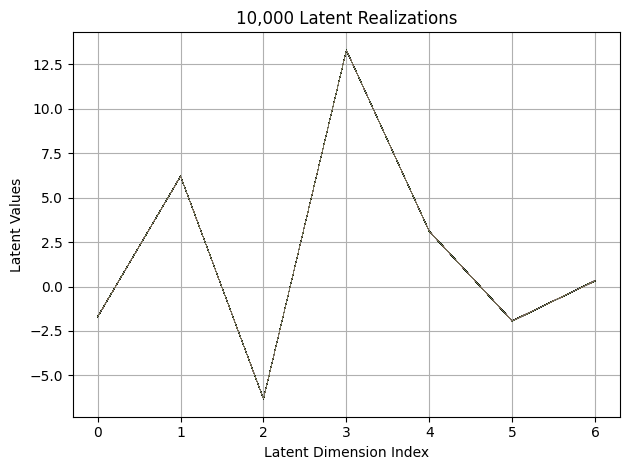

First 10 latent vectors from the VAE:
Sample 1: [-1.6956459283828735, 6.199349880218506, -6.303517818450928, 13.294984817504883, 3.105504274368286, -1.9412951469421387, 0.32632115483283997]
Sample 2: [-1.6980328559875488, 6.196762561798096, -6.313329219818115, 13.292977333068848, 3.1069586277008057, -1.9434653520584106, 0.31442293524742126]
Sample 3: [-1.7023018598556519, 6.200233459472656, -6.320448398590088, 13.279007911682129, 3.100782632827759, -1.932083249092102, 0.32770055532455444]
Sample 4: [-1.700021743774414, 6.204505443572998, -6.312029838562012, 13.285225868225098, 3.106844186782837, -1.9411711692810059, 0.30581700801849365]
Sample 5: [-1.7077569961547852, 6.210227012634277, -6.312138080596924, 13.292200088500977, 3.103935956954956, -1.9414520263671875, 0.31669124960899353]
Sample 6: [-1.6930415630340576, 6.197755336761475, -6.3213653564453125, 13.2944974899292, 3.1056056022644043, -1.9409185647964478, 0.31555917859077454]
Sample 7: [-1.7041608095169067, 6.2168049812316895,

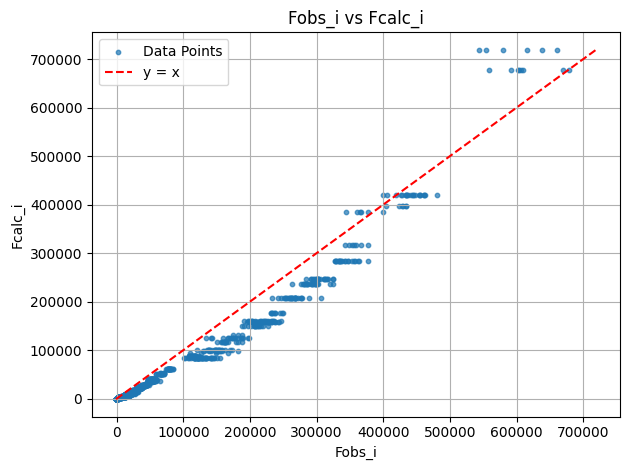

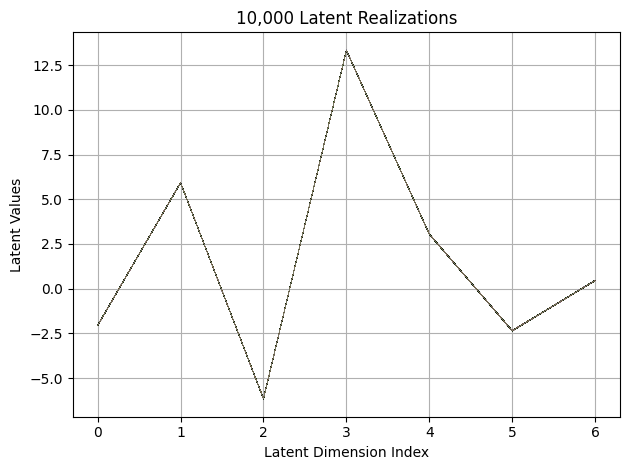

First 10 latent vectors from the VAE:
Sample 1: [-2.051586151123047, 5.927344799041748, -6.16615104675293, 13.333467483520508, 3.053499698638916, -2.3574695587158203, 0.4530005156993866]
Sample 2: [-2.0608956813812256, 5.9263014793396, -6.163161754608154, 13.320972442626953, 3.048769474029541, -2.3614890575408936, 0.4612720310688019]
Sample 3: [-2.058621883392334, 5.92146110534668, -6.164610862731934, 13.351324081420898, 3.0525379180908203, -2.351722002029419, 0.4560743570327759]
Sample 4: [-2.068796396255493, 5.906124591827393, -6.169996738433838, 13.33218002319336, 3.053072929382324, -2.353498935699463, 0.4574428200721741]
Sample 5: [-2.0548956394195557, 5.944103717803955, -6.166633129119873, 13.321675300598145, 3.040889024734497, -2.3558878898620605, 0.46063464879989624]
Sample 6: [-2.053764820098877, 5.917753219604492, -6.16823148727417, 13.329142570495605, 3.0454001426696777, -2.3547821044921875, 0.45149892568588257]
Sample 7: [-2.050252676010132, 5.9263997077941895, -6.1521563529

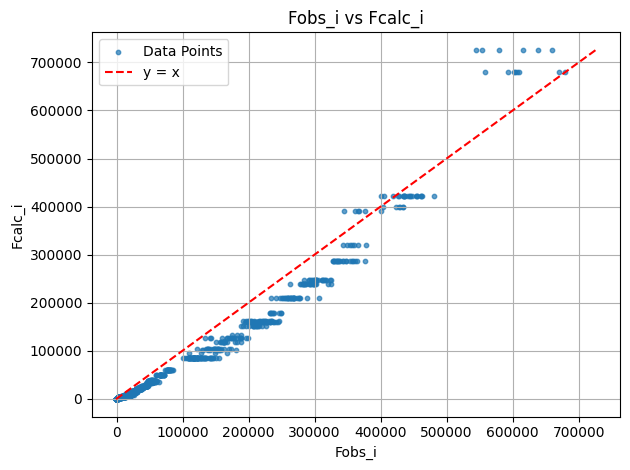

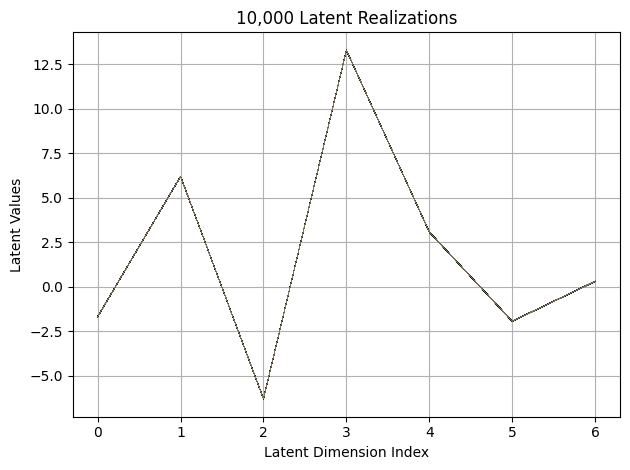

First 10 latent vectors from the VAE:
Sample 1: [-1.6788780689239502, 6.212942600250244, -6.29595947265625, 13.306055068969727, 3.0932693481445312, -1.9390721321105957, 0.3041006326675415]
Sample 2: [-1.6756815910339355, 6.205746173858643, -6.293891906738281, 13.304276466369629, 3.091655731201172, -1.9223722219467163, 0.32124564051628113]
Sample 3: [-1.6821476221084595, 6.206510066986084, -6.285555362701416, 13.300041198730469, 3.0813775062561035, -1.919107437133789, 0.3002682030200958]
Sample 4: [-1.6841802597045898, 6.208025932312012, -6.280918121337891, 13.299232482910156, 3.0862348079681396, -1.9340009689331055, 0.3118394911289215]
Sample 5: [-1.678231954574585, 6.20321798324585, -6.2913689613342285, 13.301279067993164, 3.0882198810577393, -1.9327141046524048, 0.3123164772987366]
Sample 6: [-1.6748721599578857, 6.2116312980651855, -6.285358428955078, 13.295008659362793, 3.086758852005005, -1.9431811571121216, 0.3127121329307556]
Sample 7: [-1.6737782955169678, 6.217416286468506, -6

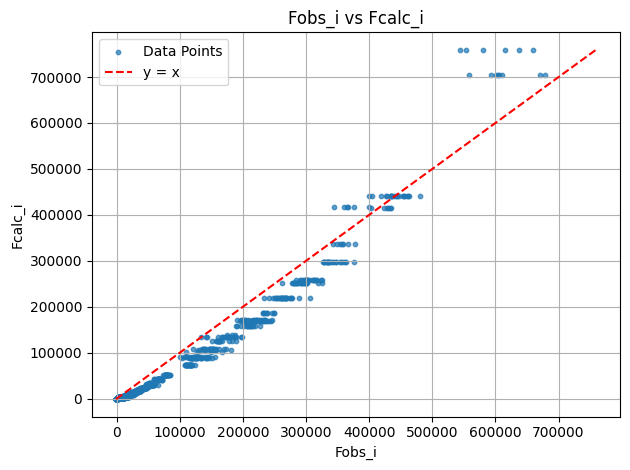

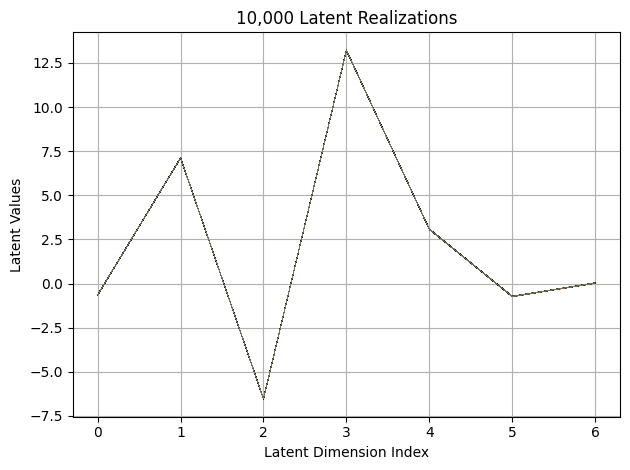

First 10 latent vectors from the VAE:
Sample 1: [-0.642042875289917, 7.112671852111816, -6.534190654754639, 13.21314811706543, 3.081300735473633, -0.74507737159729, 0.026156650856137276]
Sample 2: [-0.6559840440750122, 7.111043453216553, -6.53769588470459, 13.22386646270752, 3.0790021419525146, -0.7457706928253174, 0.03571362793445587]
Sample 3: [-0.6532511115074158, 7.107944965362549, -6.531428337097168, 13.205305099487305, 3.0664215087890625, -0.7278600335121155, 0.02986796572804451]
Sample 4: [-0.6518821716308594, 7.106103897094727, -6.538052558898926, 13.21208381652832, 3.078892707824707, -0.7356496453285217, 0.025749385356903076]
Sample 5: [-0.6558266878128052, 7.1231608390808105, -6.5338640213012695, 13.215051651000977, 3.0818097591400146, -0.7273348569869995, 0.008745072409510612]
Sample 6: [-0.6556352376937866, 7.114294052124023, -6.5259904861450195, 13.21688175201416, 3.0753653049468994, -0.7452898025512695, 0.03403446823358536]
Sample 7: [-0.6538665294647217, 7.11300134658813

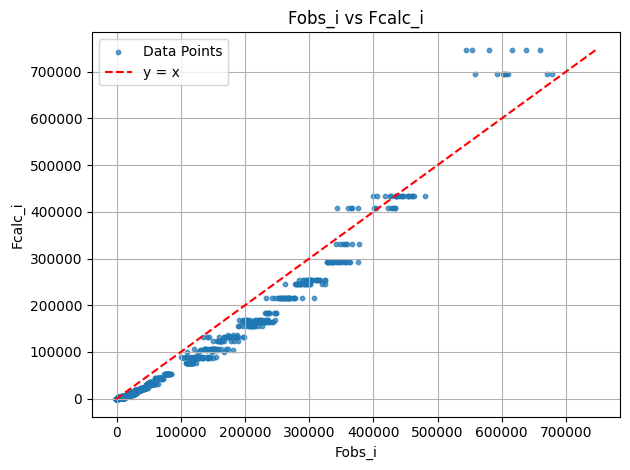

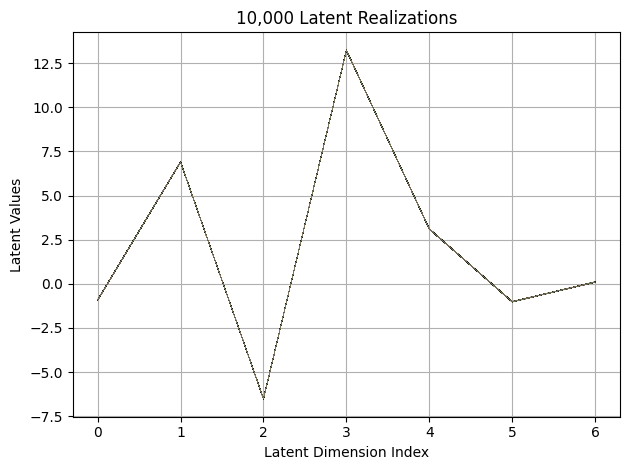

First 10 latent vectors from the VAE:
Sample 1: [-0.9141541123390198, 6.908006191253662, -6.507150173187256, 13.230627059936523, 3.1047487258911133, -1.0060343742370605, 0.10108508914709091]
Sample 2: [-0.9123331904411316, 6.895565509796143, -6.521410942077637, 13.22535228729248, 3.111633539199829, -1.014387607574463, 0.09607461094856262]
Sample 3: [-0.9136454463005066, 6.89508056640625, -6.5168633460998535, 13.222966194152832, 3.10495662689209, -1.0151958465576172, 0.112324558198452]
Sample 4: [-0.9094368815422058, 6.902313709259033, -6.5086445808410645, 13.227598190307617, 3.1083741188049316, -1.0140900611877441, 0.09616517275571823]
Sample 5: [-0.9201896786689758, 6.8857622146606445, -6.520937442779541, 13.233589172363281, 3.0999085903167725, -1.0238596200942993, 0.10899447649717331]
Sample 6: [-0.9216305613517761, 6.897993564605713, -6.5042877197265625, 13.228792190551758, 3.09849214553833, -1.0082457065582275, 0.09943268448114395]
Sample 7: [-0.9093286395072937, 6.893792629241943,

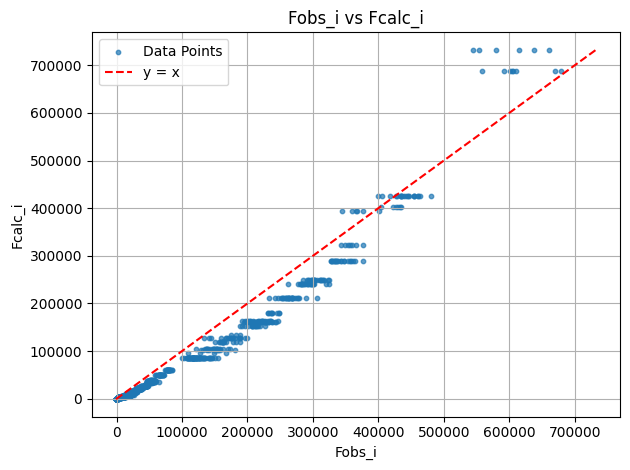

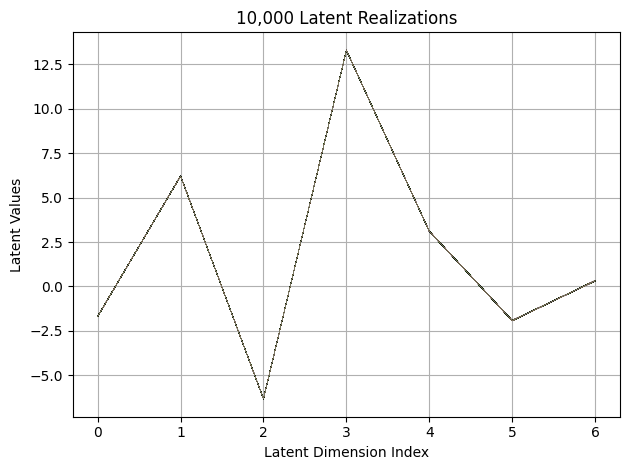

First 10 latent vectors from the VAE:
Sample 1: [-1.6946840286254883, 6.2202253341674805, -6.32179069519043, 13.291817665100098, 3.0950653553009033, -1.91291081905365, 0.3074702322483063]
Sample 2: [-1.6830600500106812, 6.221836090087891, -6.315806865692139, 13.301512718200684, 3.1009700298309326, -1.9134920835494995, 0.3166683316230774]
Sample 3: [-1.690710425376892, 6.221778392791748, -6.329242706298828, 13.298288345336914, 3.1085259914398193, -1.9260263442993164, 0.33073875308036804]
Sample 4: [-1.6757771968841553, 6.219196319580078, -6.318946361541748, 13.276494979858398, 3.096602439880371, -1.9194797277450562, 0.3138069212436676]
Sample 5: [-1.689632534980774, 6.20628023147583, -6.327542781829834, 13.279141426086426, 3.106325626373291, -1.9076744318008423, 0.31863582134246826]
Sample 6: [-1.6873416900634766, 6.218011856079102, -6.319721698760986, 13.29623031616211, 3.102449893951416, -1.9217920303344727, 0.30240675806999207]
Sample 7: [-1.6865466833114624, 6.206757068634033, -6.31

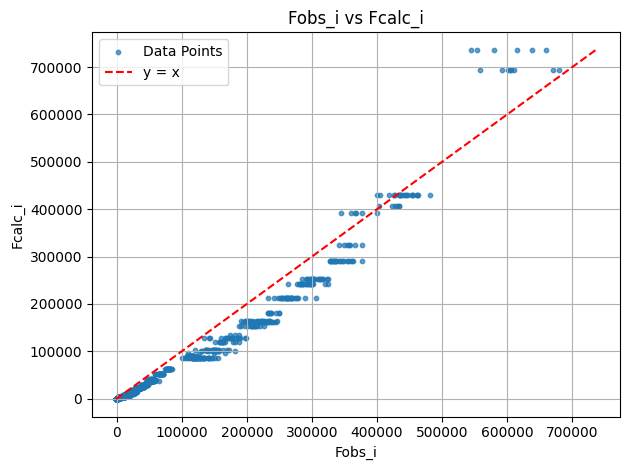

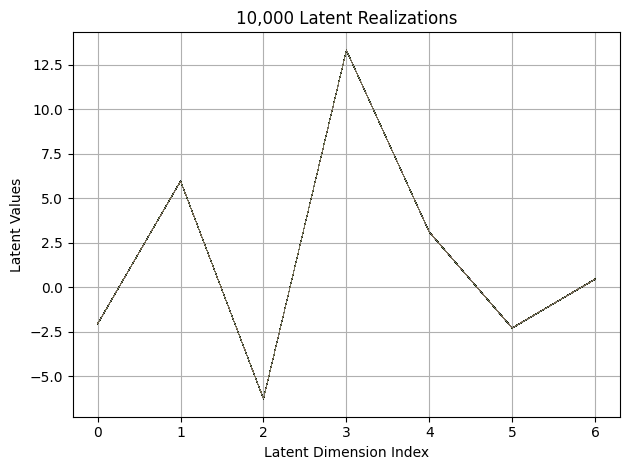

First 10 latent vectors from the VAE:
Sample 1: [-2.0445315837860107, 5.975815773010254, -6.258829593658447, 13.312583923339844, 3.1078481674194336, -2.2862939834594727, 0.4667906165122986]
Sample 2: [-2.0455033779144287, 5.971127510070801, -6.266523361206055, 13.312614440917969, 3.1128194332122803, -2.271008014678955, 0.46966636180877686]
Sample 3: [-2.053323268890381, 5.975915431976318, -6.264870643615723, 13.315630912780762, 3.101097822189331, -2.286879062652588, 0.46645376086235046]
Sample 4: [-2.0413272380828857, 5.963161468505859, -6.265651226043701, 13.312055587768555, 3.113102912902832, -2.274770975112915, 0.46674981713294983]
Sample 5: [-2.048692226409912, 5.97721004486084, -6.252536773681641, 13.310519218444824, 3.1054930686950684, -2.2811484336853027, 0.45941564440727234]
Sample 6: [-2.0494399070739746, 5.963248252868652, -6.254456996917725, 13.298248291015625, 3.101378917694092, -2.292600154876709, 0.46684935688972473]
Sample 7: [-2.0583267211914062, 5.958552360534668, -6.2

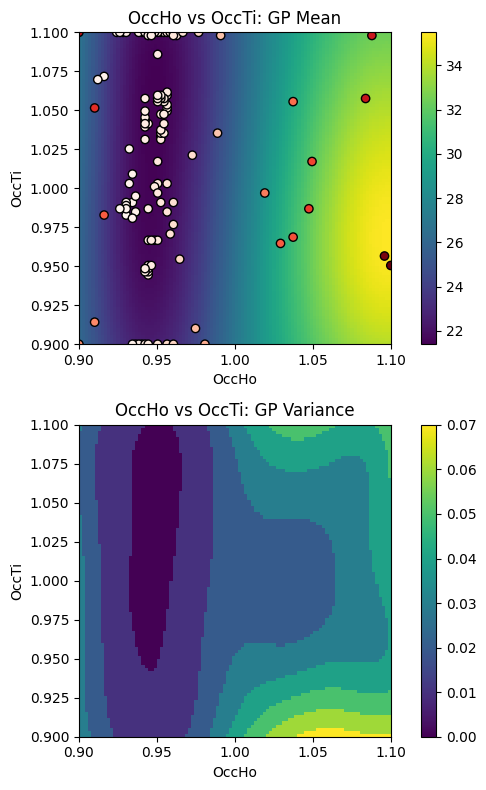

EI: [-1.00000000e+00  2.50095595e-03  2.53534317e-03 ...  6.60620863e-05
  7.99210975e-05  9.82462661e-05]
Function eval #120
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [0.9444444179534912, 0.9424242377281189]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7729
initial chi^2 1.5629e+05 with 2596 obs.
New scale: 0.7729
Cycle 0: 0.97s, Chi**2: 1.1431e+05 for 2596 obs., Lambda: 0,  Delta: 0.269, SVD=0
New scale: 0.7729
Maximum shift/esd = -56.75

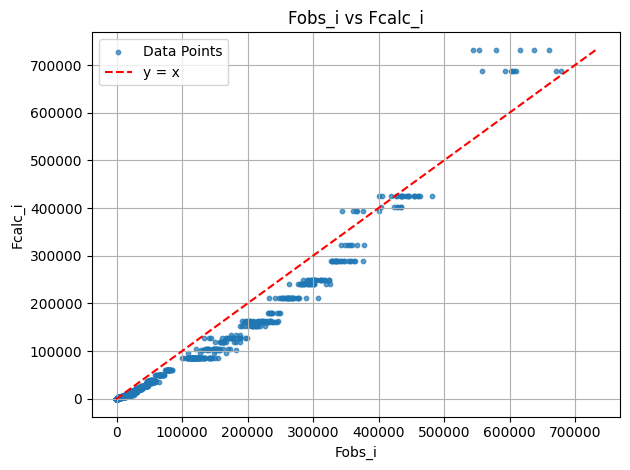

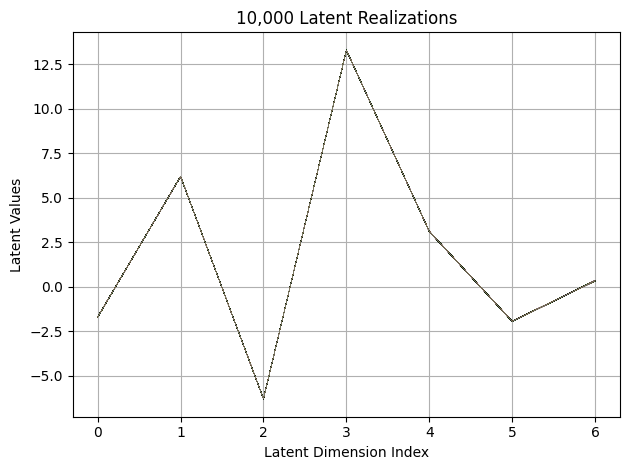

First 10 latent vectors from the VAE:
Sample 1: [-1.7179572582244873, 6.184264183044434, -6.315555572509766, 13.30396842956543, 3.0968542098999023, -1.952651858329773, 0.3272412121295929]
Sample 2: [-1.7132070064544678, 6.19364595413208, -6.307568073272705, 13.300071716308594, 3.0985946655273438, -1.947157621383667, 0.3261708915233612]
Sample 3: [-1.7203768491744995, 6.1889872550964355, -6.31610107421875, 13.293092727661133, 3.102936267852783, -1.9539589881896973, 0.3222423791885376]
Sample 4: [-1.7179760932922363, 6.208060264587402, -6.301587104797363, 13.29476261138916, 3.100659132003784, -1.953478217124939, 0.33762669563293457]
Sample 5: [-1.7080610990524292, 6.189965724945068, -6.3092942237854, 13.291717529296875, 3.0966691970825195, -1.9539077281951904, 0.3273504376411438]
Sample 6: [-1.7197736501693726, 6.186947345733643, -6.304288387298584, 13.28364086151123, 3.1038742065429688, -1.9506865739822388, 0.3228093385696411]
Sample 7: [-1.724888801574707, 6.196307182312012, -6.3024253

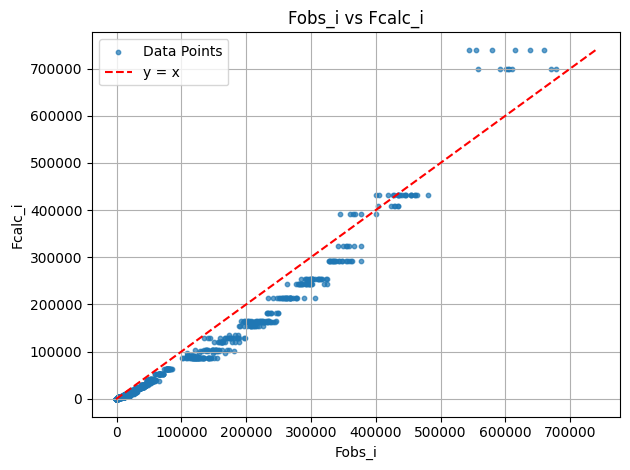

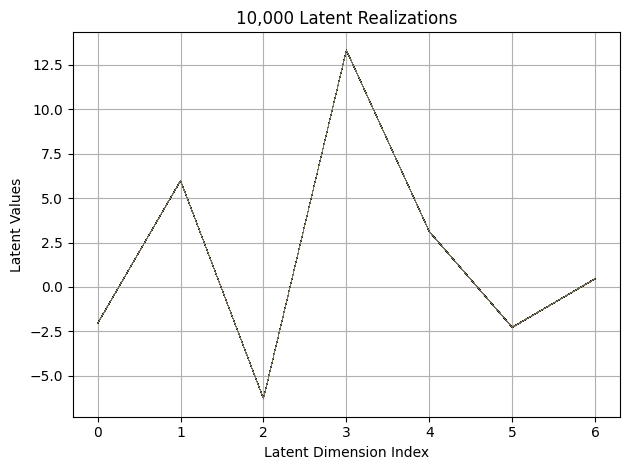

First 10 latent vectors from the VAE:
Sample 1: [-2.050525188446045, 5.981265068054199, -6.282839298248291, 13.306718826293945, 3.114856719970703, -2.275228500366211, 0.46667325496673584]
Sample 2: [-2.061753034591675, 5.9788312911987305, -6.281622886657715, 13.299108505249023, 3.1200647354125977, -2.265795946121216, 0.46395424008369446]
Sample 3: [-2.0509603023529053, 5.988278865814209, -6.286786079406738, 13.305543899536133, 3.1223549842834473, -2.267864942550659, 0.46324169635772705]
Sample 4: [-2.0377800464630127, 5.985883712768555, -6.270142555236816, 13.314127922058105, 3.1158459186553955, -2.2754967212677, 0.46509554982185364]
Sample 5: [-2.0564944744110107, 5.972849369049072, -6.281340599060059, 13.309285163879395, 3.123671770095825, -2.2738471031188965, 0.4562278687953949]
Sample 6: [-2.057767629623413, 5.972445011138916, -6.278343677520752, 13.31432056427002, 3.114431381225586, -2.2700307369232178, 0.45770761370658875]
Sample 7: [-2.044044017791748, 5.985285758972168, -6.2723

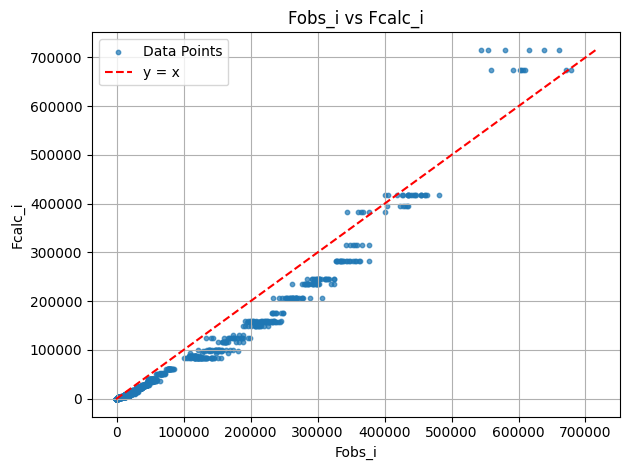

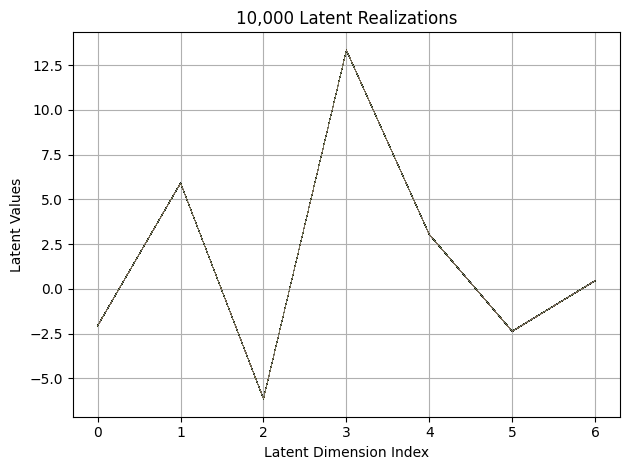

First 10 latent vectors from the VAE:
Sample 1: [-2.0685033798217773, 5.913846969604492, -6.133917808532715, 13.339719772338867, 3.037393569946289, -2.3792808055877686, 0.45387300848960876]
Sample 2: [-2.058609962463379, 5.910430908203125, -6.143679141998291, 13.319997787475586, 3.0262794494628906, -2.3625054359436035, 0.45005232095718384]
Sample 3: [-2.0549819469451904, 5.9155168533325195, -6.1452250480651855, 13.337593078613281, 3.0335400104522705, -2.3765625953674316, 0.4591750502586365]
Sample 4: [-2.0484044551849365, 5.902322769165039, -6.140627384185791, 13.329861640930176, 3.0268290042877197, -2.36873722076416, 0.44883430004119873]
Sample 5: [-2.04776668548584, 5.916584014892578, -6.146471977233887, 13.347648620605469, 3.0356318950653076, -2.364536762237549, 0.4560294449329376]
Sample 6: [-2.0600459575653076, 5.914365768432617, -6.142056465148926, 13.333230972290039, 3.0333733558654785, -2.3794710636138916, 0.4560203552246094]
Sample 7: [-2.069547653198242, 5.910495281219482, -6

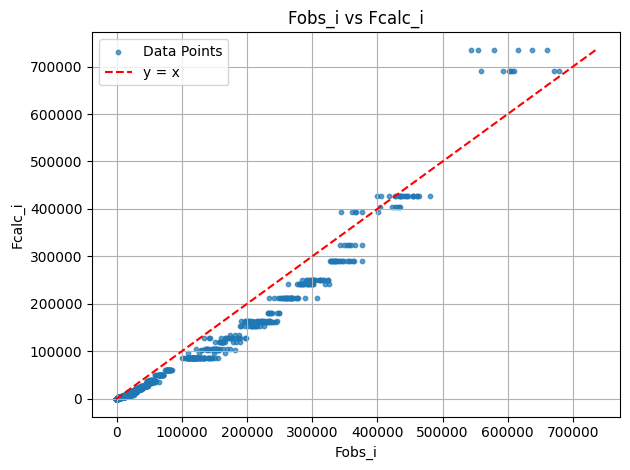

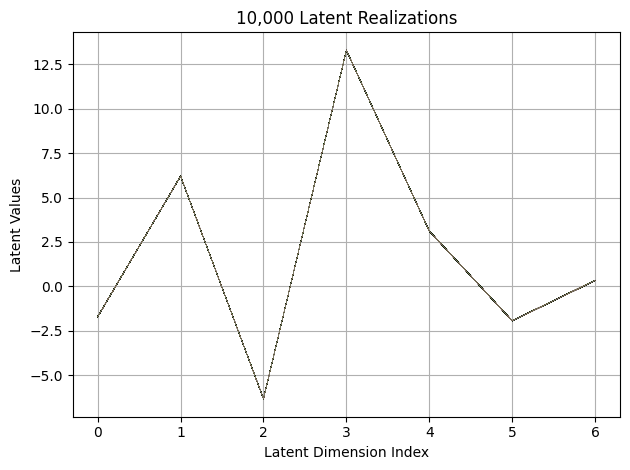

First 10 latent vectors from the VAE:
Sample 1: [-1.7261995077133179, 6.19320011138916, -6.337188720703125, 13.287900924682617, 3.1064395904541016, -1.9345463514328003, 0.3397456705570221]
Sample 2: [-1.7190892696380615, 6.20527458190918, -6.312084197998047, 13.296479225158691, 3.1138346195220947, -1.937932014465332, 0.3392896056175232]
Sample 3: [-1.7149465084075928, 6.213533878326416, -6.332339763641357, 13.287487030029297, 3.1133921146392822, -1.9507166147232056, 0.32414424419403076]
Sample 4: [-1.7044733762741089, 6.197198867797852, -6.3255295753479, 13.287032127380371, 3.1118226051330566, -1.9359408617019653, 0.335137277841568]
Sample 5: [-1.7196910381317139, 6.201753616333008, -6.345367431640625, 13.286964416503906, 3.115098237991333, -1.9465192556381226, 0.3257509768009186]
Sample 6: [-1.7180376052856445, 6.199074745178223, -6.318610668182373, 13.289097785949707, 3.1053717136383057, -1.95037841796875, 0.33178579807281494]
Sample 7: [-1.7173874378204346, 6.1890411376953125, -6.33

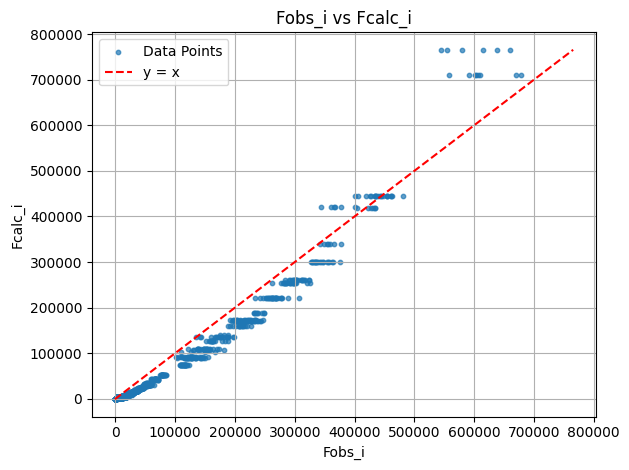

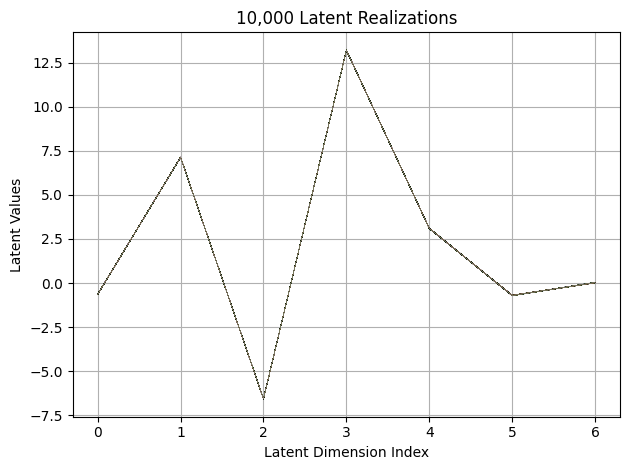

First 10 latent vectors from the VAE:
Sample 1: [-0.6423357725143433, 7.13730001449585, -6.566746234893799, 13.202126502990723, 3.0949010848999023, -0.70423424243927, 0.018692638725042343]
Sample 2: [-0.6451284289360046, 7.123778343200684, -6.557809829711914, 13.210504531860352, 3.095604658126831, -0.7027883529663086, 0.016603659838438034]
Sample 3: [-0.6524085402488708, 7.128061294555664, -6.568629741668701, 13.213930130004883, 3.0956854820251465, -0.7176308035850525, 0.0195475947111845]
Sample 4: [-0.6547537446022034, 7.135427951812744, -6.575985431671143, 13.217599868774414, 3.0959129333496094, -0.7080928683280945, 0.04119834303855896]
Sample 5: [-0.6567174792289734, 7.116716384887695, -6.5607218742370605, 13.197340965270996, 3.097658634185791, -0.7091502547264099, 0.019318245351314545]
Sample 6: [-0.6433899402618408, 7.138537406921387, -6.567307949066162, 13.210153579711914, 3.104016065597534, -0.7005029916763306, 0.034150656312704086]
Sample 7: [-0.6397033929824829, 7.130009174346

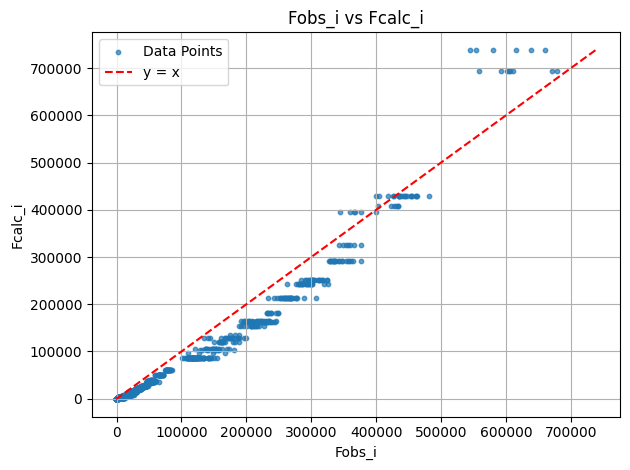

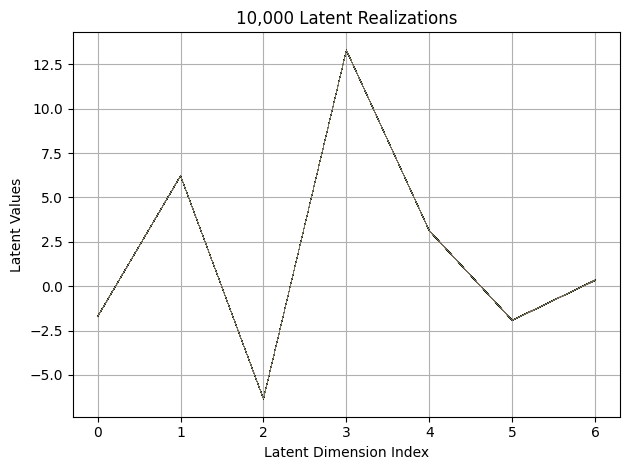

First 10 latent vectors from the VAE:
Sample 1: [-1.7104060649871826, 6.214406490325928, -6.347903728485107, 13.287932395935059, 3.1359269618988037, -1.9217132329940796, 0.33425021171569824]
Sample 2: [-1.711733341217041, 6.214569568634033, -6.342550277709961, 13.2900972366333, 3.119946002960205, -1.9254798889160156, 0.3382408618927002]
Sample 3: [-1.7177395820617676, 6.222252368927002, -6.34402322769165, 13.291158676147461, 3.1187191009521484, -1.9221590757369995, 0.3440036177635193]
Sample 4: [-1.7117246389389038, 6.210183143615723, -6.330350875854492, 13.302838325500488, 3.1287875175476074, -1.9242284297943115, 0.3301893472671509]
Sample 5: [-1.7090692520141602, 6.2213921546936035, -6.3497700691223145, 13.295796394348145, 3.1200129985809326, -1.9356673955917358, 0.34849339723587036]
Sample 6: [-1.7259879112243652, 6.232124328613281, -6.346614837646484, 13.299717903137207, 3.134103536605835, -1.9261797666549683, 0.31812867522239685]
Sample 7: [-1.713890790939331, 6.214856147766113, -

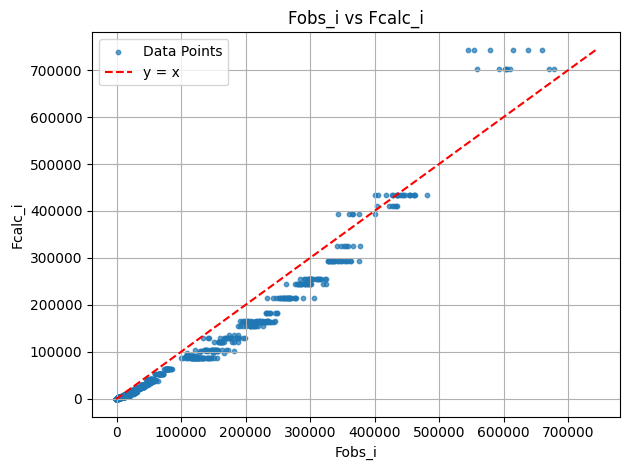

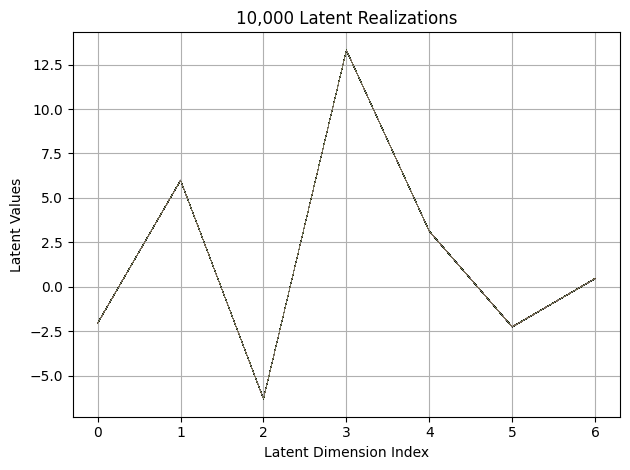

First 10 latent vectors from the VAE:
Sample 1: [-2.052133083343506, 6.000904083251953, -6.289868354797363, 13.313925743103027, 3.128073215484619, -2.253504514694214, 0.4570907950401306]
Sample 2: [-2.0588490962982178, 5.986832618713379, -6.290741920471191, 13.306026458740234, 3.122166395187378, -2.254784107208252, 0.46508756279945374]
Sample 3: [-2.063572883605957, 5.984984397888184, -6.291690826416016, 13.308259963989258, 3.1223747730255127, -2.2386550903320312, 0.4658718705177307]
Sample 4: [-2.0448105335235596, 5.988836765289307, -6.304782867431641, 13.29977035522461, 3.1244914531707764, -2.240818977355957, 0.46188369393348694]
Sample 5: [-2.0445520877838135, 5.977005958557129, -6.29054069519043, 13.301761627197266, 3.132513999938965, -2.2584710121154785, 0.4532198905944824]
Sample 6: [-2.0442628860473633, 5.981568813323975, -6.298364639282227, 13.296579360961914, 3.136655807495117, -2.2506253719329834, 0.46297183632850647]
Sample 7: [-2.041961431503296, 5.998960971832275, -6.30124

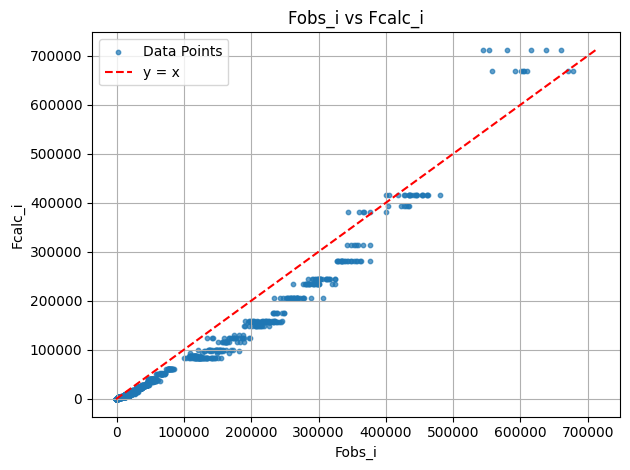

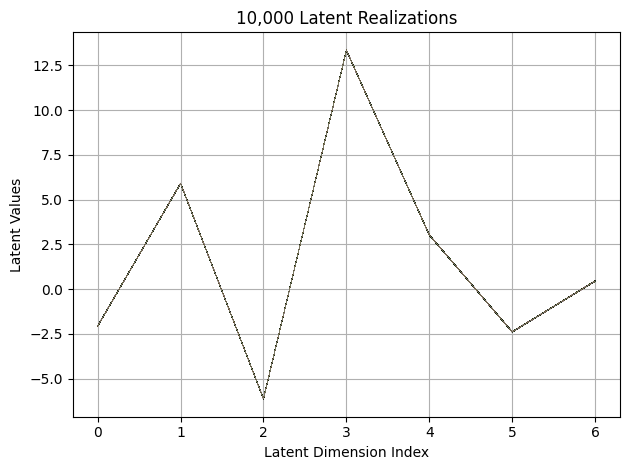

First 10 latent vectors from the VAE:
Sample 1: [-2.0605266094207764, 5.899289131164551, -6.123601913452148, 13.337684631347656, 3.0237009525299072, -2.3753979206085205, 0.449714720249176]
Sample 2: [-2.066974639892578, 5.903028964996338, -6.114099979400635, 13.334674835205078, 3.0234715938568115, -2.3757121562957764, 0.4531960189342499]
Sample 3: [-2.0638582706451416, 5.899196624755859, -6.122438430786133, 13.336621284484863, 3.0167243480682373, -2.3957698345184326, 0.4719548523426056]
Sample 4: [-2.056755781173706, 5.899046897888184, -6.122402667999268, 13.331175804138184, 3.027331829071045, -2.384232997894287, 0.4468287527561188]
Sample 5: [-2.0667598247528076, 5.906604766845703, -6.130346775054932, 13.33613109588623, 3.0293169021606445, -2.365370988845825, 0.455988347530365]
Sample 6: [-2.0722556114196777, 5.908074855804443, -6.1242475509643555, 13.350359916687012, 3.024721145629883, -2.3909547328948975, 0.4540306627750397]
Sample 7: [-2.0568177700042725, 5.91120719909668, -6.10961

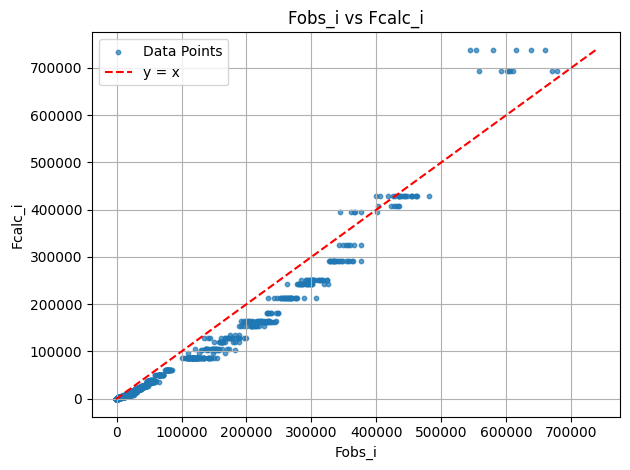

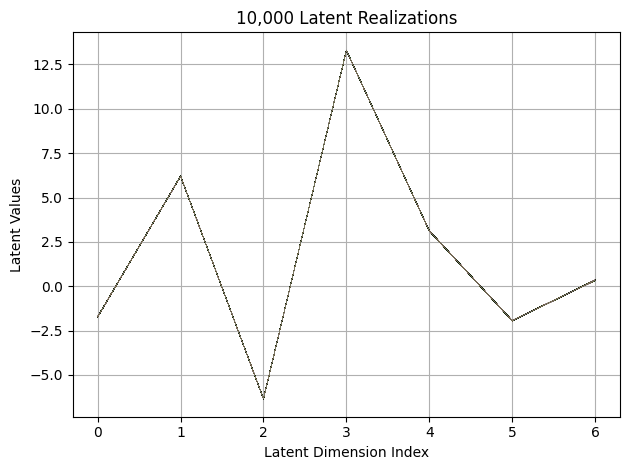

First 10 latent vectors from the VAE:
Sample 1: [-1.7246689796447754, 6.195895195007324, -6.352083206176758, 13.294572830200195, 3.1147842407226562, -1.9451795816421509, 0.3404119610786438]
Sample 2: [-1.717430591583252, 6.188452243804932, -6.333892345428467, 13.294415473937988, 3.1134443283081055, -1.928036093711853, 0.3378532826900482]
Sample 3: [-1.737005352973938, 6.197466850280762, -6.338466644287109, 13.279865264892578, 3.125304698944092, -1.944051742553711, 0.34152939915657043]
Sample 4: [-1.7245261669158936, 6.201315879821777, -6.346473693847656, 13.29116153717041, 3.1231069564819336, -1.9504090547561646, 0.3391481637954712]
Sample 5: [-1.7238743305206299, 6.209423542022705, -6.341626167297363, 13.28529167175293, 3.131498098373413, -1.9366018772125244, 0.32597869634628296]
Sample 6: [-1.7283549308776855, 6.204327583312988, -6.326818943023682, 13.297589302062988, 3.126415491104126, -1.9377353191375732, 0.32591792941093445]
Sample 7: [-1.7322237491607666, 6.2074103355407715, -6.3

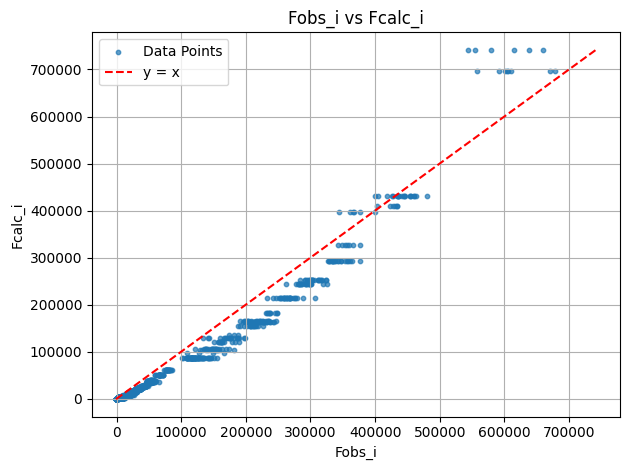

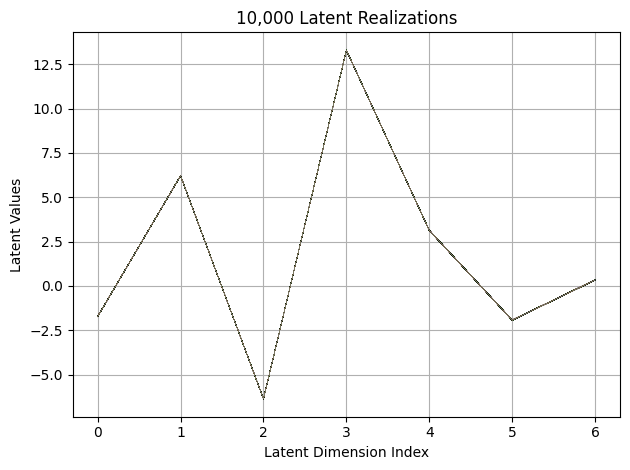

First 10 latent vectors from the VAE:
Sample 1: [-1.7291452884674072, 6.214419841766357, -6.370121479034424, 13.283150672912598, 3.1355581283569336, -1.9255566596984863, 0.33417224884033203]
Sample 2: [-1.7241369485855103, 6.209188461303711, -6.34881067276001, 13.287435531616211, 3.1309850215911865, -1.922326922416687, 0.3290563225746155]
Sample 3: [-1.7133041620254517, 6.207695007324219, -6.360157489776611, 13.284585952758789, 3.1268014907836914, -1.9296021461486816, 0.3478662967681885]
Sample 4: [-1.7204025983810425, 6.214328289031982, -6.36102294921875, 13.267475128173828, 3.1301047801971436, -1.9327632188796997, 0.3289112150669098]
Sample 5: [-1.7222360372543335, 6.209351539611816, -6.351560115814209, 13.284527778625488, 3.137779712677002, -1.930928111076355, 0.329159140586853]
Sample 6: [-1.7244782447814941, 6.213868618011475, -6.361663818359375, 13.288053512573242, 3.140044927597046, -1.919071078300476, 0.346053808927536]
Sample 7: [-1.7228881120681763, 6.214818954467773, -6.3695

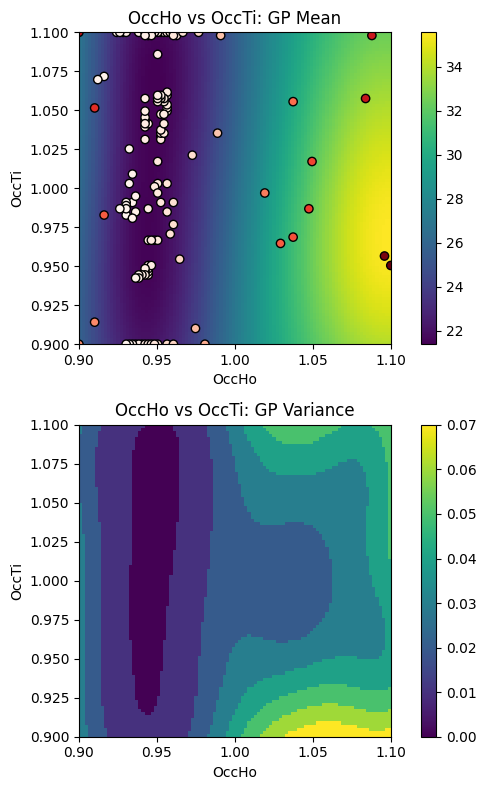

EI: [-1.00000000e+00  3.01029626e-03  3.04656569e-03 ...  7.60901021e-05
  9.24045453e-05  1.14070717e-04]
Function eval #130
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [0.8999999761581421, 0.9282827973365784]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
initial chi^2 1.2625e+05 with 2596 obs.
Cycle 0: 0.62s, Chi**2: 51122 for 2596 obs., Lambda: 0,  Delta: 0.595, SVD=0
Maximum shift/esd = -58.089 for all cycles
Read from file:C:\Users\USER\PhD\IAMM PROJ

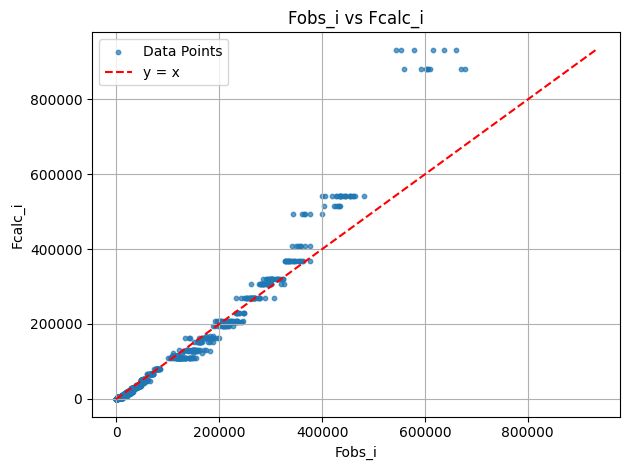

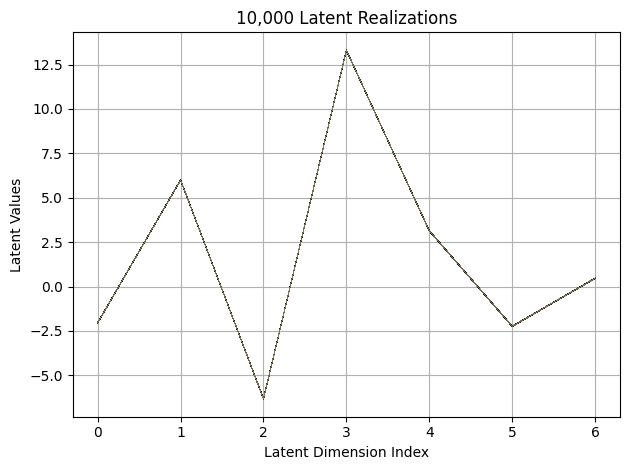

First 10 latent vectors from the VAE:
Sample 1: [-2.0349512100219727, 5.990508556365967, -6.322114944458008, 13.298881530761719, 3.1202914714813232, -2.234142541885376, 0.46263667941093445]
Sample 2: [-2.043325901031494, 5.986849308013916, -6.31566047668457, 13.309666633605957, 3.133352756500244, -2.2325408458709717, 0.4680742919445038]
Sample 3: [-2.052292823791504, 6.005598068237305, -6.315876483917236, 13.298527717590332, 3.138131618499756, -2.242496967315674, 0.4564754366874695]
Sample 4: [-2.046628475189209, 5.994709014892578, -6.303267002105713, 13.300113677978516, 3.1366982460021973, -2.228198766708374, 0.46773213148117065]
Sample 5: [-2.0361037254333496, 5.999108791351318, -6.3270721435546875, 13.301048278808594, 3.1334919929504395, -2.224158525466919, 0.4692694842815399]
Sample 6: [-2.0499792098999023, 6.002929210662842, -6.318247318267822, 13.293959617614746, 3.14646315574646, -2.2355458736419678, 0.4650368392467499]
Sample 7: [-2.0342791080474854, 5.993706226348877, -6.32826

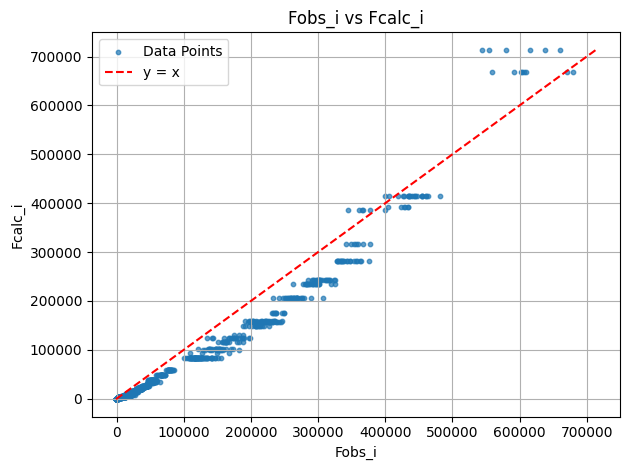

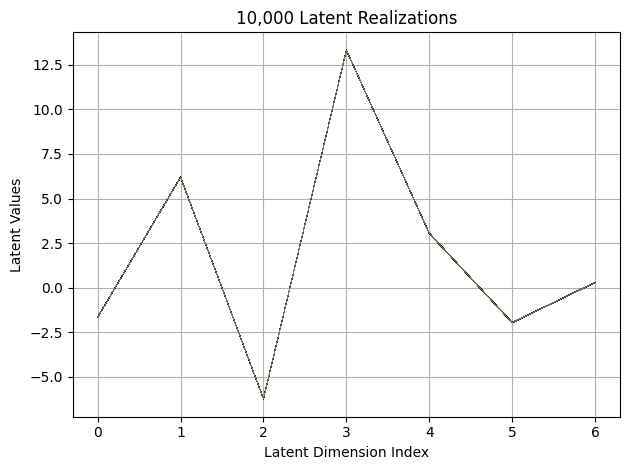

First 10 latent vectors from the VAE:
Sample 1: [-1.6594691276550293, 6.202153205871582, -6.22724723815918, 13.312616348266602, 3.0441553592681885, -1.9503958225250244, 0.3004145622253418]
Sample 2: [-1.6479909420013428, 6.195937633514404, -6.218871593475342, 13.321479797363281, 3.0421550273895264, -1.9496395587921143, 0.30215659737586975]
Sample 3: [-1.6414188146591187, 6.192902088165283, -6.211928367614746, 13.315858840942383, 3.059791088104248, -1.9531816244125366, 0.2967967689037323]
Sample 4: [-1.6634654998779297, 6.18643045425415, -6.230453968048096, 13.312094688415527, 3.0516862869262695, -1.963393211364746, 0.30278822779655457]
Sample 5: [-1.6663295030593872, 6.196262359619141, -6.220724105834961, 13.311466217041016, 3.0373599529266357, -1.947265625, 0.29866641759872437]
Sample 6: [-1.6581701040267944, 6.204699516296387, -6.22373628616333, 13.316704750061035, 3.0487329959869385, -1.9536677598953247, 0.294080913066864]
Sample 7: [-1.6515153646469116, 6.191987037658691, -6.225651

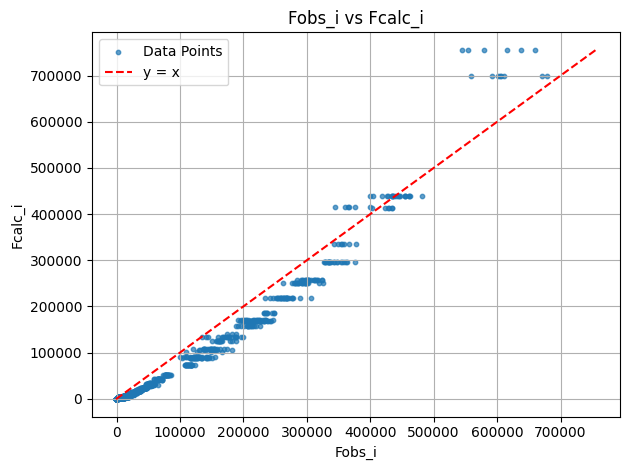

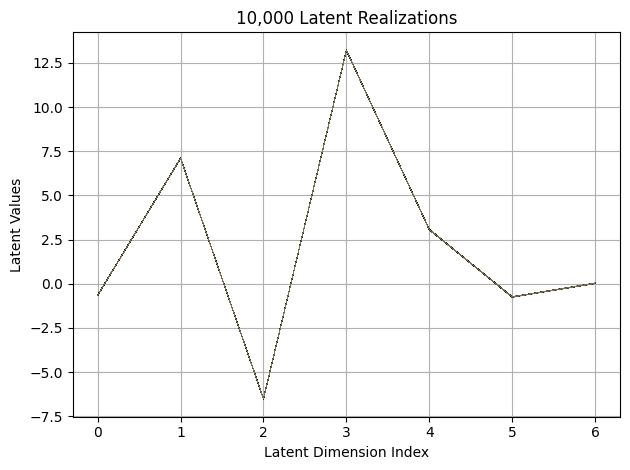

First 10 latent vectors from the VAE:
Sample 1: [-0.6648158431053162, 7.100628852844238, -6.519332408905029, 13.209854125976562, 3.068392276763916, -0.7473357915878296, 0.025106148794293404]
Sample 2: [-0.6564872860908508, 7.113310813903809, -6.515710830688477, 13.223170280456543, 3.066581964492798, -0.7527190446853638, 0.024568358436226845]
Sample 3: [-0.6603010892868042, 7.113562107086182, -6.5035905838012695, 13.221616744995117, 3.073671340942383, -0.7403411865234375, 0.014469930902123451]
Sample 4: [-0.6475851535797119, 7.101290702819824, -6.506918430328369, 13.22414493560791, 3.0762455463409424, -0.750159740447998, 0.01861761510372162]
Sample 5: [-0.6648671627044678, 7.118844985961914, -6.49846076965332, 13.214180946350098, 3.0712146759033203, -0.7481689453125, 0.017840135842561722]
Sample 6: [-0.6687156558036804, 7.109254837036133, -6.509517669677734, 13.220165252685547, 3.0680437088012695, -0.7490746974945068, 0.025282496586441994]
Sample 7: [-0.6510151624679565, 7.1131210327148

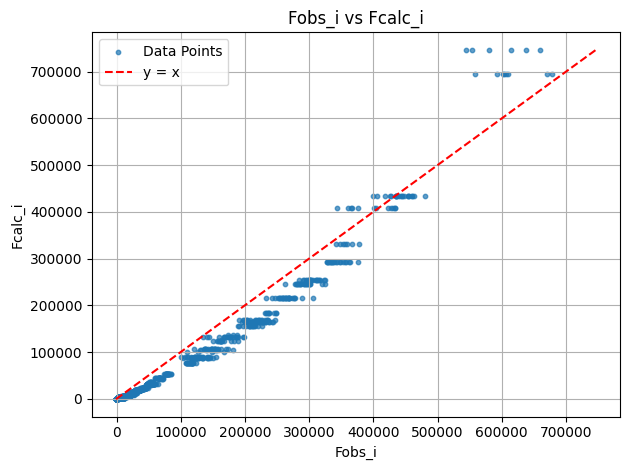

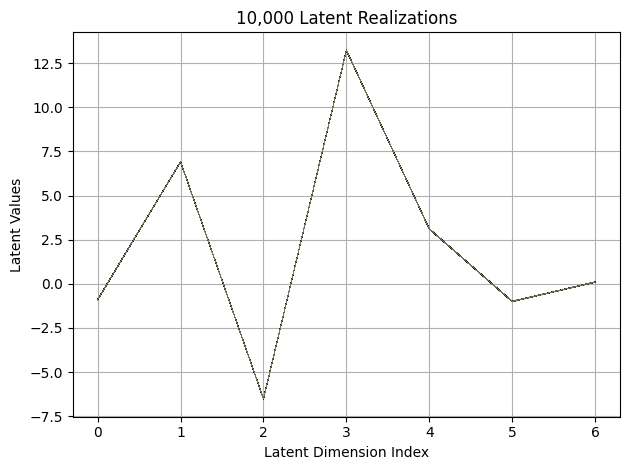

First 10 latent vectors from the VAE:
Sample 1: [-0.905845582485199, 6.913053512573242, -6.503492832183838, 13.217706680297852, 3.1101999282836914, -0.9945018291473389, 0.09799504280090332]
Sample 2: [-0.8927685618400574, 6.900203227996826, -6.512875556945801, 13.226949691772461, 3.1041383743286133, -0.9922140836715698, 0.09189601987600327]
Sample 3: [-0.9038158059120178, 6.910012722015381, -6.5207719802856445, 13.229743003845215, 3.111067771911621, -1.001741647720337, 0.0893021821975708]
Sample 4: [-0.9089179039001465, 6.903293609619141, -6.512996673583984, 13.229281425476074, 3.1118156909942627, -0.9965229034423828, 0.08488710969686508]
Sample 5: [-0.8948848247528076, 6.910370826721191, -6.517319202423096, 13.227093696594238, 3.1007823944091797, -1.0140175819396973, 0.09002085030078888]
Sample 6: [-0.9121963381767273, 6.927352428436279, -6.518013954162598, 13.22618579864502, 3.105121612548828, -1.0016194581985474, 0.08654274046421051]
Sample 7: [-0.9004327058792114, 6.903476715087891

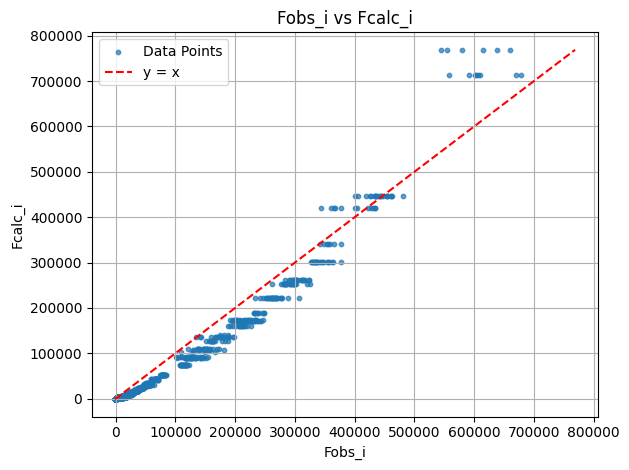

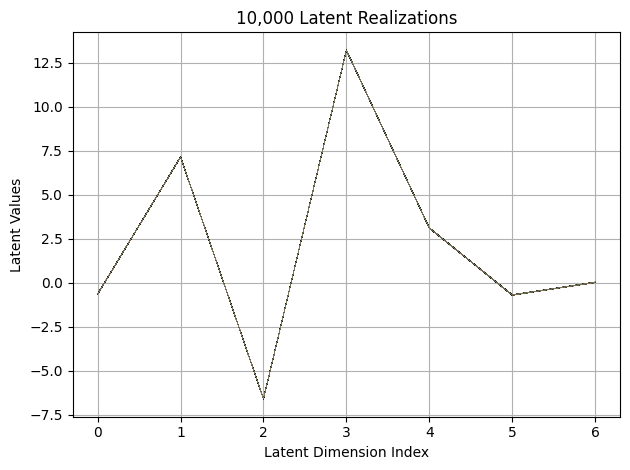

First 10 latent vectors from the VAE:
Sample 1: [-0.6446750164031982, 7.146606922149658, -6.576429843902588, 13.204475402832031, 3.1133954524993896, -0.6878257989883423, 0.028699973598122597]
Sample 2: [-0.646248459815979, 7.148337364196777, -6.584123134613037, 13.21590518951416, 3.1077558994293213, -0.696577250957489, 0.02360393851995468]
Sample 3: [-0.6576591730117798, 7.136293411254883, -6.594550609588623, 13.205909729003906, 3.11057710647583, -0.6873781085014343, 0.019184958189725876]
Sample 4: [-0.640291154384613, 7.150161266326904, -6.586668491363525, 13.206886291503906, 3.1060404777526855, -0.6946225166320801, 0.02271111123263836]
Sample 5: [-0.6322999596595764, 7.143643379211426, -6.576479911804199, 13.194355010986328, 3.1212000846862793, -0.6867113709449768, 0.024314654991030693]
Sample 6: [-0.6384122967720032, 7.147061824798584, -6.584810256958008, 13.205507278442383, 3.1070756912231445, -0.6967692375183105, 0.019446395337581635]
Sample 7: [-0.6334621906280518, 7.152782917022

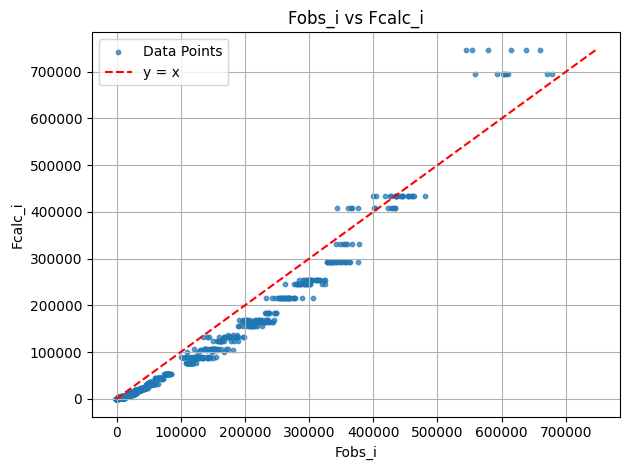

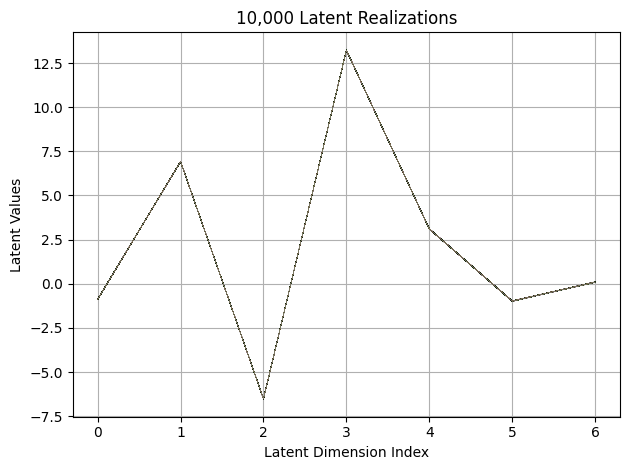

First 10 latent vectors from the VAE:
Sample 1: [-0.8825621604919434, 6.921015739440918, -6.508958339691162, 13.230951309204102, 3.1046838760375977, -0.9945290088653564, 0.08485341817140579]
Sample 2: [-0.8838415741920471, 6.930300235748291, -6.509094715118408, 13.232236862182617, 3.115297794342041, -0.9936856031417847, 0.09259896725416183]
Sample 3: [-0.8784119486808777, 6.917031288146973, -6.51654052734375, 13.231584548950195, 3.08638334274292, -0.9877854585647583, 0.08603444695472717]
Sample 4: [-0.8773267269134521, 6.919960975646973, -6.528422832489014, 13.221336364746094, 3.118617296218872, -0.9714495539665222, 0.08614245057106018]
Sample 5: [-0.8881785869598389, 6.924498081207275, -6.523280143737793, 13.2224702835083, 3.11208438873291, -0.9706107974052429, 0.0965179055929184]
Sample 6: [-0.8995527625083923, 6.9171648025512695, -6.514592170715332, 13.221307754516602, 3.0943775177001953, -0.9803464412689209, 0.09039439260959625]
Sample 7: [-0.8877967000007629, 6.933185577392578, -6

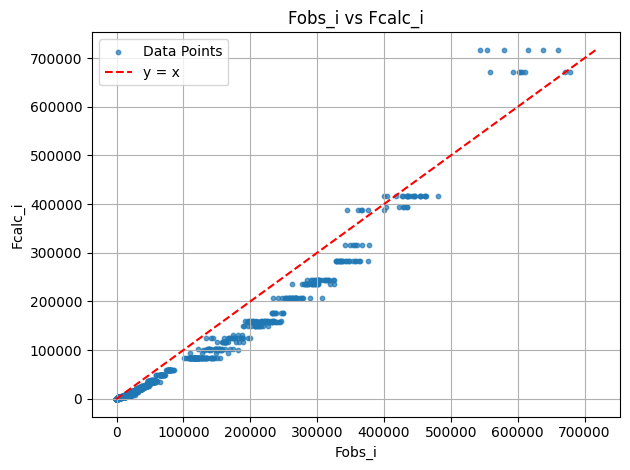

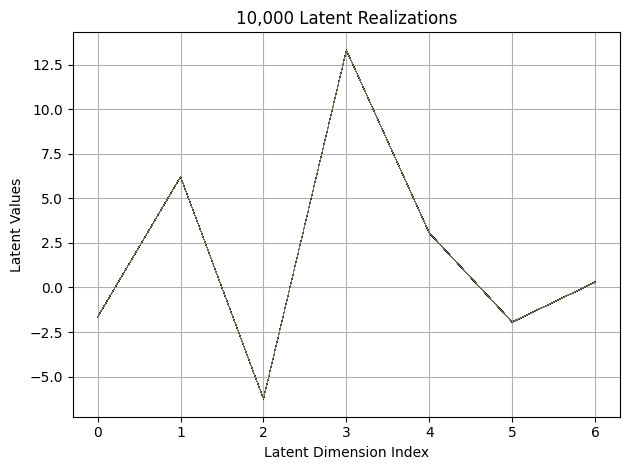

First 10 latent vectors from the VAE:
Sample 1: [-1.6428593397140503, 6.1853814125061035, -6.245461463928223, 13.307595252990723, 3.0581555366516113, -1.9382253885269165, 0.29670149087905884]
Sample 2: [-1.6526904106140137, 6.20601224899292, -6.243334770202637, 13.317998886108398, 3.0493931770324707, -1.9340945482254028, 0.2942858636379242]
Sample 3: [-1.6682292222976685, 6.194962978363037, -6.238924026489258, 13.32038402557373, 3.049764394760132, -1.9369983673095703, 0.2983953654766083]
Sample 4: [-1.6546378135681152, 6.210442066192627, -6.250148773193359, 13.317399024963379, 3.0633106231689453, -1.9397817850112915, 0.29227104783058167]
Sample 5: [-1.6587014198303223, 6.2063188552856445, -6.243745803833008, 13.303384780883789, 3.058288812637329, -1.9520535469055176, 0.29948461055755615]
Sample 6: [-1.6509873867034912, 6.1996612548828125, -6.240853786468506, 13.29748249053955, 3.0596024990081787, -1.9442410469055176, 0.2969221770763397]
Sample 7: [-1.6489167213439941, 6.191758632659912

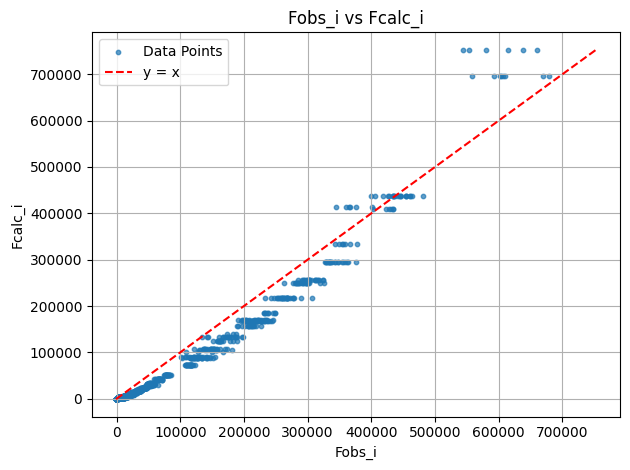

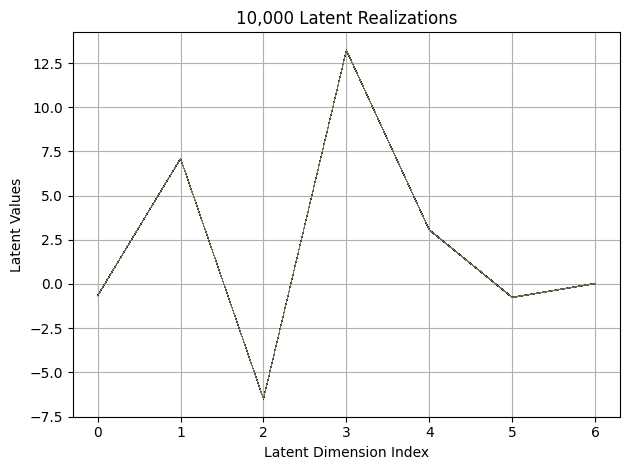

First 10 latent vectors from the VAE:
Sample 1: [-0.6616024374961853, 7.1003642082214355, -6.49664831161499, 13.22629451751709, 3.0603513717651367, -0.7670276165008545, 0.032940108329057693]
Sample 2: [-0.6640383005142212, 7.100245475769043, -6.48824405670166, 13.232176780700684, 3.065650224685669, -0.7606074213981628, 0.021843472495675087]
Sample 3: [-0.6681301593780518, 7.088298320770264, -6.498013973236084, 13.222025871276855, 3.0502657890319824, -0.7648743391036987, 0.026456667110323906]
Sample 4: [-0.6698451638221741, 7.1034770011901855, -6.499425888061523, 13.23257827758789, 3.058292865753174, -0.7518157362937927, 0.02795257419347763]
Sample 5: [-0.6453394293785095, 7.096004962921143, -6.494757652282715, 13.226449012756348, 3.056983470916748, -0.7570628523826599, 0.03272342309355736]
Sample 6: [-0.6503100991249084, 7.110105991363525, -6.4882121086120605, 13.215386390686035, 3.0726616382598877, -0.7651277780532837, 0.027441563084721565]
Sample 7: [-0.6606475114822388, 7.0884222984

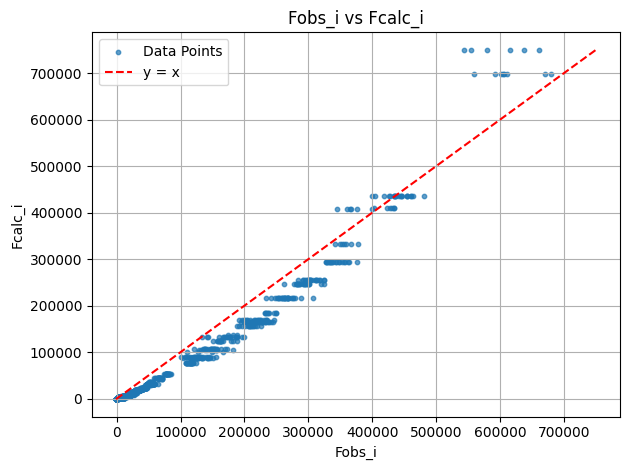

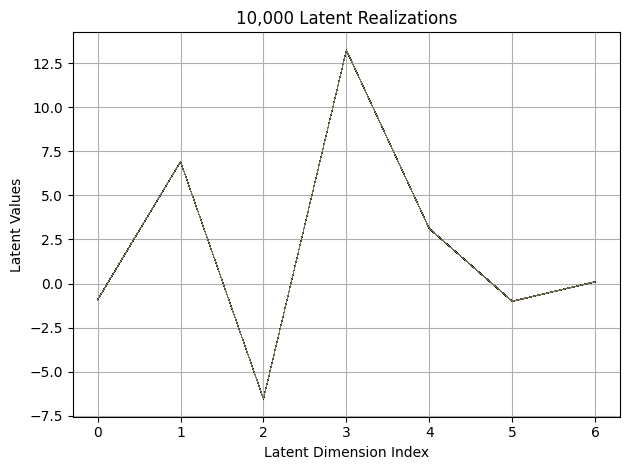

First 10 latent vectors from the VAE:
Sample 1: [-0.9008727073669434, 6.913883686065674, -6.525821208953857, 13.220867156982422, 3.1114838123321533, -1.0036097764968872, 0.09876424819231033]
Sample 2: [-0.9069921970367432, 6.911088943481445, -6.5248894691467285, 13.222662925720215, 3.1092281341552734, -1.0019904375076294, 0.09888454526662827]
Sample 3: [-0.9167126417160034, 6.896198272705078, -6.534233570098877, 13.221708297729492, 3.11006760597229, -1.0030866861343384, 0.08482174575328827]
Sample 4: [-0.9139061570167542, 6.907177925109863, -6.538084506988525, 13.217436790466309, 3.12070631980896, -0.9993165731430054, 0.08934206515550613]
Sample 5: [-0.9085222482681274, 6.908447742462158, -6.524835586547852, 13.219106674194336, 3.1271426677703857, -1.0035338401794434, 0.09330705553293228]
Sample 6: [-0.9077866077423096, 6.91860818862915, -6.525904178619385, 13.207441329956055, 3.118985891342163, -1.0013411045074463, 0.09498637169599533]
Sample 7: [-0.9034671187400818, 6.905517578125, -

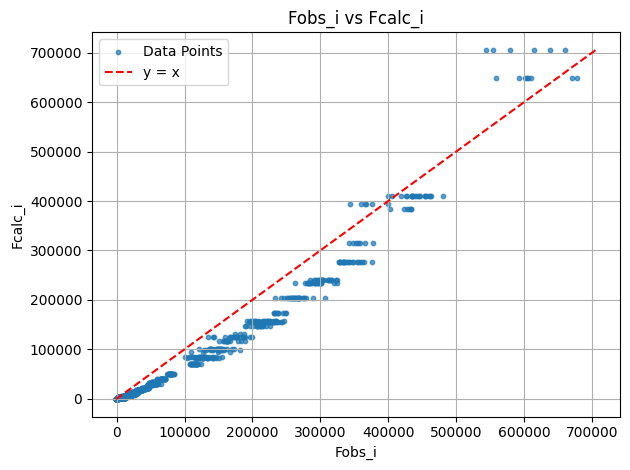

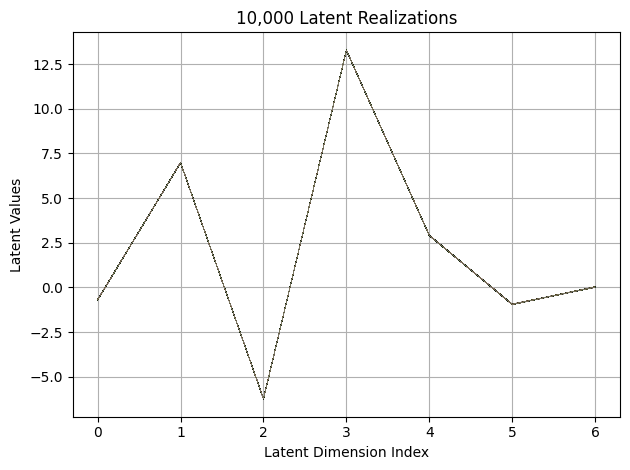

First 10 latent vectors from the VAE:
Sample 1: [-0.6846774816513062, 6.976288795471191, -6.231992244720459, 13.263506889343262, 2.905268907546997, -0.9437205195426941, 0.016432762145996094]
Sample 2: [-0.682960569858551, 6.978692531585693, -6.231031894683838, 13.278396606445312, 2.9137625694274902, -0.9514658451080322, 0.02035820670425892]
Sample 3: [-0.6930195689201355, 6.9748215675354, -6.238579750061035, 13.281417846679688, 2.9171993732452393, -0.9516324400901794, 0.017853599041700363]
Sample 4: [-0.7035004496574402, 6.971231937408447, -6.223855495452881, 13.283443450927734, 2.903383255004883, -0.9451236128807068, 0.031227387487888336]
Sample 5: [-0.6962546110153198, 6.977527141571045, -6.234635353088379, 13.274320602416992, 2.9008519649505615, -0.9416465163230896, 0.021498186513781548]
Sample 6: [-0.6989151239395142, 6.976478576660156, -6.231388092041016, 13.260258674621582, 2.906550884246826, -0.9508202075958252, 0.03220128268003464]
Sample 7: [-0.6779609322547913, 6.978177070617

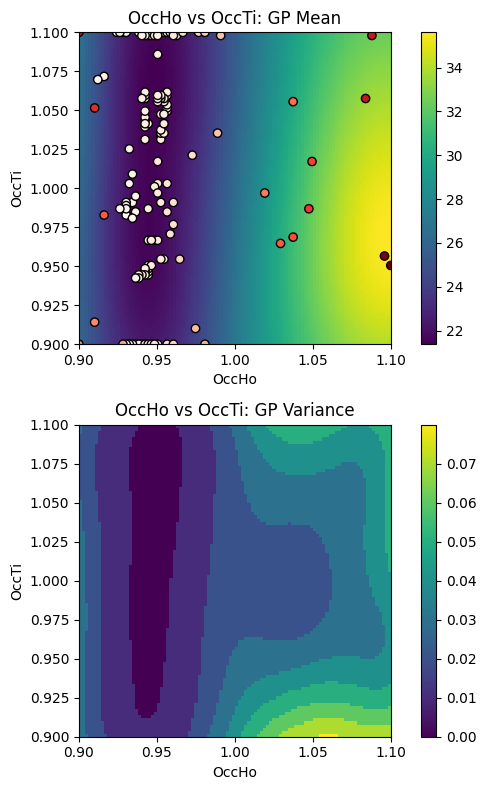

EI: [-1.00000000e+00  2.18226016e-03  2.15245411e-03 ...  8.33984814e-05
  1.00846635e-04  1.23917125e-04]
Function eval #140
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [1.0636364221572876, 0.9424242377281189]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7551
initial chi^2 1.9986e+05 with 2596 obs.
New scale: 0.7551
Cycle 0: 0.64s, Chi**2: 1.5572e+05 for 2596 obs., Lambda: 0,  Delta: 0.221, SVD=0
New scale: 0.7551
Maximum shift/esd = -53.59

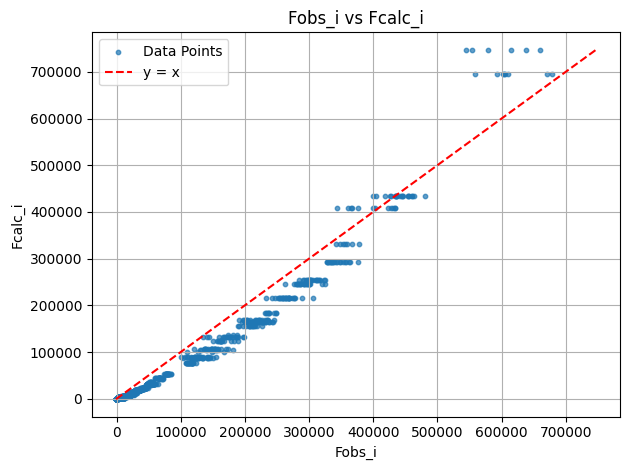

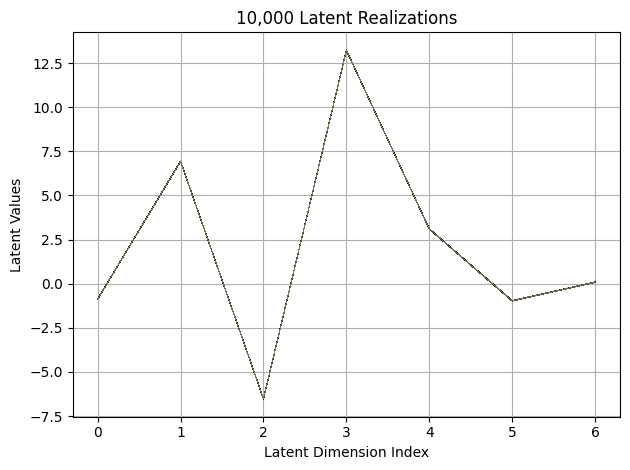

First 10 latent vectors from the VAE:
Sample 1: [-0.8672400712966919, 6.93625020980835, -6.531379699707031, 13.230330467224121, 3.0915496349334717, -0.9741644263267517, 0.09097467362880707]
Sample 2: [-0.8541213870048523, 6.9245991706848145, -6.527815341949463, 13.22615909576416, 3.0935142040252686, -0.9642693400382996, 0.08450096100568771]
Sample 3: [-0.8878447413444519, 6.933287143707275, -6.519931793212891, 13.220855712890625, 3.0979533195495605, -0.9741051197052002, 0.09039485454559326]
Sample 4: [-0.8611636161804199, 6.920253276824951, -6.52351188659668, 13.22362995147705, 3.111016035079956, -0.9634934067726135, 0.08379488438367844]
Sample 5: [-0.8816392421722412, 6.935957908630371, -6.509819507598877, 13.222047805786133, 3.0890889167785645, -0.9689823389053345, 0.08200298249721527]
Sample 6: [-0.8772633075714111, 6.9289679527282715, -6.53058385848999, 13.232983589172363, 3.1076738834381104, -0.9742394685745239, 0.07948353886604309]
Sample 7: [-0.8697390556335449, 6.93905258178710

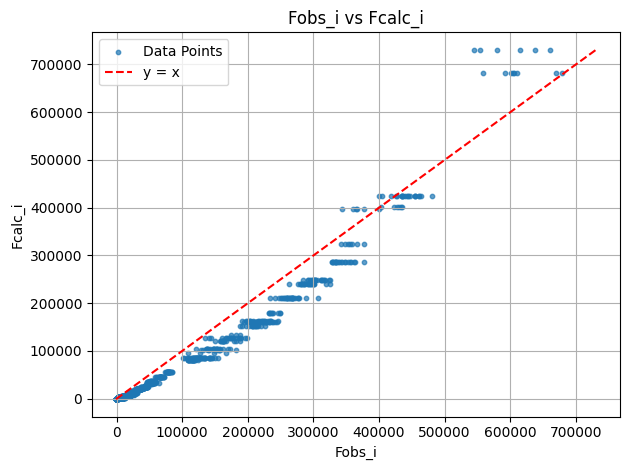

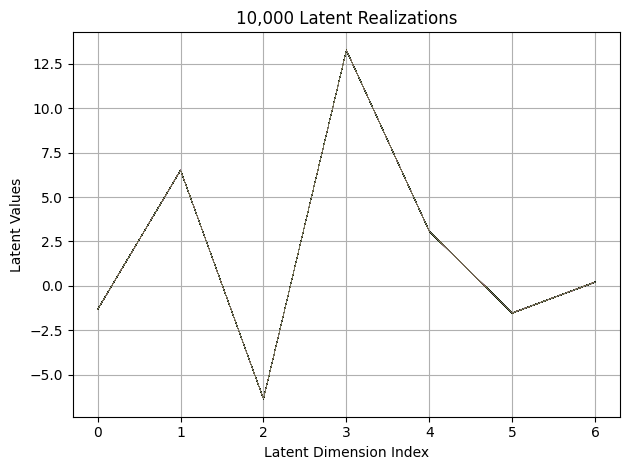

First 10 latent vectors from the VAE:
Sample 1: [-1.328961730003357, 6.50767707824707, -6.352950096130371, 13.279226303100586, 3.0686824321746826, -1.5377047061920166, 0.18784576654434204]
Sample 2: [-1.324724793434143, 6.518937587738037, -6.354687690734863, 13.277122497558594, 3.073416233062744, -1.5137765407562256, 0.21074728667736053]
Sample 3: [-1.3258672952651978, 6.520356178283691, -6.35464334487915, 13.276769638061523, 3.072157621383667, -1.5316483974456787, 0.2142431139945984]
Sample 4: [-1.3183192014694214, 6.5137457847595215, -6.369081020355225, 13.27143383026123, 3.076941967010498, -1.5327131748199463, 0.21379804611206055]
Sample 5: [-1.332433819770813, 6.509749889373779, -6.363908767700195, 13.27761459350586, 3.0793259143829346, -1.5226303339004517, 0.2058984637260437]
Sample 6: [-1.3283241987228394, 6.509200096130371, -6.351041316986084, 13.281634330749512, 3.085636854171753, -1.5287643671035767, 0.20873159170150757]
Sample 7: [-1.3335342407226562, 6.509843349456787, -6.36

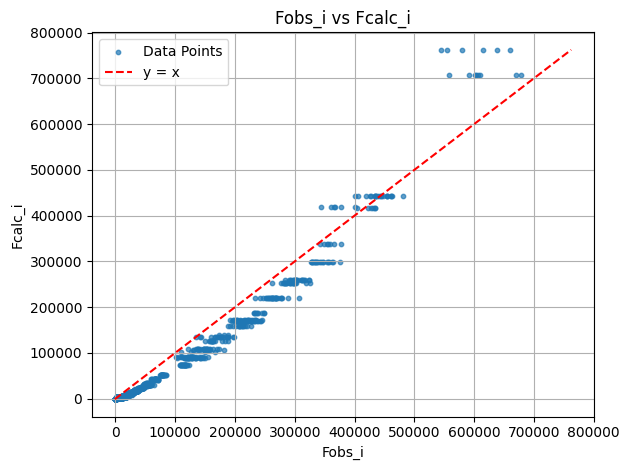

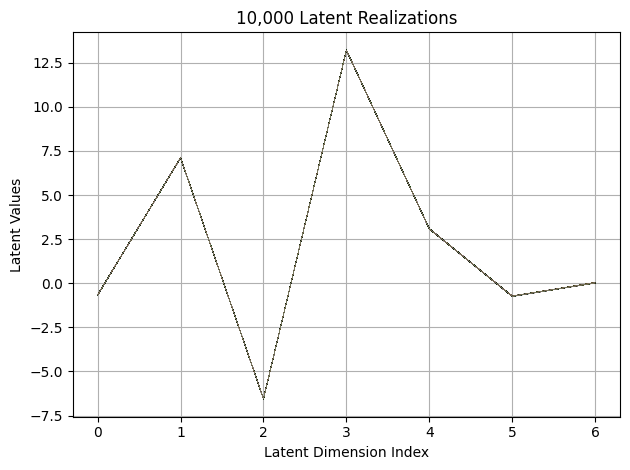

First 10 latent vectors from the VAE:
Sample 1: [-0.6544005274772644, 7.123678207397461, -6.544334411621094, 13.210390090942383, 3.081794500350952, -0.7466809153556824, 0.01861666515469551]
Sample 2: [-0.6558698415756226, 7.119007587432861, -6.556369304656982, 13.213410377502441, 3.0892157554626465, -0.7389821410179138, 0.020062971860170364]
Sample 3: [-0.6492542624473572, 7.1091156005859375, -6.552853107452393, 13.21466064453125, 3.0860719680786133, -0.72730553150177, 0.04095048829913139]
Sample 4: [-0.672288715839386, 7.113202095031738, -6.55119514465332, 13.221306800842285, 3.082946538925171, -0.7336174249649048, 0.03160815313458443]
Sample 5: [-0.6591669321060181, 7.11421537399292, -6.5431365966796875, 13.218414306640625, 3.0778799057006836, -0.7375069856643677, 0.03701505810022354]
Sample 6: [-0.6683076024055481, 7.123619079589844, -6.547106742858887, 13.234040260314941, 3.082137107849121, -0.7496328353881836, 0.027881283313035965]
Sample 7: [-0.6697503328323364, 7.102512359619141

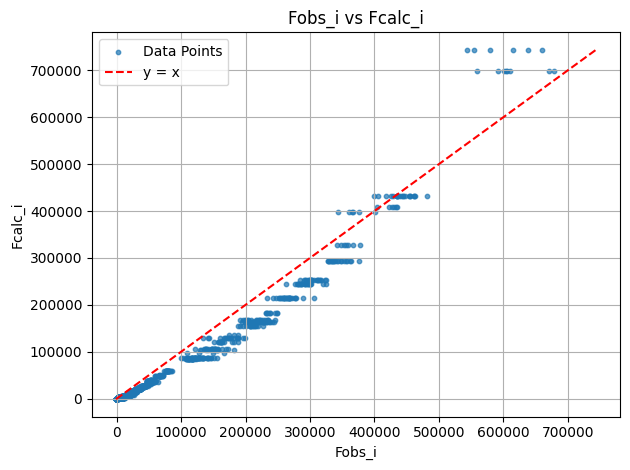

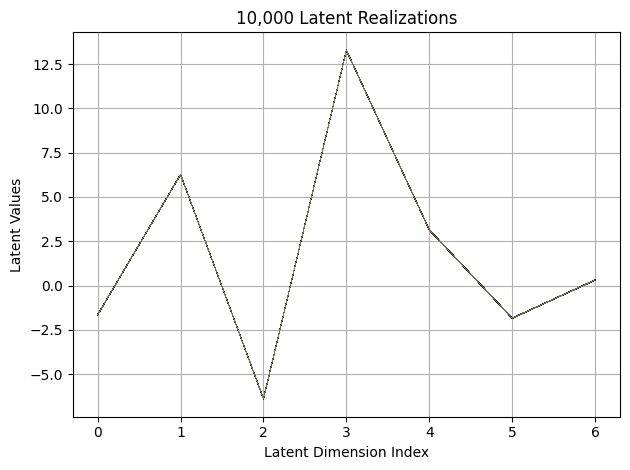

First 10 latent vectors from the VAE:
Sample 1: [-1.6613123416900635, 6.261779308319092, -6.389754295349121, 13.281851768493652, 3.143953323364258, -1.8310691118240356, 0.30102911591529846]
Sample 2: [-1.6568642854690552, 6.27224588394165, -6.387818813323975, 13.286799430847168, 3.1515157222747803, -1.8502147197723389, 0.3101438283920288]
Sample 3: [-1.657710075378418, 6.281161308288574, -6.388979434967041, 13.284717559814453, 3.1400392055511475, -1.8395124673843384, 0.313554972410202]
Sample 4: [-1.654005527496338, 6.272557258605957, -6.384677410125732, 13.279175758361816, 3.1436867713928223, -1.841496229171753, 0.30667567253112793]
Sample 5: [-1.64492928981781, 6.268424987792969, -6.38222074508667, 13.280198097229004, 3.1394691467285156, -1.8442726135253906, 0.30344709753990173]
Sample 6: [-1.6527432203292847, 6.272385120391846, -6.392337322235107, 13.27029800415039, 3.142286777496338, -1.8443753719329834, 0.3087245225906372]
Sample 7: [-1.6470414400100708, 6.272462368011475, -6.3898

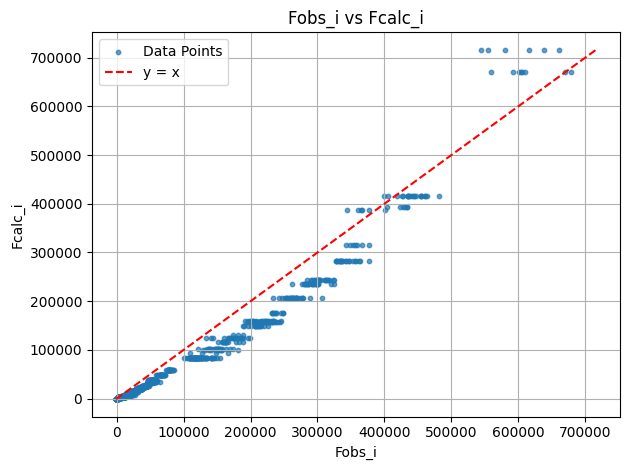

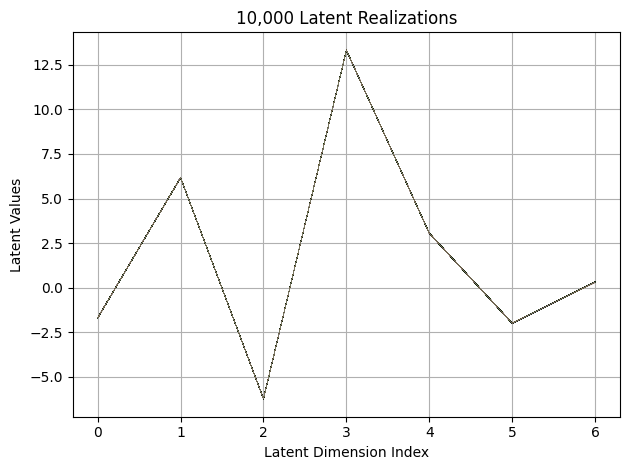

First 10 latent vectors from the VAE:
Sample 1: [-1.6887620687484741, 6.186370849609375, -6.236482620239258, 13.306427001953125, 3.050511121749878, -1.9978569746017456, 0.31539681553840637]
Sample 2: [-1.6852936744689941, 6.175347328186035, -6.231071949005127, 13.304115295410156, 3.0564491748809814, -1.99942946434021, 0.323275089263916]
Sample 3: [-1.6956233978271484, 6.170428276062012, -6.229686260223389, 13.293502807617188, 3.0539517402648926, -1.9918148517608643, 0.3151346743106842]
Sample 4: [-1.693083643913269, 6.168483257293701, -6.221804618835449, 13.301887512207031, 3.049888849258423, -1.9818041324615479, 0.31288108229637146]
Sample 5: [-1.687590479850769, 6.171141624450684, -6.228540897369385, 13.303038597106934, 3.042102336883545, -1.9861880540847778, 0.3042478859424591]
Sample 6: [-1.6836600303649902, 6.16990327835083, -6.226202011108398, 13.322187423706055, 3.054295778274536, -1.9899150133132935, 0.31711459159851074]
Sample 7: [-1.7086515426635742, 6.171707630157471, -6.221

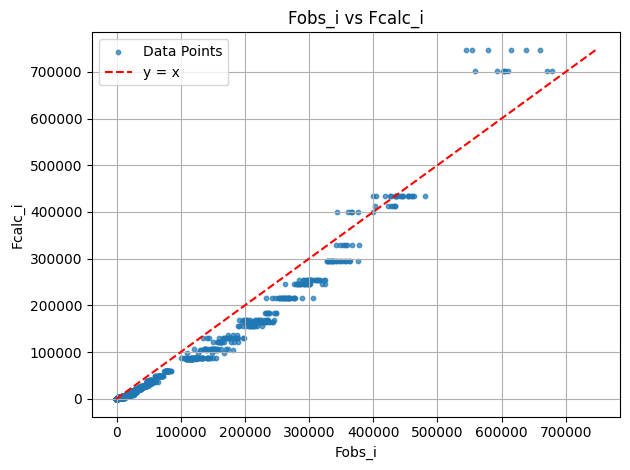

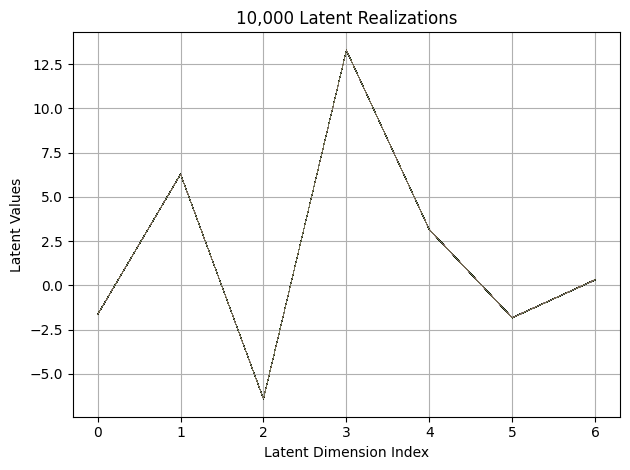

First 10 latent vectors from the VAE:
Sample 1: [-1.6323994398117065, 6.281365394592285, -6.4097981452941895, 13.276689529418945, 3.1553075313568115, -1.8253016471862793, 0.31620365381240845]
Sample 2: [-1.656121015548706, 6.274315357208252, -6.401633262634277, 13.284382820129395, 3.1460068225860596, -1.8384705781936646, 0.31851693987846375]
Sample 3: [-1.6633944511413574, 6.276001930236816, -6.4122209548950195, 13.260293006896973, 3.1432626247406006, -1.8303818702697754, 0.3121940493583679]
Sample 4: [-1.6335148811340332, 6.273837566375732, -6.414205074310303, 13.281725883483887, 3.1563773155212402, -1.8313260078430176, 0.31053242087364197]
Sample 5: [-1.6521984338760376, 6.283113479614258, -6.40756893157959, 13.272244453430176, 3.1460769176483154, -1.8231348991394043, 0.31618550419807434]
Sample 6: [-1.6506518125534058, 6.273281097412109, -6.40206241607666, 13.269343376159668, 3.160762071609497, -1.818528652191162, 0.30690738558769226]
Sample 7: [-1.655863642692566, 6.280776500701904

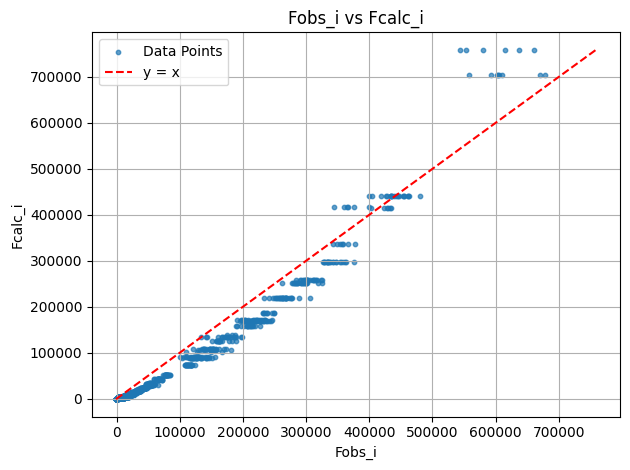

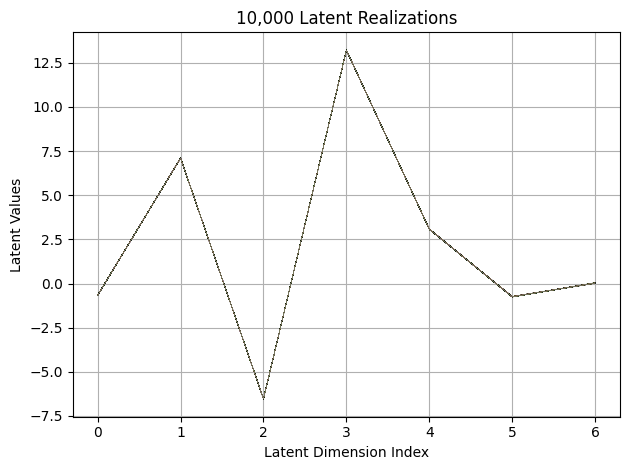

First 10 latent vectors from the VAE:
Sample 1: [-0.6626896858215332, 7.103945255279541, -6.533407688140869, 13.22293472290039, 3.075343132019043, -0.7483997941017151, 0.044060759246349335]
Sample 2: [-0.6621840000152588, 7.108406066894531, -6.534250736236572, 13.219443321228027, 3.073528528213501, -0.7484267354011536, 0.023759642615914345]
Sample 3: [-0.658862829208374, 7.106461524963379, -6.534184455871582, 13.215190887451172, 3.0863168239593506, -0.7523710131645203, 0.03551006689667702]
Sample 4: [-0.66351717710495, 7.101573467254639, -6.530057907104492, 13.220433235168457, 3.096357583999634, -0.7467244267463684, 0.02801353484392166]
Sample 5: [-0.664234459400177, 7.10806941986084, -6.532020092010498, 13.214066505432129, 3.0817689895629883, -0.7522684335708618, 0.0133523503318429]
Sample 6: [-0.6581325531005859, 7.108268737792969, -6.534577369689941, 13.223602294921875, 3.0765349864959717, -0.7472668290138245, 0.021889368072152138]
Sample 7: [-0.6647999882698059, 7.104595184326172, 

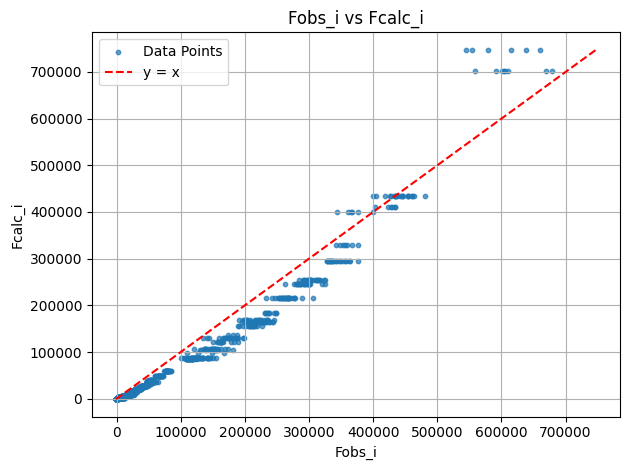

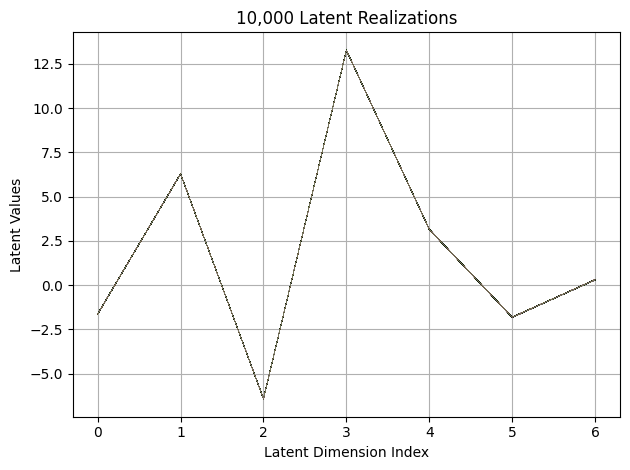

First 10 latent vectors from the VAE:
Sample 1: [-1.641559362411499, 6.275088310241699, -6.414636135101318, 13.2618408203125, 3.1559765338897705, -1.8104748725891113, 0.31066155433654785]
Sample 2: [-1.628216028213501, 6.292377471923828, -6.406276226043701, 13.280220985412598, 3.1574509143829346, -1.814077615737915, 0.3087799549102783]
Sample 3: [-1.6255029439926147, 6.298619747161865, -6.412539958953857, 13.266693115234375, 3.137672185897827, -1.7973679304122925, 0.3112637996673584]
Sample 4: [-1.6241267919540405, 6.29833459854126, -6.426375865936279, 13.283945083618164, 3.146977424621582, -1.8048299551010132, 0.30220574140548706]
Sample 5: [-1.6308567523956299, 6.28165864944458, -6.418692588806152, 13.276910781860352, 3.158869743347168, -1.8134452104568481, 0.3084627091884613]
Sample 6: [-1.6238337755203247, 6.295104503631592, -6.402082443237305, 13.294593811035156, 3.142869234085083, -1.821873426437378, 0.30990079045295715]
Sample 7: [-1.6379244327545166, 6.291037559509277, -6.40893

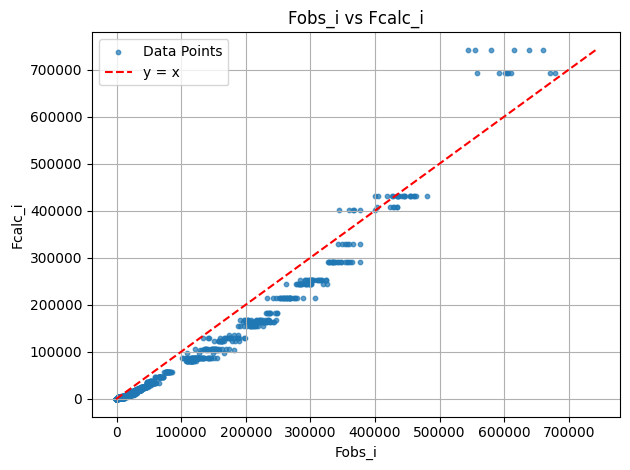

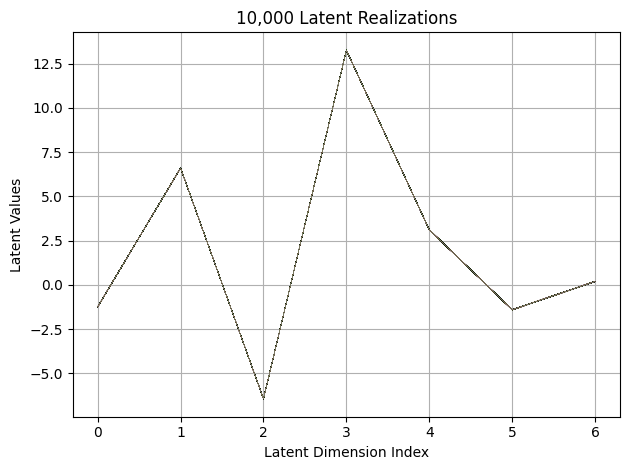

First 10 latent vectors from the VAE:
Sample 1: [-1.250383734703064, 6.6004319190979, -6.434881687164307, 13.259157180786133, 3.111485004425049, -1.399452805519104, 0.18885326385498047]
Sample 2: [-1.2489557266235352, 6.605504035949707, -6.433592319488525, 13.261295318603516, 3.11242938041687, -1.4075933694839478, 0.1703118532896042]
Sample 3: [-1.2460815906524658, 6.603566646575928, -6.445685386657715, 13.243220329284668, 3.114640712738037, -1.4001797437667847, 0.18476997315883636]
Sample 4: [-1.2568950653076172, 6.5970778465271, -6.438173294067383, 13.238761901855469, 3.1104466915130615, -1.4064589738845825, 0.20427633821964264]
Sample 5: [-1.2389882802963257, 6.5970635414123535, -6.439531326293945, 13.253278732299805, 3.112502336502075, -1.3958557844161987, 0.19891053438186646]
Sample 6: [-1.251878261566162, 6.599645614624023, -6.430631637573242, 13.26443862915039, 3.1139585971832275, -1.39262855052948, 0.18964992463588715]
Sample 7: [-1.2504856586456299, 6.587778091430664, -6.43382

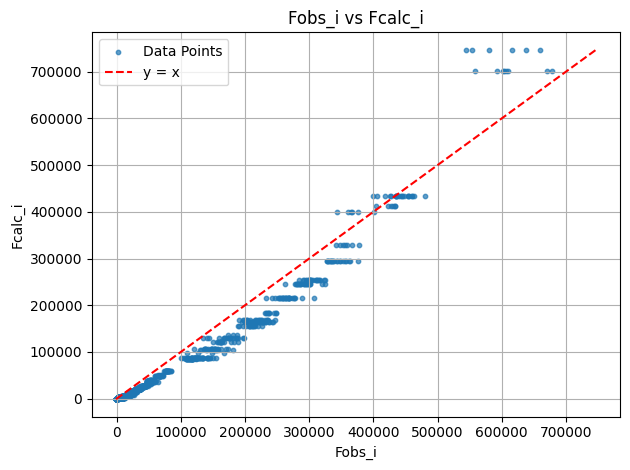

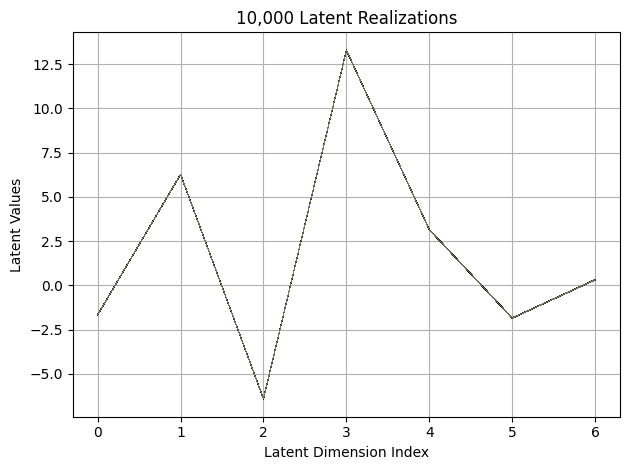

First 10 latent vectors from the VAE:
Sample 1: [-1.6617220640182495, 6.267533779144287, -6.406135082244873, 13.2770414352417, 3.141392230987549, -1.8466752767562866, 0.3190467059612274]
Sample 2: [-1.661376953125, 6.259646892547607, -6.4063639640808105, 13.277132987976074, 3.1559605598449707, -1.8423380851745605, 0.3215652406215668]
Sample 3: [-1.6579594612121582, 6.275699615478516, -6.4039716720581055, 13.274516105651855, 3.151426315307617, -1.8353798389434814, 0.30824336409568787]
Sample 4: [-1.6445822715759277, 6.276818752288818, -6.404658317565918, 13.277503967285156, 3.145972490310669, -1.8390753269195557, 0.3098871111869812]
Sample 5: [-1.6719633340835571, 6.266700744628906, -6.403282165527344, 13.283177375793457, 3.153347969055176, -1.8424276113510132, 0.33252567052841187]
Sample 6: [-1.6676944494247437, 6.2638092041015625, -6.396806716918945, 13.262845993041992, 3.1484713554382324, -1.8563843965530396, 0.3066050112247467]
Sample 7: [-1.6689954996109009, 6.2689924240112305, -6.

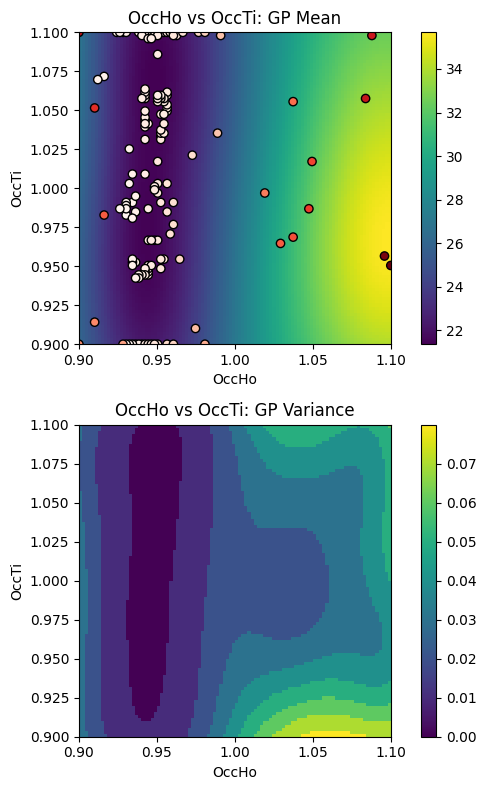

EI: [-1.00000000e+00  2.35941727e-03  2.32847314e-03 ...  9.28233494e-05
  1.12351612e-04  1.38212345e-04]
Function eval #150
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [0.9505050182342529, 0.9363636374473572]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7810
initial chi^2 1.4919e+05 with 2596 obs.
New scale: 0.7810
Cycle 0: 0.64s, Chi**2: 1.1316e+05 for 2596 obs., Lambda: 0,  Delta: 0.242, SVD=0
New scale: 0.7810
Maximum shift/esd = -53.72

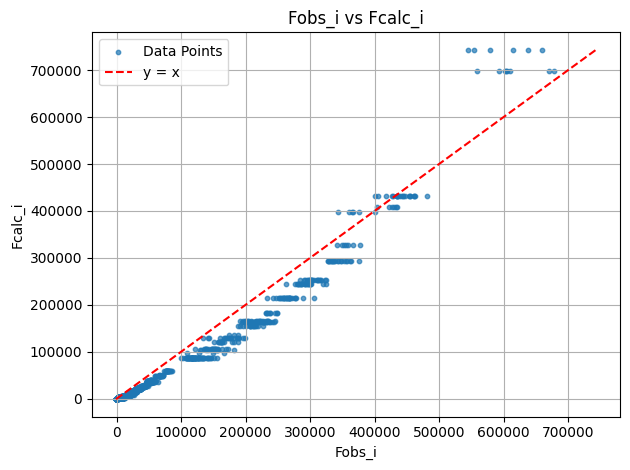

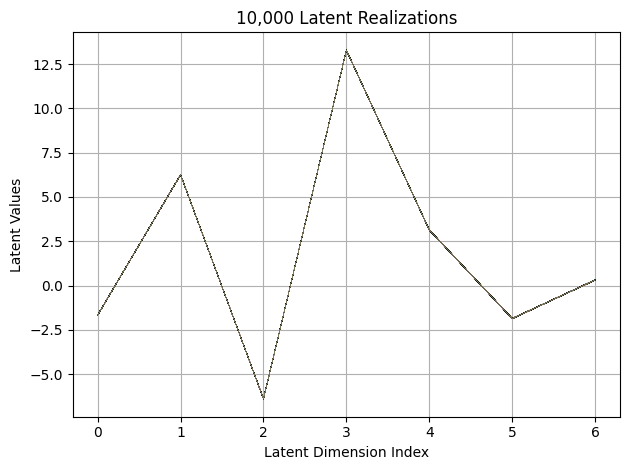

First 10 latent vectors from the VAE:
Sample 1: [-1.6737046241760254, 6.248049259185791, -6.388628005981445, 13.272632598876953, 3.12734317779541, -1.8693923950195312, 0.317234069108963]
Sample 2: [-1.660322666168213, 6.261135101318359, -6.387197971343994, 13.278162956237793, 3.158540725708008, -1.8636399507522583, 0.3244495391845703]
Sample 3: [-1.67902410030365, 6.25224494934082, -6.374943256378174, 13.27256965637207, 3.1427438259124756, -1.8572118282318115, 0.31361958384513855]
Sample 4: [-1.6676064729690552, 6.249061584472656, -6.380765914916992, 13.285484313964844, 3.1490724086761475, -1.8493337631225586, 0.3188450038433075]
Sample 5: [-1.6616853475570679, 6.264470100402832, -6.379875183105469, 13.284708976745605, 3.149925708770752, -1.8603730201721191, 0.32677412033081055]
Sample 6: [-1.6554253101348877, 6.2568864822387695, -6.379857063293457, 13.279435157775879, 3.133944511413574, -1.854095697402954, 0.3077998757362366]
Sample 7: [-1.664588451385498, 6.26631498336792, -6.3806533

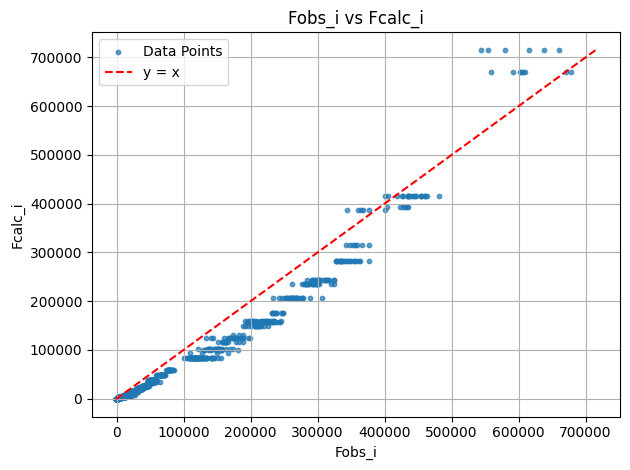

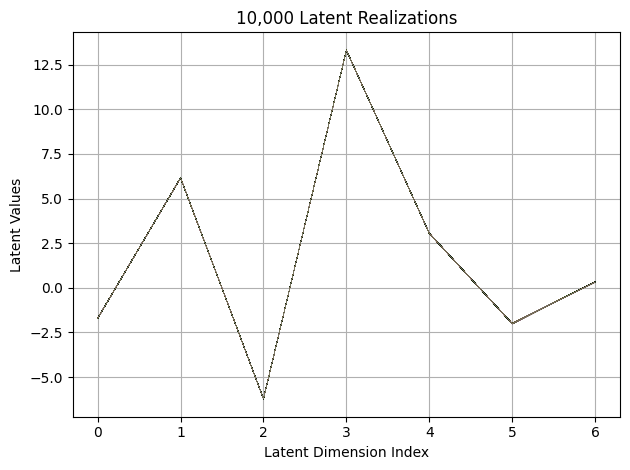

First 10 latent vectors from the VAE:
Sample 1: [-1.7215821743011475, 6.158268928527832, -6.2099199295043945, 13.299468994140625, 3.0505330562591553, -2.0139594078063965, 0.31125253438949585]
Sample 2: [-1.7145321369171143, 6.164538860321045, -6.224420070648193, 13.312825202941895, 3.0450642108917236, -2.0033750534057617, 0.3218589425086975]
Sample 3: [-1.715044617652893, 6.155508995056152, -6.206594467163086, 13.317282676696777, 3.0517418384552, -2.0109505653381348, 0.33093389868736267]
Sample 4: [-1.7199561595916748, 6.176015377044678, -6.2072954177856445, 13.313464164733887, 3.058750629425049, -2.0121724605560303, 0.314479261636734]
Sample 5: [-1.7028017044067383, 6.151630878448486, -6.2255330085754395, 13.307703971862793, 3.057694911956787, -2.0153353214263916, 0.314949631690979]
Sample 6: [-1.7140896320343018, 6.154717445373535, -6.218967914581299, 13.318962097167969, 3.0462400913238525, -2.002908706665039, 0.3075476884841919]
Sample 7: [-1.7090375423431396, 6.149672985076904, -6.

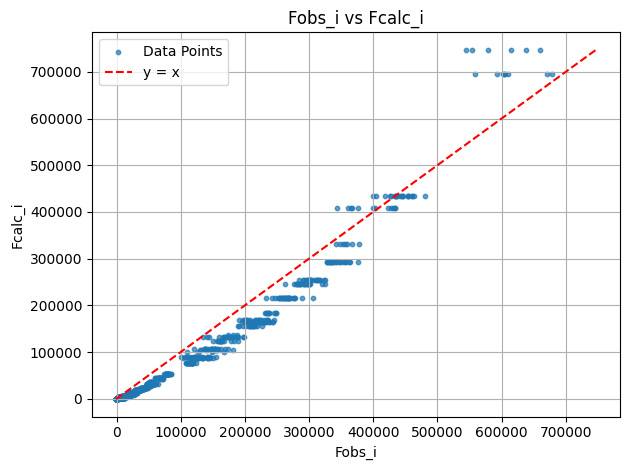

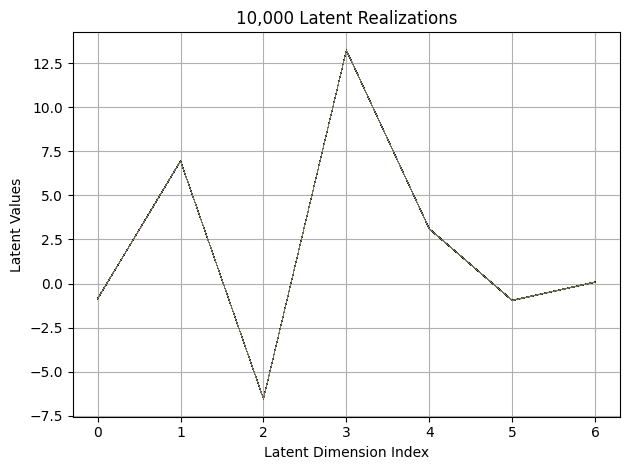

First 10 latent vectors from the VAE:
Sample 1: [-0.8581628203392029, 6.945634841918945, -6.531838893890381, 13.229533195495605, 3.0998029708862305, -0.955747663974762, 0.07128752768039703]
Sample 2: [-0.8456356525421143, 6.959439754486084, -6.523011684417725, 13.220181465148926, 3.108365535736084, -0.947127640247345, 0.08357805758714676]
Sample 3: [-0.8619645237922668, 6.949443817138672, -6.519067764282227, 13.226938247680664, 3.097252607345581, -0.942303478717804, 0.08891545981168747]
Sample 4: [-0.8546543121337891, 6.940814018249512, -6.501435279846191, 13.227611541748047, 3.1054069995880127, -0.9460092782974243, 0.08551494032144547]
Sample 5: [-0.8636542558670044, 6.93946647644043, -6.526027202606201, 13.22662353515625, 3.0984113216400146, -0.9457337856292725, 0.0951034426689148]
Sample 6: [-0.8635101318359375, 6.949193000793457, -6.52448844909668, 13.236661911010742, 3.1045620441436768, -0.9507723450660706, 0.08697212487459183]
Sample 7: [-0.849018394947052, 6.949902534484863, -6.

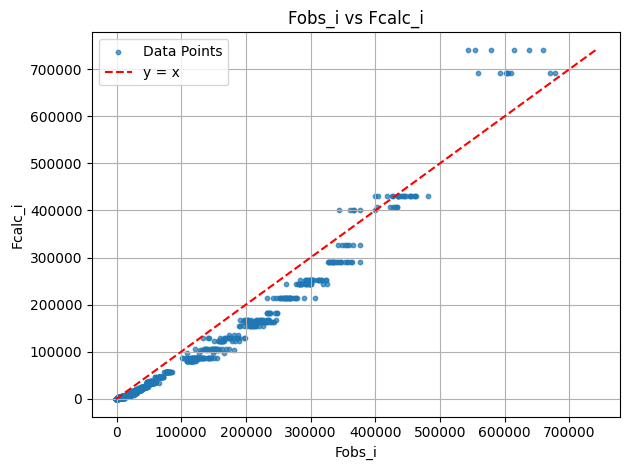

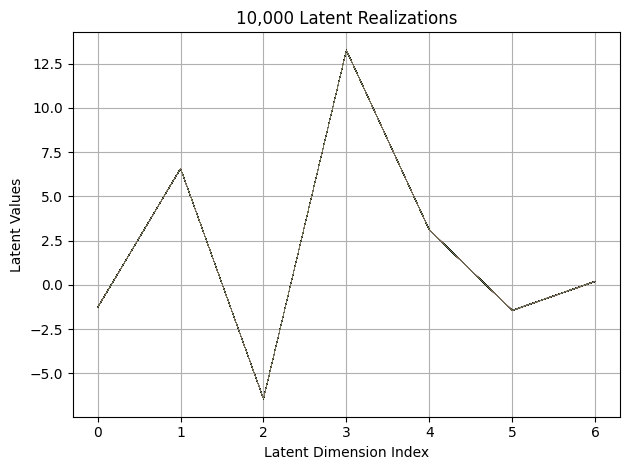

First 10 latent vectors from the VAE:
Sample 1: [-1.2659063339233398, 6.58146333694458, -6.421642780303955, 13.256002426147461, 3.116344928741455, -1.4297995567321777, 0.20369453728199005]
Sample 2: [-1.290831208229065, 6.570169448852539, -6.4301981925964355, 13.253133773803711, 3.108454704284668, -1.4413440227508545, 0.2141403704881668]
Sample 3: [-1.2851108312606812, 6.581452369689941, -6.427459239959717, 13.26225471496582, 3.1164662837982178, -1.44260573387146, 0.20370587706565857]
Sample 4: [-1.2840771675109863, 6.580216407775879, -6.429255962371826, 13.257336616516113, 3.1129508018493652, -1.4378098249435425, 0.1964900940656662]
Sample 5: [-1.2748358249664307, 6.575416564941406, -6.433238506317139, 13.258591651916504, 3.1137142181396484, -1.4249199628829956, 0.19930580258369446]
Sample 6: [-1.283477783203125, 6.574618339538574, -6.430031776428223, 13.261998176574707, 3.0994017124176025, -1.4514029026031494, 0.20651711523532867]
Sample 7: [-1.282405972480774, 6.575804710388184, -6.

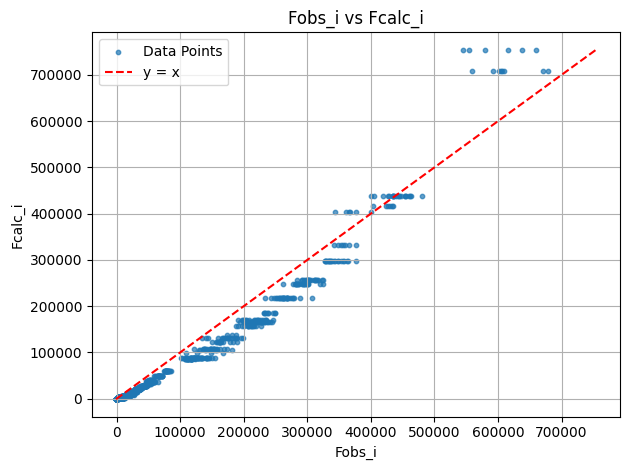

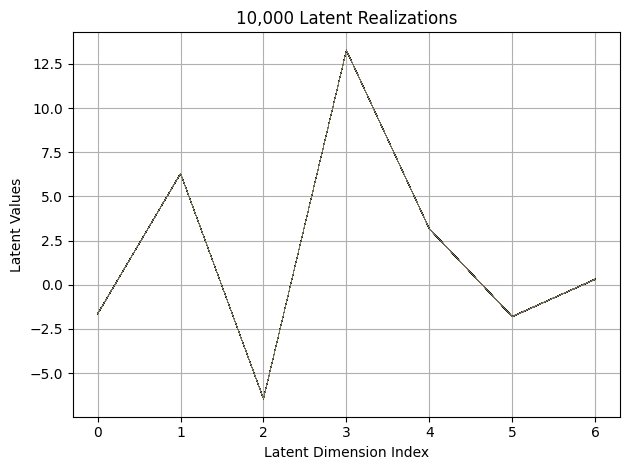

First 10 latent vectors from the VAE:
Sample 1: [-1.640170931816101, 6.304312229156494, -6.449124813079834, 13.27355670928955, 3.1773738861083984, -1.8065537214279175, 0.3190026581287384]
Sample 2: [-1.644682765007019, 6.30486536026001, -6.442233562469482, 13.26873779296875, 3.186060667037964, -1.7941755056381226, 0.30820783972740173]
Sample 3: [-1.6428630352020264, 6.29792594909668, -6.44014310836792, 13.266701698303223, 3.1663103103637695, -1.8021560907363892, 0.31214606761932373]
Sample 4: [-1.6440908908843994, 6.3030219078063965, -6.44923734664917, 13.267393112182617, 3.1588001251220703, -1.7980564832687378, 0.32524850964546204]
Sample 5: [-1.6458591222763062, 6.297482013702393, -6.4542341232299805, 13.278843879699707, 3.174304723739624, -1.796383261680603, 0.3338460922241211]
Sample 6: [-1.6389079093933105, 6.300594329833984, -6.449244022369385, 13.260464668273926, 3.1662588119506836, -1.7976136207580566, 0.31222569942474365]
Sample 7: [-1.6357775926589966, 6.292726993560791, -6.4

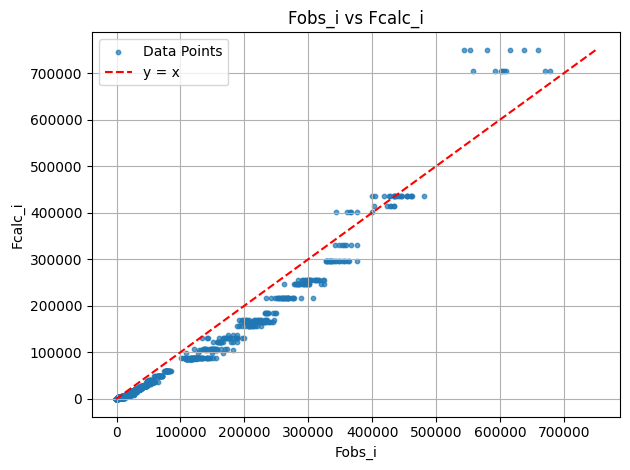

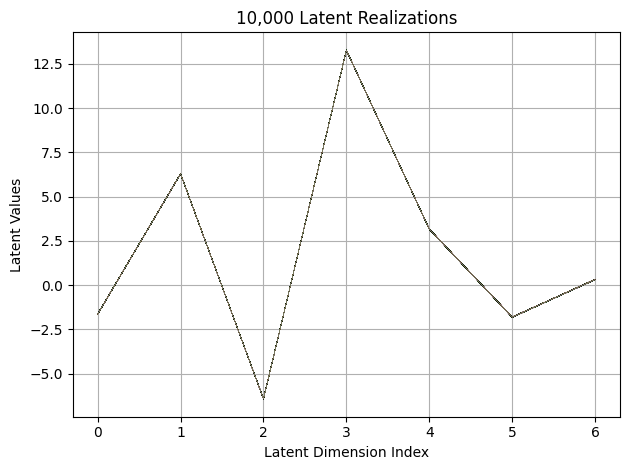

First 10 latent vectors from the VAE:
Sample 1: [-1.6391568183898926, 6.289029598236084, -6.431135177612305, 13.272780418395996, 3.167318820953369, -1.822998285293579, 0.3171963393688202]
Sample 2: [-1.64827299118042, 6.301520824432373, -6.431436061859131, 13.267367362976074, 3.1556336879730225, -1.812968373298645, 0.29847270250320435]
Sample 3: [-1.6431467533111572, 6.288509845733643, -6.430866241455078, 13.265358924865723, 3.161853790283203, -1.7995675802230835, 0.296266108751297]
Sample 4: [-1.6361392736434937, 6.283198356628418, -6.4249653816223145, 13.267380714416504, 3.1613235473632812, -1.818562626838684, 0.3069498836994171]
Sample 5: [-1.663460373878479, 6.285768985748291, -6.440614223480225, 13.279200553894043, 3.1581907272338867, -1.8255596160888672, 0.3054720461368561]
Sample 6: [-1.6349852085113525, 6.283621788024902, -6.425240993499756, 13.277159690856934, 3.1495916843414307, -1.8219035863876343, 0.3117566406726837]
Sample 7: [-1.6508383750915527, 6.287534236907959, -6.418

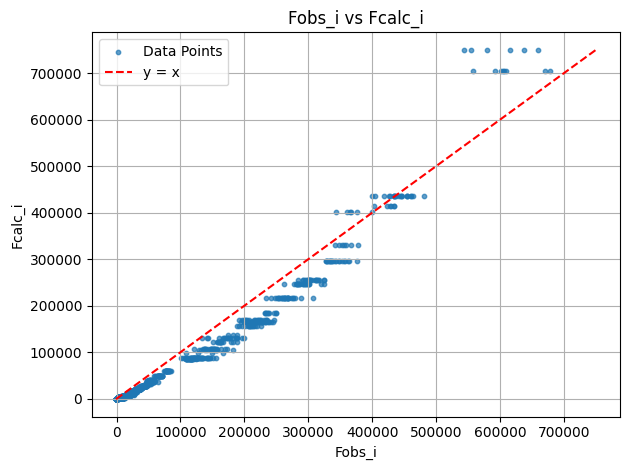

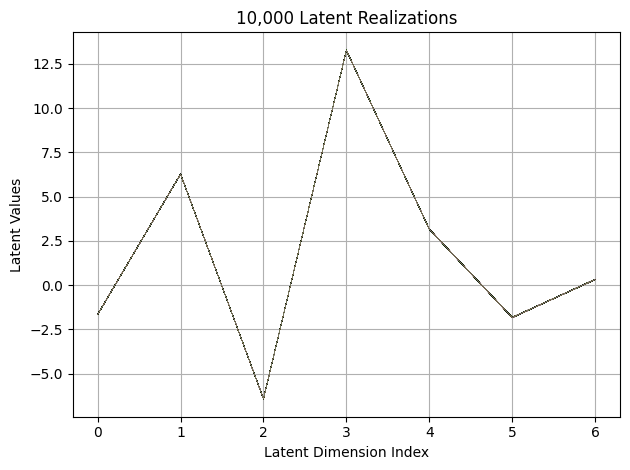

First 10 latent vectors from the VAE:
Sample 1: [-1.6528728008270264, 6.282057285308838, -6.433611869812012, 13.2710542678833, 3.1543350219726562, -1.8365470170974731, 0.3165811598300934]
Sample 2: [-1.6495672464370728, 6.274332046508789, -6.428915023803711, 13.269560813903809, 3.164515733718872, -1.8454581499099731, 0.3244260847568512]
Sample 3: [-1.6517168283462524, 6.277105808258057, -6.424952983856201, 13.278653144836426, 3.1667532920837402, -1.8233569860458374, 0.3224673867225647]
Sample 4: [-1.6556986570358276, 6.26715087890625, -6.416219711303711, 13.27046012878418, 3.170574188232422, -1.8280272483825684, 0.31493619084358215]
Sample 5: [-1.6634974479675293, 6.269802570343018, -6.431934356689453, 13.269477844238281, 3.160048484802246, -1.828894019126892, 0.3092392683029175]
Sample 6: [-1.6627532243728638, 6.275357723236084, -6.421882629394531, 13.269857406616211, 3.1586484909057617, -1.8207530975341797, 0.31315284967422485]
Sample 7: [-1.675713300704956, 6.283080101013184, -6.415

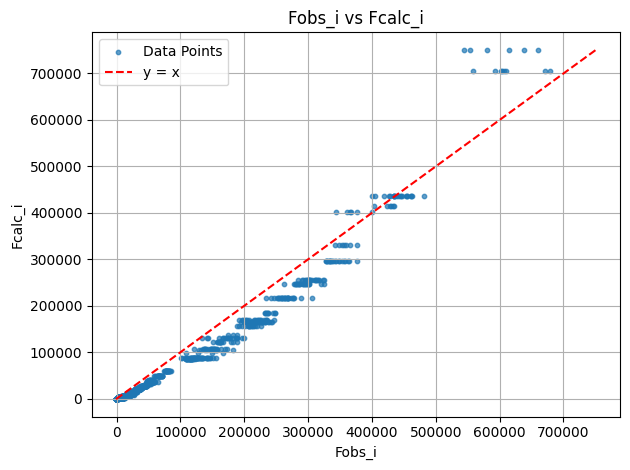

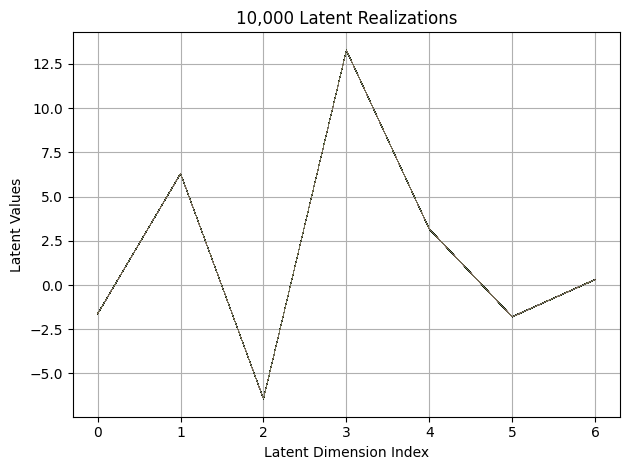

First 10 latent vectors from the VAE:
Sample 1: [-1.621980905532837, 6.292545795440674, -6.426297664642334, 13.27225399017334, 3.156895637512207, -1.7986291646957397, 0.3041973412036896]
Sample 2: [-1.6321487426757812, 6.308342933654785, -6.432284355163574, 13.270398139953613, 3.15608549118042, -1.8005927801132202, 0.29340022802352905]
Sample 3: [-1.6389102935791016, 6.29805326461792, -6.4354472160339355, 13.276601791381836, 3.1648662090301514, -1.8067419528961182, 0.3130040764808655]
Sample 4: [-1.6192653179168701, 6.2954020500183105, -6.437589168548584, 13.267057418823242, 3.1567881107330322, -1.8014137744903564, 0.30592477321624756]
Sample 5: [-1.6271812915802002, 6.298125267028809, -6.4402360916137695, 13.271617889404297, 3.1732699871063232, -1.7991881370544434, 0.3086649179458618]
Sample 6: [-1.635926604270935, 6.289272785186768, -6.430262088775635, 13.285011291503906, 3.1674611568450928, -1.8089134693145752, 0.30474382638931274]
Sample 7: [-1.6271799802780151, 6.2930588722229, -6

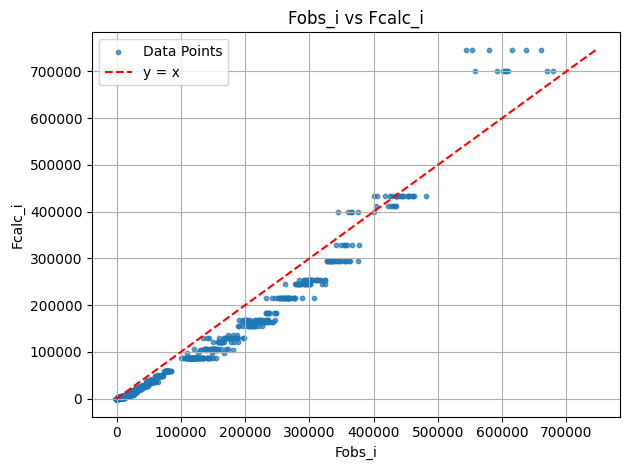

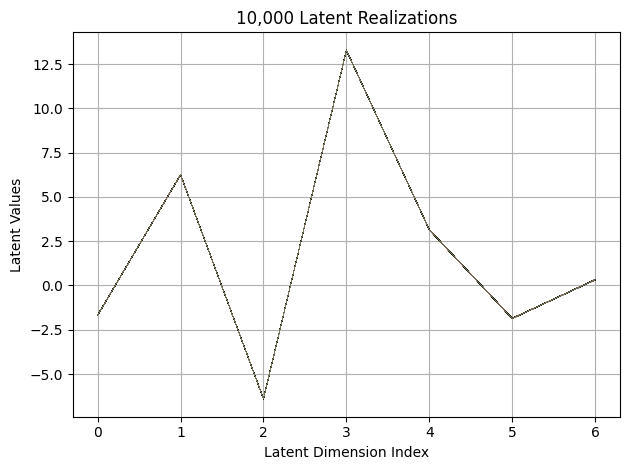

First 10 latent vectors from the VAE:
Sample 1: [-1.6899139881134033, 6.250699043273926, -6.395660877227783, 13.275884628295898, 3.1539416313171387, -1.8592075109481812, 0.3367253541946411]
Sample 2: [-1.6809108257293701, 6.24613094329834, -6.402529239654541, 13.289772987365723, 3.150815963745117, -1.8543593883514404, 0.3294973373413086]
Sample 3: [-1.6759978532791138, 6.241994380950928, -6.385343074798584, 13.281917572021484, 3.145817279815674, -1.8617326021194458, 0.313317209482193]
Sample 4: [-1.6775450706481934, 6.263270378112793, -6.4109344482421875, 13.283995628356934, 3.145036458969116, -1.8556007146835327, 0.3152949810028076]
Sample 5: [-1.6806973218917847, 6.2579450607299805, -6.3988037109375, 13.284937858581543, 3.138601541519165, -1.8555415868759155, 0.3224700093269348]
Sample 6: [-1.6793620586395264, 6.265582084655762, -6.397239685058594, 13.272717475891113, 3.141343116760254, -1.8666315078735352, 0.3249828815460205]
Sample 7: [-1.680902123451233, 6.261983394622803, -6.3923

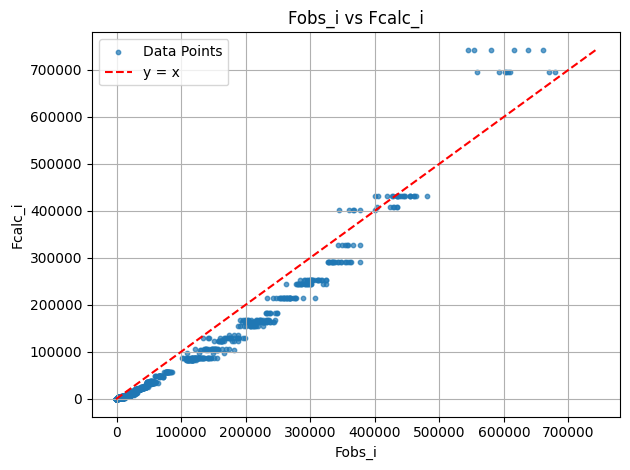

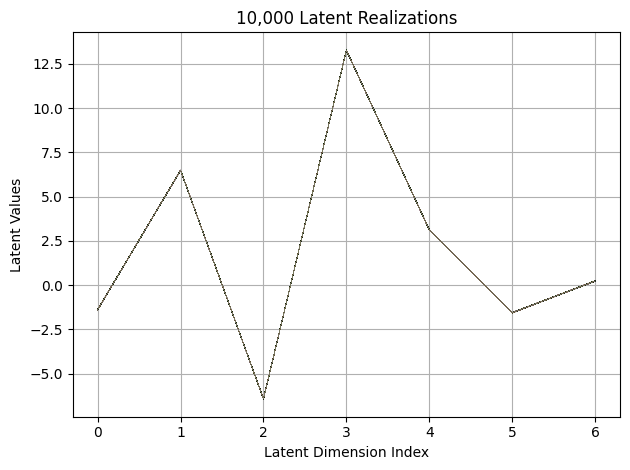

First 10 latent vectors from the VAE:
Sample 1: [-1.383304238319397, 6.47705078125, -6.433773994445801, 13.26549243927002, 3.1192514896392822, -1.5671535730361938, 0.23048639297485352]
Sample 2: [-1.3811848163604736, 6.483661651611328, -6.409396648406982, 13.277338981628418, 3.1351680755615234, -1.5644723176956177, 0.22530898451805115]
Sample 3: [-1.3838205337524414, 6.486167907714844, -6.412951946258545, 13.267030715942383, 3.116847276687622, -1.5571659803390503, 0.2289581149816513]
Sample 4: [-1.3885726928710938, 6.484067916870117, -6.408211708068848, 13.263886451721191, 3.1086955070495605, -1.5693696737289429, 0.22285594046115875]
Sample 5: [-1.3823509216308594, 6.490085124969482, -6.4225006103515625, 13.260293006896973, 3.1233158111572266, -1.552719235420227, 0.23202162981033325]
Sample 6: [-1.385805606842041, 6.48480749130249, -6.437670707702637, 13.247292518615723, 3.1197924613952637, -1.555869460105896, 0.23062674701213837]
Sample 7: [-1.4008359909057617, 6.471494197845459, -6.4

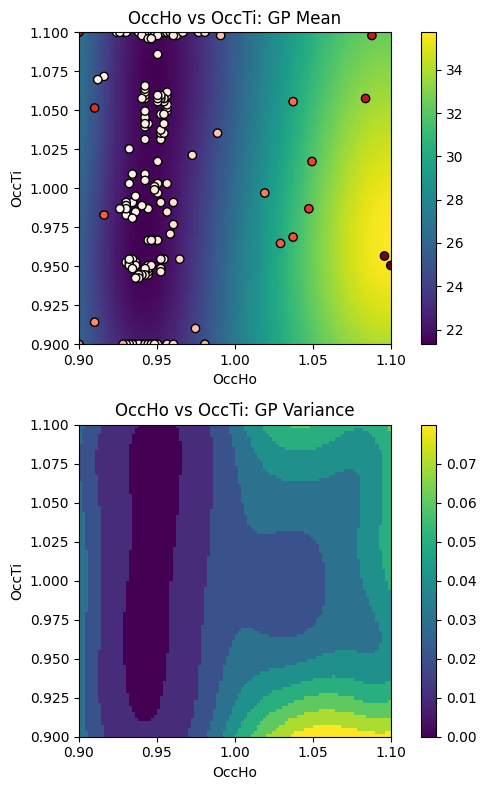

EI: [-1.00000000e+00  2.62848381e-03  2.59601604e-03 ...  1.02638733e-04
  1.24313287e-04  1.53053901e-04]
Function eval #160
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [0.9424242377281189, 0.9464646577835083]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7672
initial chi^2 1.6205e+05 with 2596 obs.
New scale: 0.7672
Cycle 0: 0.73s, Chi**2: 1.1581e+05 for 2596 obs., Lambda: 0,  Delta: 0.285, SVD=0
New scale: 0.7672
Maximum shift/esd = -58.72

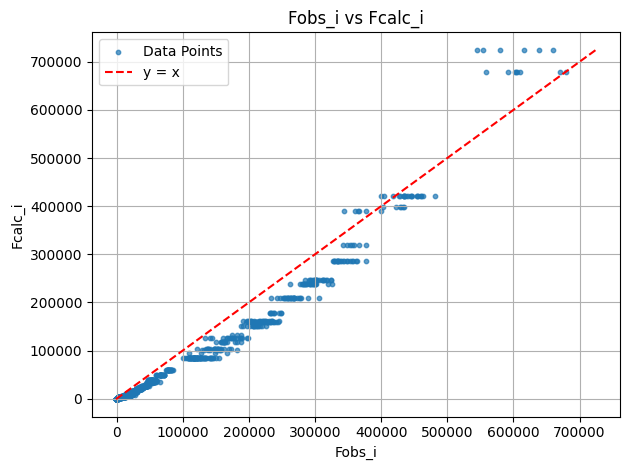

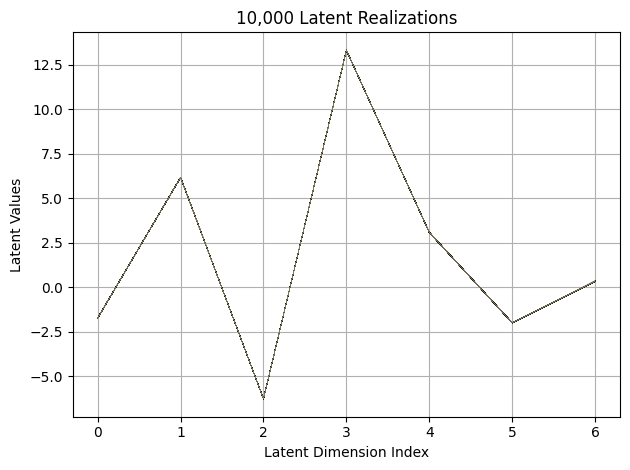

First 10 latent vectors from the VAE:
Sample 1: [-1.7315795421600342, 6.169188499450684, -6.255171775817871, 13.298519134521484, 3.079432487487793, -2.0095653533935547, 0.3345145285129547]
Sample 2: [-1.7301223278045654, 6.187500476837158, -6.268968105316162, 13.30978012084961, 3.073171615600586, -2.0023112297058105, 0.3421129584312439]
Sample 3: [-1.7277936935424805, 6.169510841369629, -6.2653656005859375, 13.29814338684082, 3.0833561420440674, -2.0092480182647705, 0.33764857053756714]
Sample 4: [-1.7347818613052368, 6.158943176269531, -6.277120590209961, 13.314593315124512, 3.0715699195861816, -1.9977222681045532, 0.3364739716053009]
Sample 5: [-1.7285906076431274, 6.1414923667907715, -6.277410507202148, 13.305266380310059, 3.0687828063964844, -1.991159439086914, 0.33649829030036926]
Sample 6: [-1.75232994556427, 6.161054611206055, -6.26194953918457, 13.295889854431152, 3.0739569664001465, -1.994890809059143, 0.3376999795436859]
Sample 7: [-1.724768877029419, 6.160426616668701, -6.26

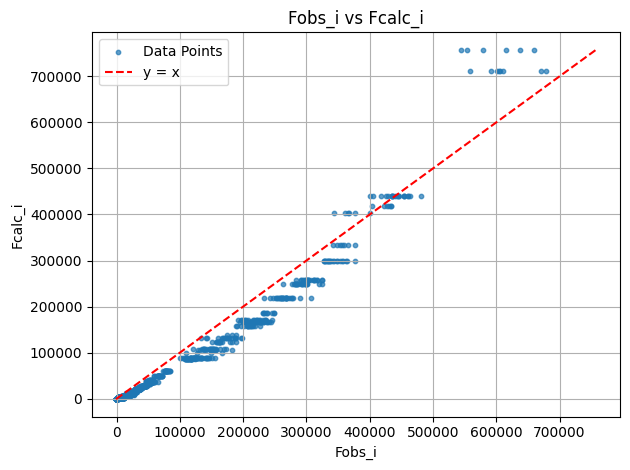

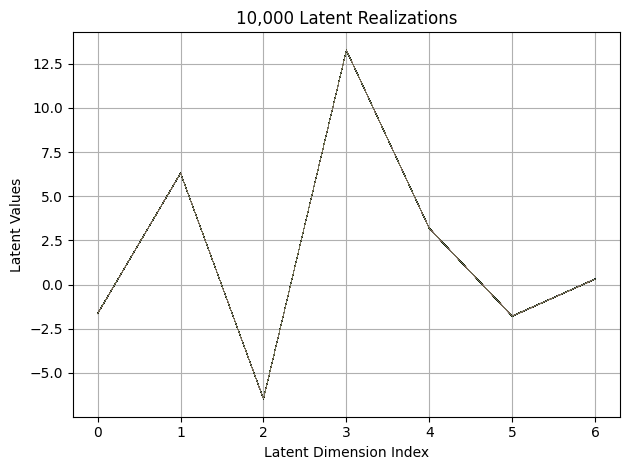

First 10 latent vectors from the VAE:
Sample 1: [-1.6518480777740479, 6.303066730499268, -6.481143474578857, 13.263176918029785, 3.1891162395477295, -1.782334566116333, 0.31102094054222107]
Sample 2: [-1.6413108110427856, 6.3154706954956055, -6.462509632110596, 13.267843246459961, 3.175467014312744, -1.7898005247116089, 0.31775030493736267]
Sample 3: [-1.64084792137146, 6.300897598266602, -6.4708757400512695, 13.258743286132812, 3.1860198974609375, -1.7767642736434937, 0.31423431634902954]
Sample 4: [-1.6461799144744873, 6.302816867828369, -6.466411113739014, 13.257942199707031, 3.1943273544311523, -1.7795566320419312, 0.31145593523979187]
Sample 5: [-1.6494559049606323, 6.304534435272217, -6.471012592315674, 13.265548706054688, 3.1835434436798096, -1.792646884918213, 0.30995863676071167]
Sample 6: [-1.6419373750686646, 6.300290107727051, -6.464073657989502, 13.264503479003906, 3.1926167011260986, -1.7871651649475098, 0.3188977837562561]
Sample 7: [-1.6277250051498413, 6.29962396621704

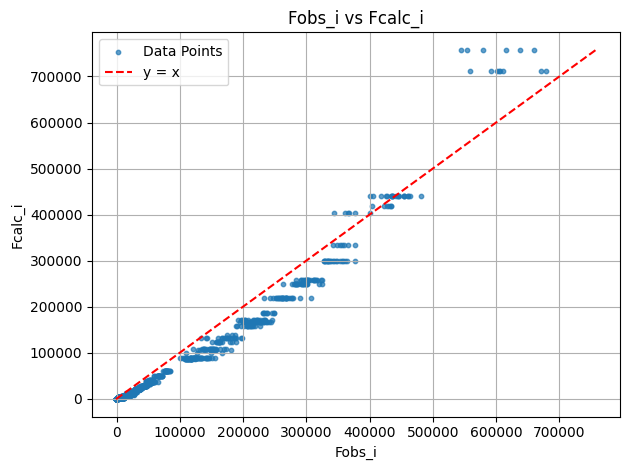

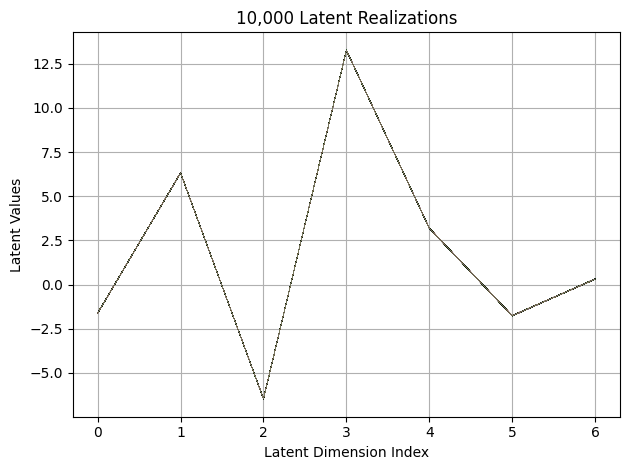

First 10 latent vectors from the VAE:
Sample 1: [-1.6400418281555176, 6.31915283203125, -6.462432384490967, 13.25302505493164, 3.176708459854126, -1.7600023746490479, 0.2989795506000519]
Sample 2: [-1.6255656480789185, 6.318456649780273, -6.458971977233887, 13.261494636535645, 3.1838111877441406, -1.7683849334716797, 0.31993019580841064]
Sample 3: [-1.6264033317565918, 6.321680545806885, -6.477033615112305, 13.272294044494629, 3.1848795413970947, -1.7723305225372314, 0.30917900800704956]
Sample 4: [-1.632317304611206, 6.325175762176514, -6.488081932067871, 13.259000778198242, 3.191693067550659, -1.777626872062683, 0.3083169758319855]
Sample 5: [-1.6225959062576294, 6.324387550354004, -6.476572036743164, 13.265989303588867, 3.1826417446136475, -1.779948115348816, 0.31373369693756104]
Sample 6: [-1.637418270111084, 6.31581974029541, -6.471349239349365, 13.270185470581055, 3.1843960285186768, -1.77675461769104, 0.3120356500148773]
Sample 7: [-1.628906488418579, 6.31804084777832, -6.484082

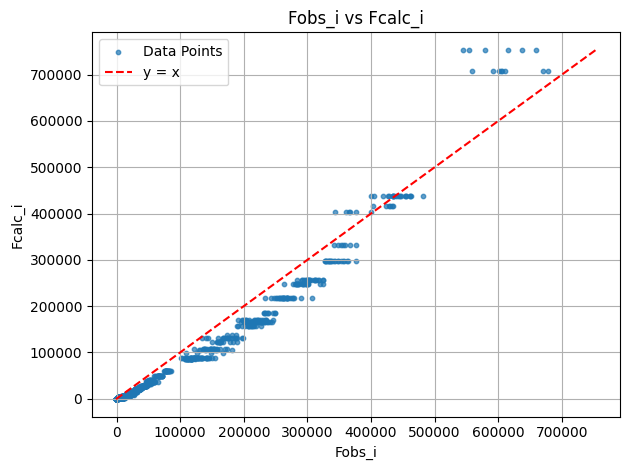

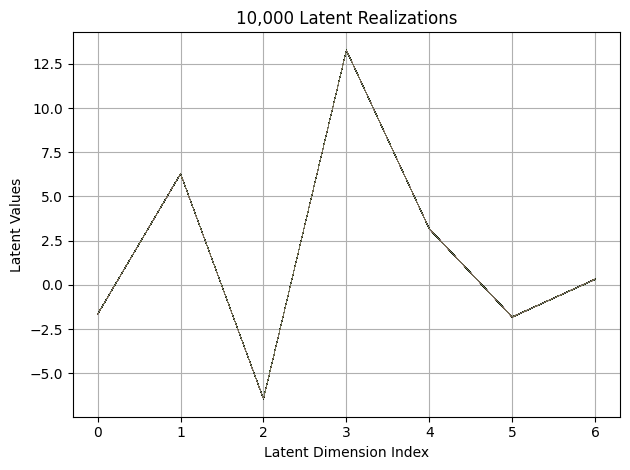

First 10 latent vectors from the VAE:
Sample 1: [-1.6451492309570312, 6.282513618469238, -6.447417736053467, 13.27935791015625, 3.1789956092834473, -1.8251957893371582, 0.3263400197029114]
Sample 2: [-1.6504350900650024, 6.283913612365723, -6.4527587890625, 13.26919937133789, 3.1695215702056885, -1.819321632385254, 0.31949523091316223]
Sample 3: [-1.66269052028656, 6.285133361816406, -6.4356584548950195, 13.26276683807373, 3.175192356109619, -1.8231408596038818, 0.31668156385421753]
Sample 4: [-1.6560702323913574, 6.287656307220459, -6.446150779724121, 13.267668724060059, 3.1691508293151855, -1.8081187009811401, 0.31135860085487366]
Sample 5: [-1.658359169960022, 6.2874531745910645, -6.439952373504639, 13.272180557250977, 3.173530101776123, -1.8217934370040894, 0.3178068995475769]
Sample 6: [-1.6558749675750732, 6.285417079925537, -6.4362945556640625, 13.261343955993652, 3.1744227409362793, -1.8168344497680664, 0.3243134915828705]
Sample 7: [-1.6572848558425903, 6.286366939544678, -6.4

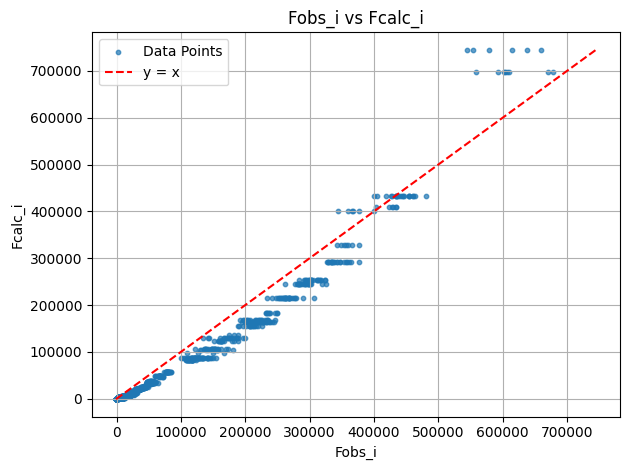

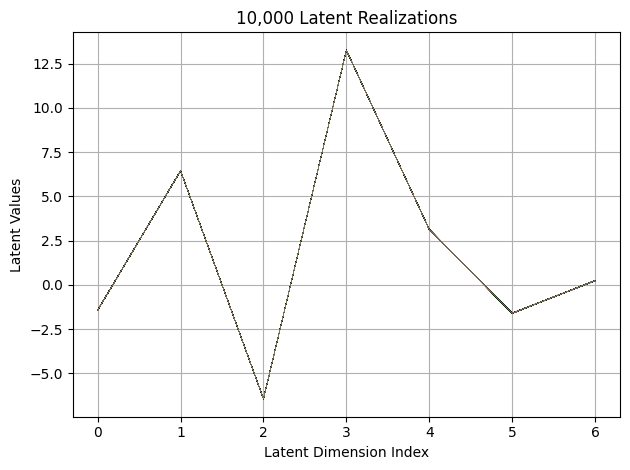

First 10 latent vectors from the VAE:
Sample 1: [-1.4247798919677734, 6.451241970062256, -6.4215006828308105, 13.258293151855469, 3.124314308166504, -1.5964491367340088, 0.2357693314552307]
Sample 2: [-1.4262709617614746, 6.461812973022461, -6.4345550537109375, 13.270872116088867, 3.1359362602233887, -1.6044565439224243, 0.23158584535121918]
Sample 3: [-1.4206663370132446, 6.442015647888184, -6.431488037109375, 13.27013874053955, 3.13246488571167, -1.598503589630127, 0.2464354783296585]
Sample 4: [-1.4309377670288086, 6.446357727050781, -6.425882816314697, 13.261642456054688, 3.1314380168914795, -1.590849757194519, 0.24346856772899628]
Sample 5: [-1.4241223335266113, 6.452420711517334, -6.444760799407959, 13.281938552856445, 3.1387577056884766, -1.5946704149246216, 0.23958396911621094]
Sample 6: [-1.4292519092559814, 6.454819679260254, -6.41777229309082, 13.26386547088623, 3.1195590496063232, -1.5954207181930542, 0.25140589475631714]
Sample 7: [-1.437962293624878, 6.453534126281738, -6

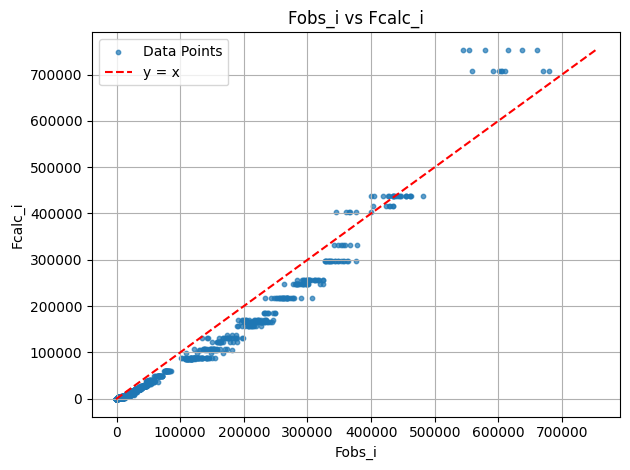

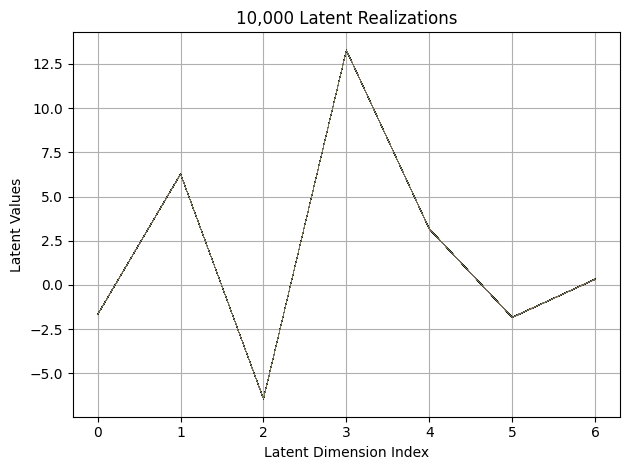

First 10 latent vectors from the VAE:
Sample 1: [-1.6688876152038574, 6.276207447052002, -6.436882972717285, 13.275346755981445, 3.1721062660217285, -1.839657187461853, 0.3261977434158325]
Sample 2: [-1.675714135169983, 6.266219139099121, -6.4302873611450195, 13.264978408813477, 3.1611733436584473, -1.8268582820892334, 0.34404003620147705]
Sample 3: [-1.679916262626648, 6.259504795074463, -6.434724807739258, 13.273882865905762, 3.172926664352417, -1.831903338432312, 0.320806086063385]
Sample 4: [-1.6732898950576782, 6.267289638519287, -6.437767028808594, 13.267394065856934, 3.163954257965088, -1.834205985069275, 0.3327975571155548]
Sample 5: [-1.6677556037902832, 6.268696308135986, -6.430762767791748, 13.272395133972168, 3.1750776767730713, -1.8304859399795532, 0.32050976157188416]
Sample 6: [-1.6760064363479614, 6.269583702087402, -6.432226657867432, 13.272895812988281, 3.1660799980163574, -1.828894019126892, 0.3194343149662018]
Sample 7: [-1.6852833032608032, 6.268377780914307, -6.42

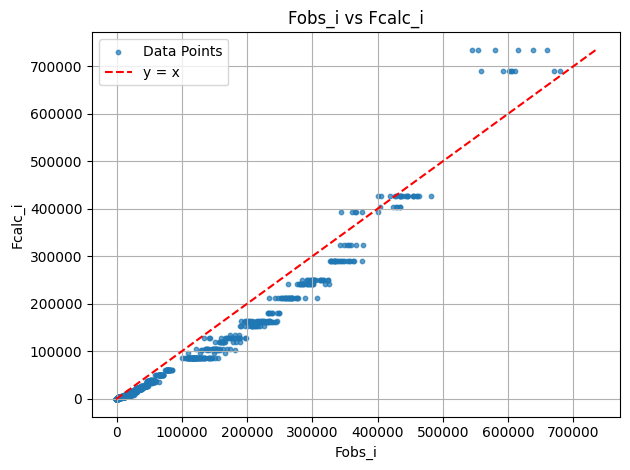

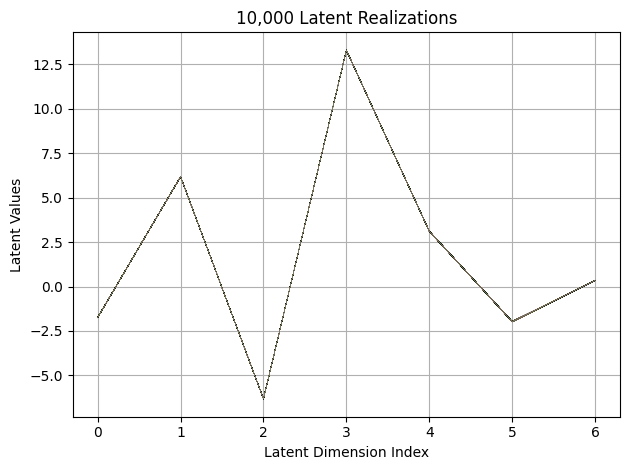

First 10 latent vectors from the VAE:
Sample 1: [-1.7494159936904907, 6.171964645385742, -6.315929889678955, 13.283437728881836, 3.1032559871673584, -1.9805651903152466, 0.345325767993927]
Sample 2: [-1.7396303415298462, 6.177676200866699, -6.320416450500488, 13.28276252746582, 3.109361171722412, -1.96015202999115, 0.3459948003292084]
Sample 3: [-1.7317447662353516, 6.188891410827637, -6.31167459487915, 13.288488388061523, 3.0977954864501953, -1.9723095893859863, 0.3541577458381653]
Sample 4: [-1.7385622262954712, 6.168078422546387, -6.308740615844727, 13.298826217651367, 3.0981106758117676, -1.964468240737915, 0.3460044860839844]
Sample 5: [-1.7458122968673706, 6.176888942718506, -6.3208088874816895, 13.291438102722168, 3.0915563106536865, -1.980137586593628, 0.3369835615158081]
Sample 6: [-1.7453168630599976, 6.175588130950928, -6.327116966247559, 13.286661148071289, 3.106117010116577, -1.9738250970840454, 0.3399268388748169]
Sample 7: [-1.7430236339569092, 6.182514190673828, -6.3129

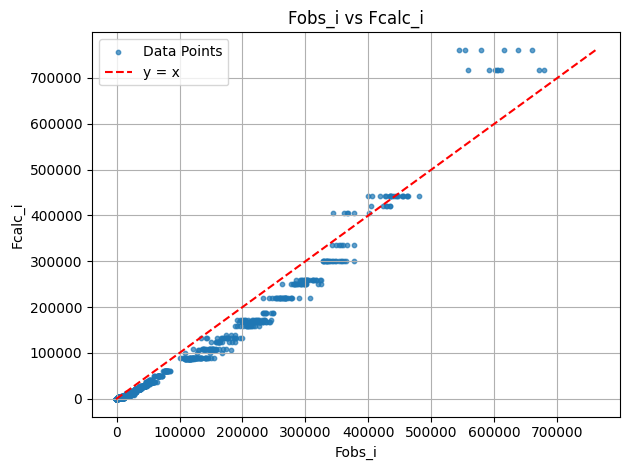

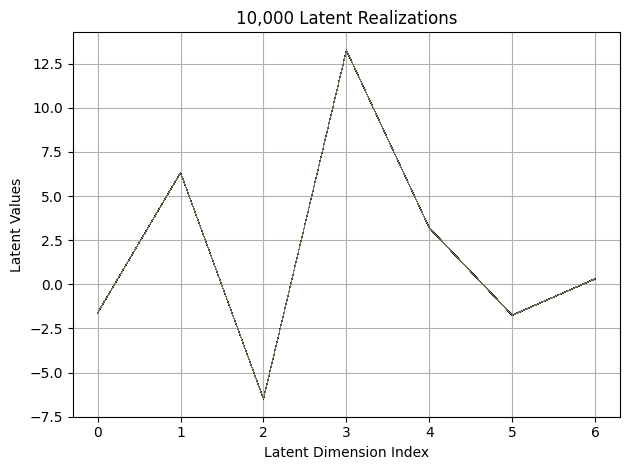

First 10 latent vectors from the VAE:
Sample 1: [-1.6194820404052734, 6.319830417633057, -6.491383075714111, 13.254812240600586, 3.1957178115844727, -1.757461667060852, 0.3054123520851135]
Sample 2: [-1.6293466091156006, 6.329256057739258, -6.491367816925049, 13.264751434326172, 3.1951489448547363, -1.7491334676742554, 0.31437259912490845]
Sample 3: [-1.622843861579895, 6.333466529846191, -6.496760845184326, 13.255868911743164, 3.1952898502349854, -1.7549443244934082, 0.3168376684188843]
Sample 4: [-1.6172552108764648, 6.328699111938477, -6.501075744628906, 13.251160621643066, 3.2014198303222656, -1.7549947500228882, 0.31276756525039673]
Sample 5: [-1.6232858896255493, 6.3237528800964355, -6.498994827270508, 13.249485969543457, 3.1963865756988525, -1.7536336183547974, 0.30458009243011475]
Sample 6: [-1.6265912055969238, 6.3196611404418945, -6.496057987213135, 13.248579025268555, 3.1917052268981934, -1.7472814321517944, 0.31437110900878906]
Sample 7: [-1.6236971616744995, 6.325086116790

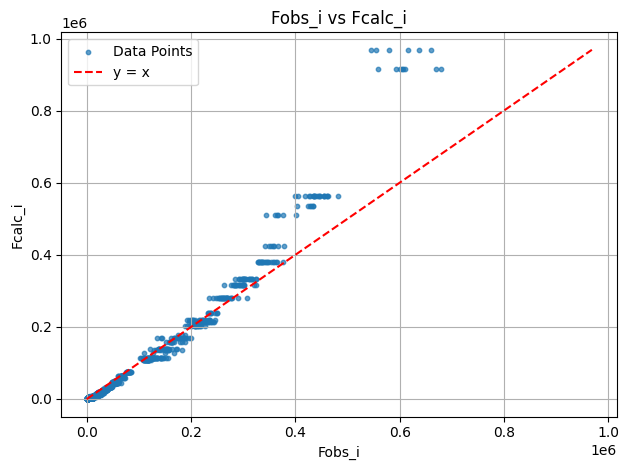

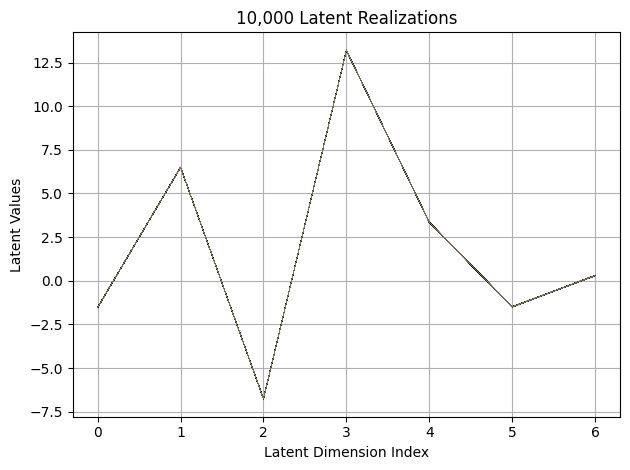

First 10 latent vectors from the VAE:
Sample 1: [-1.5347849130630493, 6.4927191734313965, -6.761180400848389, 13.199684143066406, 3.3440020084381104, -1.5082329511642456, 0.2999010682106018]
Sample 2: [-1.537592887878418, 6.491535186767578, -6.759810924530029, 13.211024284362793, 3.3573813438415527, -1.4978222846984863, 0.288705974817276]
Sample 3: [-1.5282232761383057, 6.50532865524292, -6.758590221405029, 13.206076622009277, 3.3334250450134277, -1.4953348636627197, 0.28142857551574707]
Sample 4: [-1.536998987197876, 6.50222110748291, -6.7548041343688965, 13.21102237701416, 3.346001148223877, -1.4952728748321533, 0.30409950017929077]
Sample 5: [-1.538328766822815, 6.510905742645264, -6.7546916007995605, 13.202555656433105, 3.3439087867736816, -1.4842400550842285, 0.3012262284755707]
Sample 6: [-1.5301837921142578, 6.492072105407715, -6.777674674987793, 13.208395004272461, 3.334836006164551, -1.4957133531570435, 0.28771036863327026]
Sample 7: [-1.5178680419921875, 6.490174770355225, -6

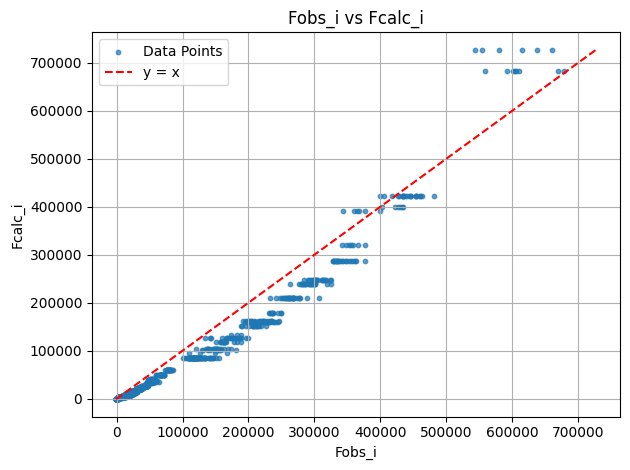

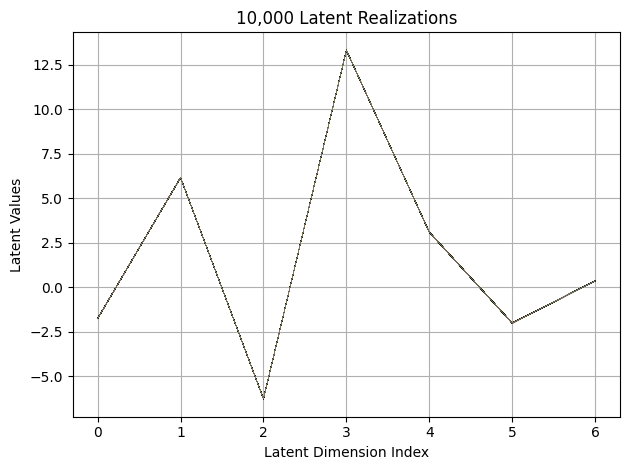

First 10 latent vectors from the VAE:
Sample 1: [-1.7564523220062256, 6.160347938537598, -6.280979156494141, 13.295682907104492, 3.0853145122528076, -2.0220463275909424, 0.34684890508651733]
Sample 2: [-1.7606197595596313, 6.145705699920654, -6.271340370178223, 13.294053077697754, 3.076589584350586, -2.01932954788208, 0.34340840578079224]
Sample 3: [-1.7586395740509033, 6.156496047973633, -6.279460906982422, 13.306818008422852, 3.0893495082855225, -2.0372698307037354, 0.3613029718399048]
Sample 4: [-1.765393614768982, 6.1505608558654785, -6.269957542419434, 13.30854320526123, 3.0889742374420166, -2.019315719604492, 0.3421941101551056]
Sample 5: [-1.7705811262130737, 6.144722938537598, -6.271816253662109, 13.306093215942383, 3.0944790840148926, -2.015535831451416, 0.3445955514907837]
Sample 6: [-1.7516350746154785, 6.149631023406982, -6.2736358642578125, 13.30990982055664, 3.069352865219116, -2.0259275436401367, 0.35416194796562195]
Sample 7: [-1.7577426433563232, 6.149331569671631, -6.

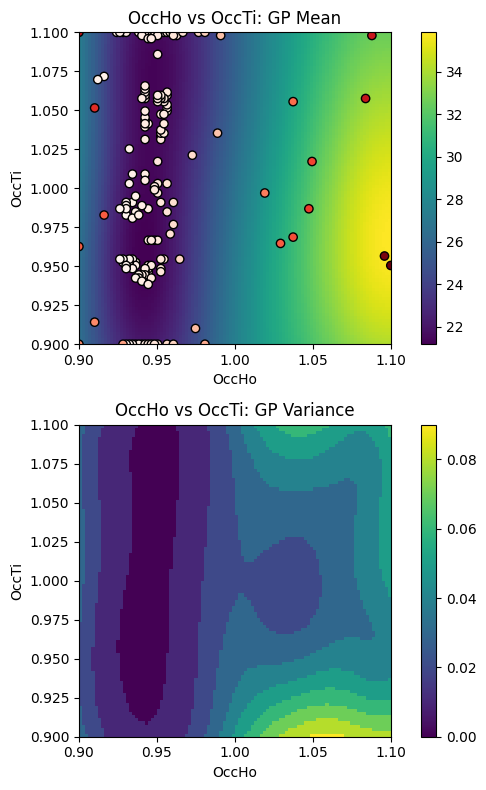

EI: [-1.00000000e+00  1.48638617e-03  1.51631981e-03 ...  1.05202314e-04
  1.29551510e-04  1.62403332e-04]
Function eval #170
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [1.100000023841858, 0.9363636374473572]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7606
initial chi^2 2.0047e+05 with 2596 obs.
New scale: 0.7579
Cycle 0: 0.86s, Chi**2: 1.6451e+05 for 2596 obs., Lambda: 0,  Delta: 0.179, SVD=0
New scale: 0.7579
Maximum shift/esd = -50.204

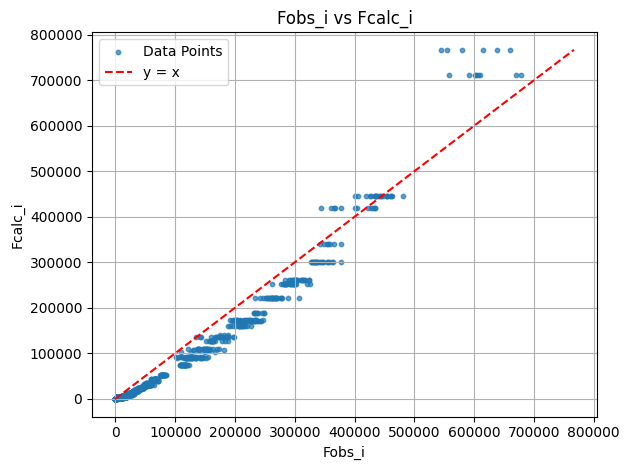

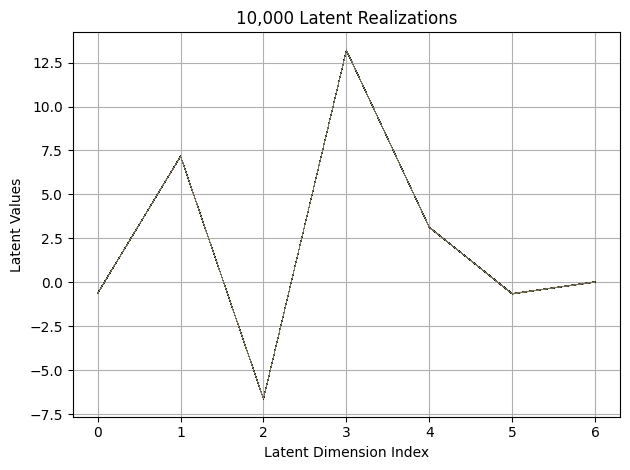

First 10 latent vectors from the VAE:
Sample 1: [-0.6287118196487427, 7.176154613494873, -6.613137245178223, 13.195261001586914, 3.1241703033447266, -0.6517235040664673, -0.0009260997176170349]
Sample 2: [-0.6329566240310669, 7.17773962020874, -6.625504016876221, 13.201319694519043, 3.12497878074646, -0.6551310420036316, 0.02135414630174637]
Sample 3: [-0.6264601945877075, 7.17504358291626, -6.62313175201416, 13.192924499511719, 3.134779453277588, -0.6634507775306702, 0.01965721882879734]
Sample 4: [-0.6277320384979248, 7.1703338623046875, -6.629871845245361, 13.187371253967285, 3.131267786026001, -0.6518630981445312, 0.010219176299870014]
Sample 5: [-0.6174912452697754, 7.180530548095703, -6.630835056304932, 13.195343017578125, 3.123842477798462, -0.6542655825614929, 0.018184561282396317]
Sample 6: [-0.6227207779884338, 7.17893648147583, -6.629575729370117, 13.202506065368652, 3.1218631267547607, -0.6498663425445557, 0.02236984483897686]
Sample 7: [-0.622158944606781, 7.17158412933349

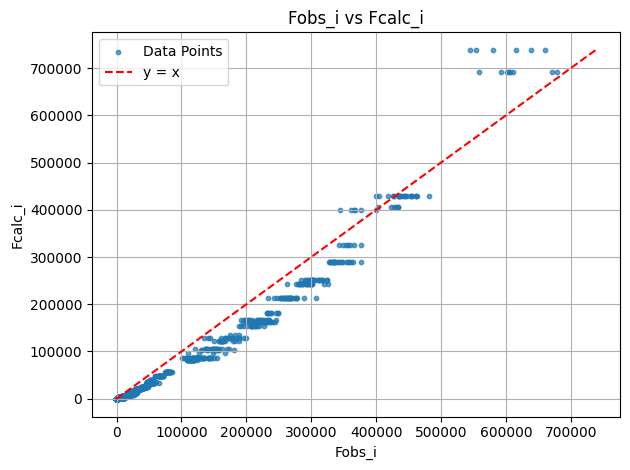

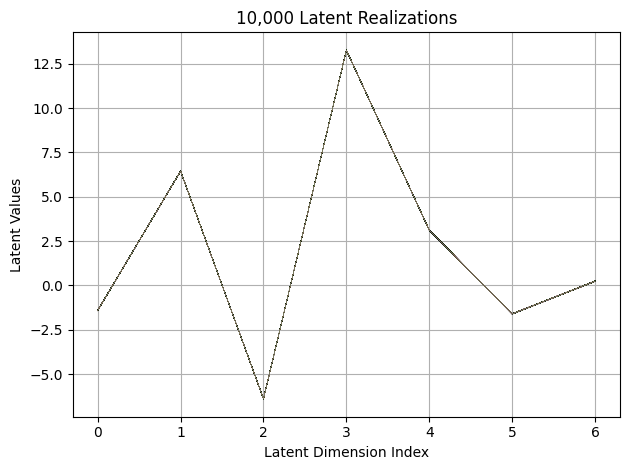

First 10 latent vectors from the VAE:
Sample 1: [-1.421075701713562, 6.442404747009277, -6.394552230834961, 13.254672050476074, 3.1124331951141357, -1.6136668920516968, 0.24235287308692932]
Sample 2: [-1.438458800315857, 6.450942516326904, -6.387592792510986, 13.272722244262695, 3.1139378547668457, -1.6145366430282593, 0.24015618860721588]
Sample 3: [-1.4238094091415405, 6.434904098510742, -6.381812572479248, 13.2666597366333, 3.1240384578704834, -1.6023430824279785, 0.23723040521144867]
Sample 4: [-1.4273319244384766, 6.446126937866211, -6.396336078643799, 13.276172637939453, 3.112192153930664, -1.6041468381881714, 0.23638266324996948]
Sample 5: [-1.4255834817886353, 6.454341888427734, -6.400317668914795, 13.26996898651123, 3.100656032562256, -1.6134281158447266, 0.23763954639434814]
Sample 6: [-1.4193274974822998, 6.437899112701416, -6.395143985748291, 13.272834777832031, 3.1098849773406982, -1.6193116903305054, 0.23492108285427094]
Sample 7: [-1.4088513851165771, 6.444767951965332, 

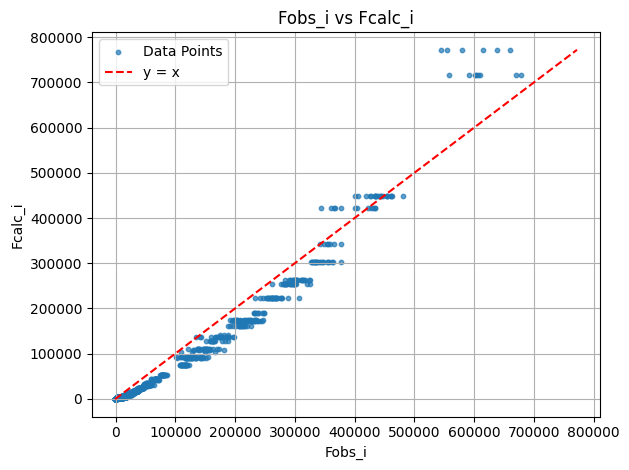

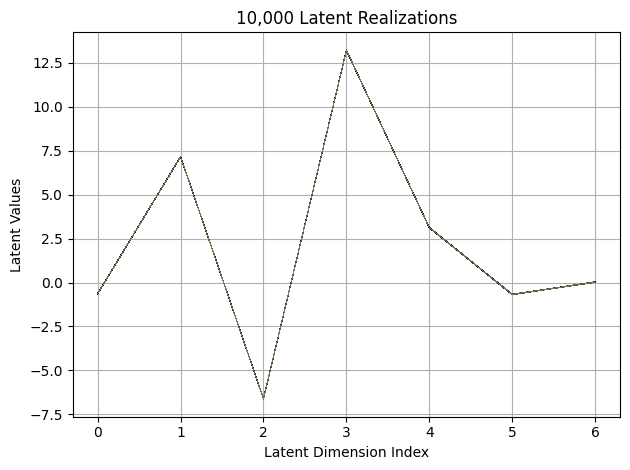

First 10 latent vectors from the VAE:
Sample 1: [-0.6553336381912231, 7.13595724105835, -6.608879566192627, 13.21180248260498, 3.1249892711639404, -0.675508439540863, 0.019740378484129906]
Sample 2: [-0.6337485909461975, 7.170367240905762, -6.601708889007568, 13.190150260925293, 3.1189498901367188, -0.6736729741096497, 0.02449055388569832]
Sample 3: [-0.6431430578231812, 7.156723976135254, -6.604920387268066, 13.187097549438477, 3.135403871536255, -0.6748286485671997, 0.012436614371836185]
Sample 4: [-0.6378898620605469, 7.146930694580078, -6.610406875610352, 13.18758487701416, 3.113440752029419, -0.7003507018089294, 0.025549599900841713]
Sample 5: [-0.6386010050773621, 7.150494575500488, -6.593533992767334, 13.201725959777832, 3.110530376434326, -0.6750542521476746, 0.017345525324344635]
Sample 6: [-0.6417868137359619, 7.149935722351074, -6.602714538574219, 13.214113235473633, 3.115492582321167, -0.6739720106124878, 0.022508271038532257]
Sample 7: [-0.6487382054328918, 7.1443710327148

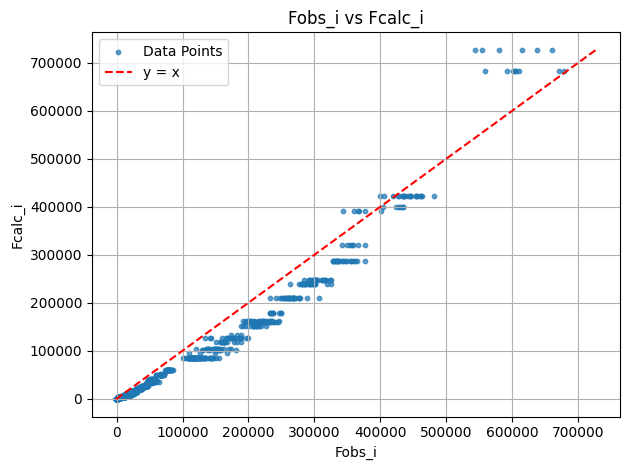

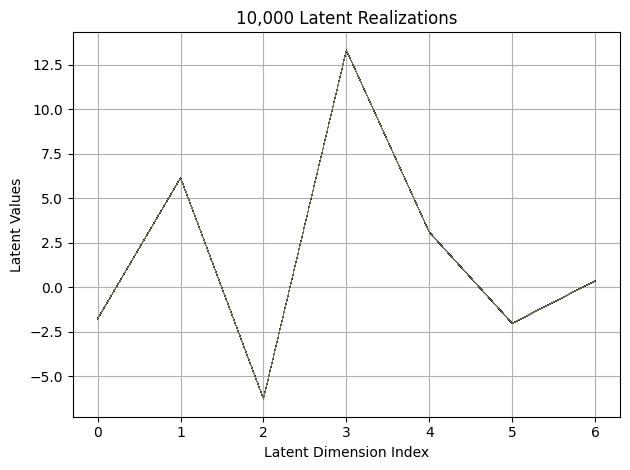

First 10 latent vectors from the VAE:
Sample 1: [-1.77554190158844, 6.1441521644592285, -6.280780792236328, 13.311187744140625, 3.096053123474121, -2.030137777328491, 0.36029356718063354]
Sample 2: [-1.7925070524215698, 6.126894950866699, -6.272778034210205, 13.29404067993164, 3.07259464263916, -2.036062717437744, 0.35678306221961975]
Sample 3: [-1.7788009643554688, 6.1372294425964355, -6.265881538391113, 13.302994728088379, 3.0816774368286133, -2.0396173000335693, 0.35391703248023987]
Sample 4: [-1.779958724975586, 6.138855457305908, -6.273734092712402, 13.297212600708008, 3.0789573192596436, -2.0446808338165283, 0.34695571660995483]
Sample 5: [-1.7857681512832642, 6.1312713623046875, -6.269217014312744, 13.309502601623535, 3.0872840881347656, -2.037013053894043, 0.3513297736644745]
Sample 6: [-1.7764861583709717, 6.1341471672058105, -6.260476112365723, 13.314591407775879, 3.094651460647583, -2.0361592769622803, 0.35080307722091675]
Sample 7: [-1.7913347482681274, 6.152454376220703, -

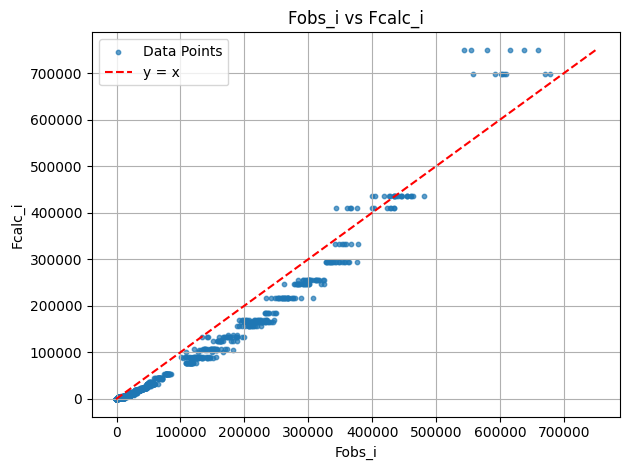

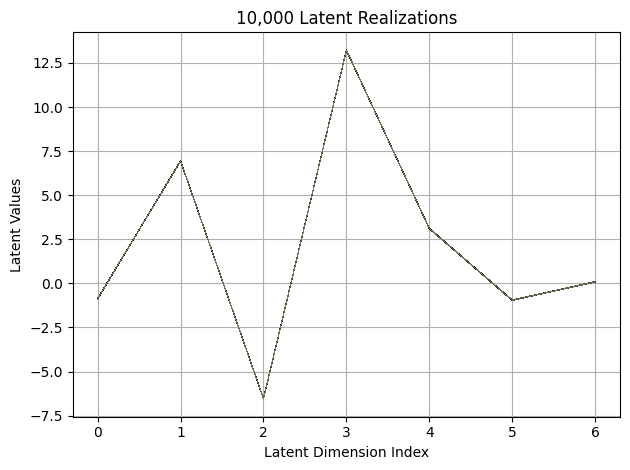

First 10 latent vectors from the VAE:
Sample 1: [-0.8680750727653503, 6.944631099700928, -6.544386386871338, 13.226962089538574, 3.1110737323760986, -0.9472015500068665, 0.08867322653532028]
Sample 2: [-0.8544450402259827, 6.937260150909424, -6.550478935241699, 13.224173545837402, 3.1239190101623535, -0.9564812779426575, 0.08959835022687912]
Sample 3: [-0.8684461116790771, 6.937179088592529, -6.5284576416015625, 13.211298942565918, 3.1160740852355957, -0.9528945684432983, 0.0846330001950264]
Sample 4: [-0.8740653395652771, 6.934875011444092, -6.549552917480469, 13.209356307983398, 3.112990379333496, -0.9474020004272461, 0.09433536231517792]
Sample 5: [-0.8717103004455566, 6.945555686950684, -6.528877258300781, 13.211065292358398, 3.123896837234497, -0.9467750191688538, 0.09042639285326004]
Sample 6: [-0.8703062534332275, 6.946218013763428, -6.555252552032471, 13.222793579101562, 3.1156342029571533, -0.9590752720832825, 0.08849096298217773]
Sample 7: [-0.8687558770179749, 6.946743488311

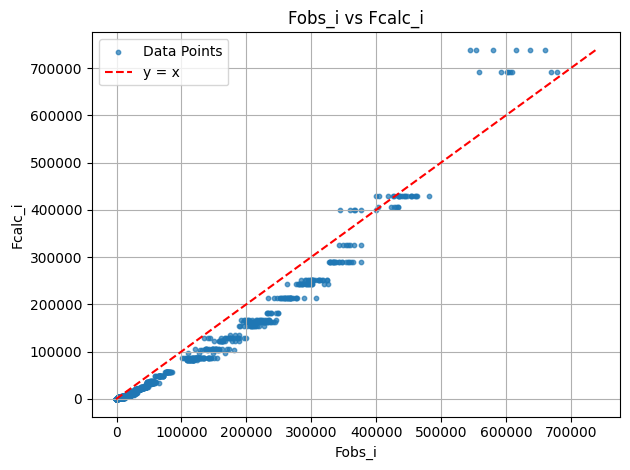

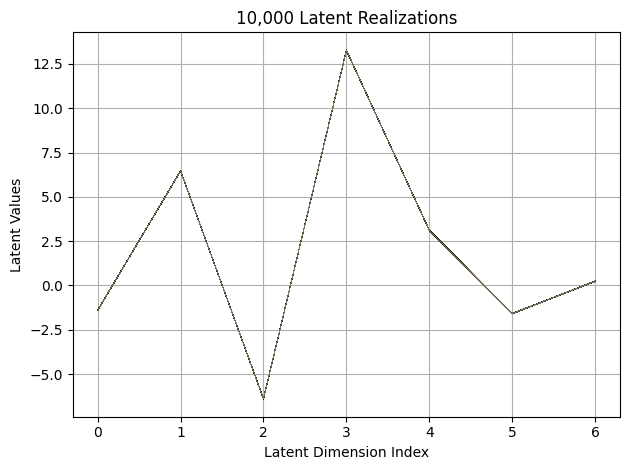

First 10 latent vectors from the VAE:
Sample 1: [-1.3960726261138916, 6.45517110824585, -6.3914594650268555, 13.27509880065918, 3.1131181716918945, -1.5891077518463135, 0.23468443751335144]
Sample 2: [-1.3960938453674316, 6.4676103591918945, -6.405820846557617, 13.263008117675781, 3.1104648113250732, -1.5880206823349, 0.2464563548564911]
Sample 3: [-1.4098918437957764, 6.456377029418945, -6.3965911865234375, 13.27406120300293, 3.1126415729522705, -1.588969111442566, 0.22521324455738068]
Sample 4: [-1.4115592241287231, 6.456323146820068, -6.388636112213135, 13.266876220703125, 3.1150155067443848, -1.5905452966690063, 0.23702460527420044]
Sample 5: [-1.404437780380249, 6.453829765319824, -6.392805099487305, 13.263501167297363, 3.1006569862365723, -1.5831849575042725, 0.2320651113986969]
Sample 6: [-1.415279507637024, 6.468206405639648, -6.395091533660889, 13.269434928894043, 3.1159074306488037, -1.5772521495819092, 0.2309606820344925]
Sample 7: [-1.4168469905853271, 6.462304592132568, -6

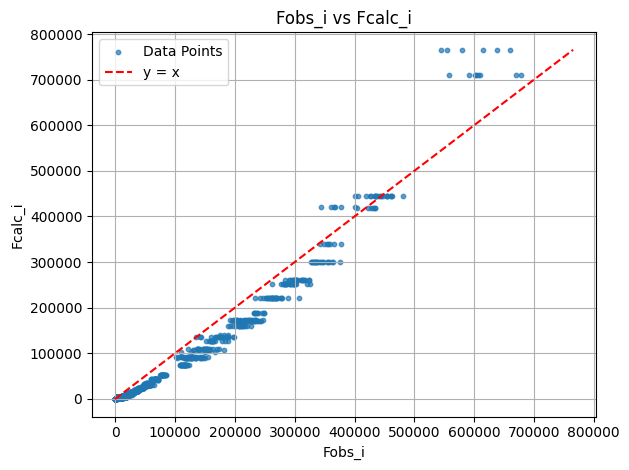

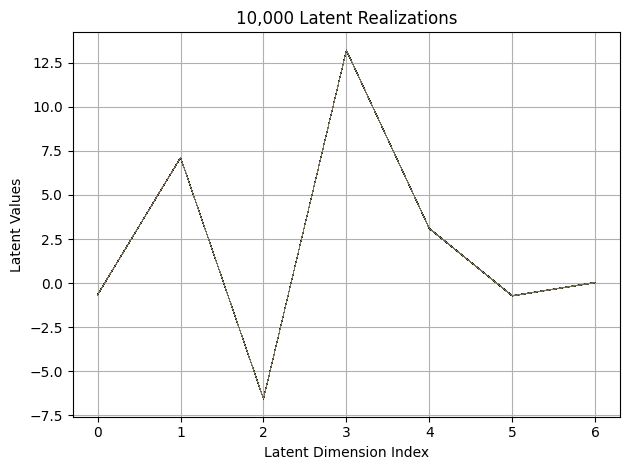

First 10 latent vectors from the VAE:
Sample 1: [-0.6569702625274658, 7.1198577880859375, -6.563370227813721, 13.214447021484375, 3.0911898612976074, -0.7207136154174805, 0.0346287302672863]
Sample 2: [-0.6505164504051208, 7.1155900955200195, -6.5698771476745605, 13.2200927734375, 3.099980592727661, -0.7177826762199402, 0.02613639086484909]
Sample 3: [-0.6710098385810852, 7.125109672546387, -6.564944744110107, 13.201671600341797, 3.1044836044311523, -0.720521092414856, 0.027297448366880417]
Sample 4: [-0.6617549657821655, 7.111928939819336, -6.573431968688965, 13.218620300292969, 3.109468698501587, -0.7163538932800293, 0.02105424553155899]
Sample 5: [-0.6639240384101868, 7.106318473815918, -6.556234359741211, 13.207073211669922, 3.0945229530334473, -0.725578248500824, 0.03985071927309036]
Sample 6: [-0.6456875205039978, 7.119353294372559, -6.557309150695801, 13.199043273925781, 3.097289800643921, -0.7287414073944092, 0.024889493361115456]
Sample 7: [-0.6658570170402527, 7.1169323921203

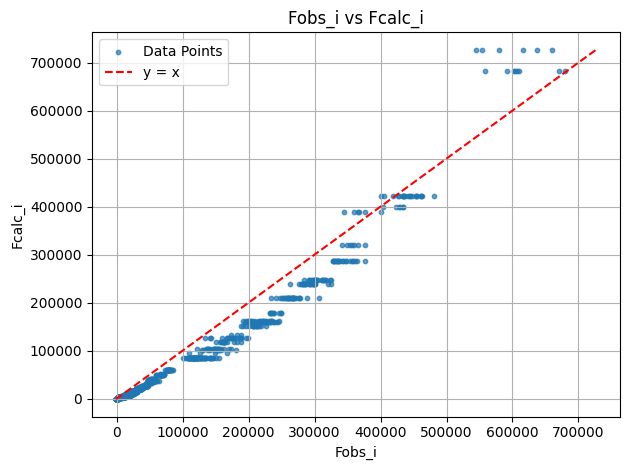

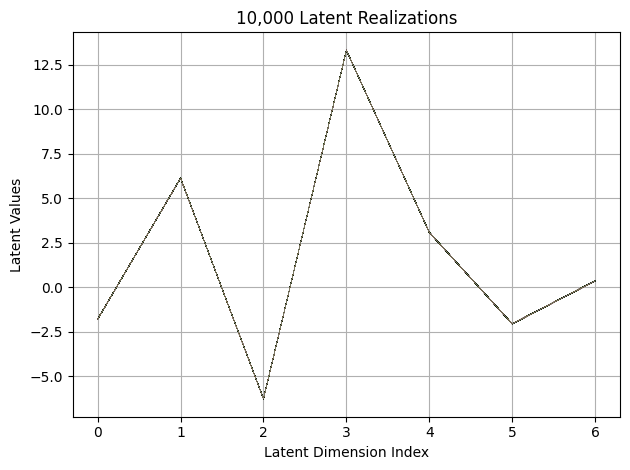

First 10 latent vectors from the VAE:
Sample 1: [-1.8040297031402588, 6.126497268676758, -6.259549140930176, 13.308362007141113, 3.0767695903778076, -2.0549237728118896, 0.36712199449539185]
Sample 2: [-1.8024662733078003, 6.1236677169799805, -6.252310276031494, 13.309117317199707, 3.076796770095825, -2.0514280796051025, 0.35945558547973633]
Sample 3: [-1.7990270853042603, 6.129614353179932, -6.269084930419922, 13.306480407714844, 3.092778444290161, -2.0497262477874756, 0.35260769724845886]
Sample 4: [-1.7840241193771362, 6.133237361907959, -6.257874488830566, 13.307631492614746, 3.078622817993164, -2.0536084175109863, 0.34689971804618835]
Sample 5: [-1.7989784479141235, 6.121629238128662, -6.26605224609375, 13.311044692993164, 3.0718696117401123, -2.054208517074585, 0.361172616481781]
Sample 6: [-1.7948195934295654, 6.12645149230957, -6.271767616271973, 13.297286987304688, 3.0850555896759033, -2.057516098022461, 0.3635379672050476]
Sample 7: [-1.7878395318984985, 6.127954959869385, -6

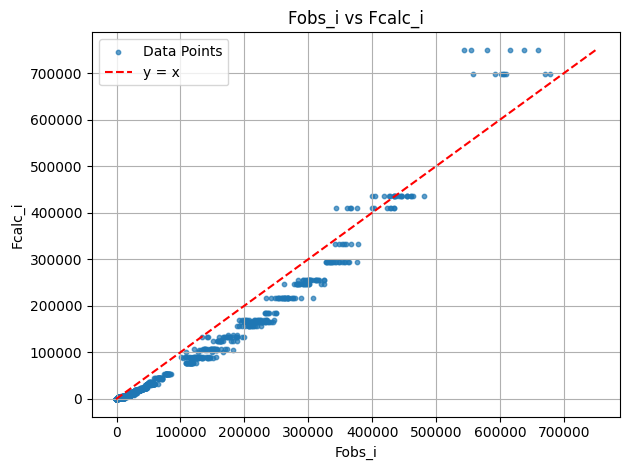

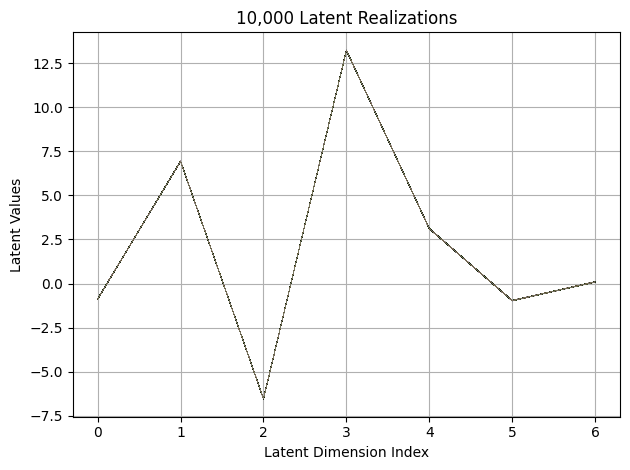

First 10 latent vectors from the VAE:
Sample 1: [-0.8795871734619141, 6.916290283203125, -6.5268168449401855, 13.229037284851074, 3.109994649887085, -0.9748427271842957, 0.08556900173425674]
Sample 2: [-0.8834378123283386, 6.946258068084717, -6.532253742218018, 13.23078441619873, 3.1122326850891113, -0.9733647704124451, 0.0925183817744255]
Sample 3: [-0.8835402131080627, 6.938340663909912, -6.5354437828063965, 13.228828430175781, 3.106458902359009, -0.980073869228363, 0.09224394708871841]
Sample 4: [-0.8742648363113403, 6.932580947875977, -6.542233467102051, 13.226818084716797, 3.1157824993133545, -0.9742736220359802, 0.0844414010643959]
Sample 5: [-0.8894731402397156, 6.926632404327393, -6.534614562988281, 13.225977897644043, 3.113203525543213, -0.9630333185195923, 0.10124443471431732]
Sample 6: [-0.8725628852844238, 6.940715789794922, -6.522512912750244, 13.223474502563477, 3.1158182621002197, -0.9657585024833679, 0.09181132912635803]
Sample 7: [-0.8922466039657593, 6.934644222259521

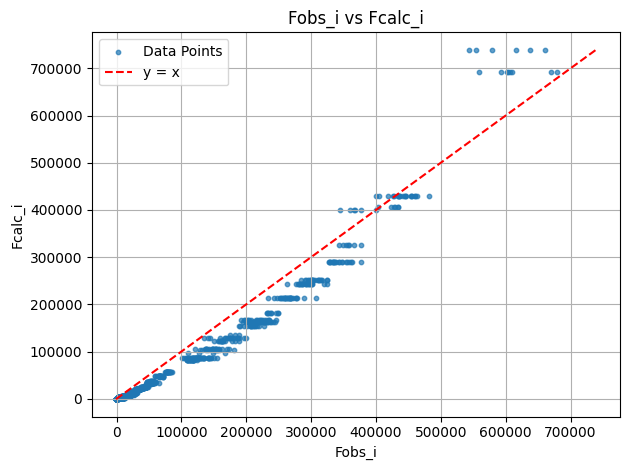

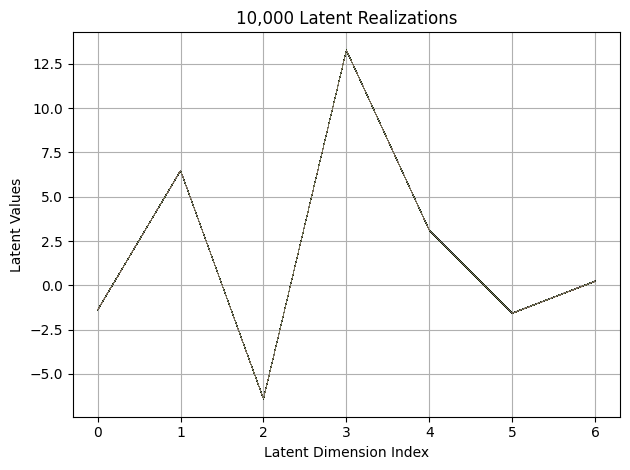

First 10 latent vectors from the VAE:
Sample 1: [-1.395642638206482, 6.4601311683654785, -6.398447513580322, 13.270685195922852, 3.1096951961517334, -1.5704598426818848, 0.23126554489135742]
Sample 2: [-1.3808410167694092, 6.473146915435791, -6.4099860191345215, 13.268838882446289, 3.1065313816070557, -1.5781670808792114, 0.23461595177650452]
Sample 3: [-1.3957183361053467, 6.477353572845459, -6.409681797027588, 13.27395248413086, 3.117614984512329, -1.5713037252426147, 0.2368505299091339]
Sample 4: [-1.3922971487045288, 6.4651970863342285, -6.404226779937744, 13.259735107421875, 3.1035521030426025, -1.5810768604278564, 0.23435886204242706]
Sample 5: [-1.3937898874282837, 6.47113037109375, -6.384469032287598, 13.27566909790039, 3.101804256439209, -1.5698933601379395, 0.24024701118469238]
Sample 6: [-1.400307059288025, 6.465294361114502, -6.404343128204346, 13.267925262451172, 3.1038084030151367, -1.5588332414627075, 0.2232336848974228]
Sample 7: [-1.387386441230774, 6.464937210083008, 

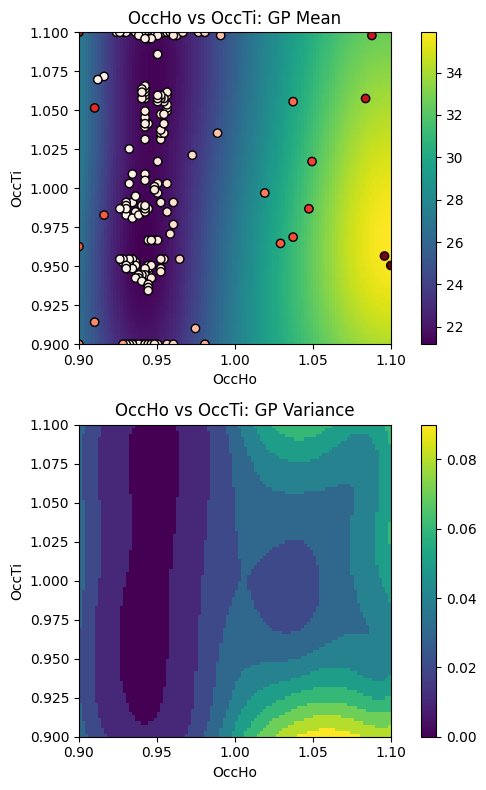

EI: [-1.00000000e+00  1.55206397e-03  1.58027187e-03 ...  1.15182134e-04
  1.41811091e-04  1.77728478e-04]
Function eval #180
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [0.9020201563835144, 0.9404040575027466]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7819
initial chi^2 1.4398e+05 with 2596 obs.
New scale: 0.7819
Cycle 0: 0.64s, Chi**2: 1.0173e+05 for 2596 obs., Lambda: 0,  Delta: 0.293, SVD=0
New scale: 0.7819
Maximum shift/esd = -57.02

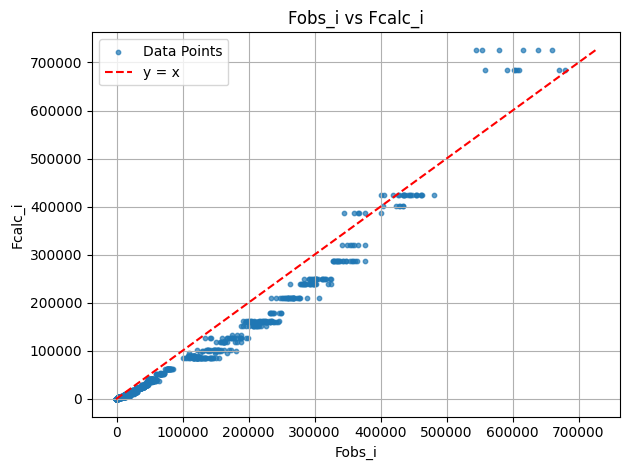

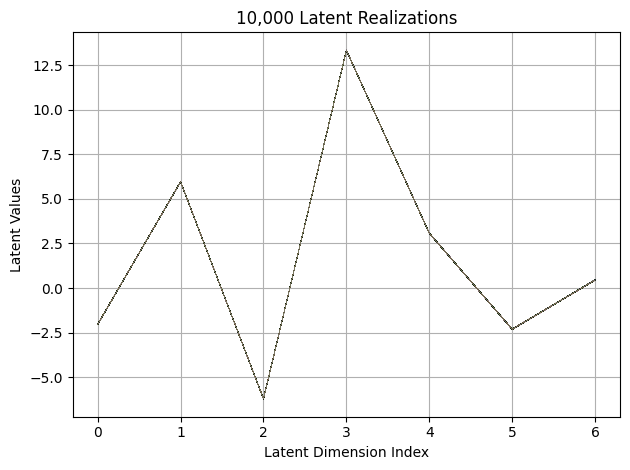

First 10 latent vectors from the VAE:
Sample 1: [-2.032644271850586, 5.9635210037231445, -6.213621616363525, 13.325377464294434, 3.063025712966919, -2.308804988861084, 0.4423545300960541]
Sample 2: [-2.0362799167633057, 5.951008319854736, -6.1953558921813965, 13.32418155670166, 3.0732600688934326, -2.305413007736206, 0.45424899458885193]
Sample 3: [-2.0248794555664062, 5.959737300872803, -6.210289478302002, 13.327289581298828, 3.075136423110962, -2.3016648292541504, 0.44827839732170105]
Sample 4: [-2.0263328552246094, 5.949612140655518, -6.194912910461426, 13.330083847045898, 3.0803301334381104, -2.3193702697753906, 0.45475369691848755]
Sample 5: [-2.029385805130005, 5.952436447143555, -6.208454608917236, 13.323541641235352, 3.0665764808654785, -2.3178415298461914, 0.45085659623146057]
Sample 6: [-2.034276247024536, 5.955587387084961, -6.2102885246276855, 13.33042049407959, 3.067084312438965, -2.3148274421691895, 0.4517572522163391]
Sample 7: [-2.032480239868164, 5.952483654022217, -6.

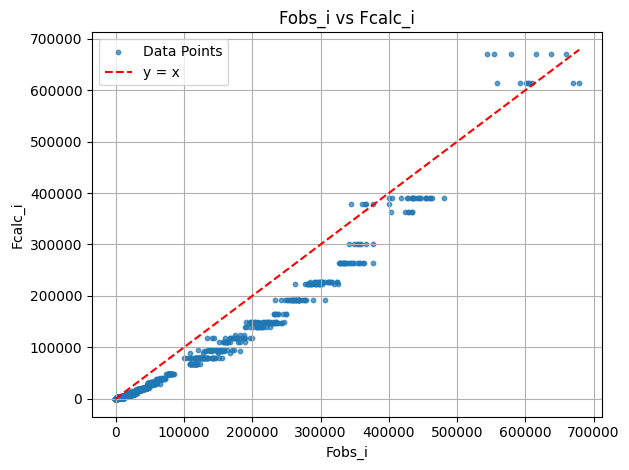

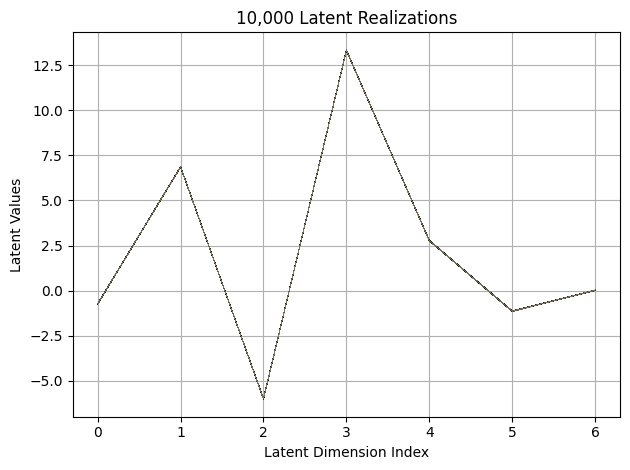

First 10 latent vectors from the VAE:
Sample 1: [-0.7265885472297668, 6.858643054962158, -5.985444068908691, 13.321672439575195, 2.7777504920959473, -1.129663348197937, 0.0252494215965271]
Sample 2: [-0.7395823001861572, 6.856451034545898, -5.975620269775391, 13.317543029785156, 2.768977165222168, -1.1267908811569214, 0.033328548073768616]
Sample 3: [-0.7369025349617004, 6.870344161987305, -5.988330364227295, 13.327858924865723, 2.7815682888031006, -1.1252304315567017, 0.01328012254089117]
Sample 4: [-0.7323053479194641, 6.861365795135498, -5.997920036315918, 13.318171501159668, 2.775301456451416, -1.1397194862365723, 0.023278022184967995]
Sample 5: [-0.7424611449241638, 6.8647894859313965, -5.9893598556518555, 13.320838928222656, 2.781275987625122, -1.1316314935684204, 0.03394053131341934]
Sample 6: [-0.7412999868392944, 6.871038913726807, -5.9826836585998535, 13.303150177001953, 2.776492118835449, -1.1448965072631836, 0.0251617394387722]
Sample 7: [-0.730858325958252, 6.8626556396484

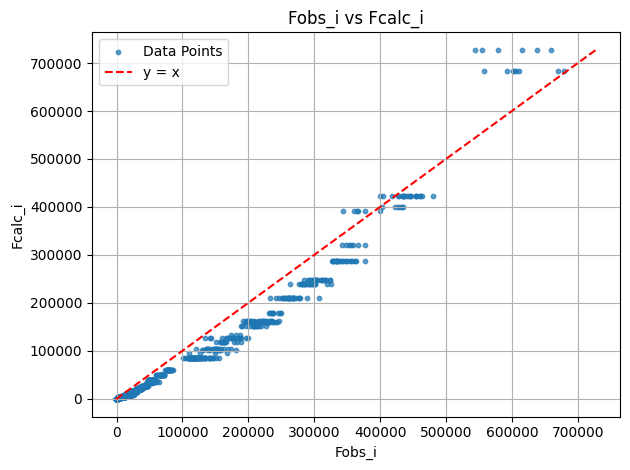

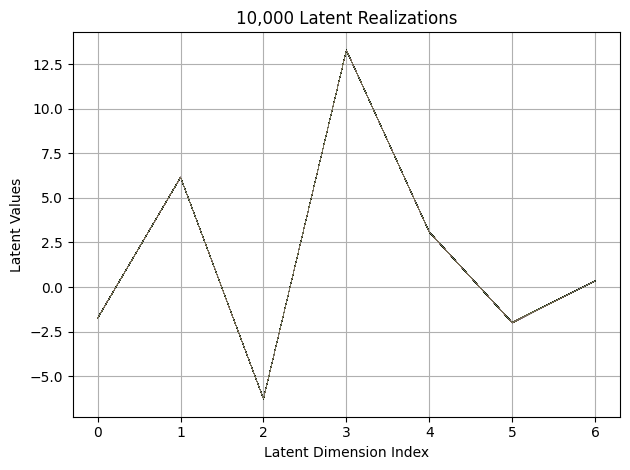

First 10 latent vectors from the VAE:
Sample 1: [-1.758805274963379, 6.164030075073242, -6.28535795211792, 13.302855491638184, 3.08662486076355, -2.0022850036621094, 0.34550604224205017]
Sample 2: [-1.7457811832427979, 6.161600112915039, -6.2728447914123535, 13.297098159790039, 3.069586753845215, -2.01397705078125, 0.33142051100730896]
Sample 3: [-1.746907353401184, 6.153870582580566, -6.27775239944458, 13.302489280700684, 3.094763994216919, -2.013568162918091, 0.3477746248245239]
Sample 4: [-1.7507309913635254, 6.156705856323242, -6.282704830169678, 13.298711776733398, 3.0908870697021484, -2.011244058609009, 0.352887898683548]
Sample 5: [-1.739015817642212, 6.152194499969482, -6.29641056060791, 13.293683052062988, 3.0758094787597656, -2.003070116043091, 0.34308820962905884]
Sample 6: [-1.7589272260665894, 6.156656265258789, -6.274209022521973, 13.295487403869629, 3.0886611938476562, -2.0095224380493164, 0.3425785303115845]
Sample 7: [-1.7415339946746826, 6.1555304527282715, -6.2801799

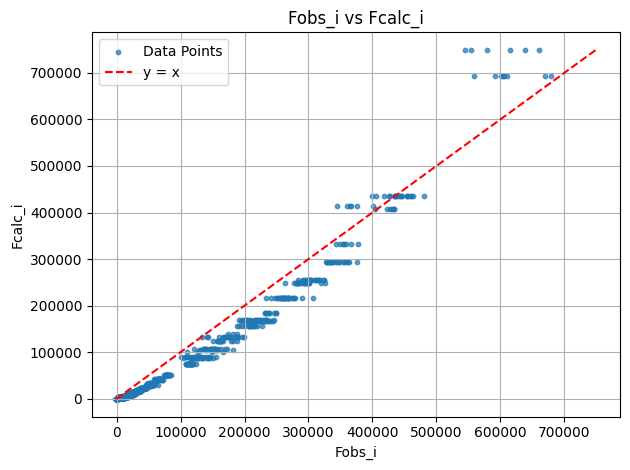

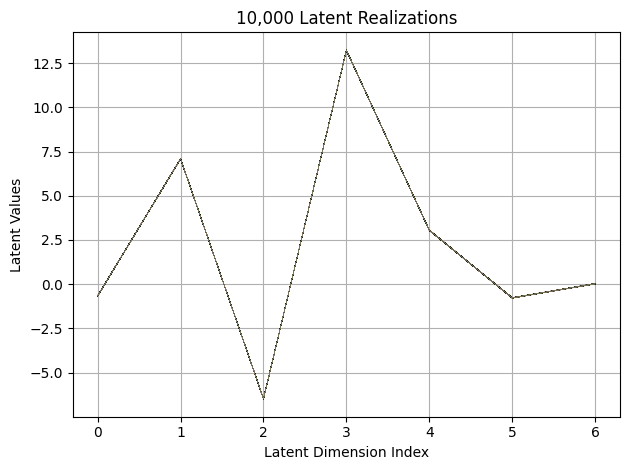

First 10 latent vectors from the VAE:
Sample 1: [-0.6602983474731445, 7.088420867919922, -6.488001346588135, 13.225492477416992, 3.057084083557129, -0.7723337411880493, 0.021911095827817917]
Sample 2: [-0.6677680611610413, 7.08983850479126, -6.4883599281311035, 13.221263885498047, 3.043055295944214, -0.7753512859344482, 0.01649419777095318]
Sample 3: [-0.66514652967453, 7.085139751434326, -6.4811506271362305, 13.24150562286377, 3.037722110748291, -0.7727864384651184, 0.023632049560546875]
Sample 4: [-0.661828339099884, 7.0897040367126465, -6.480361461639404, 13.239522933959961, 3.04272723197937, -0.7766543626785278, 0.020628012716770172]
Sample 5: [-0.6614221334457397, 7.097689151763916, -6.47465705871582, 13.21755313873291, 3.0566487312316895, -0.7695387005805969, 0.018036533147096634]
Sample 6: [-0.6605005860328674, 7.084294319152832, -6.485253810882568, 13.224306106567383, 3.0355758666992188, -0.7709861397743225, 0.03145691007375717]
Sample 7: [-0.6728702187538147, 7.089919567108154

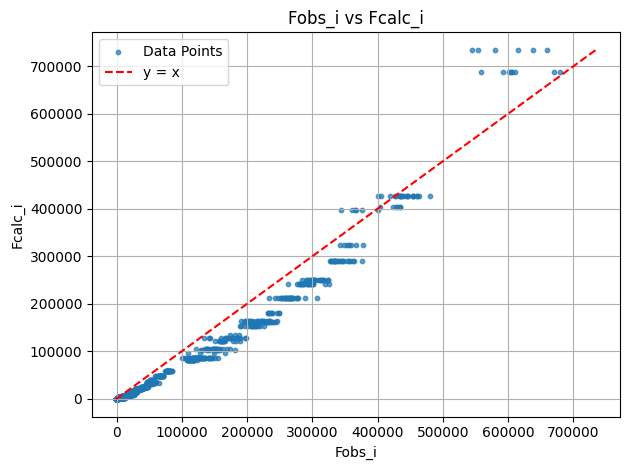

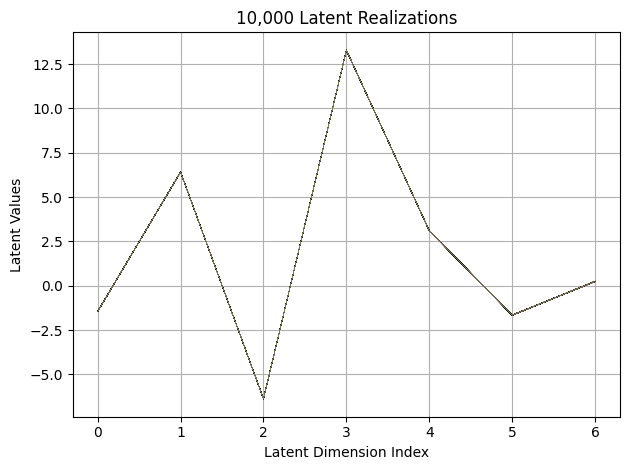

First 10 latent vectors from the VAE:
Sample 1: [-1.451607346534729, 6.403034210205078, -6.37238073348999, 13.283336639404297, 3.0974173545837402, -1.6700141429901123, 0.24878641963005066]
Sample 2: [-1.4544358253479004, 6.4073166847229, -6.371568202972412, 13.281233787536621, 3.1052868366241455, -1.656553864479065, 0.23908475041389465]
Sample 3: [-1.4597101211547852, 6.422045707702637, -6.371435165405273, 13.280811309814453, 3.0973477363586426, -1.6637933254241943, 0.24067600071430206]
Sample 4: [-1.4630104303359985, 6.4078474044799805, -6.36859655380249, 13.25914478302002, 3.1029624938964844, -1.6663625240325928, 0.23923622071743011]
Sample 5: [-1.4536651372909546, 6.418045997619629, -6.3657612800598145, 13.276849746704102, 3.1068882942199707, -1.6510518789291382, 0.25578632950782776]
Sample 6: [-1.4495600461959839, 6.411598205566406, -6.373459815979004, 13.272055625915527, 3.113670825958252, -1.6631420850753784, 0.24750956892967224]
Sample 7: [-1.4455734491348267, 6.411196708679199,

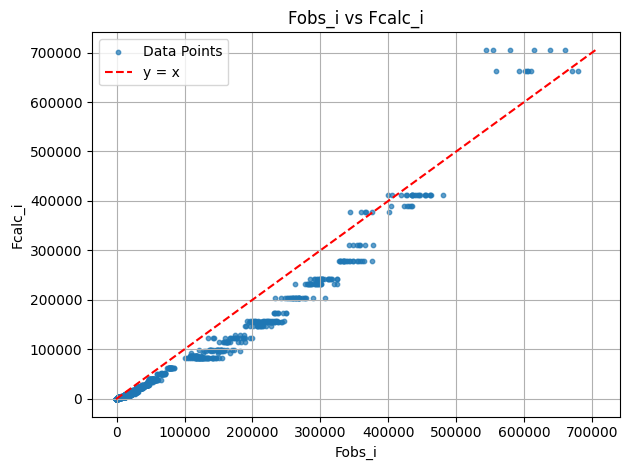

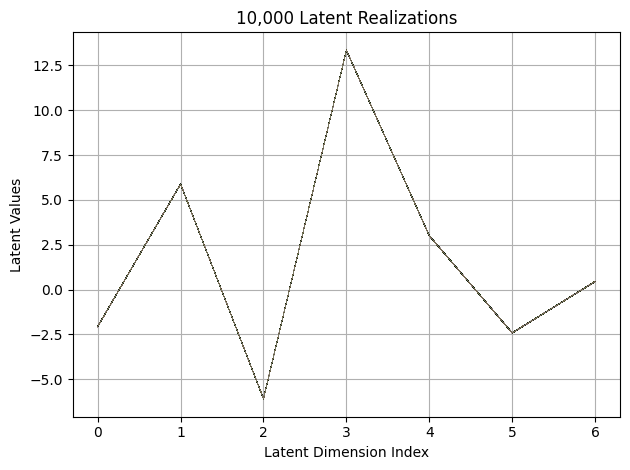

First 10 latent vectors from the VAE:
Sample 1: [-2.065157413482666, 5.887037754058838, -6.091961860656738, 13.346796035766602, 3.0111782550811768, -2.4227206707000732, 0.4692850410938263]
Sample 2: [-2.0714409351348877, 5.879343032836914, -6.083298683166504, 13.353307723999023, 2.9964234828948975, -2.4172403812408447, 0.4560592472553253]
Sample 3: [-2.0639431476593018, 5.889828205108643, -6.077377796173096, 13.348468780517578, 3.0028231143951416, -2.406813383102417, 0.44633257389068604]
Sample 4: [-2.0690343379974365, 5.886415004730225, -6.078531265258789, 13.350162506103516, 3.01629900932312, -2.4226255416870117, 0.45314744114875793]
Sample 5: [-2.052670955657959, 5.892028331756592, -6.094758033752441, 13.335883140563965, 3.0065243244171143, -2.4005391597747803, 0.43896862864494324]
Sample 6: [-2.058542490005493, 5.888749599456787, -6.09276819229126, 13.342423439025879, 3.0102288722991943, -2.4060442447662354, 0.46242696046829224]
Sample 7: [-2.055880308151245, 5.885050296783447, -6.

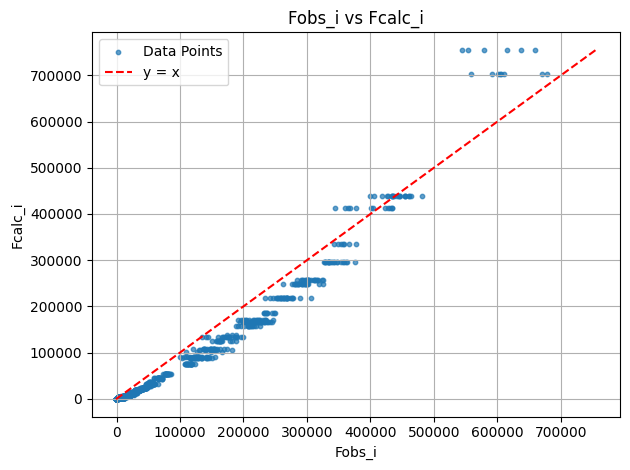

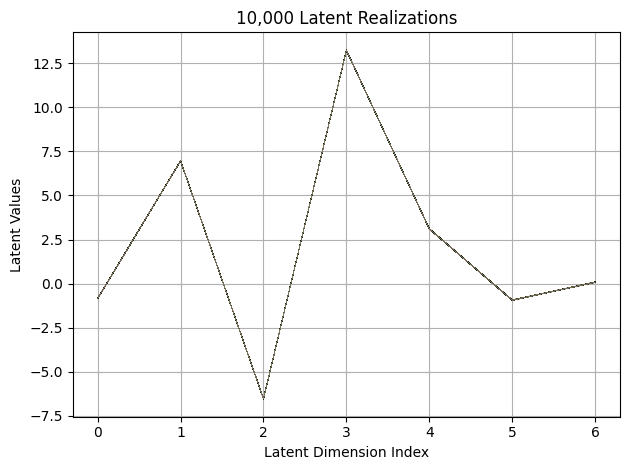

First 10 latent vectors from the VAE:
Sample 1: [-0.8415132761001587, 6.96037483215332, -6.524629592895508, 13.225730895996094, 3.0918030738830566, -0.9368160367012024, 0.0928204208612442]
Sample 2: [-0.842853844165802, 6.9709248542785645, -6.510986328125, 13.215045928955078, 3.1166346073150635, -0.9405033588409424, 0.07906655222177505]
Sample 3: [-0.8510305881500244, 6.946091651916504, -6.530910968780518, 13.219078063964844, 3.096856117248535, -0.930989682674408, 0.07037145644426346]
Sample 4: [-0.8411355018615723, 6.9580488204956055, -6.536980152130127, 13.223383903503418, 3.0988030433654785, -0.9334028363227844, 0.09050298482179642]
Sample 5: [-0.8470070958137512, 6.960105895996094, -6.521571159362793, 13.22956371307373, 3.108947515487671, -0.942806601524353, 0.07140350341796875]
Sample 6: [-0.8532505631446838, 6.957027912139893, -6.522888660430908, 13.222151756286621, 3.108614444732666, -0.9443122744560242, 0.08284292370080948]
Sample 7: [-0.8390587568283081, 6.963240623474121, -6.

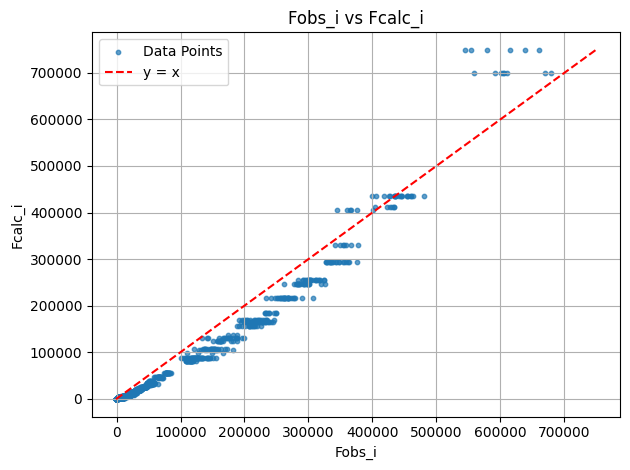

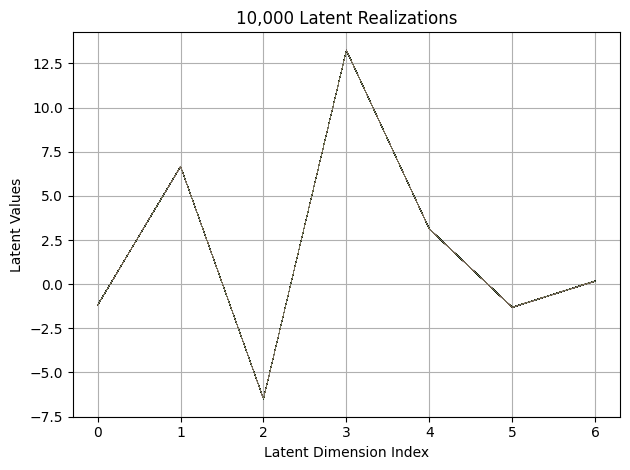

First 10 latent vectors from the VAE:
Sample 1: [-1.1846147775650024, 6.67624568939209, -6.4800238609313965, 13.245807647705078, 3.123732328414917, -1.3139466047286987, 0.18425342440605164]
Sample 2: [-1.1769944429397583, 6.671451568603516, -6.490551948547363, 13.236310958862305, 3.1260015964508057, -1.2989500761032104, 0.18092910945415497]
Sample 3: [-1.1972604990005493, 6.6638031005859375, -6.471745014190674, 13.236029624938965, 3.1271114349365234, -1.3081326484680176, 0.1777515411376953]
Sample 4: [-1.1924501657485962, 6.67949914932251, -6.4883131980896, 13.239880561828613, 3.126445770263672, -1.3085899353027344, 0.177374005317688]
Sample 5: [-1.1956201791763306, 6.674971580505371, -6.481517791748047, 13.237652778625488, 3.1394755840301514, -1.3035383224487305, 0.17729507386684418]
Sample 6: [-1.1882703304290771, 6.668276786804199, -6.4945268630981445, 13.240723609924316, 3.1264231204986572, -1.3109081983566284, 0.18135470151901245]
Sample 7: [-1.187849521636963, 6.668043613433838, 

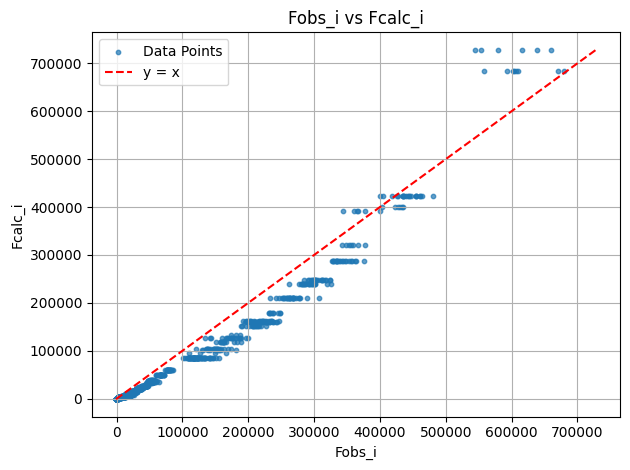

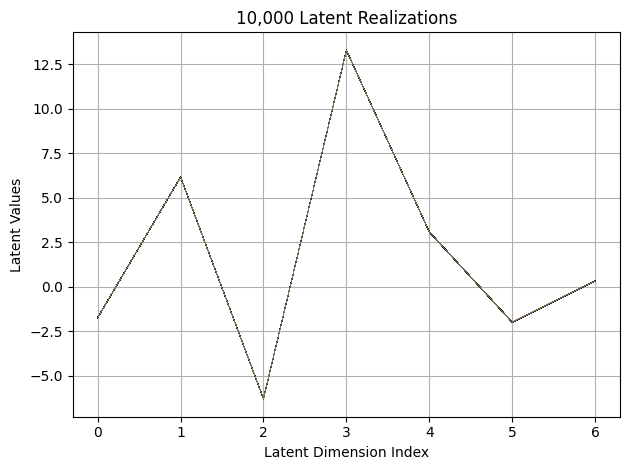

First 10 latent vectors from the VAE:
Sample 1: [-1.7334896326065063, 6.179877281188965, -6.289892196655273, 13.286951065063477, 3.0873324871063232, -1.9897512197494507, 0.33930280804634094]
Sample 2: [-1.7462670803070068, 6.176822662353516, -6.293584823608398, 13.296468734741211, 3.0791826248168945, -1.9883161783218384, 0.3379919230937958]
Sample 3: [-1.7405482530593872, 6.18304967880249, -6.287232398986816, 13.301163673400879, 3.096641778945923, -1.996389389038086, 0.34714463353157043]
Sample 4: [-1.733093500137329, 6.167212009429932, -6.281177520751953, 13.302955627441406, 3.0864808559417725, -1.993130087852478, 0.3259541988372803]
Sample 5: [-1.732587456703186, 6.161834239959717, -6.282013416290283, 13.308265686035156, 3.105804681777954, -1.9827470779418945, 0.3531701862812042]
Sample 6: [-1.7421685457229614, 6.1693949699401855, -6.285046577453613, 13.295319557189941, 3.089935779571533, -1.982954502105713, 0.3298175036907196]
Sample 7: [-1.735236644744873, 6.174403667449951, -6.282

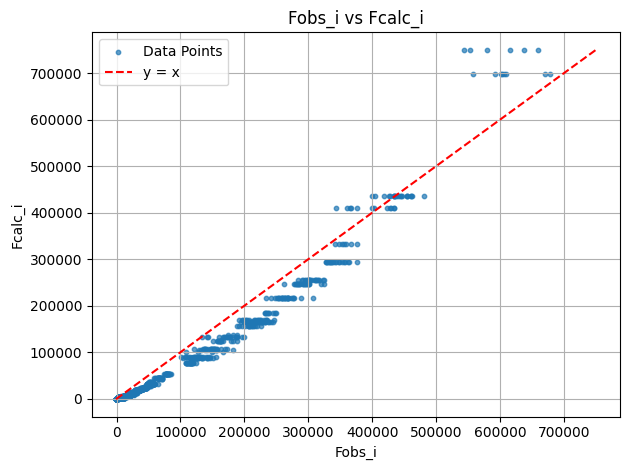

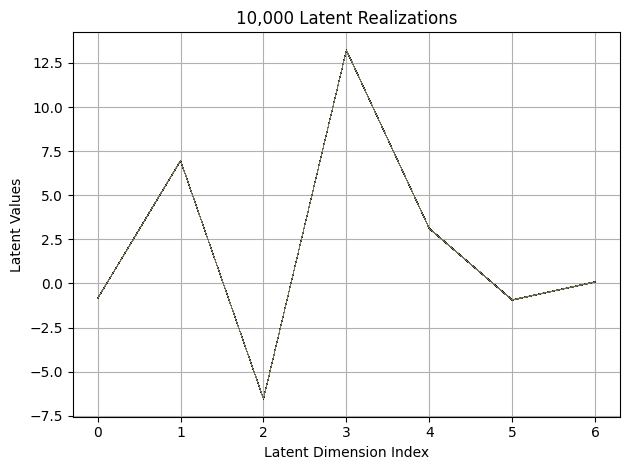

First 10 latent vectors from the VAE:
Sample 1: [-0.8410876989364624, 6.95348596572876, -6.545732021331787, 13.21631145477295, 3.1111385822296143, -0.9361693263053894, 0.09233835339546204]
Sample 2: [-0.8595821857452393, 6.941563606262207, -6.5444817543029785, 13.221750259399414, 3.1159255504608154, -0.948208212852478, 0.0909346342086792]
Sample 3: [-0.8493400812149048, 6.947529315948486, -6.55695104598999, 13.211634635925293, 3.111015796661377, -0.9364921450614929, 0.08511466532945633]
Sample 4: [-0.8598997592926025, 6.962338924407959, -6.544018268585205, 13.221765518188477, 3.1161272525787354, -0.935555100440979, 0.0705123171210289]
Sample 5: [-0.8396816253662109, 6.961491584777832, -6.5385637283325195, 13.22974967956543, 3.111896276473999, -0.9446673393249512, 0.08934526890516281]
Sample 6: [-0.8590954542160034, 6.963355541229248, -6.54142951965332, 13.205132484436035, 3.1114795207977295, -0.9412946105003357, 0.07738211750984192]
Sample 7: [-0.8588642477989197, 6.9580888748168945, -

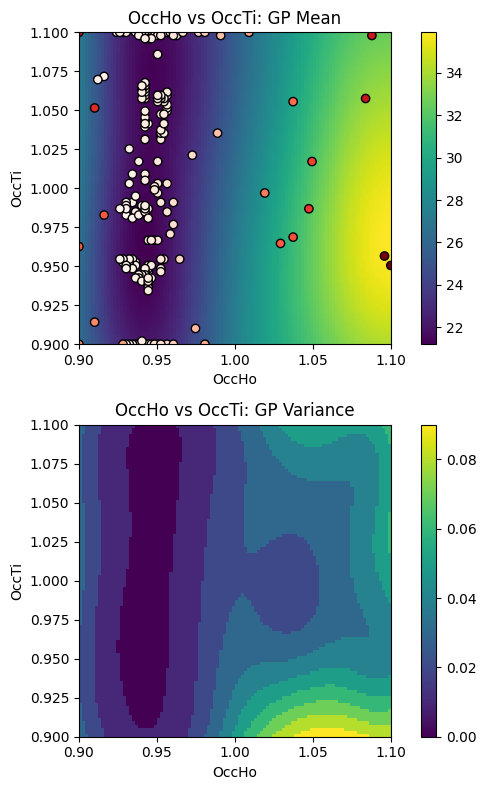

EI: [-1.00000000e+00  1.64468214e-03  1.66941900e-03 ...  1.22282887e-04
  1.49632571e-04  1.86222722e-04]
Function eval #190
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [0.8999999761581421, 1.0090909004211426]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.6921
initial chi^2 2.8323e+05 with 2596 obs.
New scale: 0.6879
Cycle 0: 0.73s, Chi**2: 1.4015e+05 for 2596 obs., Lambda: 0,  Delta: 0.505, SVD=0
New scale: 0.6879
Maximum shift/esd = -89.66

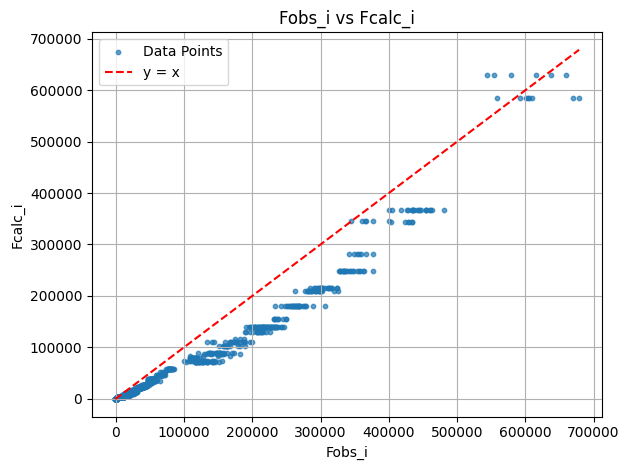

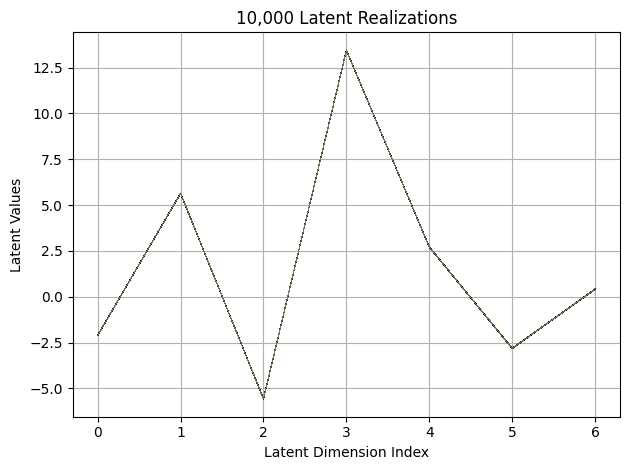

First 10 latent vectors from the VAE:
Sample 1: [-2.1013641357421875, 5.636677265167236, -5.5589141845703125, 13.447541236877441, 2.708127021789551, -2.79773211479187, 0.4187510311603546]
Sample 2: [-2.122591733932495, 5.631019115447998, -5.5693135261535645, 13.445292472839355, 2.713963747024536, -2.8195812702178955, 0.4040815234184265]
Sample 3: [-2.105882406234741, 5.653931617736816, -5.558612823486328, 13.456962585449219, 2.720395803451538, -2.815453052520752, 0.4204678535461426]
Sample 4: [-2.1064987182617188, 5.642162799835205, -5.564058303833008, 13.443452835083008, 2.706387758255005, -2.812598466873169, 0.4060421884059906]
Sample 5: [-2.105428457260132, 5.650205612182617, -5.559826850891113, 13.444304466247559, 2.7137956619262695, -2.828390121459961, 0.41547930240631104]
Sample 6: [-2.107358932495117, 5.646481037139893, -5.564181804656982, 13.43820571899414, 2.7125720977783203, -2.8061561584472656, 0.41985946893692017]
Sample 7: [-2.1126582622528076, 5.638495922088623, -5.562837

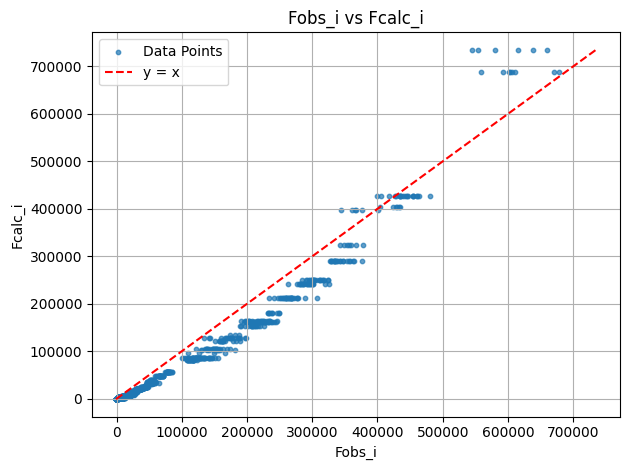

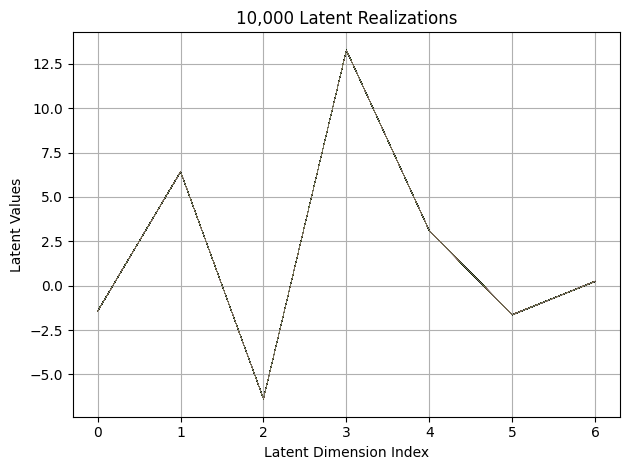

First 10 latent vectors from the VAE:
Sample 1: [-1.4320058822631836, 6.432775974273682, -6.368590831756592, 13.261968612670898, 3.103921413421631, -1.6247206926345825, 0.23786860704421997]
Sample 2: [-1.445792317390442, 6.415521144866943, -6.370919227600098, 13.277409553527832, 3.1084518432617188, -1.6436859369277954, 0.24372217059135437]
Sample 3: [-1.4341256618499756, 6.4231343269348145, -6.375619411468506, 13.277770042419434, 3.1111772060394287, -1.6413675546646118, 0.2399275004863739]
Sample 4: [-1.4397392272949219, 6.426245212554932, -6.363266944885254, 13.281132698059082, 3.1161882877349854, -1.6327722072601318, 0.2419518381357193]
Sample 5: [-1.4369831085205078, 6.424173831939697, -6.36977481842041, 13.263970375061035, 3.087117910385132, -1.6344424486160278, 0.23950840532779694]
Sample 6: [-1.441458821296692, 6.423802852630615, -6.3747944831848145, 13.273415565490723, 3.1074647903442383, -1.6543735265731812, 0.25372469425201416]
Sample 7: [-1.4420716762542725, 6.426218986511230

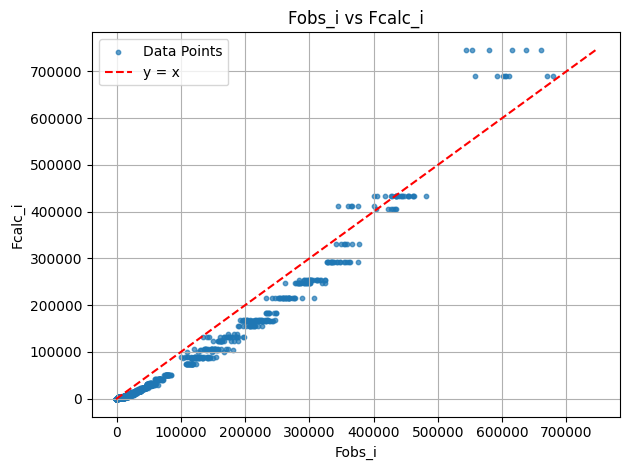

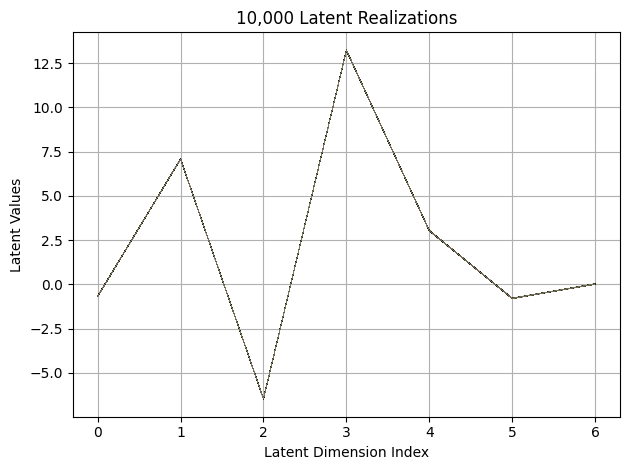

First 10 latent vectors from the VAE:
Sample 1: [-0.6585571765899658, 7.079534530639648, -6.459470272064209, 13.219536781311035, 3.0361247062683105, -0.7871205806732178, 0.014011039398610592]
Sample 2: [-0.6641508936882019, 7.078597068786621, -6.454026699066162, 13.225780487060547, 3.0370004177093506, -0.7780656814575195, 0.02467312105000019]
Sample 3: [-0.6594448685646057, 7.0737714767456055, -6.47227668762207, 13.241755485534668, 3.0358283519744873, -0.794170081615448, 0.03249788284301758]
Sample 4: [-0.6673151254653931, 7.098032474517822, -6.453629970550537, 13.237226486206055, 3.0467536449432373, -0.7841804623603821, 0.030259575694799423]
Sample 5: [-0.6735690832138062, 7.072077751159668, -6.460847854614258, 13.236684799194336, 3.034724712371826, -0.7847397923469543, 0.02823285013437271]
Sample 6: [-0.6772205233573914, 7.075234413146973, -6.45469856262207, 13.217738151550293, 3.043088674545288, -0.796052873134613, 0.02369276061654091]
Sample 7: [-0.6543184518814087, 7.0867948532104

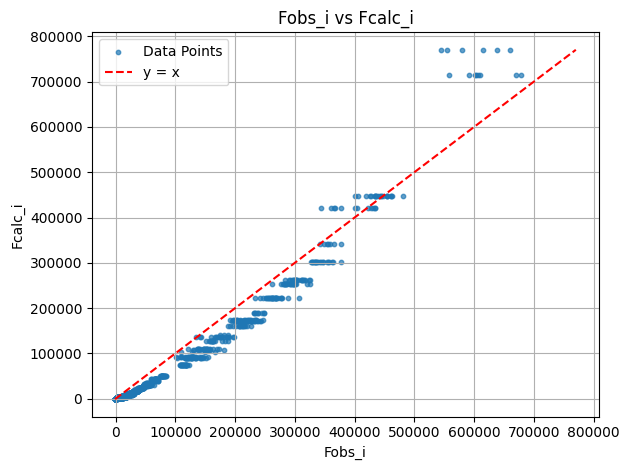

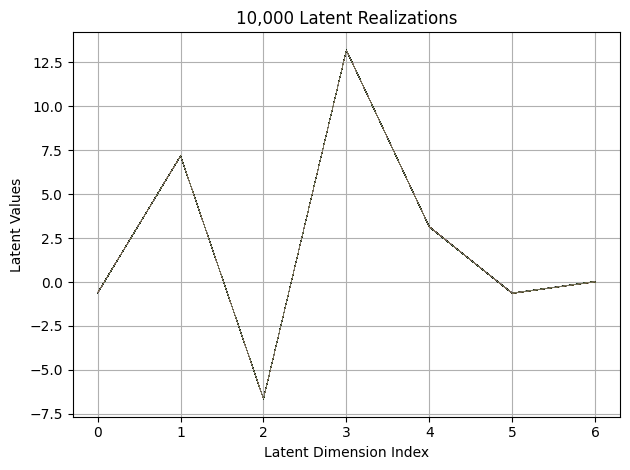

First 10 latent vectors from the VAE:
Sample 1: [-0.6090101003646851, 7.181577682495117, -6.647094249725342, 13.195981979370117, 3.128171443939209, -0.6334526538848877, 0.024580609053373337]
Sample 2: [-0.610719621181488, 7.190781116485596, -6.65576696395874, 13.18584156036377, 3.135169744491577, -0.6360984444618225, 0.023110272362828255]
Sample 3: [-0.6082816123962402, 7.1881422996521, -6.635701656341553, 13.194319725036621, 3.133425235748291, -0.6331580877304077, 0.015477653592824936]
Sample 4: [-0.618869423866272, 7.189962387084961, -6.645406246185303, 13.198881149291992, 3.145524024963379, -0.6356289982795715, 0.021067669615149498]
Sample 5: [-0.6154448390007019, 7.176559925079346, -6.6551055908203125, 13.19559383392334, 3.134087324142456, -0.6345039010047913, 0.027592865750193596]
Sample 6: [-0.6211134195327759, 7.176556587219238, -6.6399736404418945, 13.182415008544922, 3.137737989425659, -0.6387184262275696, 0.006929558701813221]
Sample 7: [-0.6142913699150085, 7.17702054977417,

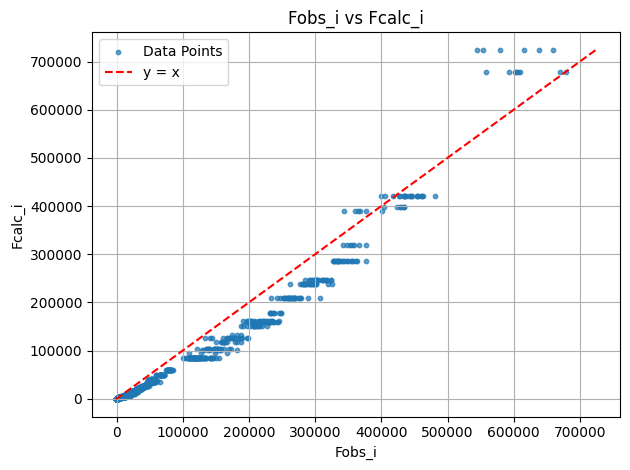

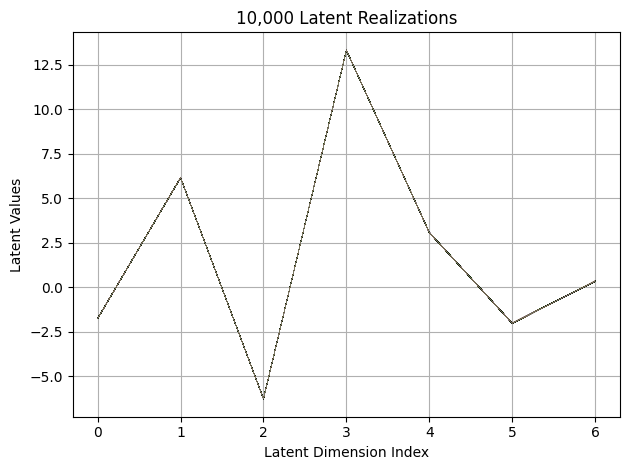

First 10 latent vectors from the VAE:
Sample 1: [-1.7442342042922974, 6.156096935272217, -6.267043590545654, 13.31011962890625, 3.074772834777832, -2.018921136856079, 0.342784583568573]
Sample 2: [-1.7497563362121582, 6.159977912902832, -6.256300926208496, 13.310138702392578, 3.0779008865356445, -2.0254108905792236, 0.33689552545547485]
Sample 3: [-1.7566864490509033, 6.157678604125977, -6.2550950050354, 13.310749053955078, 3.0764381885528564, -2.0154778957366943, 0.3303833305835724]
Sample 4: [-1.7586870193481445, 6.154274940490723, -6.261395454406738, 13.307905197143555, 3.0804264545440674, -2.015955924987793, 0.3225564658641815]
Sample 5: [-1.7690311670303345, 6.149062633514404, -6.246292591094971, 13.304929733276367, 3.078786849975586, -2.0158965587615967, 0.3370625972747803]
Sample 6: [-1.7436635494232178, 6.148133277893066, -6.247932434082031, 13.306825637817383, 3.0739309787750244, -2.0223686695098877, 0.3313702642917633]
Sample 7: [-1.7542973756790161, 6.133053302764893, -6.261

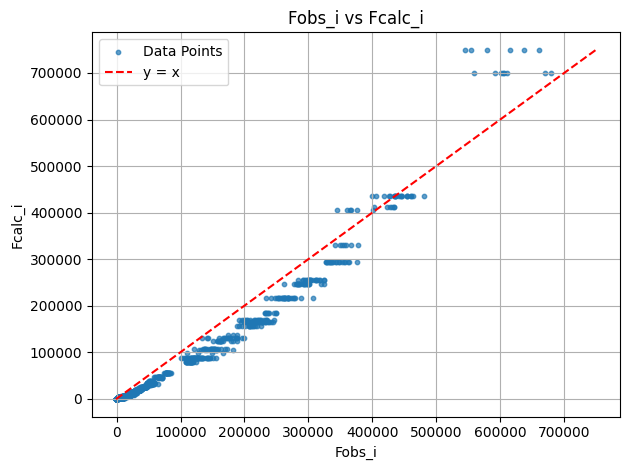

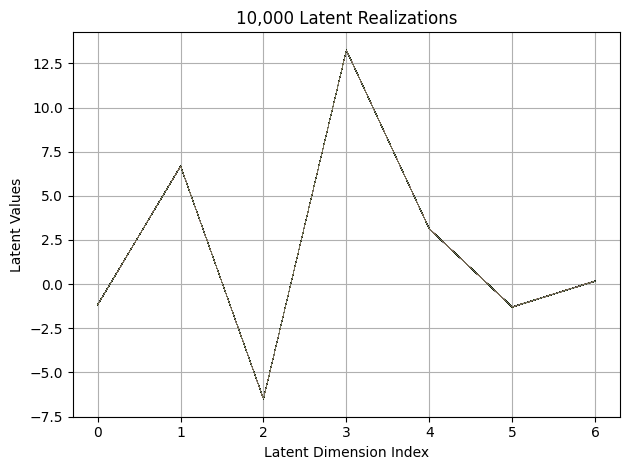

First 10 latent vectors from the VAE:
Sample 1: [-1.174250602722168, 6.6813554763793945, -6.492978572845459, 13.2483549118042, 3.1394729614257812, -1.2877967357635498, 0.16913023591041565]
Sample 2: [-1.170413851737976, 6.684830665588379, -6.49568510055542, 13.244516372680664, 3.1392550468444824, -1.2934139966964722, 0.18556421995162964]
Sample 3: [-1.1670860052108765, 6.679166793823242, -6.48686408996582, 13.240086555480957, 3.1300125122070312, -1.2876521348953247, 0.16798533499240875]
Sample 4: [-1.1628175973892212, 6.691352844238281, -6.4925923347473145, 13.23754596710205, 3.1210994720458984, -1.3015397787094116, 0.17790672183036804]
Sample 5: [-1.1728386878967285, 6.688042163848877, -6.494402885437012, 13.249222755432129, 3.1193454265594482, -1.2829946279525757, 0.1714993566274643]
Sample 6: [-1.1737308502197266, 6.67189359664917, -6.488101005554199, 13.246679306030273, 3.135368585586548, -1.3048644065856934, 0.1678171306848526]
Sample 7: [-1.1797003746032715, 6.6767659187316895, -

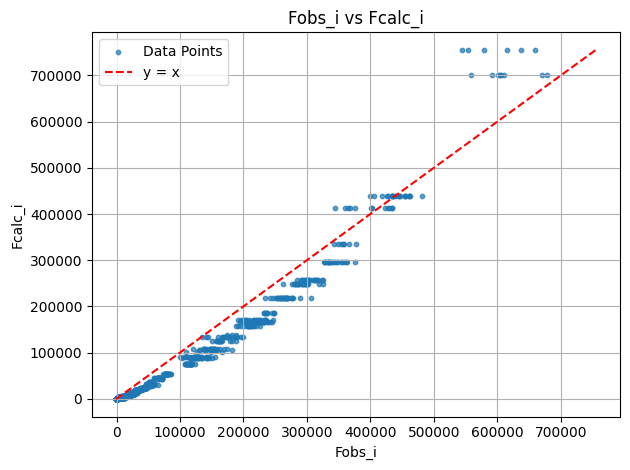

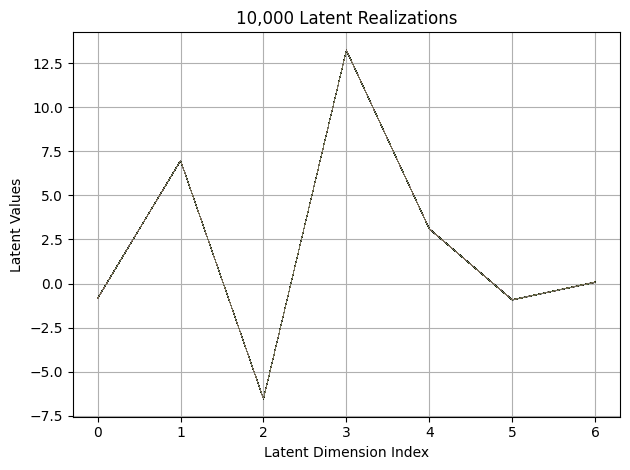

First 10 latent vectors from the VAE:
Sample 1: [-0.8153815865516663, 6.969706058502197, -6.540749549865723, 13.224471092224121, 3.1081972122192383, -0.9208626747131348, 0.07718931138515472]
Sample 2: [-0.8247486352920532, 6.969119071960449, -6.531081676483154, 13.226542472839355, 3.1020936965942383, -0.9322401881217957, 0.055806342512369156]
Sample 3: [-0.8288607597351074, 6.9628777503967285, -6.521204948425293, 13.217538833618164, 3.100348949432373, -0.9233651757240295, 0.079159215092659]
Sample 4: [-0.8273001909255981, 6.980963230133057, -6.534019470214844, 13.226494789123535, 3.0981922149658203, -0.9239672422409058, 0.08419768512248993]
Sample 5: [-0.8363156914710999, 6.976433753967285, -6.531813621520996, 13.223539352416992, 3.0824062824249268, -0.9144794344902039, 0.07131290435791016]
Sample 6: [-0.8250061273574829, 6.97150182723999, -6.539237976074219, 13.22480297088623, 3.098271369934082, -0.9272657632827759, 0.07758311182260513]
Sample 7: [-0.8258222937583923, 6.97673177719116

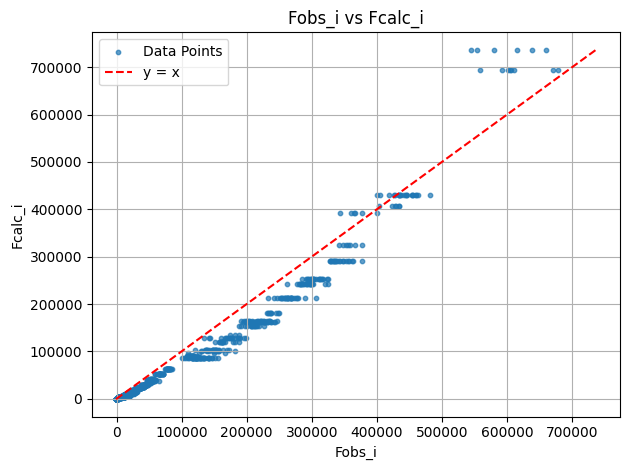

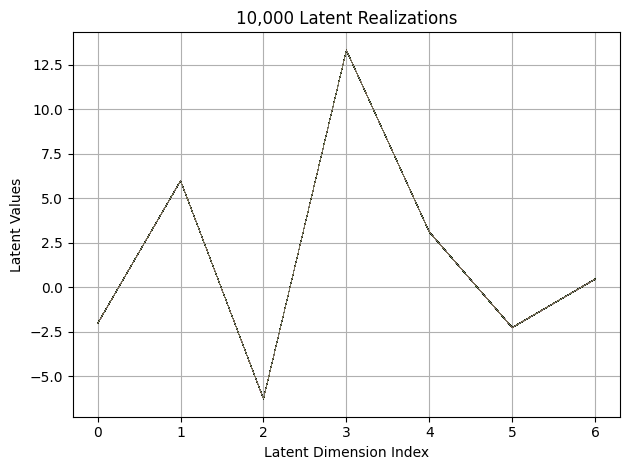

First 10 latent vectors from the VAE:
Sample 1: [-2.0298287868499756, 5.980135917663574, -6.253303050994873, 13.301121711730957, 3.1073057651519775, -2.264261484146118, 0.46269720792770386]
Sample 2: [-2.02404522895813, 5.985088348388672, -6.277813911437988, 13.313352584838867, 3.099492311477661, -2.265730381011963, 0.44762519001960754]
Sample 3: [-2.028329849243164, 5.971895694732666, -6.270158767700195, 13.31096076965332, 3.1046392917633057, -2.2521133422851562, 0.4480118155479431]
Sample 4: [-2.0298502445220947, 5.98396635055542, -6.267215251922607, 13.316607475280762, 3.10002064704895, -2.2665655612945557, 0.4688531458377838]
Sample 5: [-2.0335280895233154, 5.992403984069824, -6.262168884277344, 13.31119441986084, 3.1090340614318848, -2.2700281143188477, 0.4511575698852539]
Sample 6: [-2.0289931297302246, 5.978235244750977, -6.259376049041748, 13.315993309020996, 3.105437994003296, -2.2770192623138428, 0.4564549922943115]
Sample 7: [-2.0329415798187256, 5.974603176116943, -6.266603

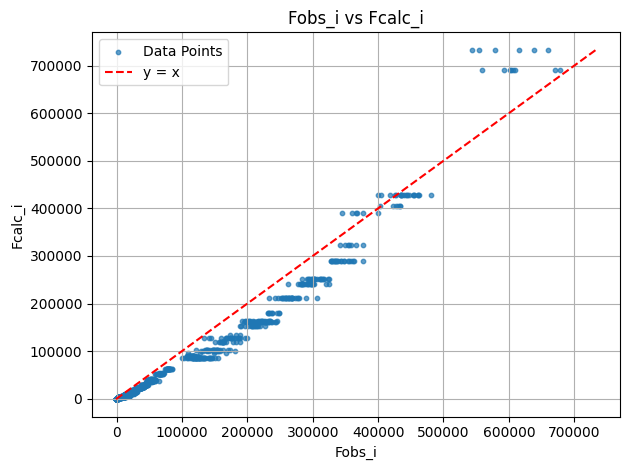

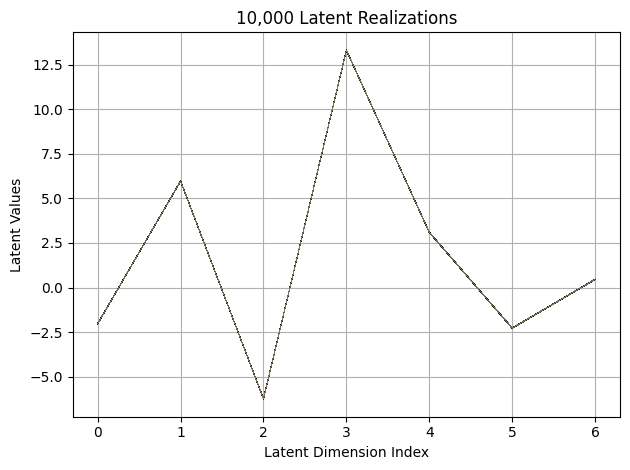

First 10 latent vectors from the VAE:
Sample 1: [-2.0281529426574707, 5.981024265289307, -6.235157012939453, 13.318455696105957, 3.091247320175171, -2.278658628463745, 0.45038482546806335]
Sample 2: [-2.029374361038208, 5.973561763763428, -6.235391616821289, 13.318816184997559, 3.1030452251434326, -2.2800557613372803, 0.4424816370010376]
Sample 3: [-2.0210258960723877, 5.972343444824219, -6.242949962615967, 13.319573402404785, 3.094388246536255, -2.2767257690429688, 0.45129185914993286]
Sample 4: [-2.038391590118408, 5.969472408294678, -6.243232727050781, 13.316374778747559, 3.087681770324707, -2.2799370288848877, 0.4393605589866638]
Sample 5: [-2.031743049621582, 5.971074104309082, -6.241998195648193, 13.314358711242676, 3.0962274074554443, -2.2871158123016357, 0.45423105359077454]
Sample 6: [-2.0325968265533447, 5.970190525054932, -6.250392913818359, 13.315812110900879, 3.093698740005493, -2.2839901447296143, 0.46282148361206055]
Sample 7: [-2.0318188667297363, 5.975346565246582, -6.

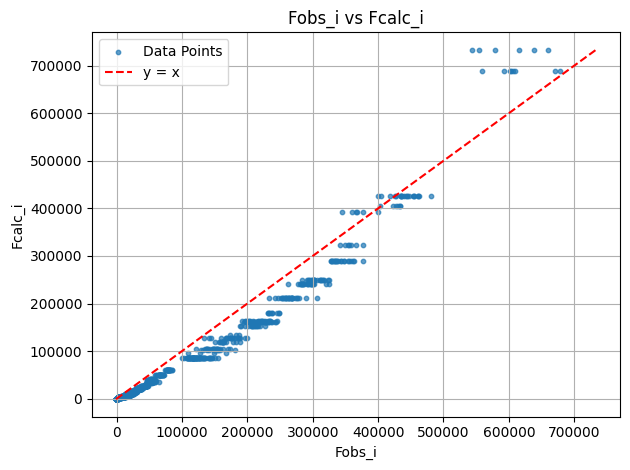

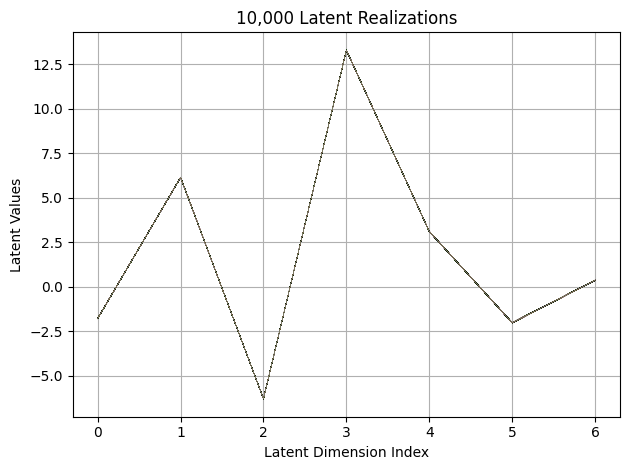

First 10 latent vectors from the VAE:
Sample 1: [-1.7945986986160278, 6.144685745239258, -6.296005725860596, 13.309167861938477, 3.0958945751190186, -2.022329330444336, 0.3631751835346222]
Sample 2: [-1.7911005020141602, 6.150084495544434, -6.288046360015869, 13.301207542419434, 3.107820749282837, -2.0312435626983643, 0.36210528016090393]
Sample 3: [-1.7900878190994263, 6.144374847412109, -6.283017635345459, 13.297593116760254, 3.0995397567749023, -2.0306198596954346, 0.35663706064224243]
Sample 4: [-1.8037282228469849, 6.136521339416504, -6.302367687225342, 13.299461364746094, 3.098087787628174, -2.0281105041503906, 0.35898783802986145]
Sample 5: [-1.7878422737121582, 6.158266544342041, -6.312889099121094, 13.310297966003418, 3.095791816711426, -2.028236150741577, 0.3550468981266022]
Sample 6: [-1.780281662940979, 6.141666412353516, -6.303638458251953, 13.30209732055664, 3.098632574081421, -2.0311832427978516, 0.36035972833633423]
Sample 7: [-1.7944735288619995, 6.136646270751953, -6.

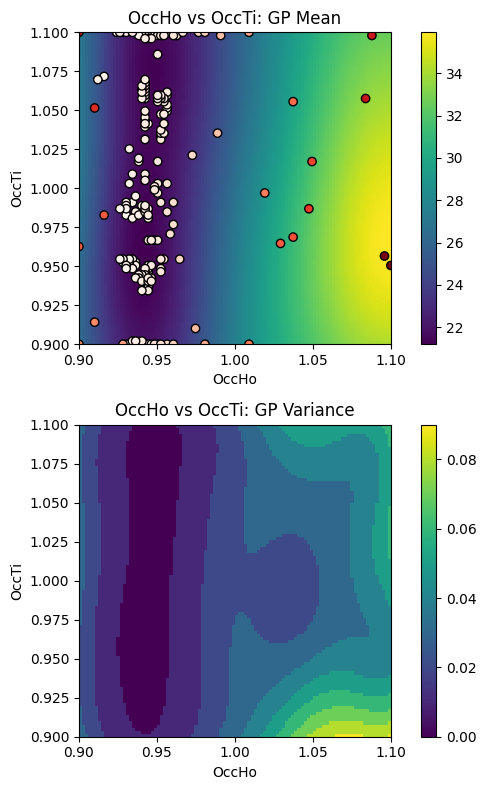

EI: [-1.00000000e+00  1.76488422e-03  1.78713165e-03 ...  1.26714003e-04
  1.54768932e-04  1.92230451e-04]
Function eval #200
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [1.0676767826080322, 0.9444444179534912]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7543
initial chi^2 1.9434e+05 with 2596 obs.
New scale: 0.7516
Cycle 0: 0.59s, Chi**2: 1.5385e+05 for 2596 obs., Lambda: 0,  Delta: 0.208, SVD=0
New scale: 0.7516
Maximum shift/esd = -54.52

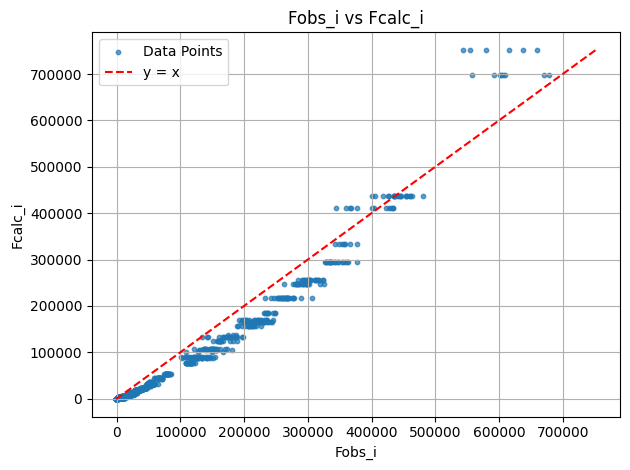

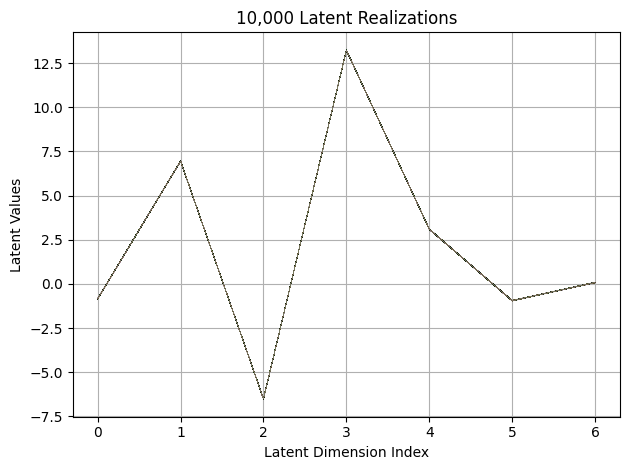

First 10 latent vectors from the VAE:
Sample 1: [-0.8446923494338989, 6.950554847717285, -6.517502307891846, 13.222352981567383, 3.0814108848571777, -0.9400132894515991, 0.07850653678178787]
Sample 2: [-0.8434889316558838, 6.951056957244873, -6.508013725280762, 13.228519439697266, 3.084599494934082, -0.944852888584137, 0.07734952121973038]
Sample 3: [-0.8364692330360413, 6.941935062408447, -6.505910396575928, 13.230334281921387, 3.1069884300231934, -0.9473379254341125, 0.08685103803873062]
Sample 4: [-0.8456700444221497, 6.94594669342041, -6.507573127746582, 13.238802909851074, 3.0947329998016357, -0.9533701539039612, 0.07513714581727982]
Sample 5: [-0.8416501879692078, 6.955569744110107, -6.511822700500488, 13.2357759475708, 3.092609405517578, -0.9501059651374817, 0.07009386271238327]
Sample 6: [-0.8613327741622925, 6.948204517364502, -6.506625175476074, 13.243278503417969, 3.1013994216918945, -0.9629563689231873, 0.06436577439308167]
Sample 7: [-0.8470770716667175, 6.956120491027832,

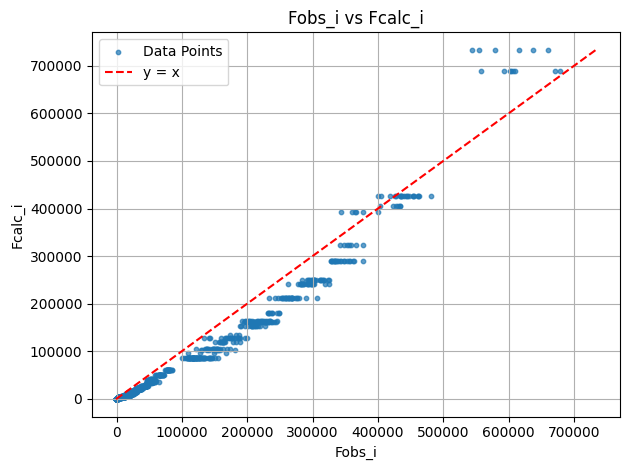

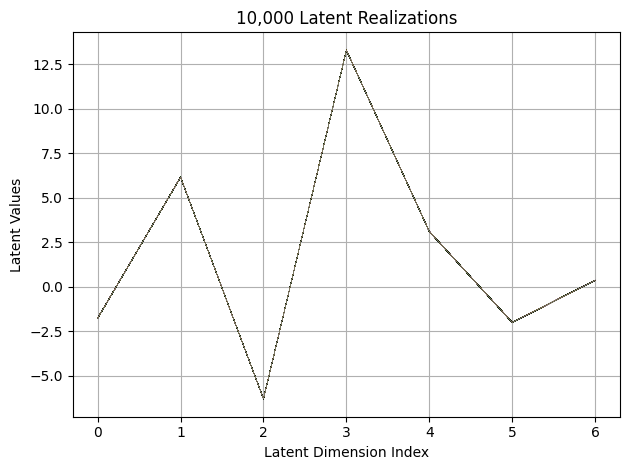

First 10 latent vectors from the VAE:
Sample 1: [-1.7638548612594604, 6.16123104095459, -6.309138298034668, 13.285093307495117, 3.1140389442443848, -2.0049822330474854, 0.3520682156085968]
Sample 2: [-1.777955412864685, 6.163296699523926, -6.300017833709717, 13.297447204589844, 3.1112663745880127, -2.0092523097991943, 0.3578316271305084]
Sample 3: [-1.7631586790084839, 6.151413917541504, -6.29745626449585, 13.297733306884766, 3.107621908187866, -2.003903865814209, 0.3525829613208771]
Sample 4: [-1.771319031715393, 6.170553207397461, -6.30075216293335, 13.294631004333496, 3.0927975177764893, -2.0073328018188477, 0.354284405708313]
Sample 5: [-1.7830332517623901, 6.1671648025512695, -6.308535099029541, 13.296181678771973, 3.103052854537964, -2.006471633911133, 0.35918670892715454]
Sample 6: [-1.766409158706665, 6.171635627746582, -6.311936378479004, 13.29427719116211, 3.10595965385437, -2.004695415496826, 0.36508849263191223]
Sample 7: [-1.7736518383026123, 6.154111385345459, -6.30590915

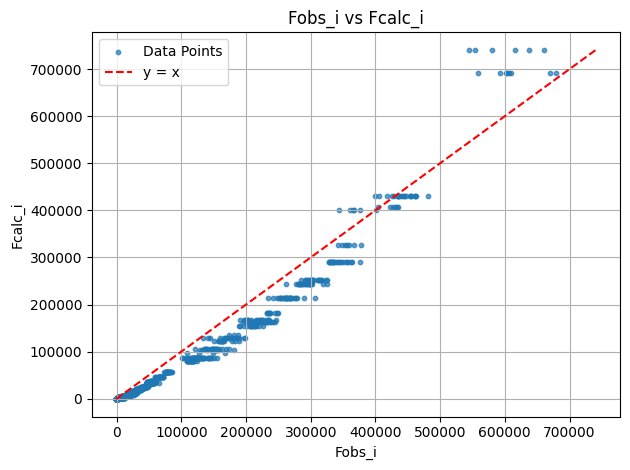

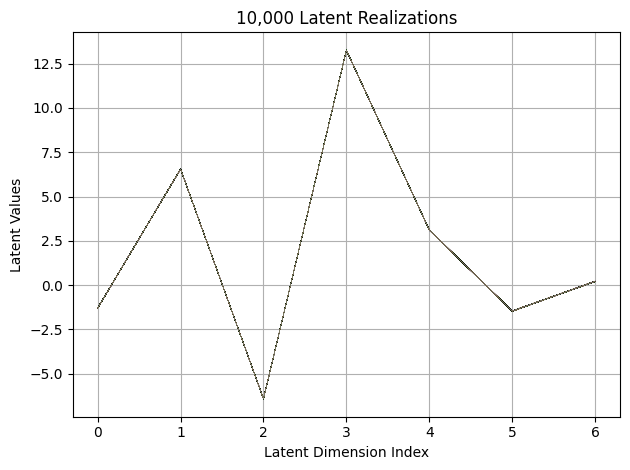

First 10 latent vectors from the VAE:
Sample 1: [-1.2945846319198608, 6.557503700256348, -6.419270038604736, 13.258068084716797, 3.105442523956299, -1.4762614965438843, 0.22553852200508118]
Sample 2: [-1.3108785152435303, 6.552372932434082, -6.421753406524658, 13.25417423248291, 3.111001968383789, -1.4681962728500366, 0.20071488618850708]
Sample 3: [-1.2935625314712524, 6.5446038246154785, -6.41526460647583, 13.243221282958984, 3.0951528549194336, -1.4709373712539673, 0.20709224045276642]
Sample 4: [-1.3032277822494507, 6.556636333465576, -6.421998977661133, 13.261085510253906, 3.108384847640991, -1.4561396837234497, 0.20450039207935333]
Sample 5: [-1.3054215908050537, 6.557106971740723, -6.428869247436523, 13.247320175170898, 3.100569725036621, -1.4701467752456665, 0.2127535194158554]
Sample 6: [-1.3141570091247559, 6.54412317276001, -6.409352779388428, 13.252317428588867, 3.1115987300872803, -1.4705995321273804, 0.2074977308511734]
Sample 7: [-1.2998836040496826, 6.553883075714111, -

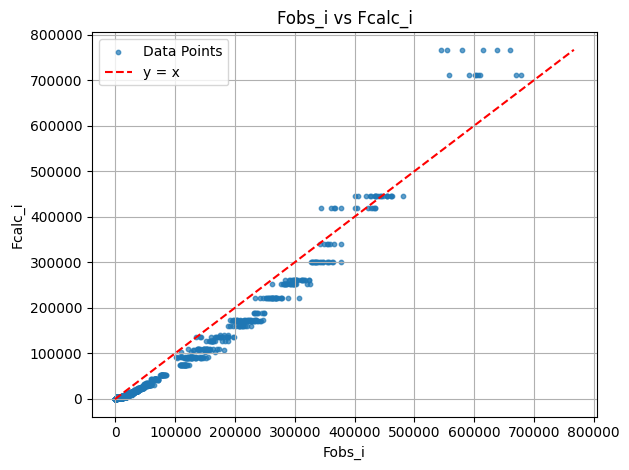

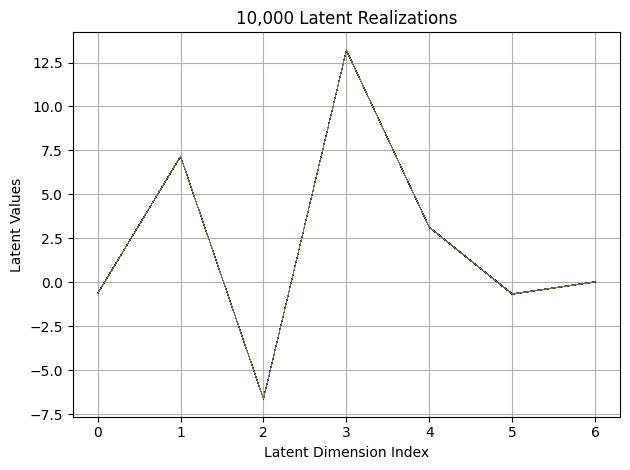

First 10 latent vectors from the VAE:
Sample 1: [-0.6446722149848938, 7.164124011993408, -6.62526798248291, 13.206727981567383, 3.125966787338257, -0.6689004302024841, 0.024012140929698944]
Sample 2: [-0.6337566375732422, 7.168866157531738, -6.628705978393555, 13.208269119262695, 3.1392340660095215, -0.6539385914802551, 0.033274538815021515]
Sample 3: [-0.6307079195976257, 7.163894176483154, -6.62562370300293, 13.204203605651855, 3.141249895095825, -0.6652000546455383, 0.027307741343975067]
Sample 4: [-0.6341431140899658, 7.1655778884887695, -6.618709087371826, 13.193514823913574, 3.123602867126465, -0.660149097442627, 0.0237769465893507]
Sample 5: [-0.6281440854072571, 7.154017448425293, -6.625668048858643, 13.201528549194336, 3.127065420150757, -0.6708244681358337, 0.021884672343730927]
Sample 6: [-0.648876965045929, 7.14457368850708, -6.6269073486328125, 13.199559211730957, 3.1289048194885254, -0.6648090481758118, 0.026727620512247086]
Sample 7: [-0.633550763130188, 7.17053365707397

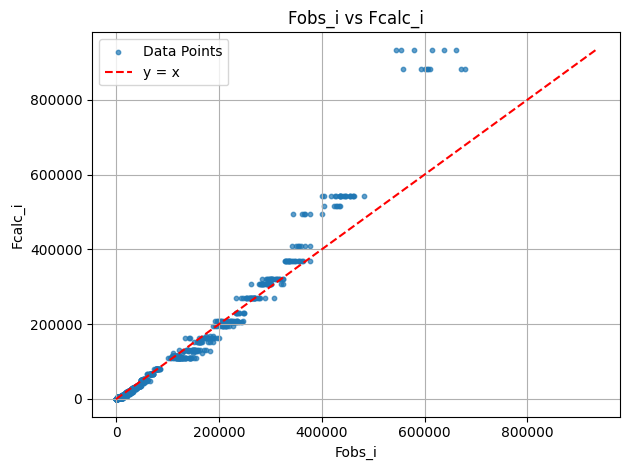

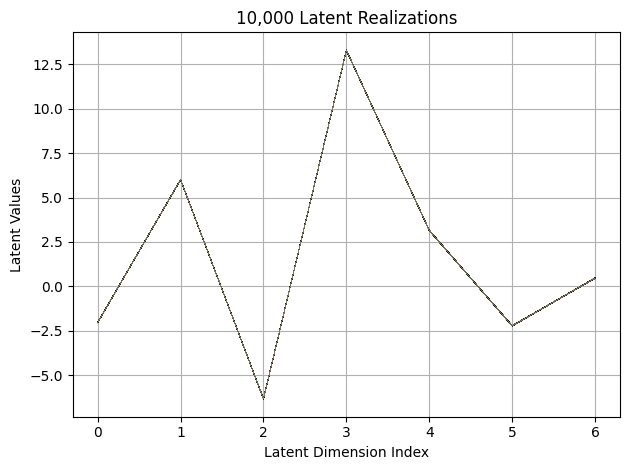

First 10 latent vectors from the VAE:
Sample 1: [-2.032670497894287, 6.0138654708862305, -6.340395450592041, 13.291269302368164, 3.1539628505706787, -2.2124574184417725, 0.47475960850715637]
Sample 2: [-2.04241681098938, 5.996445178985596, -6.33517599105835, 13.292693138122559, 3.145961046218872, -2.2272181510925293, 0.47397077083587646]
Sample 3: [-2.034944534301758, 6.003595352172852, -6.328620910644531, 13.300859451293945, 3.1479437351226807, -2.2092607021331787, 0.4760211110115051]
Sample 4: [-2.0334713459014893, 6.002712249755859, -6.351258277893066, 13.297818183898926, 3.1473934650421143, -2.2223048210144043, 0.4665450155735016]
Sample 5: [-2.0368378162384033, 6.011318683624268, -6.337012767791748, 13.305359840393066, 3.135451078414917, -2.219907283782959, 0.4745126962661743]
Sample 6: [-2.0397050380706787, 6.011838912963867, -6.338176250457764, 13.29542350769043, 3.149665117263794, -2.226381301879883, 0.46153557300567627]
Sample 7: [-2.0404810905456543, 6.003419876098633, -6.332

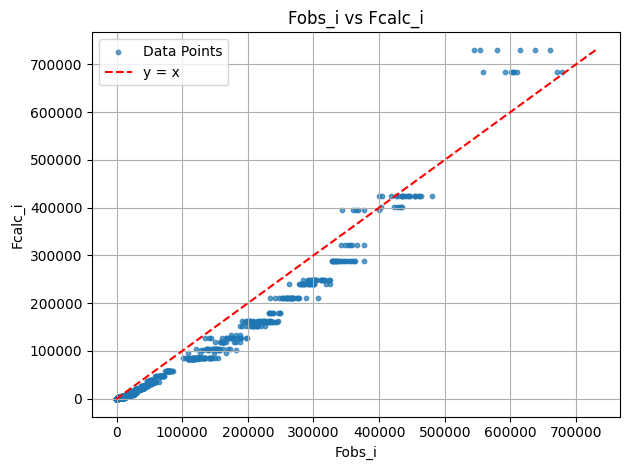

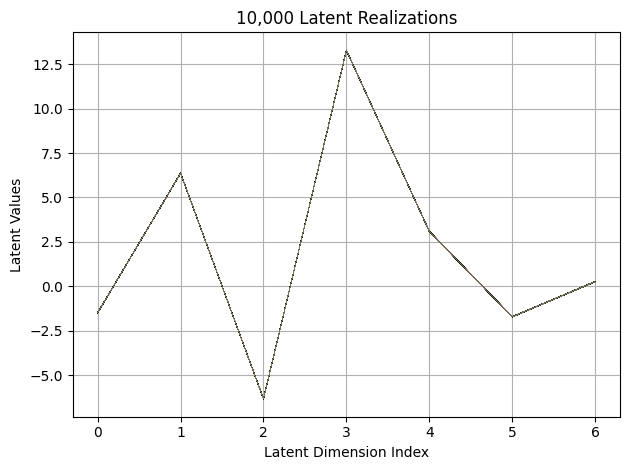

First 10 latent vectors from the VAE:
Sample 1: [-1.4944498538970947, 6.359996318817139, -6.345444202423096, 13.274836540222168, 3.090175151824951, -1.7348519563674927, 0.24234652519226074]
Sample 2: [-1.4859538078308105, 6.371750354766846, -6.337220191955566, 13.28080940246582, 3.097444772720337, -1.7305418252944946, 0.2597388029098511]
Sample 3: [-1.4975069761276245, 6.370432376861572, -6.3480706214904785, 13.293622970581055, 3.088040828704834, -1.7245852947235107, 0.2721254825592041]
Sample 4: [-1.5016605854034424, 6.35792875289917, -6.344659805297852, 13.27800178527832, 3.0955982208251953, -1.7158420085906982, 0.25388669967651367]
Sample 5: [-1.481624960899353, 6.358327865600586, -6.339578151702881, 13.280714988708496, 3.0984652042388916, -1.7079401016235352, 0.26576581597328186]
Sample 6: [-1.5033032894134521, 6.3582305908203125, -6.342772483825684, 13.292941093444824, 3.1004865169525146, -1.7159167528152466, 0.266899973154068]
Sample 7: [-1.4948782920837402, 6.366252422332764, -6

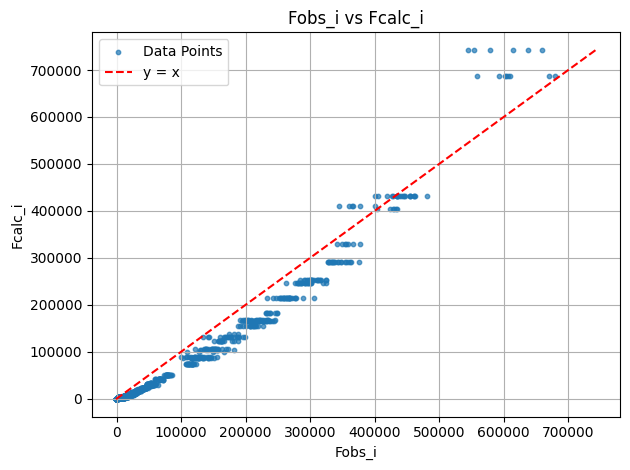

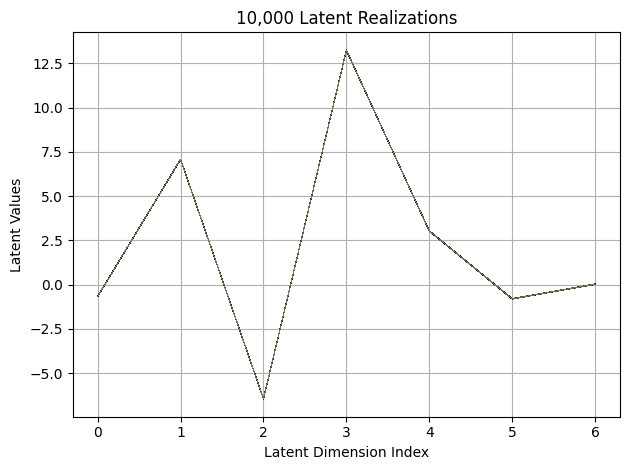

First 10 latent vectors from the VAE:
Sample 1: [-0.6628623008728027, 7.068826198577881, -6.437601566314697, 13.221914291381836, 3.0336592197418213, -0.8045780658721924, 0.02214181050658226]
Sample 2: [-0.6788842082023621, 7.0611348152160645, -6.43558406829834, 13.244566917419434, 3.0243020057678223, -0.7950047254562378, 0.029806314036250114]
Sample 3: [-0.6698510050773621, 7.065370082855225, -6.446458339691162, 13.2379150390625, 3.0248849391937256, -0.7982863187789917, 0.022866645827889442]
Sample 4: [-0.6705517768859863, 7.073554039001465, -6.439578056335449, 13.218507766723633, 3.028101682662964, -0.792131781578064, 0.04352912679314613]
Sample 5: [-0.6731336116790771, 7.056056976318359, -6.451742649078369, 13.23195743560791, 3.0228099822998047, -0.7988793849945068, 0.03484959900379181]
Sample 6: [-0.6761878728866577, 7.063398361206055, -6.446850299835205, 13.232502937316895, 3.0188634395599365, -0.8057640194892883, 0.027413079515099525]
Sample 7: [-0.6685557961463928, 7.062780857086

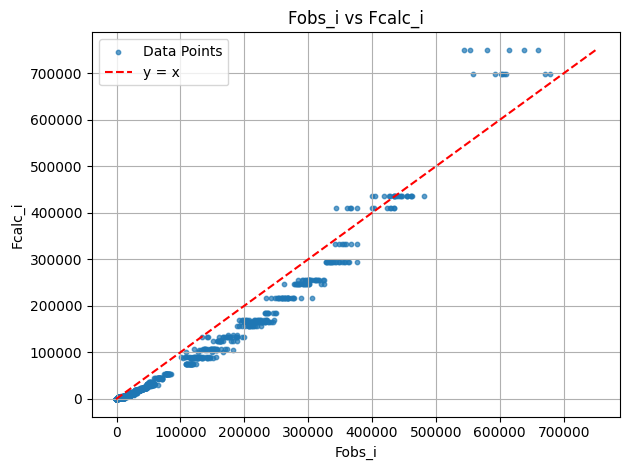

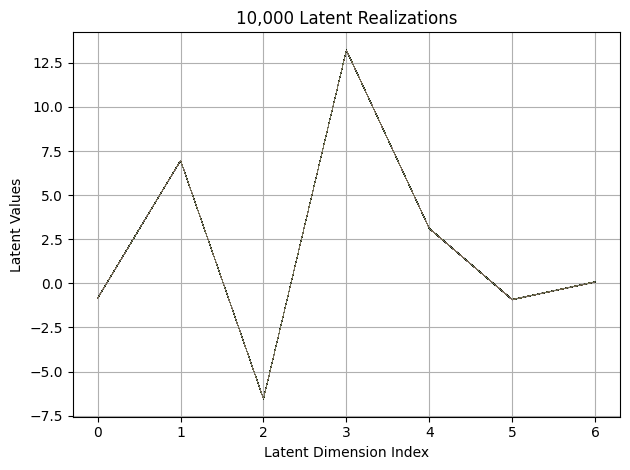

First 10 latent vectors from the VAE:
Sample 1: [-0.8453997373580933, 6.973623752593994, -6.557482719421387, 13.212600708007812, 3.117380380630493, -0.9139397740364075, 0.07890095561742783]
Sample 2: [-0.8542097806930542, 6.976955890655518, -6.534022808074951, 13.223015785217285, 3.112586498260498, -0.9326297044754028, 0.08173882961273193]
Sample 3: [-0.8496652841567993, 6.964410781860352, -6.540604114532471, 13.223828315734863, 3.1085689067840576, -0.9234201312065125, 0.0760163888335228]
Sample 4: [-0.8408482670783997, 6.968873977661133, -6.541905403137207, 13.223348617553711, 3.1166608333587646, -0.9335079193115234, 0.07670653611421585]
Sample 5: [-0.8461820483207703, 6.969993591308594, -6.544537544250488, 13.207841873168945, 3.1139776706695557, -0.920154333114624, 0.0831553265452385]
Sample 6: [-0.8464617729187012, 6.969760417938232, -6.537812232971191, 13.223355293273926, 3.118166446685791, -0.9233201742172241, 0.0761442556977272]
Sample 7: [-0.8549910187721252, 6.962771415710449, 

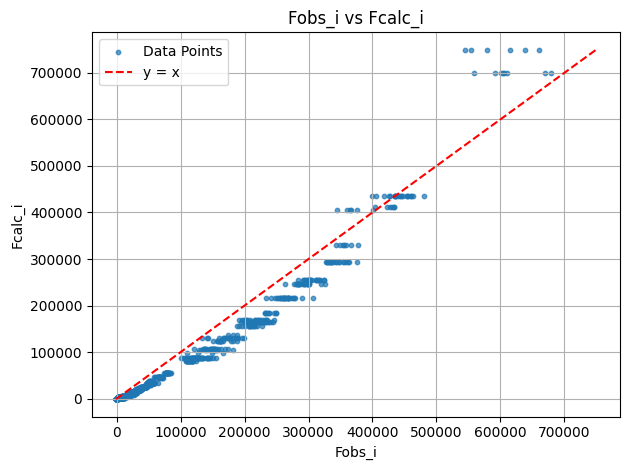

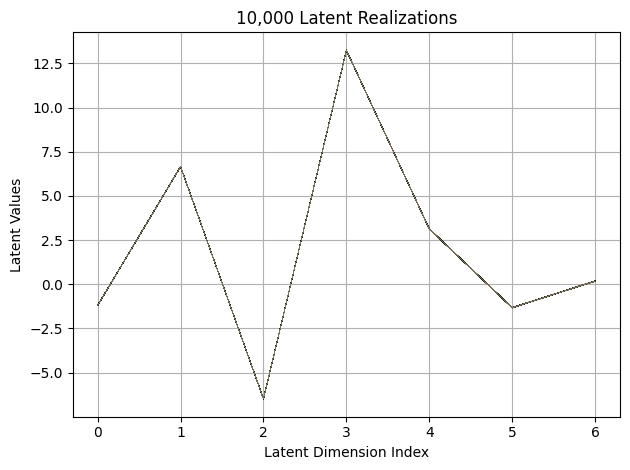

First 10 latent vectors from the VAE:
Sample 1: [-1.193663239479065, 6.656619548797607, -6.47407865524292, 13.241275787353516, 3.1374332904815674, -1.3185713291168213, 0.17412616312503815]
Sample 2: [-1.199228286743164, 6.662694454193115, -6.4780073165893555, 13.245481491088867, 3.136611223220825, -1.328632116317749, 0.1814335137605667]
Sample 3: [-1.2064560651779175, 6.662150859832764, -6.483363151550293, 13.252304077148438, 3.133002519607544, -1.3396477699279785, 0.176721453666687]
Sample 4: [-1.188775658607483, 6.6635422706604, -6.478304386138916, 13.238709449768066, 3.1293106079101562, -1.329870343208313, 0.17885583639144897]
Sample 5: [-1.1831525564193726, 6.666109085083008, -6.47979211807251, 13.238404273986816, 3.145606279373169, -1.3219740390777588, 0.17200015485286713]
Sample 6: [-1.200077772140503, 6.658375263214111, -6.4847493171691895, 13.236490249633789, 3.1268768310546875, -1.321940302848816, 0.16745242476463318]
Sample 7: [-1.1900908946990967, 6.656520843505859, -6.48562

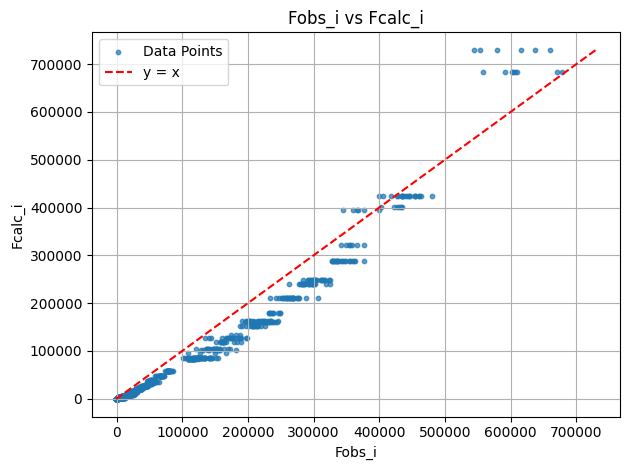

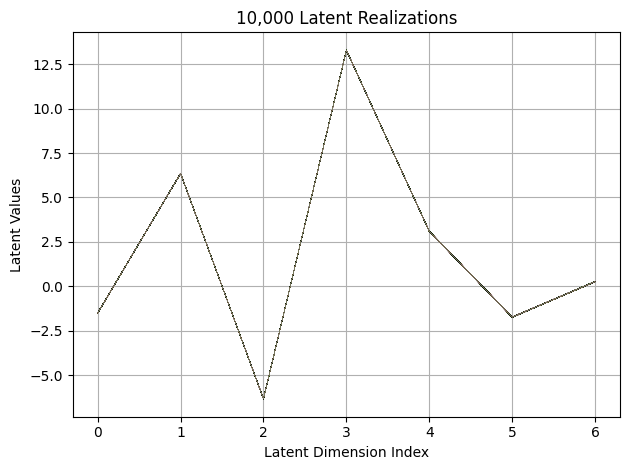

First 10 latent vectors from the VAE:
Sample 1: [-1.5079035758972168, 6.354567050933838, -6.3452301025390625, 13.301880836486816, 3.0898962020874023, -1.7357069253921509, 0.26034021377563477]
Sample 2: [-1.5149437189102173, 6.348556995391846, -6.342479228973389, 13.286681175231934, 3.0853147506713867, -1.7314307689666748, 0.25998908281326294]
Sample 3: [-1.5192421674728394, 6.346411228179932, -6.3285932540893555, 13.284489631652832, 3.0785739421844482, -1.7414358854293823, 0.25791871547698975]
Sample 4: [-1.5047354698181152, 6.350526332855225, -6.3313398361206055, 13.280622482299805, 3.0898241996765137, -1.739592432975769, 0.267790287733078]
Sample 5: [-1.516100287437439, 6.35247278213501, -6.342079162597656, 13.284223556518555, 3.094163179397583, -1.7402210235595703, 0.26200178265571594]
Sample 6: [-1.5116215944290161, 6.352296352386475, -6.329440116882324, 13.28596019744873, 3.0928733348846436, -1.742316484451294, 0.2598850131034851]
Sample 7: [-1.5149809122085571, 6.342287540435791,

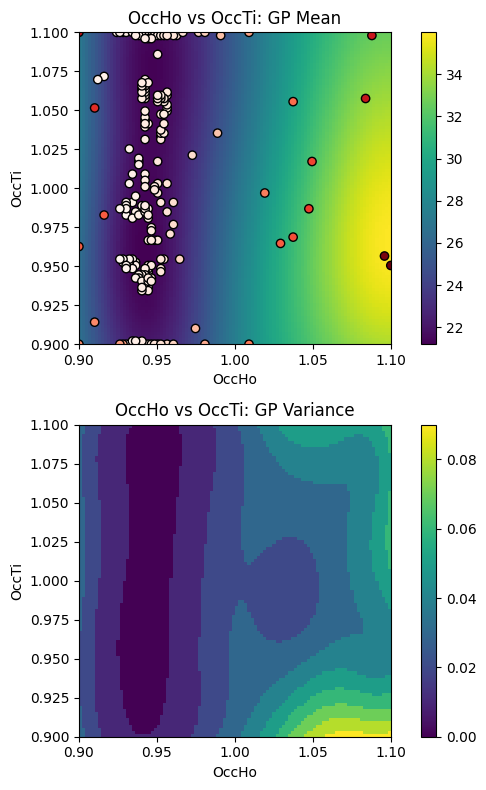

EI: [-1.00000000e+00  1.21843303e-03  1.20177446e-03 ...  1.35127339e-04
  1.64886122e-04  2.04600510e-04]
Function eval #210
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [1.0616161823272705, 0.9646464586257935]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7301
initial chi^2 2.111e+05 with 2596 obs.
New scale: 0.7250
Cycle 0: 0.72s, Chi**2: 1.5551e+05 for 2596 obs., Lambda: 0,  Delta: 0.263, SVD=0
New scale: 0.7250
Maximum shift/esd = -64.135

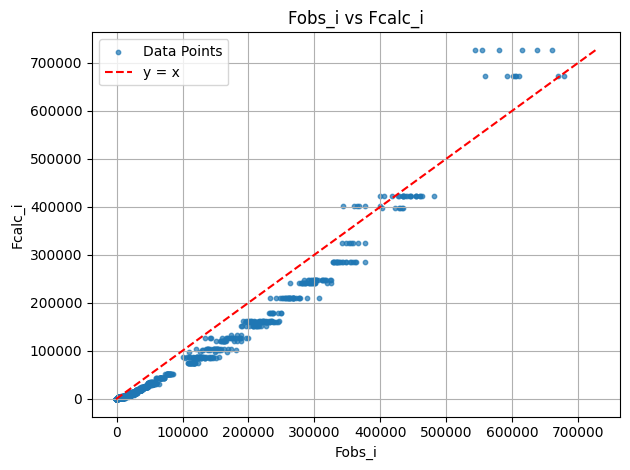

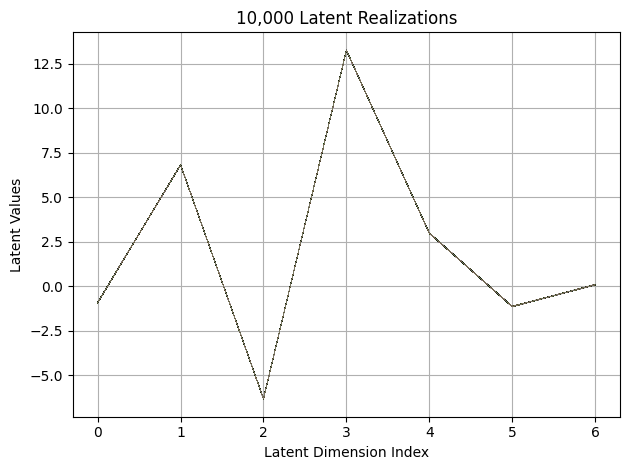

First 10 latent vectors from the VAE:
Sample 1: [-0.9150773286819458, 6.832289218902588, -6.307388782501221, 13.267144203186035, 2.9958291053771973, -1.1420021057128906, 0.10659147799015045]
Sample 2: [-0.9193756580352783, 6.826243877410889, -6.3160223960876465, 13.260069847106934, 2.9825923442840576, -1.1307404041290283, 0.0946713536977768]
Sample 3: [-0.9204561114311218, 6.822844505310059, -6.310547351837158, 13.24474048614502, 2.984252452850342, -1.1285085678100586, 0.08415336906909943]
Sample 4: [-0.9146453738212585, 6.828226566314697, -6.300564765930176, 13.263166427612305, 2.9846889972686768, -1.120734691619873, 0.08552782982587814]
Sample 5: [-0.9180558323860168, 6.824183940887451, -6.322414398193359, 13.274412155151367, 2.9954962730407715, -1.14116632938385, 0.09834383428096771]
Sample 6: [-0.920098066329956, 6.823256492614746, -6.3070244789123535, 13.263012886047363, 2.9902634620666504, -1.1355782747268677, 0.07781745493412018]
Sample 7: [-0.9151667952537537, 6.81477689743042,

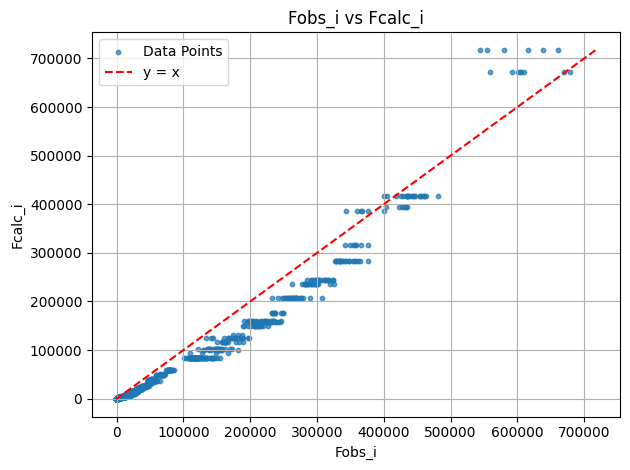

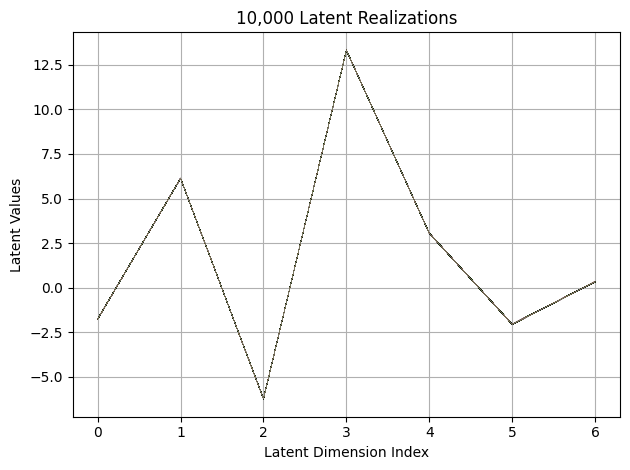

First 10 latent vectors from the VAE:
Sample 1: [-1.7371028661727905, 6.137773513793945, -6.222571849822998, 13.324220657348633, 3.065683364868164, -2.055840253829956, 0.33780109882354736]
Sample 2: [-1.7469582557678223, 6.140109539031982, -6.215115070343018, 13.322721481323242, 3.051384925842285, -2.040689468383789, 0.3440634310245514]
Sample 3: [-1.7571371793746948, 6.133944034576416, -6.234157562255859, 13.310073852539062, 3.0484373569488525, -2.0526981353759766, 0.33716729283332825]
Sample 4: [-1.7582275867462158, 6.142448425292969, -6.230392932891846, 13.30607795715332, 3.051166534423828, -2.048323154449463, 0.3324314057826996]
Sample 5: [-1.7567803859710693, 6.128488540649414, -6.230016231536865, 13.310236930847168, 3.054112195968628, -2.038804531097412, 0.339950293302536]
Sample 6: [-1.759091854095459, 6.133188724517822, -6.215935707092285, 13.310074806213379, 3.051337718963623, -2.046030044555664, 0.3278464674949646]
Sample 7: [-1.7623331546783447, 6.119658470153809, -6.2143859

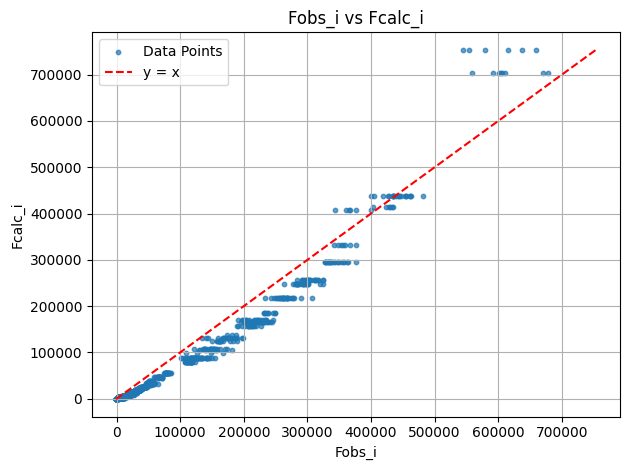

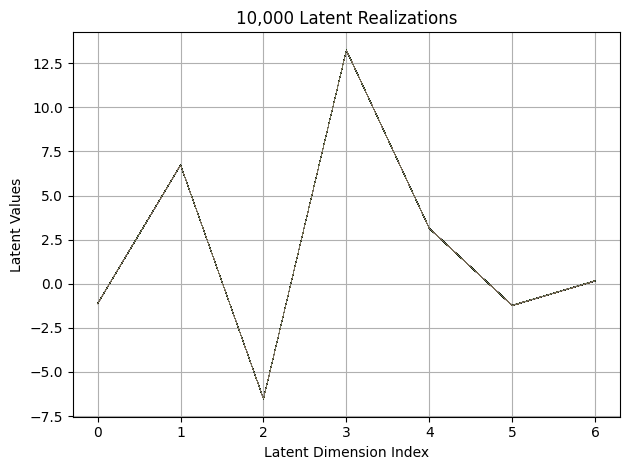

First 10 latent vectors from the VAE:
Sample 1: [-1.1354787349700928, 6.73774528503418, -6.518011093139648, 13.238177299499512, 3.1411004066467285, -1.2285059690475464, 0.15470683574676514]
Sample 2: [-1.1251914501190186, 6.731152057647705, -6.526055335998535, 13.241786003112793, 3.1432108879089355, -1.22672700881958, 0.16415710747241974]
Sample 3: [-1.1244419813156128, 6.730305194854736, -6.519342422485352, 13.239226341247559, 3.1350748538970947, -1.2450923919677734, 0.14967314898967743]
Sample 4: [-1.120300054550171, 6.730568885803223, -6.518243312835693, 13.232354164123535, 3.1287097930908203, -1.230416178703308, 0.15751659870147705]
Sample 5: [-1.115097165107727, 6.734540939331055, -6.516194820404053, 13.232982635498047, 3.132888078689575, -1.2286734580993652, 0.14877595007419586]
Sample 6: [-1.1174379587173462, 6.727732181549072, -6.519763469696045, 13.230032920837402, 3.1368143558502197, -1.2170175313949585, 0.15295156836509705]
Sample 7: [-1.1246230602264404, 6.727205753326416, 

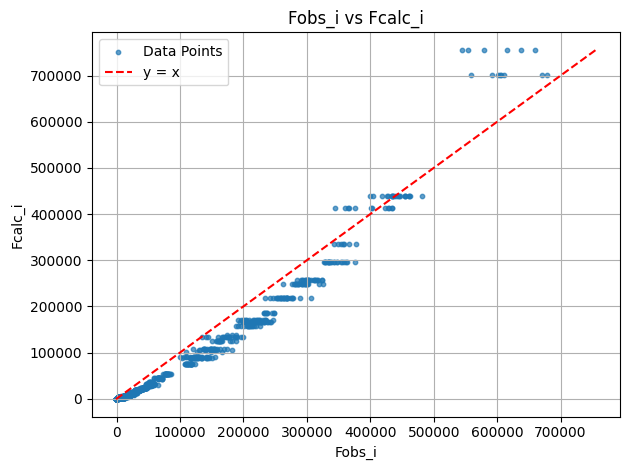

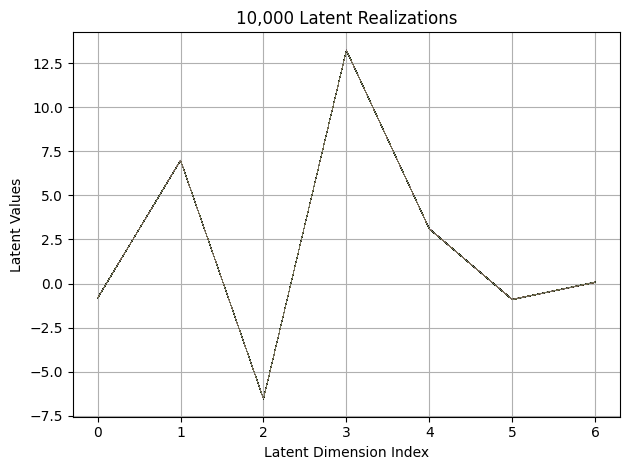

First 10 latent vectors from the VAE:
Sample 1: [-0.8146407604217529, 6.970019340515137, -6.529513359069824, 13.211915016174316, 3.103393793106079, -0.8923326730728149, 0.07905423641204834]
Sample 2: [-0.8271698355674744, 6.975901126861572, -6.535819053649902, 13.224982261657715, 3.1095612049102783, -0.9185159802436829, 0.07453259825706482]
Sample 3: [-0.8138474822044373, 6.994002819061279, -6.531651496887207, 13.219521522521973, 3.1018147468566895, -0.9133991003036499, 0.07194435596466064]
Sample 4: [-0.8093316555023193, 6.970636367797852, -6.536319732666016, 13.219521522521973, 3.1012473106384277, -0.9059450626373291, 0.08788231015205383]
Sample 5: [-0.828015148639679, 6.975900650024414, -6.533185005187988, 13.206900596618652, 3.113621711730957, -0.8955850005149841, 0.06298355013132095]
Sample 6: [-0.806803822517395, 6.9776530265808105, -6.533313751220703, 13.211529731750488, 3.1116180419921875, -0.9128450751304626, 0.07966305315494537]
Sample 7: [-0.8167923092842102, 6.9810318946838

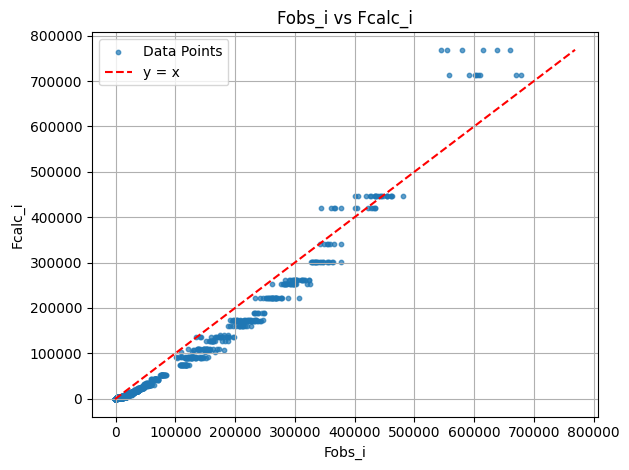

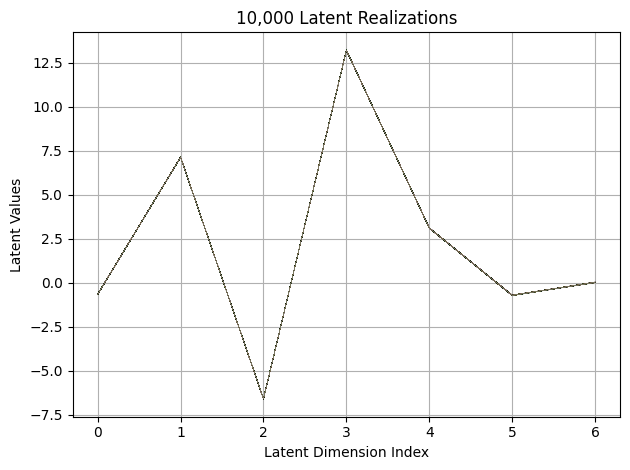

First 10 latent vectors from the VAE:
Sample 1: [-0.6657969951629639, 7.124643802642822, -6.571649074554443, 13.205634117126465, 3.1092910766601562, -0.7055392265319824, 0.032311081886291504]
Sample 2: [-0.6512986421585083, 7.135502815246582, -6.586994171142578, 13.209413528442383, 3.1142921447753906, -0.7107848525047302, 0.025358671322464943]
Sample 3: [-0.6523484587669373, 7.133362770080566, -6.588282585144043, 13.208478927612305, 3.1139328479766846, -0.7108960747718811, 0.02837764285504818]
Sample 4: [-0.6572116613388062, 7.118949890136719, -6.585293769836426, 13.206966400146484, 3.103386163711548, -0.7076846361160278, 0.03663237392902374]
Sample 5: [-0.6575607061386108, 7.1321516036987305, -6.582293510437012, 13.2260160446167, 3.098411798477173, -0.7004947066307068, 0.025188859552145004]
Sample 6: [-0.6519548892974854, 7.117742538452148, -6.575972557067871, 13.202258110046387, 3.0977425575256348, -0.7122427225112915, 0.021353229880332947]
Sample 7: [-0.6529712677001953, 7.131639003

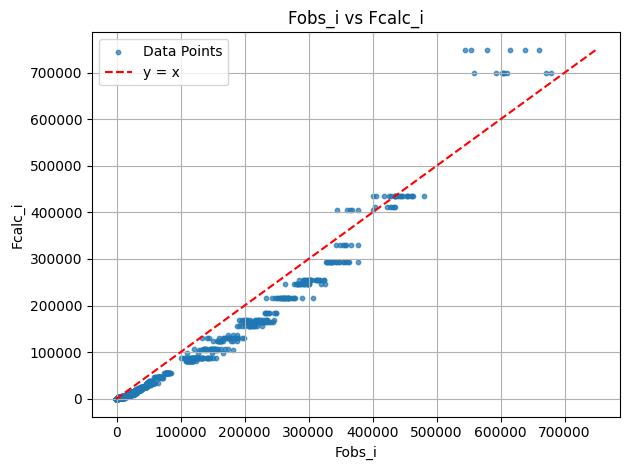

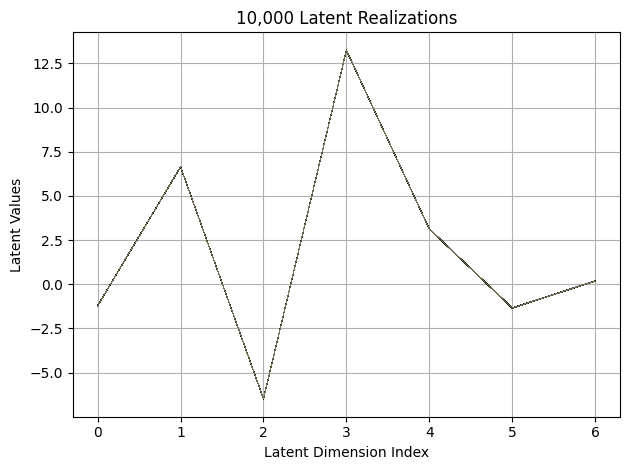

First 10 latent vectors from the VAE:
Sample 1: [-1.205420732498169, 6.645961284637451, -6.478959083557129, 13.248274803161621, 3.136848211288452, -1.3340281248092651, 0.18606211245059967]
Sample 2: [-1.2187851667404175, 6.642597675323486, -6.474101543426514, 13.237744331359863, 3.125727653503418, -1.344056487083435, 0.18238839507102966]
Sample 3: [-1.219742774963379, 6.652294158935547, -6.476788520812988, 13.246231079101562, 3.1365115642547607, -1.3408727645874023, 0.18749144673347473]
Sample 4: [-1.2066476345062256, 6.643320083618164, -6.471920967102051, 13.252618789672852, 3.1323585510253906, -1.3504468202590942, 0.17775674164295197]
Sample 5: [-1.2151302099227905, 6.6474480628967285, -6.473803997039795, 13.245017051696777, 3.1230592727661133, -1.3333827257156372, 0.1759023219347]
Sample 6: [-1.2158570289611816, 6.645208358764648, -6.493749141693115, 13.246394157409668, 3.125358819961548, -1.331336259841919, 0.18383102118968964]
Sample 7: [-1.214820146560669, 6.636490345001221, -6.4

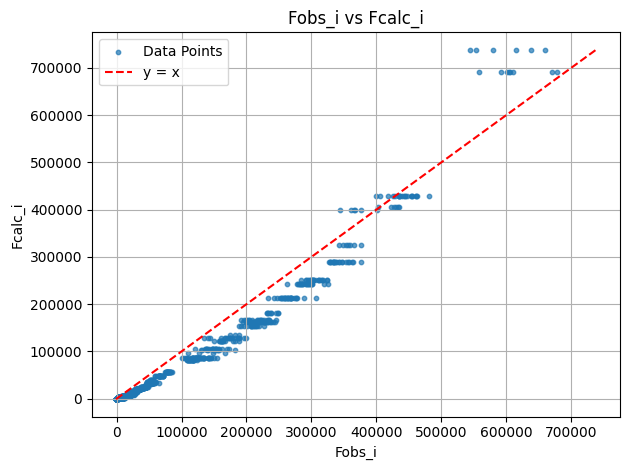

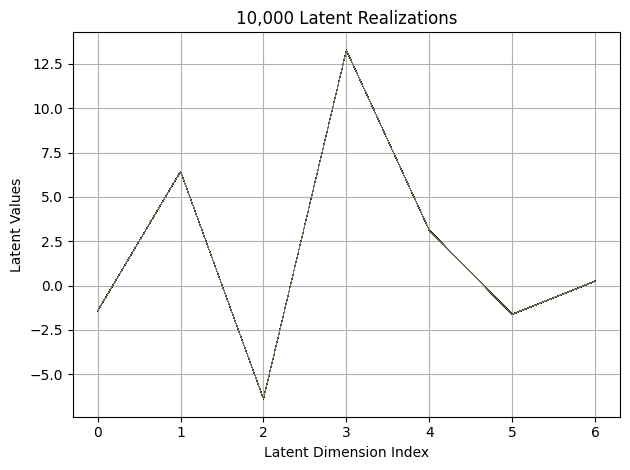

First 10 latent vectors from the VAE:
Sample 1: [-1.439084529876709, 6.434848785400391, -6.397104263305664, 13.26812744140625, 3.118222951889038, -1.6206992864608765, 0.23868423700332642]
Sample 2: [-1.4353151321411133, 6.439100742340088, -6.389917850494385, 13.267776489257812, 3.1089696884155273, -1.6174170970916748, 0.23018041253089905]
Sample 3: [-1.4285222291946411, 6.426668167114258, -6.382684230804443, 13.279472351074219, 3.1157143115997314, -1.6179016828536987, 0.2519494295120239]
Sample 4: [-1.429028868675232, 6.439370155334473, -6.398864269256592, 13.270095825195312, 3.106715440750122, -1.636654257774353, 0.24350401759147644]
Sample 5: [-1.4269620180130005, 6.439609050750732, -6.391394138336182, 13.271897315979004, 3.114438056945801, -1.6254487037658691, 0.24451611936092377]
Sample 6: [-1.431965947151184, 6.433777809143066, -6.390999794006348, 13.275087356567383, 3.119419574737549, -1.6322914361953735, 0.2428765892982483]
Sample 7: [-1.4287714958190918, 6.4290361404418945, -6.

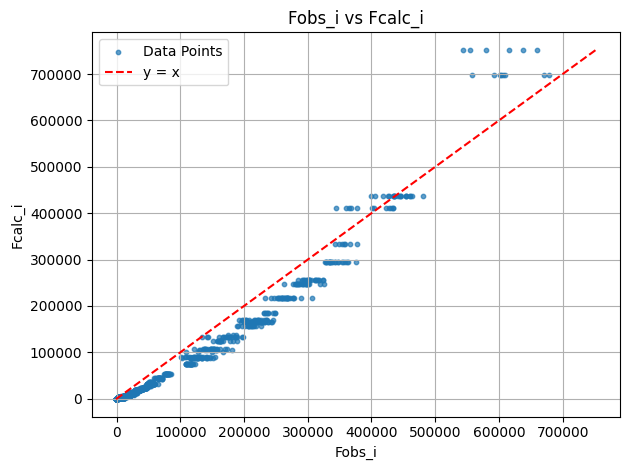

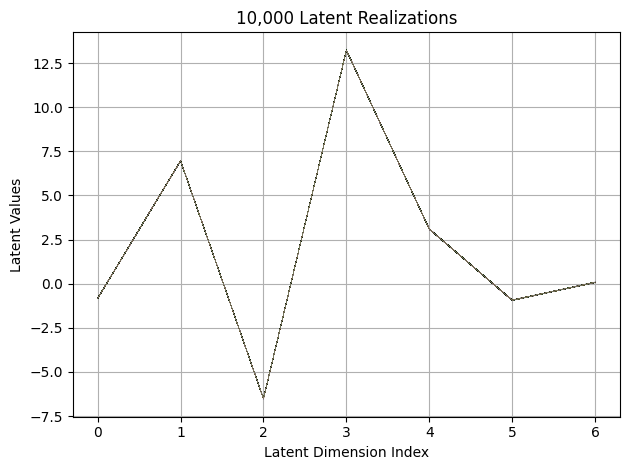

First 10 latent vectors from the VAE:
Sample 1: [-0.8372324109077454, 6.961472988128662, -6.51848030090332, 13.213485717773438, 3.0916926860809326, -0.9369222521781921, 0.07888634502887726]
Sample 2: [-0.8224568963050842, 6.964019298553467, -6.516020774841309, 13.231998443603516, 3.090998888015747, -0.9298619627952576, 0.07199054956436157]
Sample 3: [-0.8304898738861084, 6.963718414306641, -6.523582458496094, 13.217889785766602, 3.087648391723633, -0.9437492489814758, 0.07307438552379608]
Sample 4: [-0.8214929699897766, 6.958213806152344, -6.515451431274414, 13.223240852355957, 3.0927717685699463, -0.9263148307800293, 0.07829401642084122]
Sample 5: [-0.8380728960037231, 6.968647003173828, -6.529969215393066, 13.230521202087402, 3.0808873176574707, -0.9401369690895081, 0.08574923127889633]
Sample 6: [-0.8381430506706238, 6.971922397613525, -6.508382797241211, 13.241867065429688, 3.0979464054107666, -0.9449787735939026, 0.07165567576885223]
Sample 7: [-0.8415197134017944, 6.9629912376403

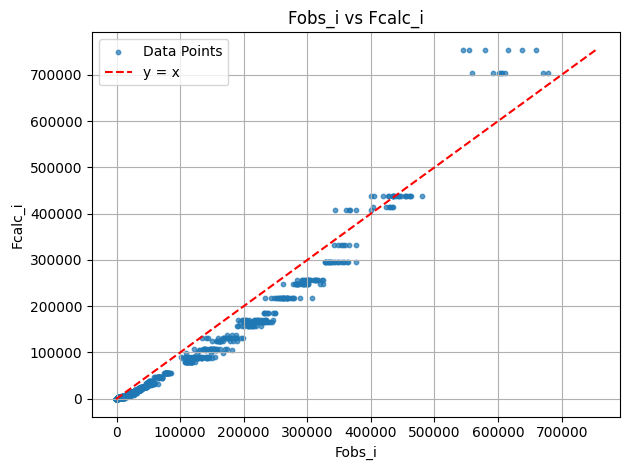

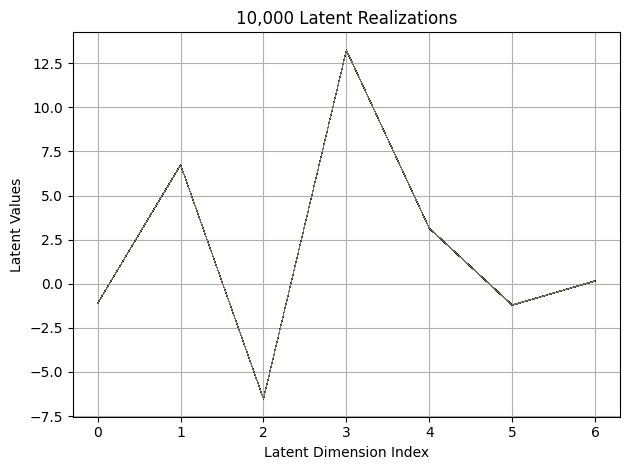

First 10 latent vectors from the VAE:
Sample 1: [-1.1144298315048218, 6.755514621734619, -6.5127387046813965, 13.230119705200195, 3.1339519023895264, -1.2041573524475098, 0.157584086060524]
Sample 2: [-1.104550838470459, 6.7431640625, -6.526366233825684, 13.229243278503418, 3.139462471008301, -1.2053170204162598, 0.16598784923553467]
Sample 3: [-1.1098910570144653, 6.756075382232666, -6.522457599639893, 13.234700202941895, 3.144155740737915, -1.210783839225769, 0.14580053091049194]
Sample 4: [-1.1200547218322754, 6.740081310272217, -6.520724773406982, 13.225258827209473, 3.133908271789551, -1.2210274934768677, 0.1472874879837036]
Sample 5: [-1.1215740442276, 6.744875907897949, -6.527344226837158, 13.233118057250977, 3.1391100883483887, -1.2186503410339355, 0.14760315418243408]
Sample 6: [-1.1010098457336426, 6.740665912628174, -6.519741535186768, 13.247934341430664, 3.128293037414551, -1.2174203395843506, 0.1504911184310913]
Sample 7: [-1.1032265424728394, 6.740819931030273, -6.5219879

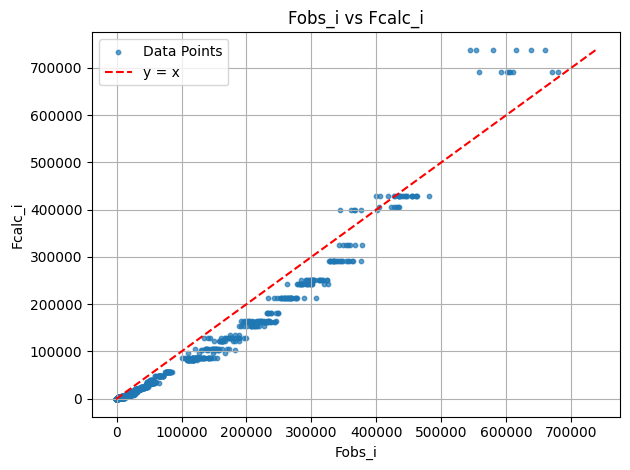

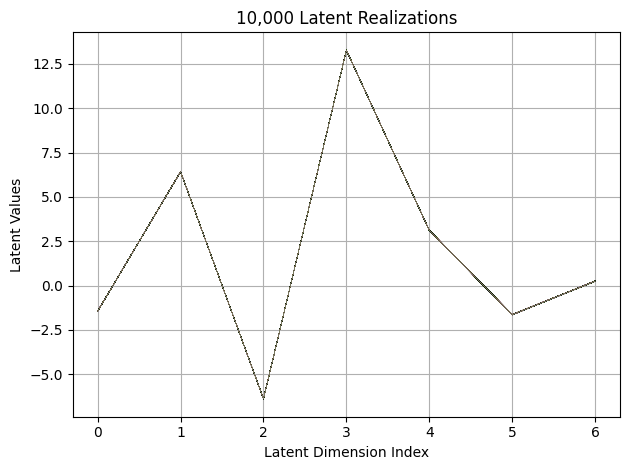

First 10 latent vectors from the VAE:
Sample 1: [-1.4506646394729614, 6.418439865112305, -6.389467716217041, 13.274744987487793, 3.114959239959717, -1.658357858657837, 0.24400490522384644]
Sample 2: [-1.451139211654663, 6.421576499938965, -6.394587516784668, 13.261615753173828, 3.113020181655884, -1.6457107067108154, 0.2479698657989502]
Sample 3: [-1.4461344480514526, 6.427639961242676, -6.39063024520874, 13.263954162597656, 3.114161252975464, -1.64179527759552, 0.26052775979042053]
Sample 4: [-1.4501101970672607, 6.425027370452881, -6.384898662567139, 13.271830558776855, 3.107123374938965, -1.6496779918670654, 0.2548922002315521]
Sample 5: [-1.4452385902404785, 6.411905288696289, -6.384885787963867, 13.270208358764648, 3.127061367034912, -1.6394989490509033, 0.24792657792568207]
Sample 6: [-1.437888741493225, 6.421224594116211, -6.393748760223389, 13.270018577575684, 3.116525650024414, -1.6351054906845093, 0.24556918442249298]
Sample 7: [-1.4584513902664185, 6.4220290184021, -6.402938

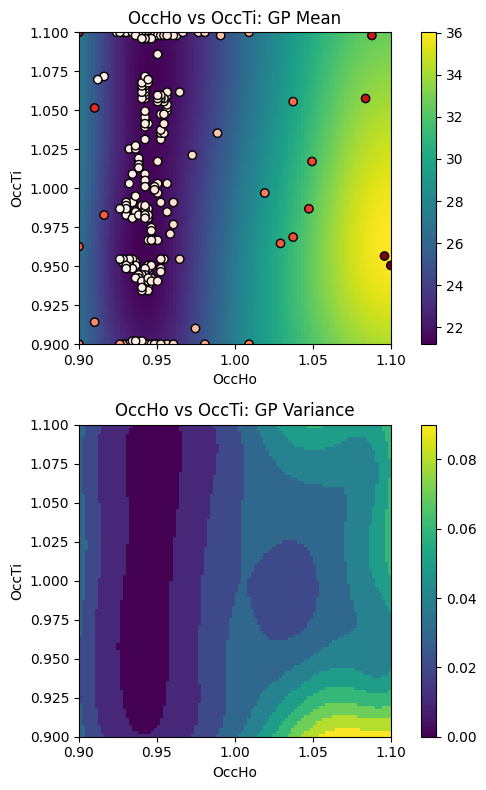

EI: [-1.00000000e+00  1.24584883e-03  1.22751202e-03 ...  1.44135556e-04
  1.76026719e-04  2.18625180e-04]
Function eval #220
Directory 'C:\Users\USER\PhD\IAMM PROJECT\BO/Task_4-21-2025/gpx' already exists.
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\HTO_original.cif read by Reader CIF
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
C:\Users\USER\PhD\IAMM PROJECT\BO\GSAS Data\HTO_xray\which_hkl1\cleaned_xtal1_110K.hkl read by Reader Shelx HKLF 4 F²
X: [1.0696970224380493, 0.9404040575027466]
[0.421597, 0.920386, 0.008262, 0.00325, 0, 0.01]
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
gpx file saved as C:\Users\USER\PhD\IAMM PROJECT\BO\Task_4-21-2025\gpx\0.gpx
 Hessian Levenberg-Marquardt SVD refinement on 1 variables:
New scale: 0.7570
initial chi^2 2.0013e+05 with 2596 obs.
New scale: 0.7570
Cycle 0: 0.77s, Chi**2: 1.5741e+05 for 2596 obs., Lambda: 0,  Delta: 0.213, SVD=0
New scale: 0.7570
Maximum shift/esd = -52.55

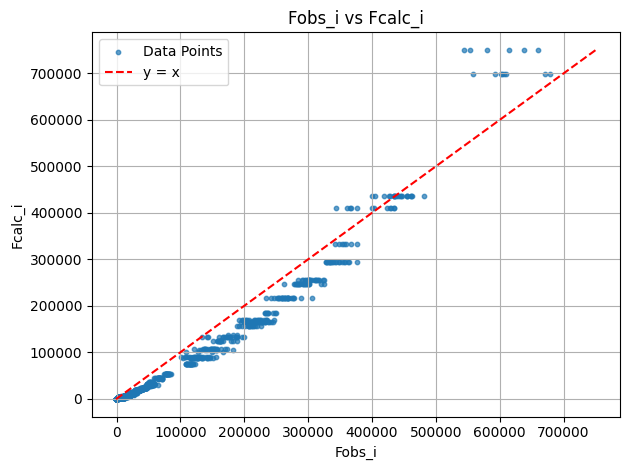

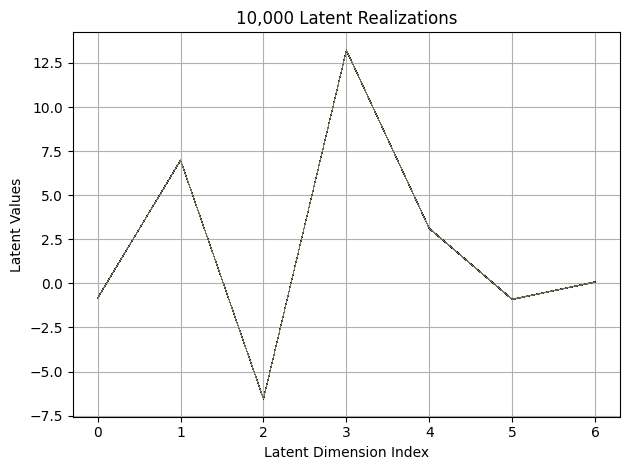

First 10 latent vectors from the VAE:
Sample 1: [-0.8344569802284241, 6.968685626983643, -6.545074462890625, 13.215408325195312, 3.1067283153533936, -0.8979601263999939, 0.09188587218523026]
Sample 2: [-0.8297667503356934, 6.966564178466797, -6.55717134475708, 13.221495628356934, 3.106046676635742, -0.9116525650024414, 0.09000337868928909]
Sample 3: [-0.8213527202606201, 6.971758842468262, -6.550584316253662, 13.216958045959473, 3.1124751567840576, -0.9208365678787231, 0.073094442486763]
Sample 4: [-0.8425540328025818, 6.98135232925415, -6.548334121704102, 13.215071678161621, 3.111024856567383, -0.9060841202735901, 0.08006693422794342]
Sample 5: [-0.8303664326667786, 6.999514102935791, -6.530550956726074, 13.225934028625488, 3.1091485023498535, -0.8955588340759277, 0.07092943042516708]
Sample 6: [-0.8327231407165527, 6.977309226989746, -6.553773403167725, 13.212787628173828, 3.1086947917938232, -0.9064111113548279, 0.07319550961256027]
Sample 7: [-0.8257624506950378, 6.9744181632995605

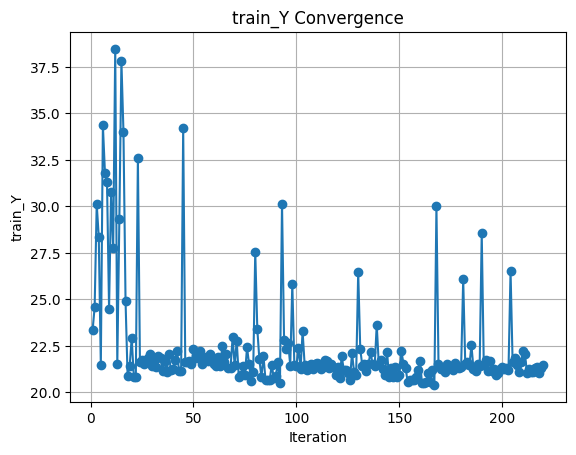

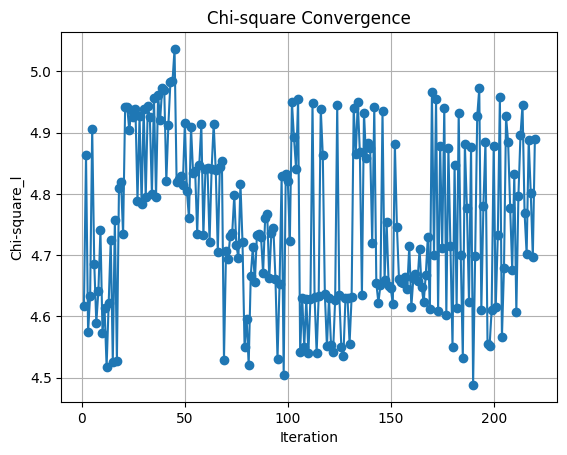

#########################################################
Current best solutions at iteration: 200
Best params among evaluated samples: tensor([[0.9545, 0.9263]]) tensor(20.4000)
Best params from GP map: tensor([[0.9606, 0.9404]]) tensor(21.2000)


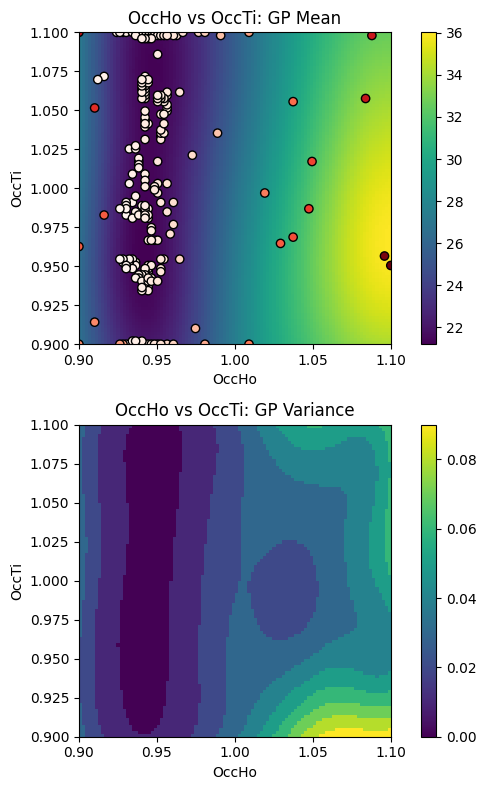

In [ ]:
#Initialize for BO
num_start = 20  # Starting samples
N = 200 # Total BO iteration

#Define parameter space
x1 = torch.linspace(0.9, 1.1, 100) #OccTi
# x2 = torch.linspace(0, 0.01, 11) #UTi
x3 = torch.linspace(0.9, 1.1, 100) #OccHo
# x4 = torch.linspace(0, 0.01, 11) #UHo

#Define parameter space
#Define parameter space
#x1 = torch.linspace(0.5, 0.8, 100) #OccTi
# x2 = torch.linspace(0, 0.01, 11) #UTi
#x3 = torch.linspace(0.8, 1.1, 100) #OccHo
# x4 = torch.linspace(0, 0.01, 11) #UHo
X = [x1, x3]


# GSAS arrays
Fobs = []
Fcalc = []
iteration = 0

#Fixed parameters of experimental setup

# To change what parameters are varied, edit the gsas.py script
fix_params = [
    0.421597, # xO1
    0.920386, # OccO2
    0.008262, # UO1
    0.00325, #UO2
    0, #UTi
    0.010 #UHo
    ]

#BO
X_opt, X_opt_GP, train_X, train_Y, train_chisq, y_pred_means, y_pred_vars = BO_SpinIce(X, fix_params, num_start, N)
#print(X)